In [1]:
from neuron import h, gui
import numpy as np
from neuron.units import ms, mV
import matplotlib.pyplot as plt

h.load_file("stdrun.hoc")

%matplotlib inline

In [87]:
from scipy import fftpack


def plot_fft_and_get_peaks(layer_1, layer_2, plot=False, time_ms=200):
    current_vectors = []
    for cell in layer_1.cells:
        # total synaptic current
        vec = h.Vector().record(cell.syn_E._ref_i)
        current_vectors.append(vec)
        vec2 = h.Vector().record(cell.syn_I._ref_i)
        current_vectors.append(vec2)

    for cell in layer_2.cells:
        # total synaptic current
        vec = h.Vector().record(cell.syn_E._ref_i)
        current_vectors.append(vec)
        vec2 = h.Vector().record(cell.syn_I._ref_i)
        current_vectors.append(vec2)

    time = h.Vector().record(h._ref_t)

    h.finitialize(-65 * mV)
    h.continuerun(time_ms * ms)

    max_freq = 100

    sum = np.zeros(len(current_vectors[0]))
    for vec in current_vectors:
        sum += np.array(vec)

    # if plot:
    #     # sum of all currents
    #     fig, ax = plt.subplots(1, 1, figsize=(10, 4))
    #     ax.plot(time, sum)
    #     ax.set_xlabel("Time (ms)")
    #     ax.set_ylabel("Current (nA)")
    #     ax.set_xlim(0, 150)

    # for vec in current_vectors:
    #     fft = fftpack.fft(np.array(vec))
    #     freq = fftpack.fftfreq(len(vec), 0.0001)
    #     if plot:
    #         ax.plot(freq[:max_freq], np.abs(fft)[:max_freq])

    # plot eeg
    fig, ax = plt.subplots(1, 1, figsize=(10, 4))
    ax.plot(time, sum)
    ax.set_xlabel("Time (ms)")
    ax.set_ylabel("Current (nA)")
    ax.set_xlim(0, time_ms)
    plt.show()

    # correct the DC component
    sum -= np.mean(sum)
    fft = fftpack.fft(sum)
    freq = fftpack.fftfreq(len(sum), 0.0001)
    if plot:
        fig, ax = plt.subplots(1, 1, figsize=(10, 4))

        ax.plot(freq[:max_freq], np.abs(fft)[:max_freq])
        ax.set_xlabel("Frequency (Hz)")
        ax.set_ylabel("Current (nA)")
        plt.show()

    # find 2 peak frequencies (spaced by at least 5 Hz)
    peak_freqs = freq[np.argsort(np.abs(fft))[-2:]][::-1]
    peak_freqs_amp = np.abs(fft)[np.argsort(np.abs(fft))[-2:]][::-1]

    return peak_freqs, peak_freqs_amp


def plot_raster(layer_1, layer_2, time_ms=200):
    # recording spikes
    spike_times_vec_E = h.Vector()
    idvec_E = h.Vector()
    for i, cell in enumerate(layer_1.cells):
        nc = h.NetCon(cell.soma(0.5)._ref_v, None, sec=cell.soma)
        nc.record(spike_times_vec_E, idvec_E, i)
    del nc

    spike_times_vec_I = h.Vector()
    idvec_I = h.Vector()
    for i, cell in enumerate(layer_2.cells):
        nc = h.NetCon(cell.soma(0.5)._ref_v, None, sec=cell.soma)
        nc.record(spike_times_vec_I, idvec_I, i)

    spike_times_vec_stim = h.Vector()
    idvec_stim = h.Vector()
    for i, stim in enumerate(layer_1.stims):
        nc = h.NetCon(stim[0], None, sec=layer_1.cells[i].soma)
        nc.record(spike_times_vec_stim, idvec_stim, i)

    h.finitialize(-65 * mV)
    h.continuerun(time_ms * ms)

    # plotting rasterplot
    plt.figure()

    stim_offset = -len(layer_1.cells)
    inh_offset = len(layer_1.cells)

    for t, id in zip(spike_times_vec_E, idvec_E):
        plt.vlines(t, id + 0.5, id + 1.5, color="b")

    for t, id in zip(spike_times_vec_I, idvec_I):
        plt.vlines(t, id + inh_offset + 0.5, id + inh_offset + 1.5, color="y")

    for t, id in zip(spike_times_vec_stim, idvec_stim):
        plt.vlines(t, id + stim_offset + 0.5, id + stim_offset + 1.5, color="r")

    plt.xlabel("Time (ms)")
    plt.ylabel("Cell number")
    plt.xlim(0, 150)
    plt.show()

In [88]:
class Cell:
    def __init__(self, gid, x, y, z, inhibitory=False):
        self._gid = gid
        self._setup_morphology()
        self.all = self.soma.wholetree()
        self._setup_biophysics()
        self.x = self.y = self.z = 0
        self.inhibitory = inhibitory
        h.define_shape()
        for sec in self.all:
            for i in range(sec.n3d()):
                sec.pt3dchange(
                    i,
                    sec.x3d(i),
                    sec.y3d(i),
                    0,
                    sec.diam3d(i),
                )

        # self._rotate_z(theta)
        self._set_position(x, y, z)

        self._spike_detector = h.NetCon(self.soma(0.5)._ref_v, None, sec=self.soma)
        self.spike_times = h.Vector()
        self._spike_detector.record(self.spike_times)

        self._ncs = []

        self.soma_v = h.Vector().record(self.soma(0.5)._ref_v)

    def __repr__(self):
        return "{}[{}]".format(self.name, self._gid)

    def _set_position(self, x, y, z):
        for sec in self.all:
            for i in range(sec.n3d()):
                sec.pt3dchange(
                    i,
                    x - self.x + sec.x3d(i),
                    y - self.y + sec.y3d(i),
                    z - self.z + sec.z3d(i),
                    sec.diam3d(i),
                )
        self.x, self.y, self.z = x, y, z

In [89]:
class PointNeuron(Cell):
    name = "PointNeuron"

    def _setup_morphology(self):
        self.soma = h.Section(name="soma", cell=self)
        self.soma.L = self.soma.diam = 12.6157

    def _setup_biophysics(self):
        for sec in self.all:
            sec.Ra = 100  # Axial resistance in Ohm * cm
            sec.cm = 1  # Membrane capacitance in micro Farads / cm^2
        self.soma.insert("hh")
        for seg in self.soma:
            seg.hh.gnabar = 0.12  # Sodium conductance in S/cm2
            seg.hh.gkbar = 0.036  # Potassium conductance in S/cm2
            seg.hh.gl = 0.0003  # Leak conductance in S/cm2
            seg.hh.el = -54.3  # Reversal potential in mV
        # Insert passive current in the dendrite
        # self.dend.insert("pas")
        # for seg in self.dend:
        #     seg.pas.g = 0.001  # Passive conductance in S/cm2
        #     seg.pas.e = -65  # Leak reversal potential mV

        # NEW: the synapse
        # self.syn = h.ExpSyn(self.soma(0.5))
        # self.syn.tau = 2 * ms

        # replace with 1 inhibitory and 1 excitatory synapse
        self.syn_E = h.Exp2Syn(self.soma(0.5))
        self.syn_E.tau1 = 0.5 * ms
        self.syn_E.tau2 = 2 * ms
        self.syn_E.e = 0 * mV

        self.syn_I = h.Exp2Syn(self.soma(0.5))
        self.syn_I.tau1 = 0.5 * ms
        self.syn_I.tau2 = 2 * ms
        self.syn_I.e = -70 * mV

In [124]:
def create_n_PointNeurons(
    NETDIM_X, NETDIM_Y, x0, y0, z0, Dx=50, Dy=50, inhibitory=False
):
    # NETDIM_X, NETDIM_Y, NETDIM_Z - number of cells in X, Y and Z dimension
    # x0, y0, z0 – network point of origin
    Dx = Dx
    Dy = Dy

    cells = []
    label = 0
    for i in range(NETDIM_X):
        for j in range(NETDIM_Y):
            cells.append(PointNeuron(label, x0 + i * Dx, y0 + j * Dy, z0, inhibitory))
            label = label + 1
    return cells


def make_netcon(source, target, weight=0.005, delay=2):
    dist = np.sqrt(
        (source.x - target.x) ** 2
        + (source.y - target.y) ** 2
        + (source.z - target.z) ** 2
    )
    if source.inhibitory:
        nc = h.NetCon(source.soma(0.5)._ref_v, target.syn_I, sec=source.soma)
    else:
        nc = h.NetCon(source.soma(0.5)._ref_v, target.syn_E, sec=source.soma)
    nc.weight[0] = weight
    nc.delay = 0.0005 * dist  # 0.0005 [ms/um] -> 2 [m/s]
    return nc


def draw_fake_axon(source, target):
    # if inhibitory color red, else color blue
    sec = h.Section(name=f"{source}_to_{target}")
    sec.diam = 1
    sec.pt3dadd(
        source.x,
        source.y,
        source.z,
        1,
    )
    sec.pt3dadd(
        target.x,
        target.y,
        target.z,
        1,
    )
    return sec, source.inhibitory


def add_stim(cell, weight=0.005, number=20, interval=10, start=0, noise=1):
    stim = h.NetStim()

    stim.number = number
    stim.interval = interval
    stim.start = start
    stim.noise = noise

    ncstim = h.NetCon(stim, cell.syn_E, 0, 1, weight)
    return stim, ncstim


class Layer:
    """A layer of neurons."""

    netcons_E = []
    netcons_I = []
    drawn_secs = []
    stims = []

    def __init__(
        self,
        NETDIM_X,
        NETDIM_Y,
        x0,
        y0,
        z0,
        inhibitory,
        prob_of_con_within_layer,
        Dx=50,
        Dy=50,
        stim_params={},
    ):
        self.cells = create_n_PointNeurons(
            NETDIM_X, NETDIM_Y, x0, y0, z0, Dx, Dy, inhibitory
        )
        if not inhibitory:
            self.stims = []
            for cell in self.cells:
                stim = add_stim(cell, **stim_params)
                self.stims.append(stim)

        self.inhibitory = inhibitory
        self._connect_cells_within_layer(prob_of_con_within_layer)

    def _connect_cells_within_layer(self, prob_of_con_within_layer):
        for source in self.cells:
            for target in self.cells:
                if (np.random.uniform() <= prob_of_con_within_layer) and (
                    source != target
                ):
                    nc = make_netcon(source, target, weight=0.005, delay=2)
                    if source.inhibitory:
                        self.netcons_I.append(nc)
                    else:
                        self.netcons_E.append(nc)

                    # visualize if the connection is inhibitory or excitatory
                    res = draw_fake_axon(source, target)
                    # res is (sec, boolean)
                    self.drawn_secs.append(res)

In [125]:
def construct_network(
    prob1=0.01,
    prob2=0.2,
    prob12=0.1,
    weight12=0.005,
    prob21=0.1,
    weight21=0.005,
    plot=False,
    connect_between_layers=True,
    stim_params={},
):
    # make upper layer (excitatory) and make sure the layers are centered with respect to each other
    layer_1 = Layer(
        8,
        8,
        0,
        0,
        0,
        inhibitory=False,
        prob_of_con_within_layer=prob1,
        stim_params=stim_params,
    )

    # make lower layer (inhibitory) and make sure the layers are centered with respect to each other
    layer_2 = Layer(4, 4, 0, 0, 50, inhibitory=True, prob_of_con_within_layer=prob2)

    fake_axons = []
    if connect_between_layers:
        # connect upper layer to lower layer
        probability = prob12
        for source in layer_1.cells:
            for target in layer_2.cells:
                if np.random.uniform() <= probability and source != target:
                    nc = make_netcon(source, target, weight=weight12, delay=2)
                    layer_1.netcons_E.append(nc)
                    res = draw_fake_axon(source, target)
                    fake_axons.append(res)

        # connect lower layer to upper layer
        probability = prob21
        for source in layer_2.cells:
            for target in layer_1.cells:
                if np.random.uniform() <= probability and source != target:
                    nc = make_netcon(source, target, weight=weight21, delay=2)
                    layer_2.netcons_I.append(nc)
                    res = draw_fake_axon(source, target)
                    fake_axons.append(res)

    if plot:
        # initiate plotly figure
        fig = plt.figure(figsize=(10, 10))
        ax = fig.add_subplot(111, projection="3d")

        # Loop over all sections
        for sec, inhibitory in layer_1.drawn_secs:
            # Get the x, y, z coordinates of the points in the section
            x = [sec.x3d(i) for i in range(sec.n3d())]
            y = [sec.y3d(i) for i in range(sec.n3d())]
            z = [sec.z3d(i) for i in range(sec.n3d())]

            # Determine the color based on whether the synapse is inhibitory or excitatory
            color = "r" if inhibitory else "b"

            # Plot the section
            ax.plot(x, y, z, color)

        for sec, inhibitory in layer_2.drawn_secs:
            # Get the x, y, z coordinates of the points in the section
            x = [sec.x3d(i) for i in range(sec.n3d())]
            y = [sec.y3d(i) for i in range(sec.n3d())]
            z = [sec.z3d(i) for i in range(sec.n3d())]

            # Determine the color based on whether the synapse is inhibitory or excitatory
            color = "r" if inhibitory else "b"

            # Plot the section
            ax.plot(x, y, z, color)

        for sec, inhibitory in fake_axons:
            # Get the x, y, z coordinates of the points in the section
            x = [sec.x3d(i) for i in range(sec.n3d())]
            y = [sec.y3d(i) for i in range(sec.n3d())]
            z = [sec.z3d(i) for i in range(sec.n3d())]

            # Determine the color based on whether the synapse is inhibitory or excitatory
            color = "r" if inhibitory else "b"

            # Plot the section
            ax.plot(x, y, z, color)

        # interactive 3d plot
        plt.show()

    return layer_1, layer_2, fake_axons

In [126]:
layer_1, layer_2, fake_axons = construct_network(plot=False)

In [127]:
cell_o_E = h.Vector().record(layer_1.cells[10].soma(0.5)._ref_v)

cell_o_I = h.Vector().record(layer_2.cells[10].soma(0.5)._ref_v)

stim, ncstim = layer_1.stims[0]

# record stim spikes
stim_spikes = h.Vector()
ncstim.record(stim_spikes)

time = h.Vector().record(h._ref_t)

h.finitialize(-65 * mV)
h.continuerun(100 * ms)

0.0

In [128]:
list(stim_spikes)

[8.238087414283964,
 19.092386961590726,
 24.711169573112574,
 35.14940514782379,
 51.70347807037629,
 98.33573451060629]

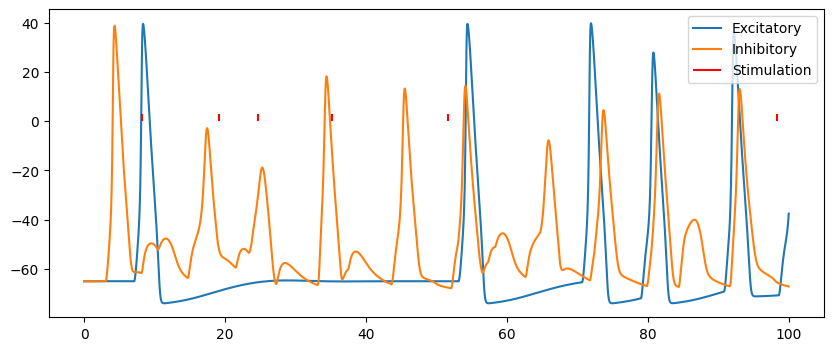

In [129]:
fig, ax = plt.subplots(1, 1, figsize=(10, 4))
ax.plot(time, cell_o_E, label="Excitatory")
ax.plot(time, cell_o_I, label="Inhibitory")
ax.vlines(list(stim_spikes), 0, 3, color="r", label="Stimulation")
# ax.plot(time, stim_o, label="Stimulation")
ax.legend()

In [130]:
# draw a RQA plot for the excitatory and inhibitory neurons
from pyrqa.time_series import TimeSeries
from pyrqa.settings import Settings
from pyrqa.neighbourhood import FixedRadius
from pyrqa.computation import RQAComputation
from pyrqa.metric import EuclideanMetric

# create time series
time_series_E = TimeSeries(cell_o_E, embedding_dimension=1, time_delay=1)
time_series_I = TimeSeries(cell_o_I, embedding_dimension=1, time_delay=1)


# create settings
settings = Settings(
    time_series_E,
    analysis_type="cross_rqa",
    neighbourhood=FixedRadius(1),
    similarity_measure=EuclideanMetric,
    theiler_corrector=1,
    # min_diagonal_line_length=2,
    # min_vertical_line_length=2,
    # min_white_vertical_line_length=2,
    # min_white_diagonal_line_length=2,
)

# create computation
computation = RQAComputation.create(settings, verbose=True)

# run computation
result = computation.run()

# print out results
print("Results for time series E:")
print(result)

[Platform 'Apple']
Vendor: Apple
Version: OpenCL 1.2 (Nov 11 2023 23:48:17)
Profile: FULL_PROFILE
Extensions: cl_APPLE_SetMemObjectDestructor cl_APPLE_ContextLoggingFunctions cl_APPLE_clut cl_APPLE_query_kernel_names cl_APPLE_gl_sharing cl_khr_gl_event


[Device 'Apple M1 Pro']
Vendor: Apple
Type: 4
Version: OpenCL 1.2 
Profile: FULL_PROFILE
Max Clock Frequency: 1000
Global Mem Size: 11453251584
Address Bits: 64
Max Compute Units: 14
Max Work Group Size: 256
Max Work Item Dimensions: 3
Max Work Item Sizes: [256, 256, 256]
Local Mem Size: 32768
Max Mem Alloc Size: 2147483648
Extensions: cl_APPLE_SetMemObjectDestructor cl_APPLE_ContextLoggingFunctions cl_APPLE_clut cl_APPLE_query_kernel_names cl_APPLE_gl_sharing cl_khr_gl_event cl_khr_byte_addressable_store cl_khr_global_int32_base_atomics cl_khr_global_int32_extended_atomics cl_khr_local_int32_base_atomics cl_khr_local_int32_extended_atomics cl_khr_3d_image_writes cl_khr_image2d_from_buffer cl_khr_depth_images 


Results for time series

Text(0.5, 0, 'Time')

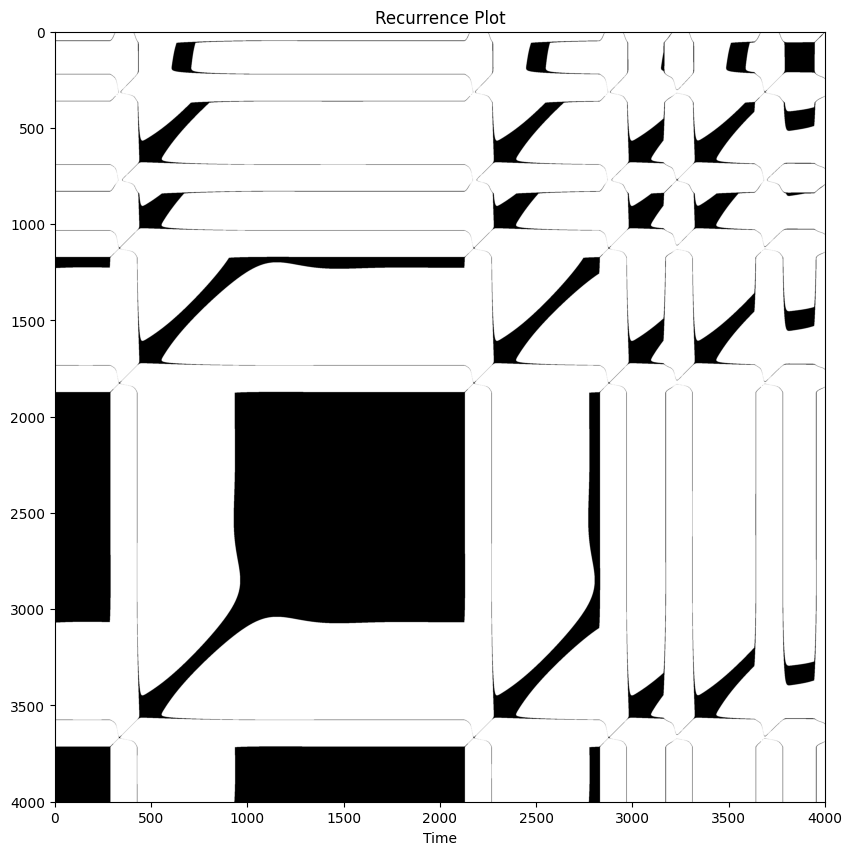

In [169]:
from pyrqa.computation import RPComputation
from pyrqa.image_generator import ImageGenerator

computation = RPComputation.create(settings)
result = computation.run()
img = ImageGenerator.generate_recurrence_plot(
    result.recurrence_matrix_reverse, "recurrence_plot_E.png"
)
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
# transpose the image to match the time axis
ax.imshow(img, cmap="binary")
ax.set_title("Recurrence Plot")
ax.set_xlabel("Time")

In [132]:
# img.show()

In [133]:
len(layer_1.cells), len(layer_2.cells), len(layer_1.stims)

(64, 16, 64)

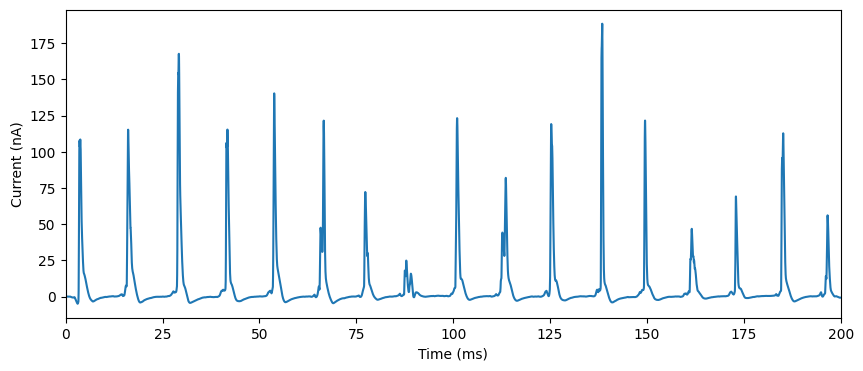

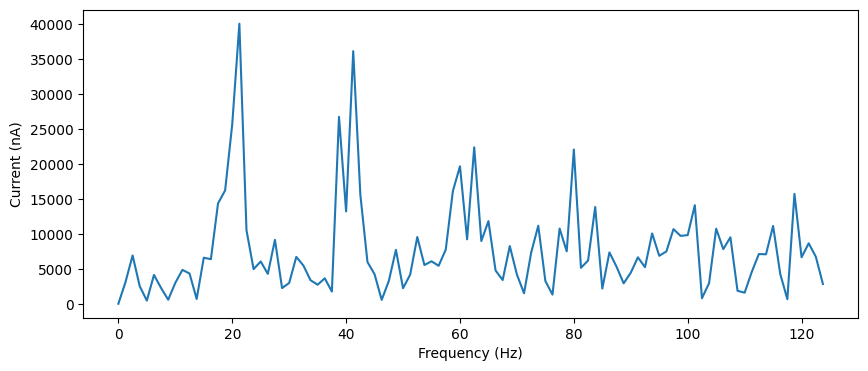

prob12=0.2, prob21=0.5, weight12=0.005, weight21=0.2, peak_freqs=[ 21.24734408 -21.24734408], peak_freqs_amp=[40057.20667027 40057.20667027]


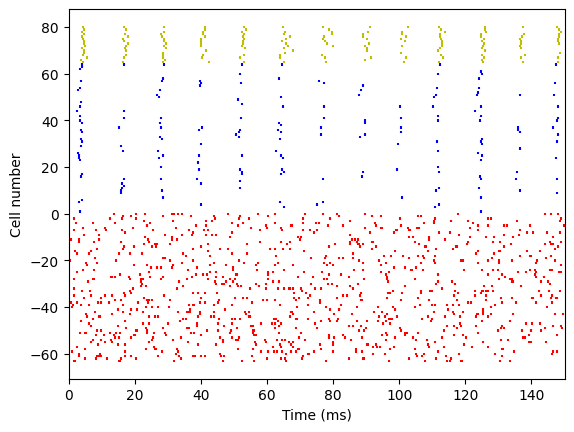

In [171]:
p12 = 0.2
p21 = 0.5
w12 = 0.005
w21 = 0.2
TIME_MS = 200
stim_params = {"number": 20, "interval": 10, "start": 0, "noise": 1}

layer_1, layer_2, _ = construct_network(
    prob1=0.1,
    prob2=0.2,
    prob12=p12,
    weight12=w12,
    prob21=p21,
    weight21=w21,
    stim_params=stim_params,
)
peak_freqs, peak_freqs_amp = plot_fft_and_get_peaks(
    layer_1, layer_2, time_ms=TIME_MS, plot=True
)
print(
    f"prob12={p12}, prob21={p21}, weight12={w12}, weight21={w21}, peak_freqs={peak_freqs}, peak_freqs_amp={peak_freqs_amp}"
)

plot_raster(layer_1, layer_2, time_ms=TIME_MS)

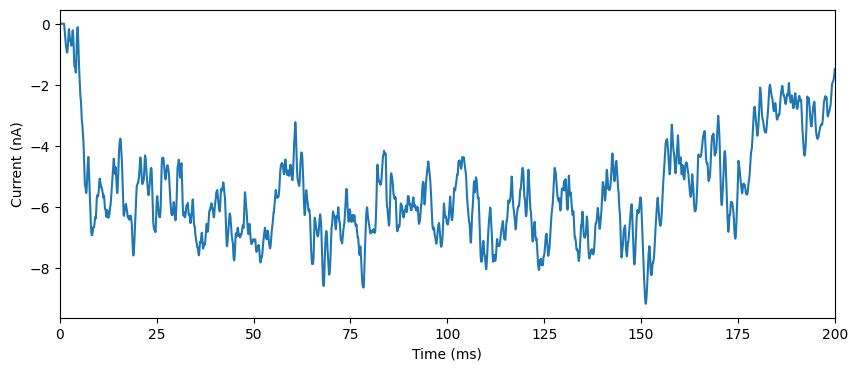

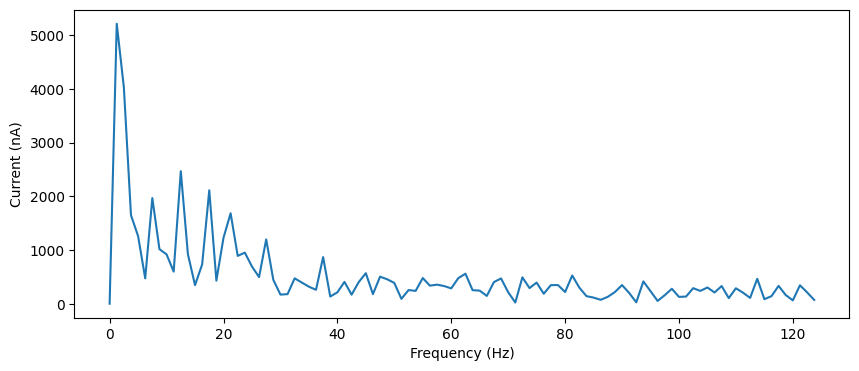

prob12=0.05, prob21=0.03, weight12=0.001, weight21=0.5, peak_freqs=[-1.24984377  1.24984377], peak_freqs_amp=[5214.26147973 5214.26147973]


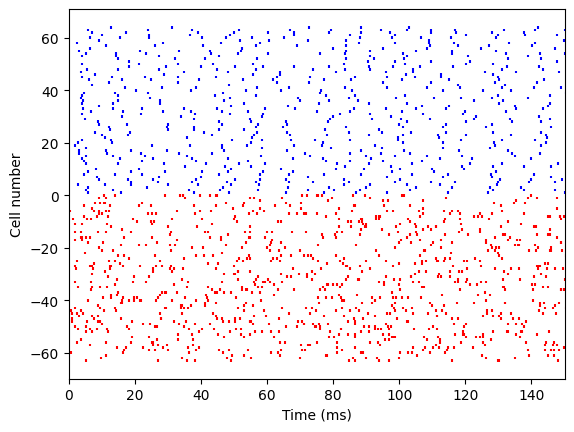

In [172]:
p12 = 0.05
p21 = 0.03
w12 = 0.001
w21 = 0.5
TIME_MS = 200

layer_1, layer_2, _ = construct_network(
    prob1=0.01,
    prob2=0.2,
    prob12=p12,
    weight12=w12,
    prob21=p21,
    weight21=w21,
    connect_between_layers=False,
)
peak_freqs, peak_freqs_amp = plot_fft_and_get_peaks(
    layer_1, layer_2, time_ms=TIME_MS, plot=True
)
print(
    f"prob12={p12}, prob21={p21}, weight12={w12}, weight21={w21}, peak_freqs={peak_freqs}, peak_freqs_amp={peak_freqs_amp}"
)

plot_raster(layer_1, layer_2, time_ms=TIME_MS)

In [101]:
len(layer_1.cells), len(layer_2.cells), len(layer_1.stims)

(64, 16, 64)

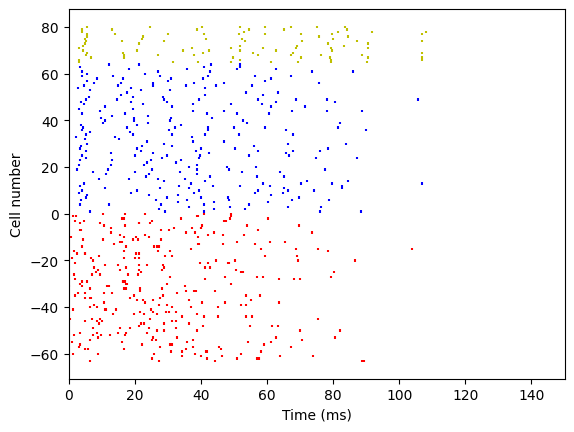

In [64]:
# recording spikes
spike_times_vec_E = h.Vector()
idvec_E = h.Vector()
for i, cell in enumerate(layer_1.cells):
    nc = h.NetCon(cell.soma(0.5)._ref_v, None, sec=cell.soma)
    nc.record(spike_times_vec_E, idvec_E, i)
del nc

spike_times_vec_I = h.Vector()
idvec_I = h.Vector()
for i, cell in enumerate(layer_2.cells):
    nc = h.NetCon(cell.soma(0.5)._ref_v, None, sec=cell.soma)
    nc.record(spike_times_vec_I, idvec_I, i)

spike_times_vec_stim = h.Vector()
idvec_stim = h.Vector()
for i, stim in enumerate(layer_1.stims):
    nc = h.NetCon(stim[0], None, sec=layer_1.cells[i].soma)
    nc.record(spike_times_vec_stim, idvec_stim, i)

h.finitialize(-65 * mV)
h.continuerun(TIME_MS * ms)

# plotting rasterplot
plt.figure()

stim_offset = -len(layer_1.cells)
inh_offset = len(layer_1.cells)

for t, id in zip(spike_times_vec_E, idvec_E):
    plt.vlines(t, id + 0.5, id + 1.5, color="b")

for t, id in zip(spike_times_vec_I, idvec_I):
    plt.vlines(t, id + inh_offset + 0.5, id + inh_offset + 1.5, color="y")

for t, id in zip(spike_times_vec_stim, idvec_stim):
    plt.vlines(t, id + stim_offset + 0.5, id + stim_offset + 1.5, color="r")

plt.xlabel("Time (ms)")
plt.ylabel("Cell number")
plt.xlim(0, 150)
plt.show()

In [35]:
obj = layer_1.cells[0].soma(0.5)

# print all properties starting with _ref_
ref_properties = [prop for prop in dir(obj) if prop.startswith("_ref_")]

In [36]:
ref_properties

[]

(0.0, 150.0)

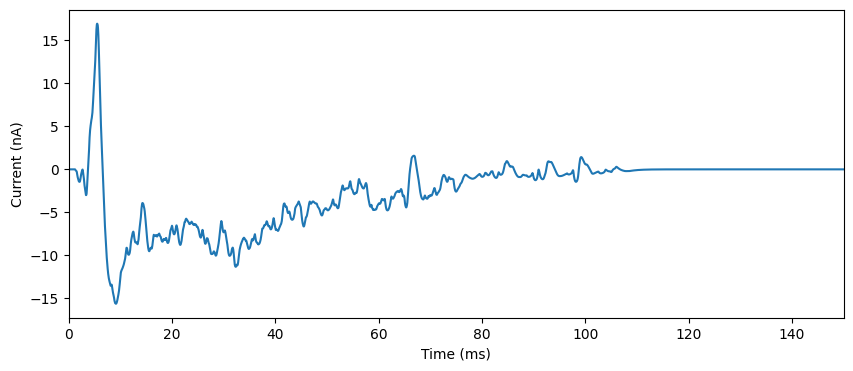

In [65]:
# sum of all currents
fig, ax = plt.subplots(1, 1, figsize=(10, 4))

current_vectors = []
for cell in layer_1.cells:
    # total synaptic current
    vec = h.Vector().record(cell.syn_E._ref_i)
    current_vectors.append(vec)
    vec2 = h.Vector().record(cell.syn_I._ref_i)
    current_vectors.append(vec2)

for cell in layer_2.cells:
    # total synaptic current
    vec = h.Vector().record(cell.syn_E._ref_i)
    current_vectors.append(vec)
    vec2 = h.Vector().record(cell.syn_I._ref_i)
    current_vectors.append(vec2)

h.finitialize(-65 * mV)
h.continuerun(200 * ms)

sum = np.zeros(len(current_vectors[0]))
for vec in current_vectors:
    sum += np.array(vec)

ax.plot(time, sum)
ax.set_xlabel("Time (ms)")
ax.set_ylabel("Current (nA)")
ax.set_xlim(0, 150)

4 4
19 19


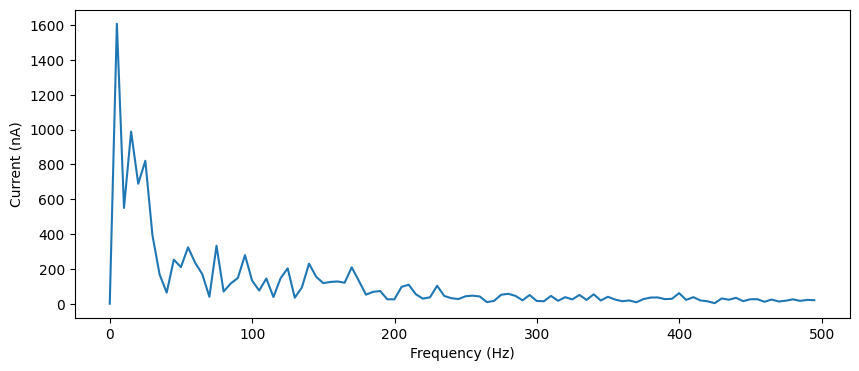

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.0005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1608.32729382 1608.32729382]


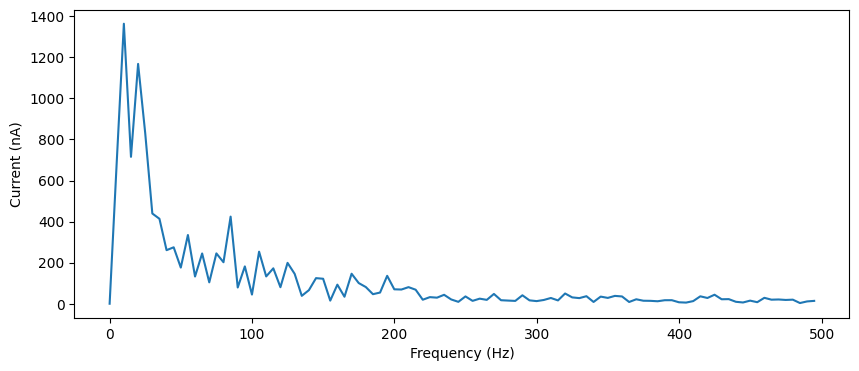

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.001, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1363.65167233 1363.65167233]


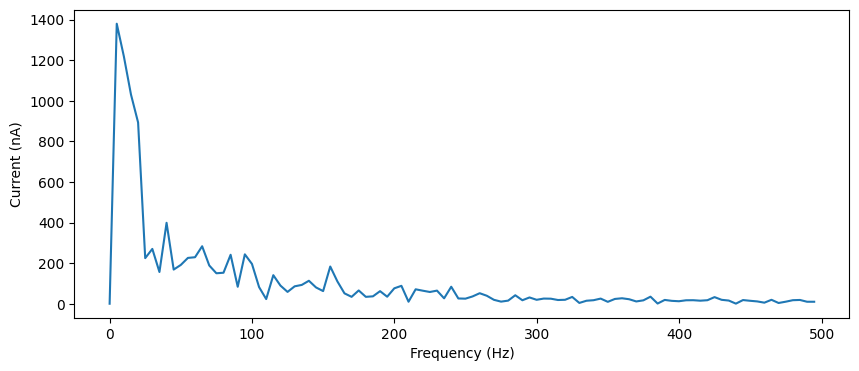

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1379.34046935 1379.34046935]


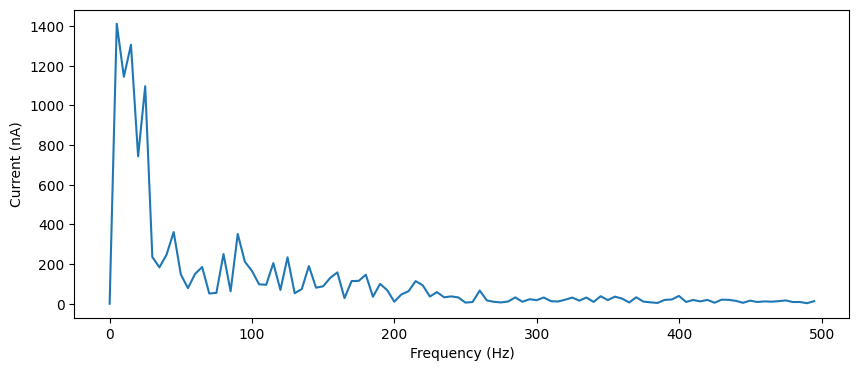

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.002, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1412.45334305 1412.45334305]


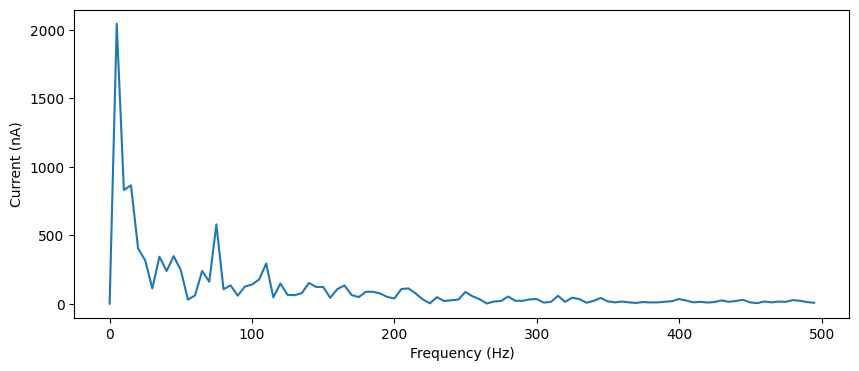

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.0025, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2046.42419269 2046.42419269]


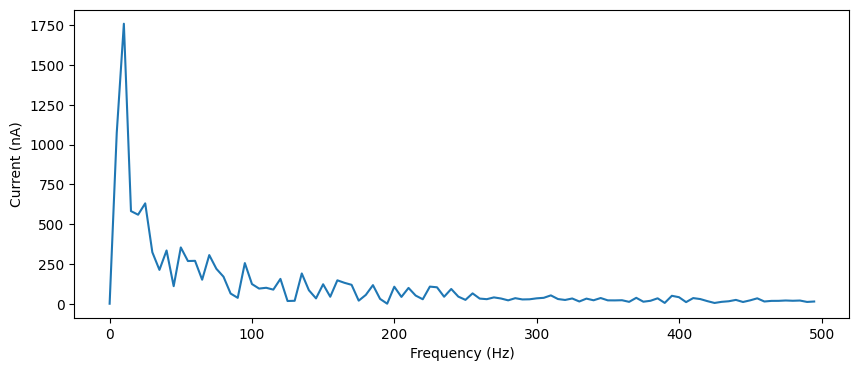

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.003, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[1758.79807858 1758.79807858]


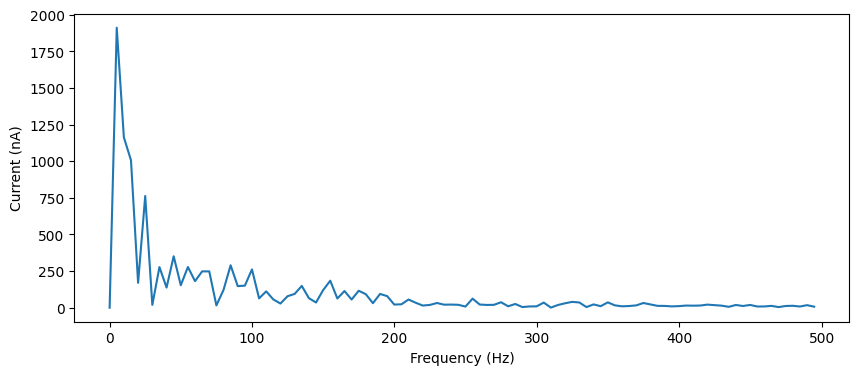

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1911.89060858 1911.89060858]


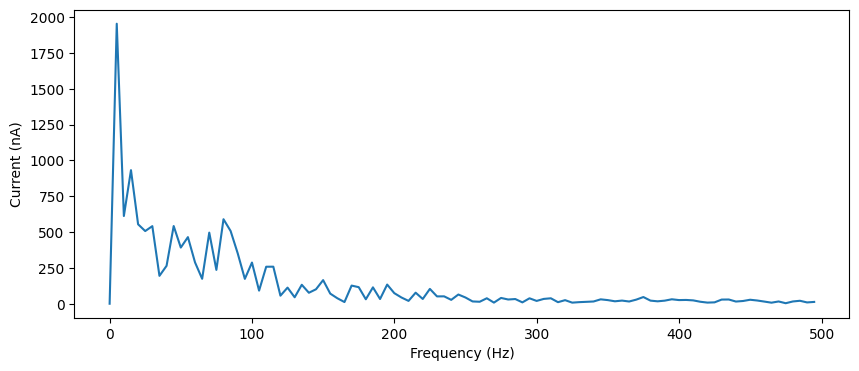

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1954.08361929 1954.08361929]


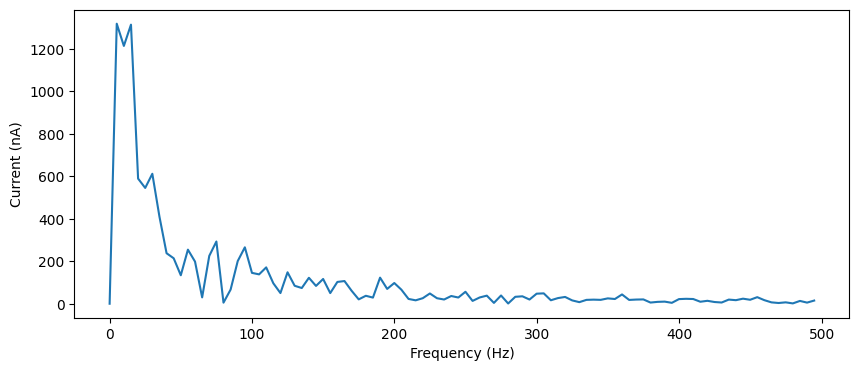

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1318.20388115 1318.20388115]


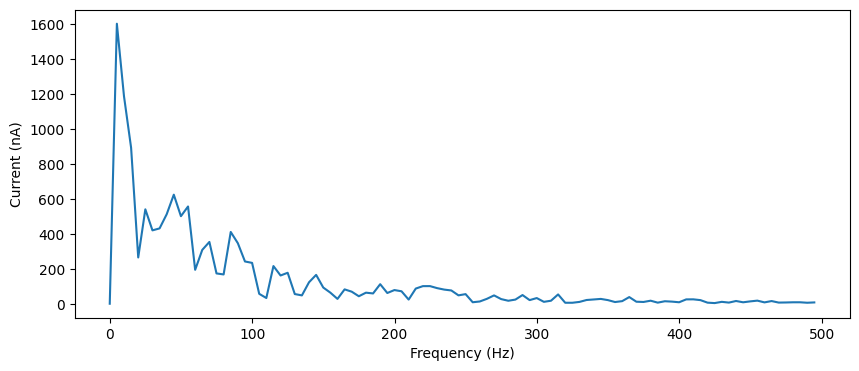

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1604.32436784 1604.32436784]


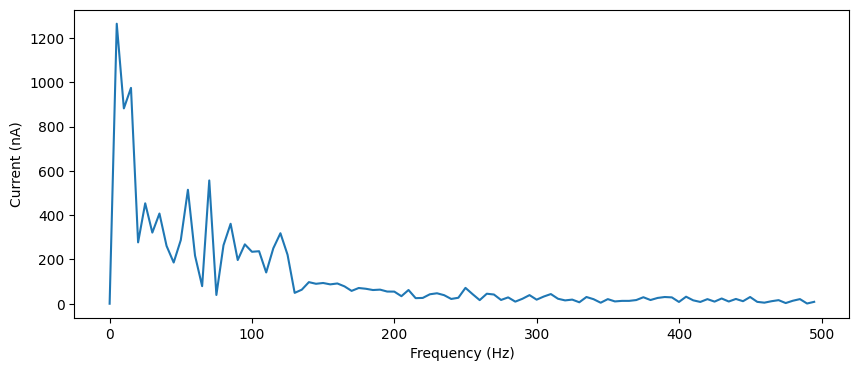

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.0055, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1264.71162839 1264.71162839]


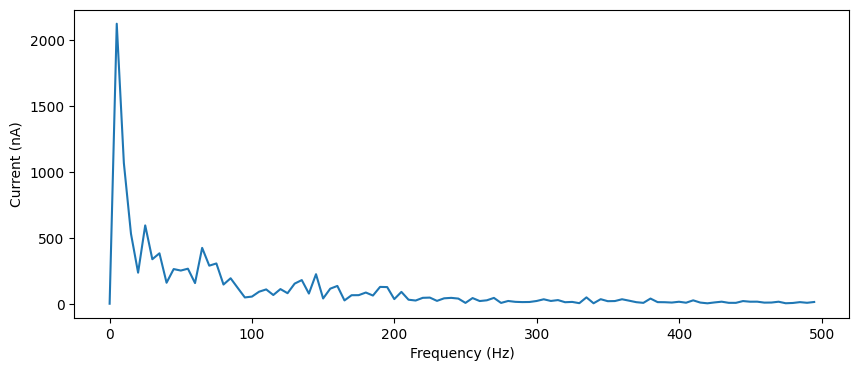

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.006, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2125.64158818 2125.64158818]


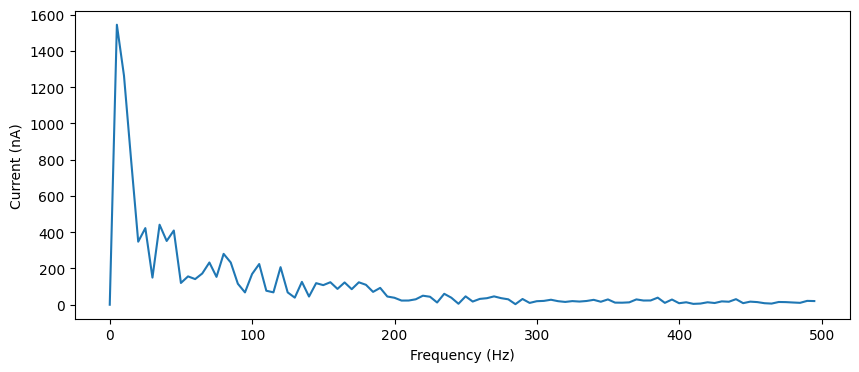

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1543.74404533 1543.74404533]


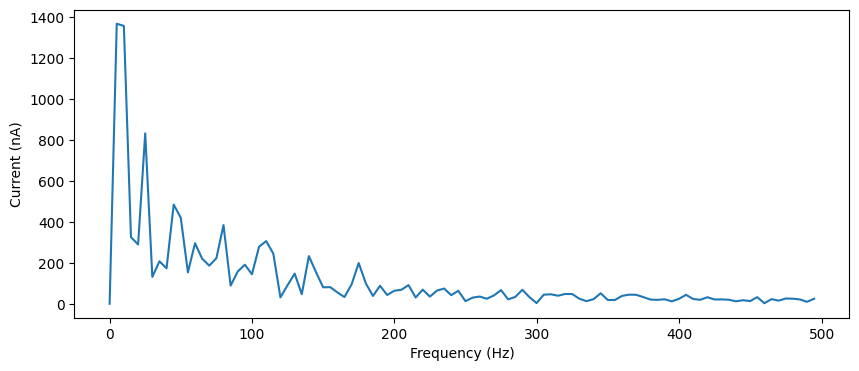

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1368.64003974 1368.64003974]


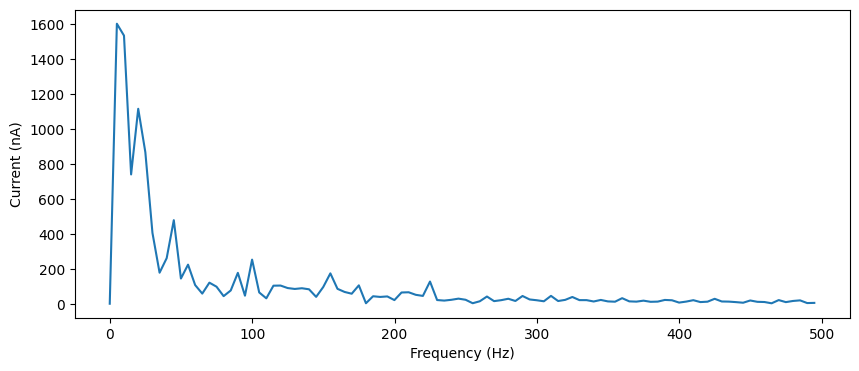

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.0075, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1603.45111206 1603.45111206]


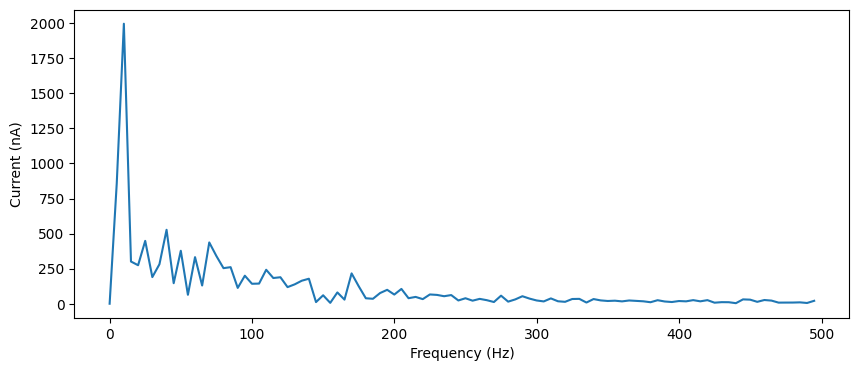

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.008, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1995.93859165 1995.93859165]


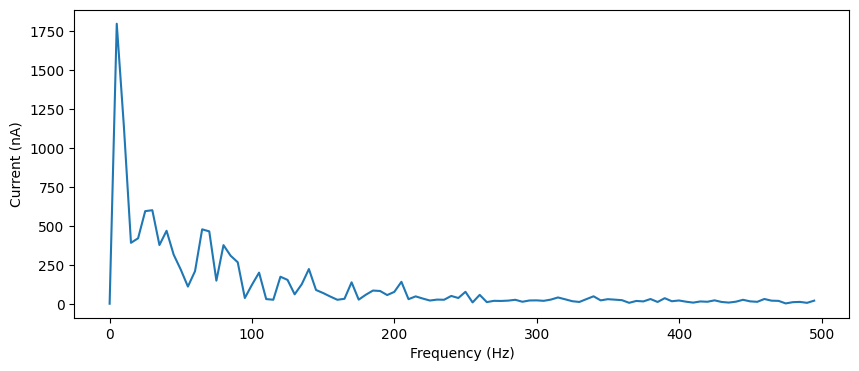

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1798.80160769 1798.80160769]


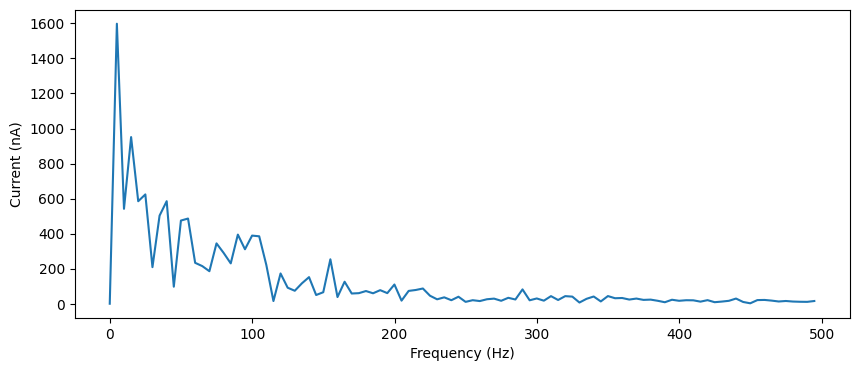

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1598.24482266 1598.24482266]


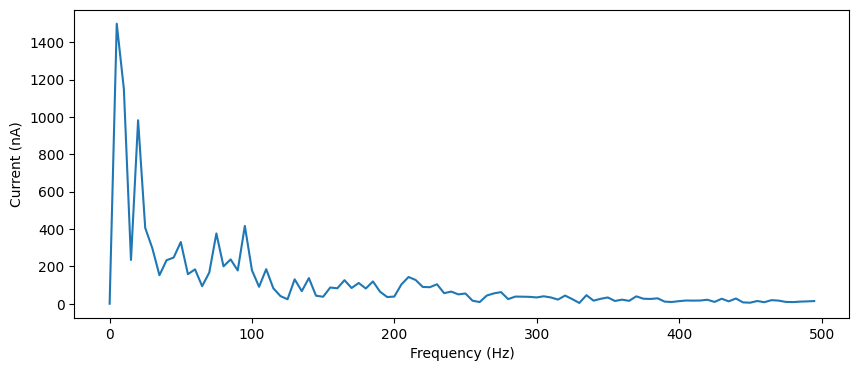

prob12=0.05, prob21=0.05, weight12=0.0005, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1499.09367518 1499.09367518]


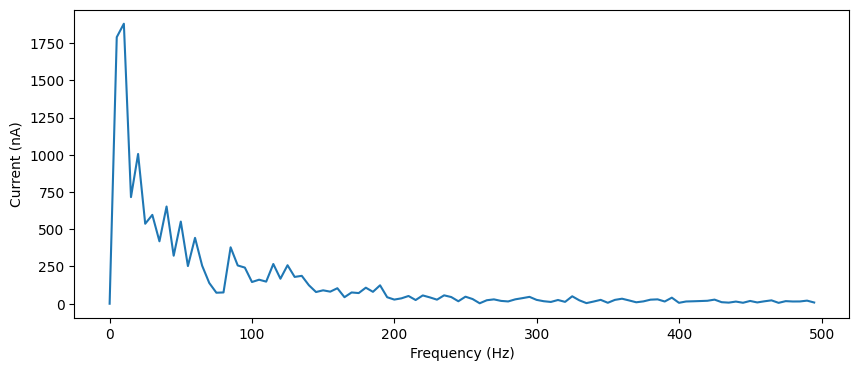

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.0005, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1879.62385856 1879.62385856]


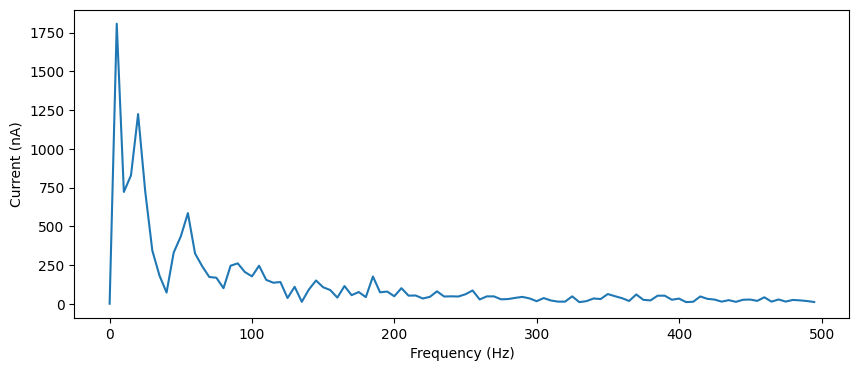

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1807.89016444 1807.89016444]


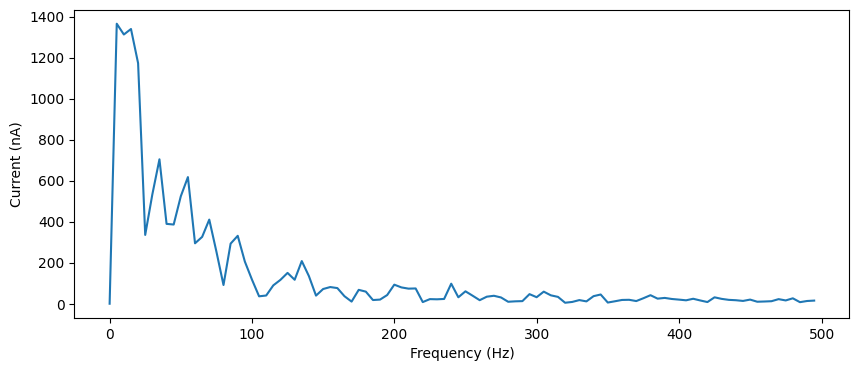

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1365.77914906 1365.77914906]


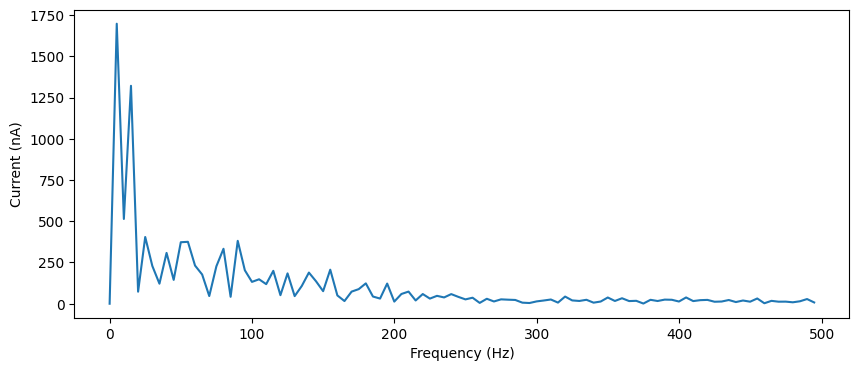

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.002, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1697.54835714 1697.54835714]


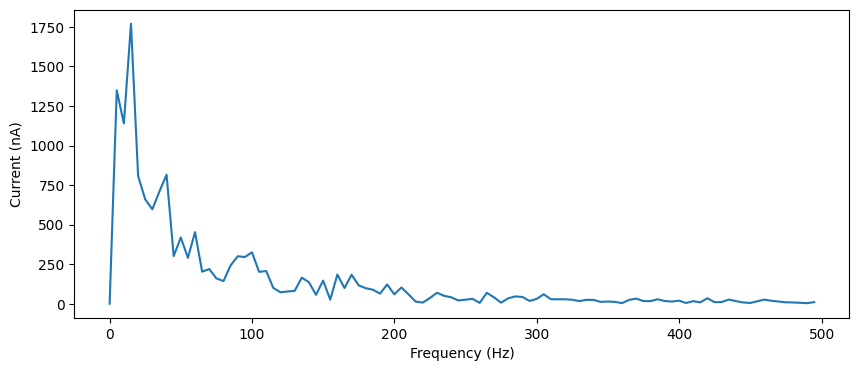

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.0025, peak_freqs=[ 14.99250375 -14.99250375], peak_freqs_amp=[1770.3808052 1770.3808052]


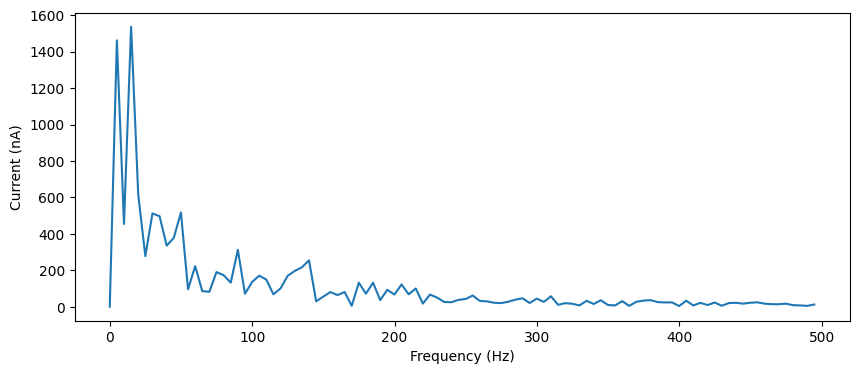

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.003, peak_freqs=[ 14.99250375 -14.99250375], peak_freqs_amp=[1536.78051967 1536.78051967]


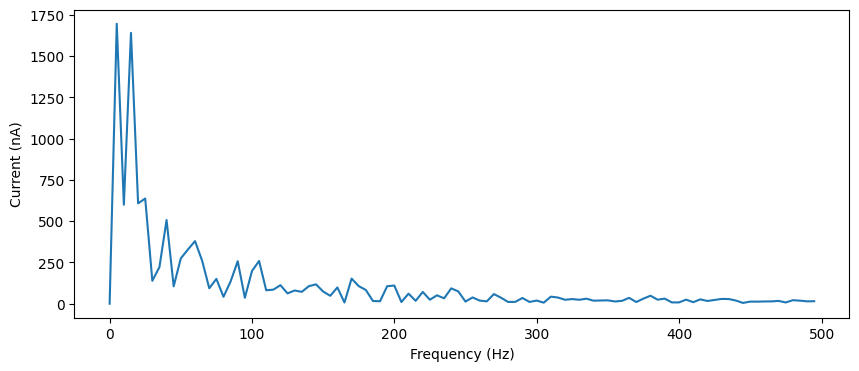

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1695.1988924 1695.1988924]


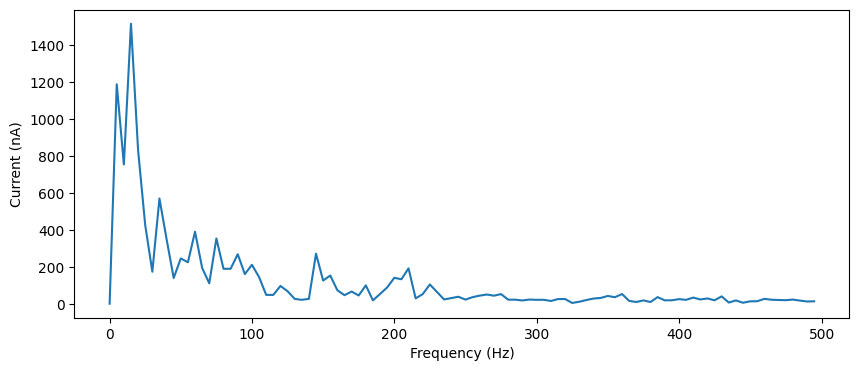

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.004, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[1517.99936397 1517.99936397]


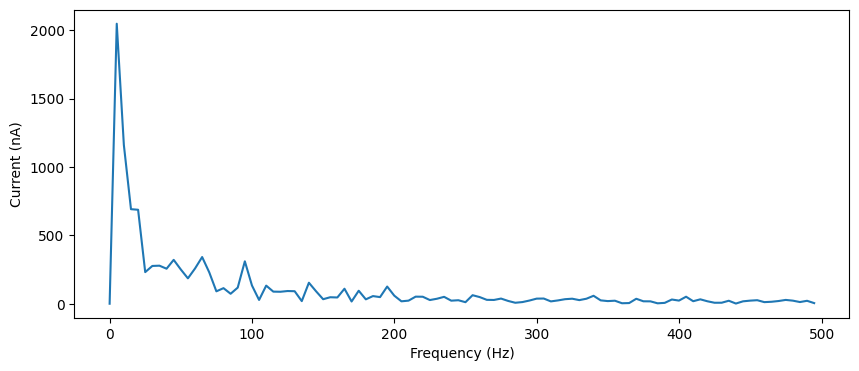

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2048.14109979 2048.14109979]


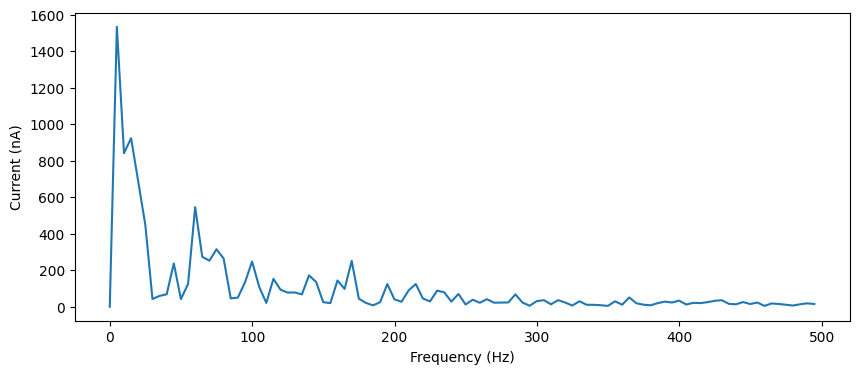

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1535.14490021 1535.14490021]


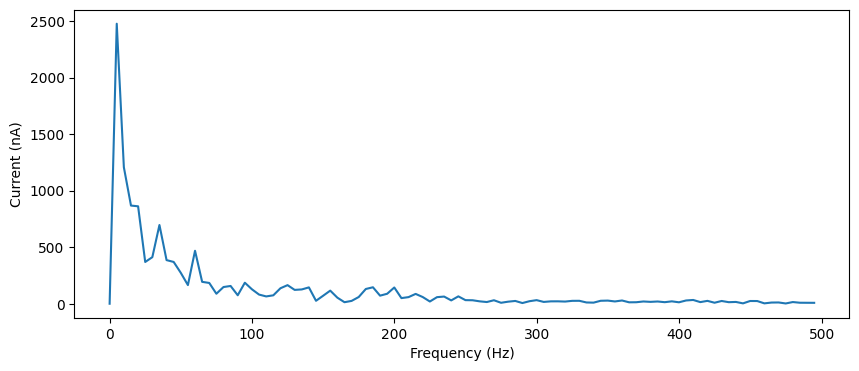

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.0055, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2476.59310688 2476.59310688]


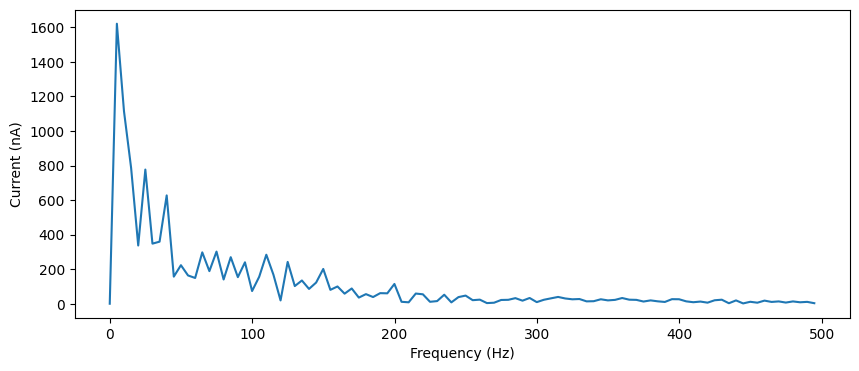

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.006, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1620.99909619 1620.99909619]


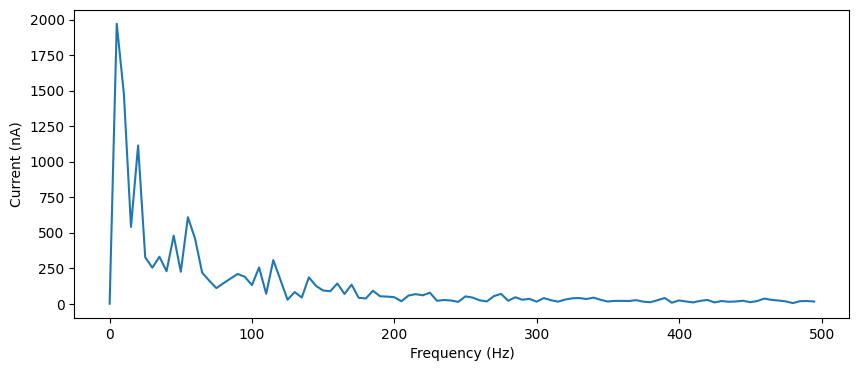

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1970.38879754 1970.38879754]


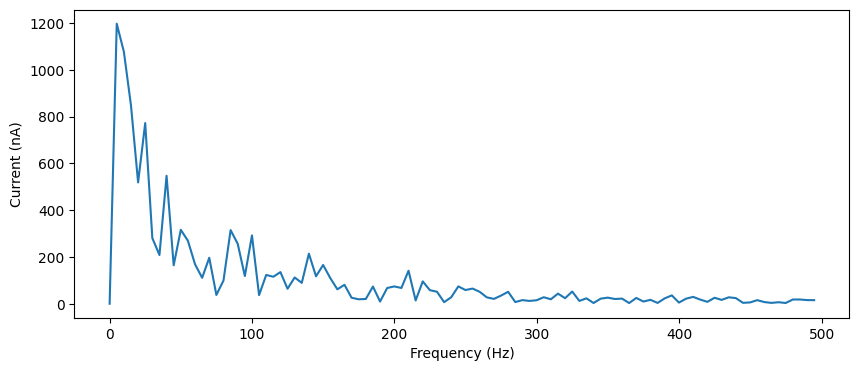

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1196.67583222 1196.67583222]


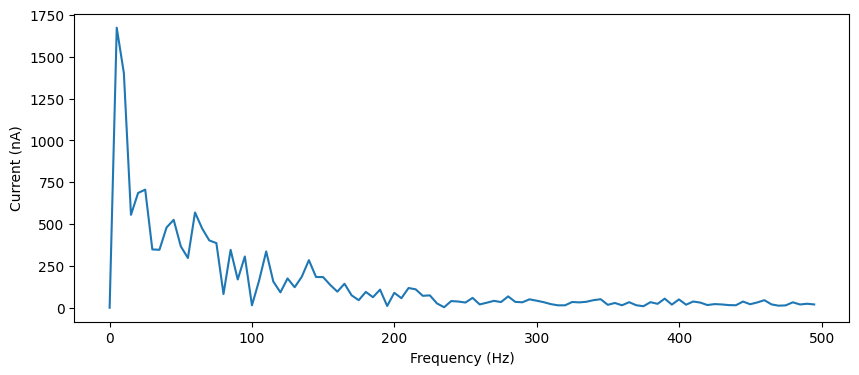

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.0075, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1673.11778856 1673.11778856]


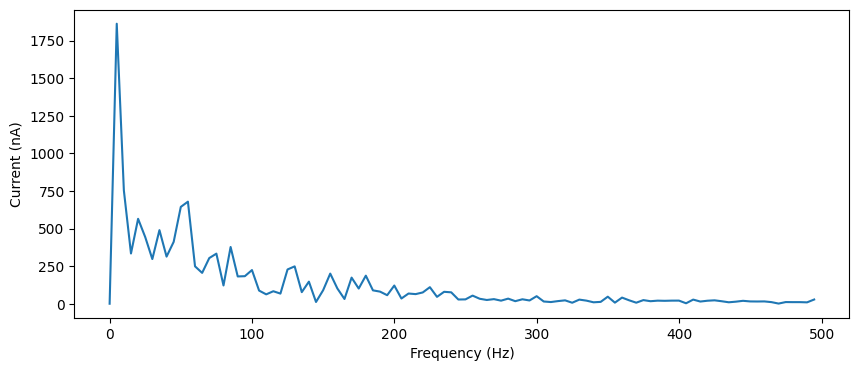

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1862.50989069 1862.50989069]


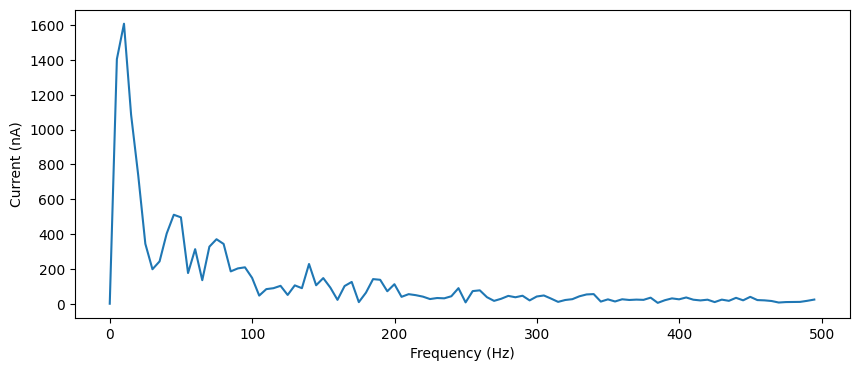

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.0085, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1608.87416999 1608.87416999]


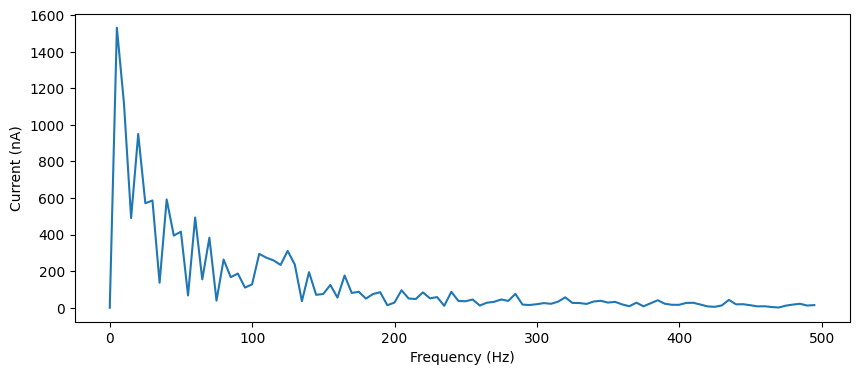

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1531.43003027 1531.43003027]


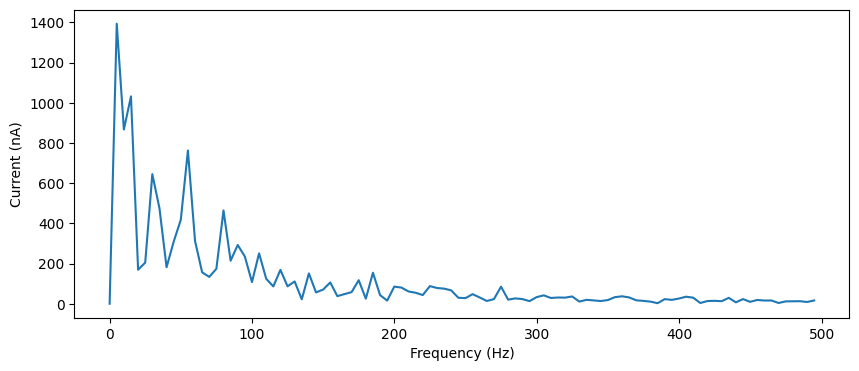

prob12=0.05, prob21=0.05, weight12=0.001, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1393.15894376 1393.15894376]


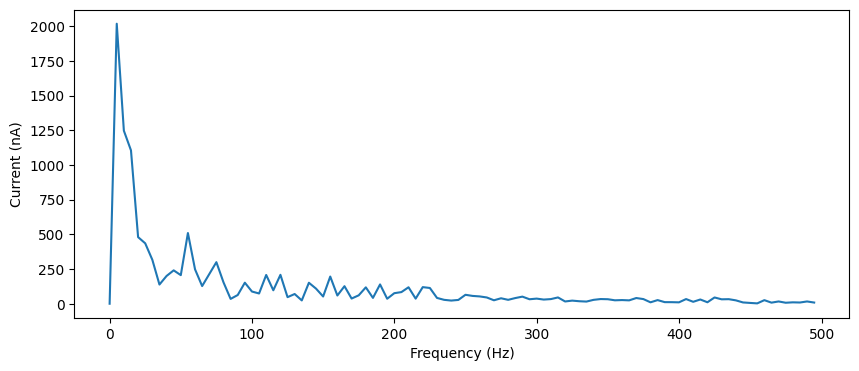

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.0005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2018.05198782 2018.05198782]


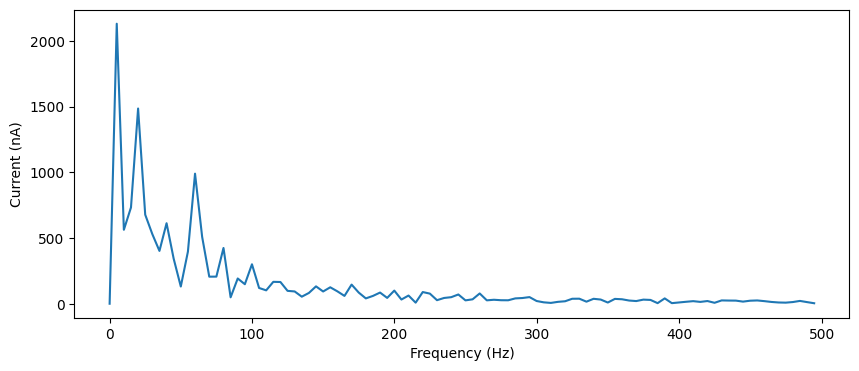

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2129.71269115 2129.71269115]


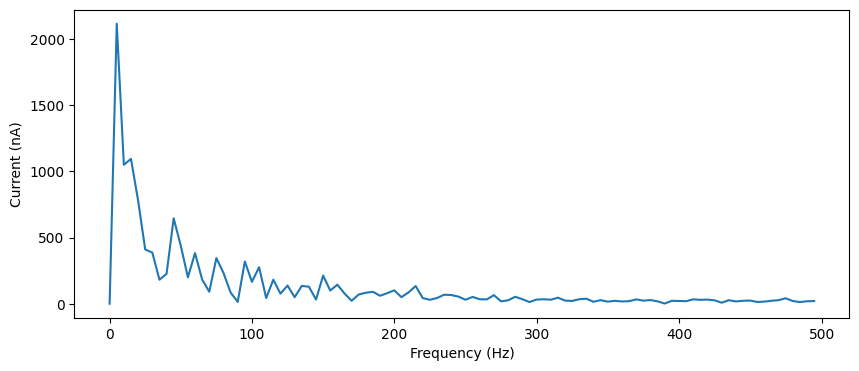

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2114.21857777 2114.21857777]


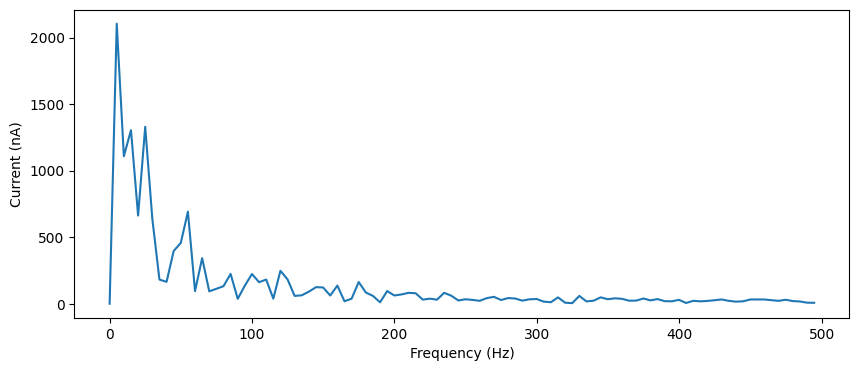

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.002, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2104.53997565 2104.53997565]


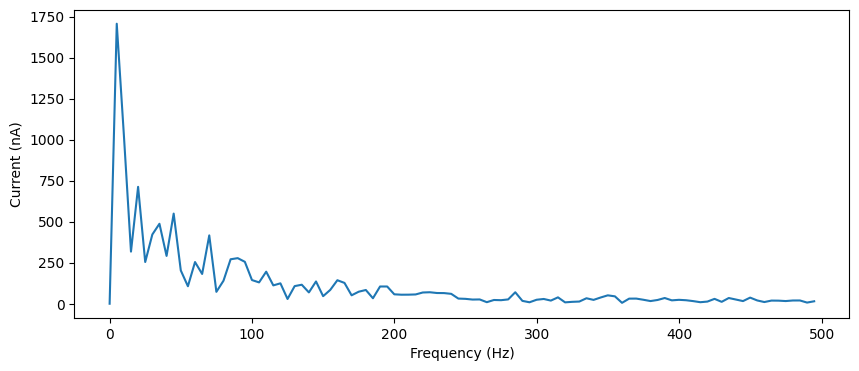

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.0025, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1707.19187762 1707.19187762]


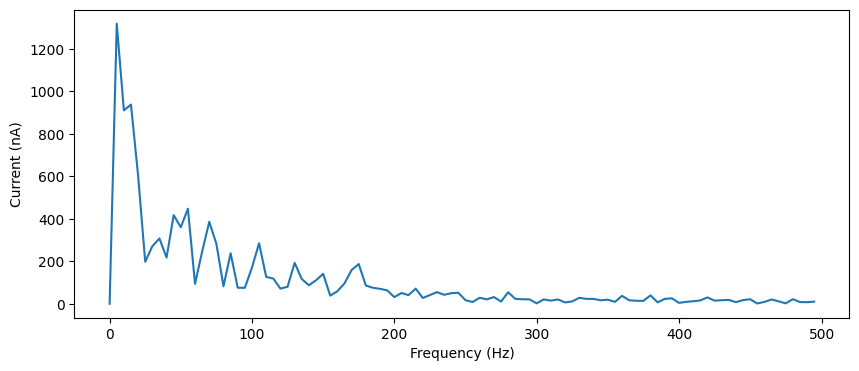

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1317.958743 1317.958743]


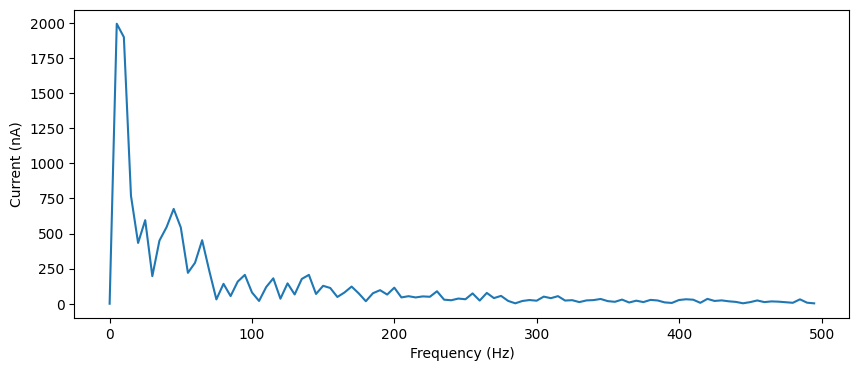

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1994.09428602 1994.09428602]


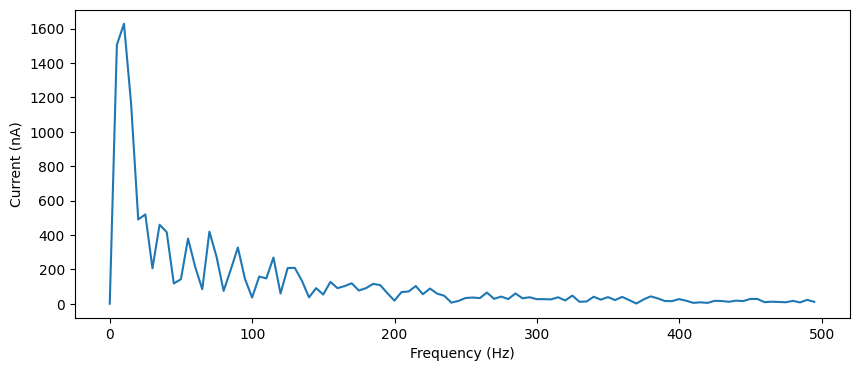

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.004, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[1628.02844784 1628.02844784]


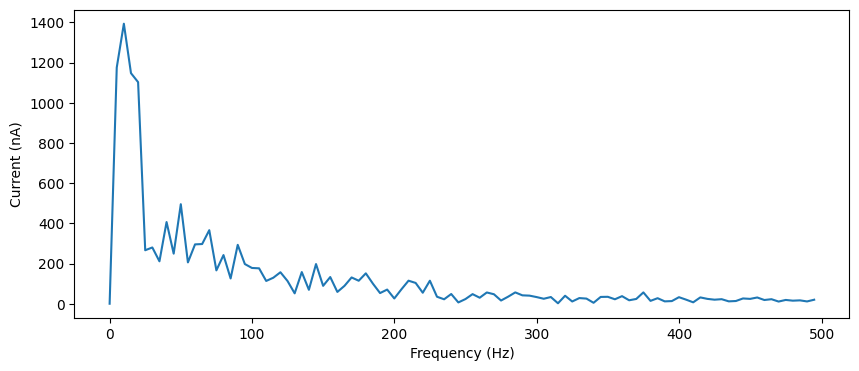

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.0045000000000000005, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1393.65728251 1393.65728251]


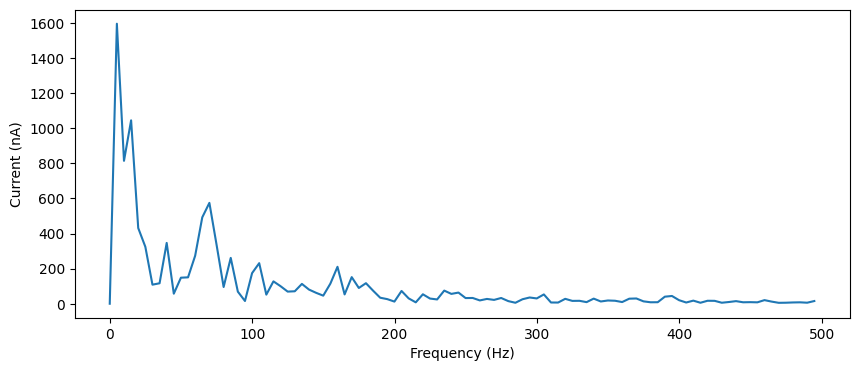

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1595.40663069 1595.40663069]


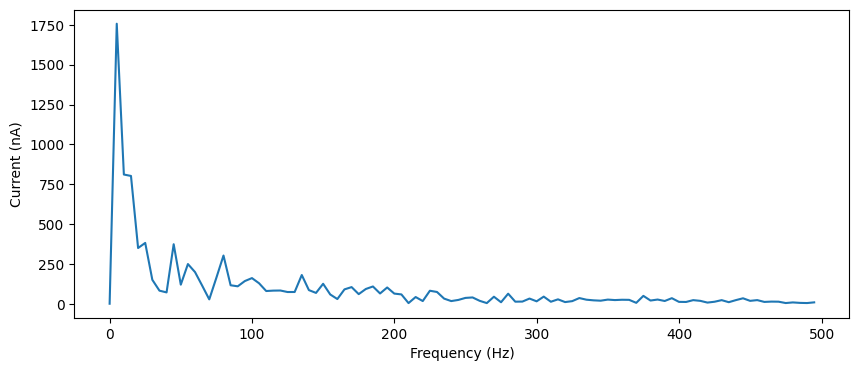

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.0055, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1756.84098738 1756.84098738]


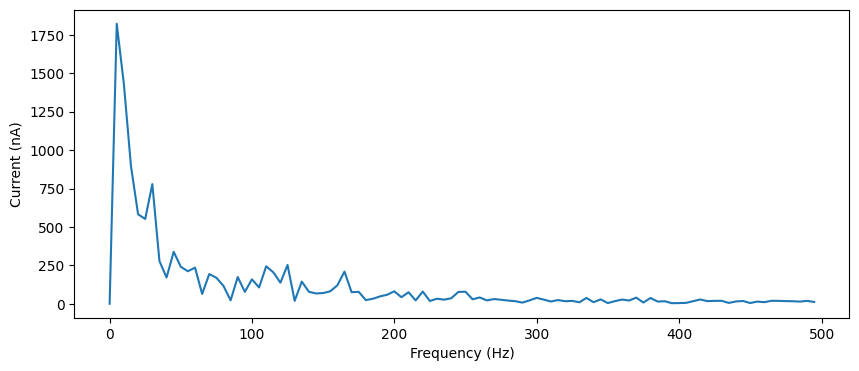

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.006, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1822.68276749 1822.68276749]


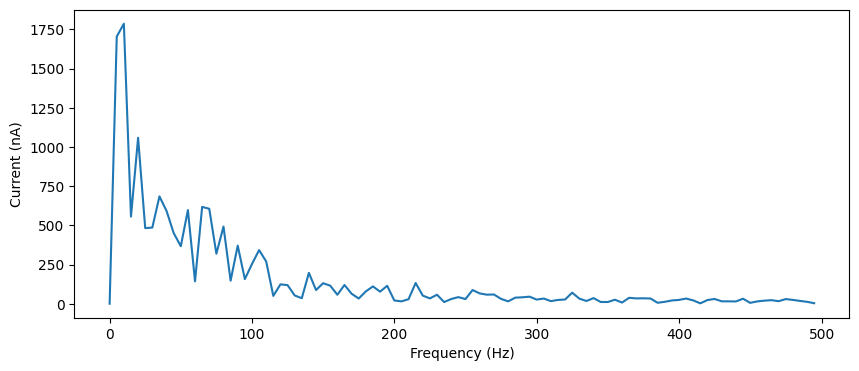

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.006500000000000001, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1786.62759417 1786.62759417]


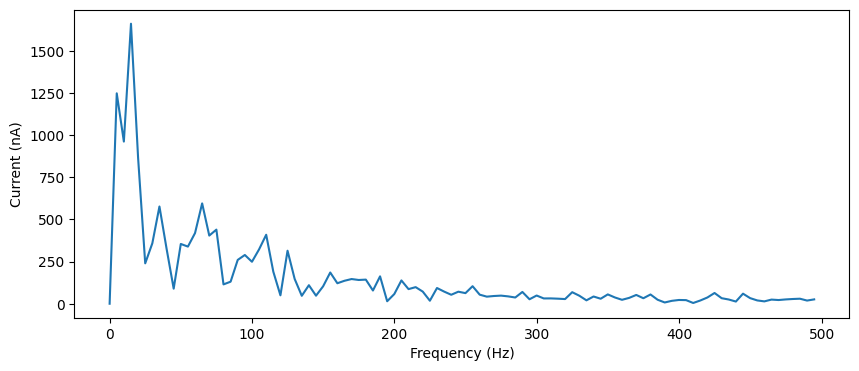

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.007000000000000001, peak_freqs=[ 14.99250375 -14.99250375], peak_freqs_amp=[1661.14478682 1661.14478682]


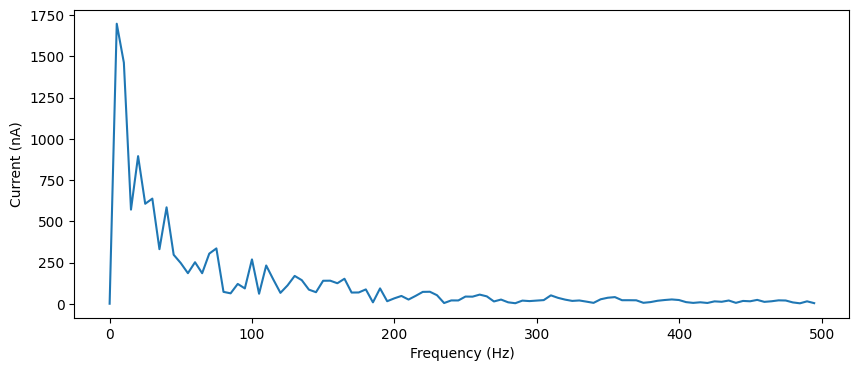

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.0075, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1698.74585481 1698.74585481]


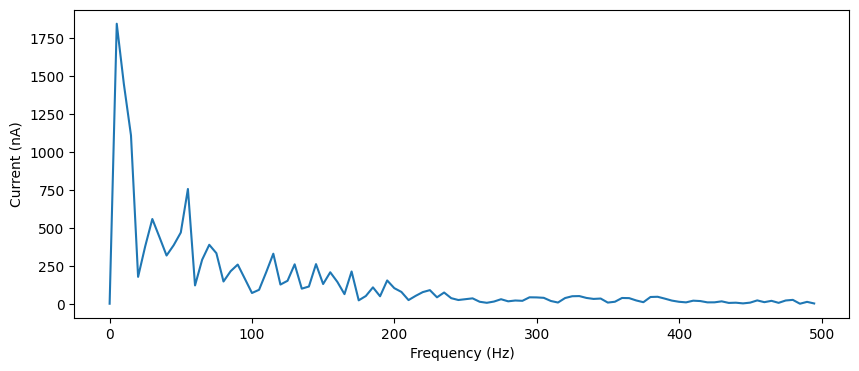

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1844.03333569 1844.03333569]


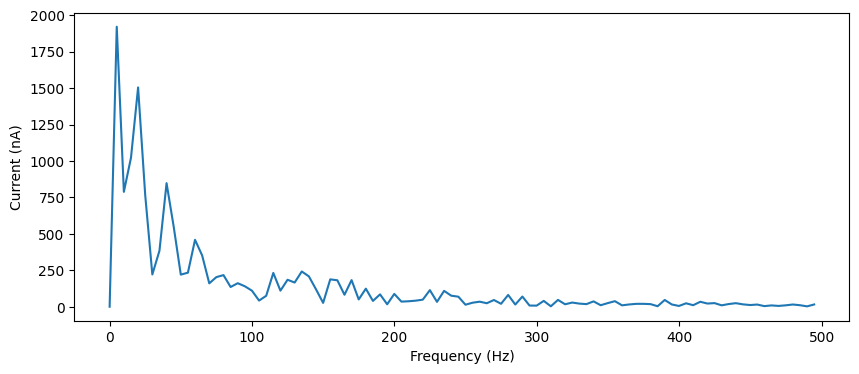

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1920.81874342 1920.81874342]


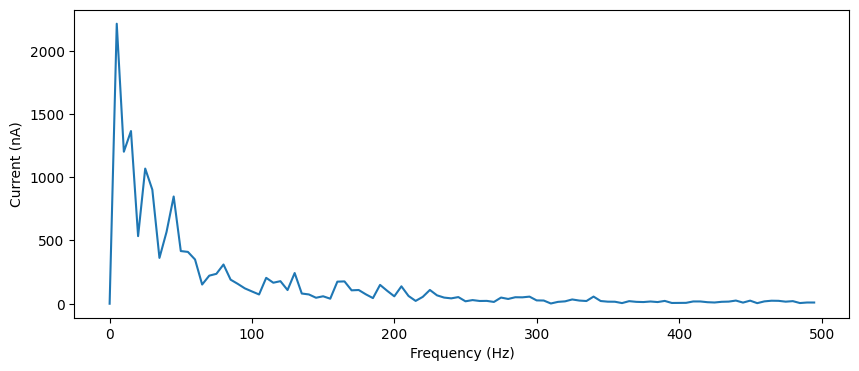

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2214.04208565 2214.04208565]


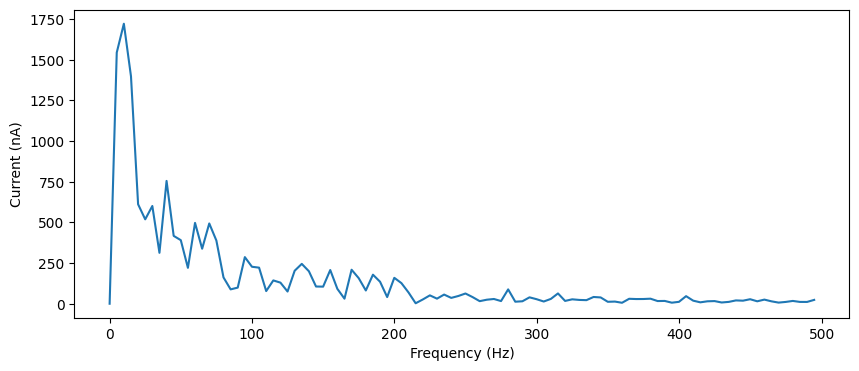

prob12=0.05, prob21=0.05, weight12=0.0015, weight21=0.009500000000000001, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[1721.87543515 1721.87543515]


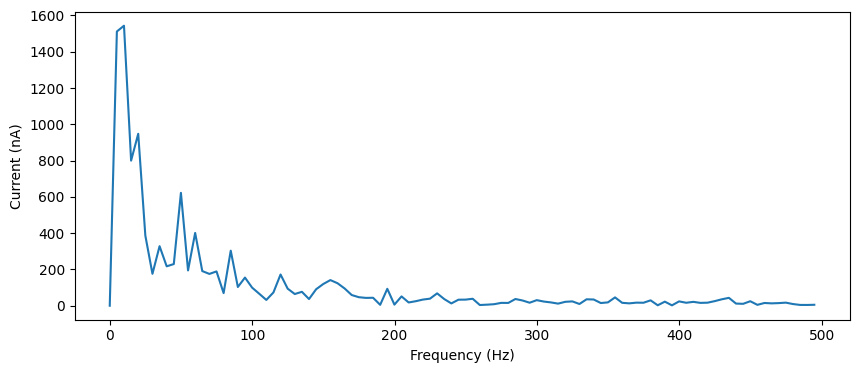

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.0005, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1543.40438869 1543.40438869]


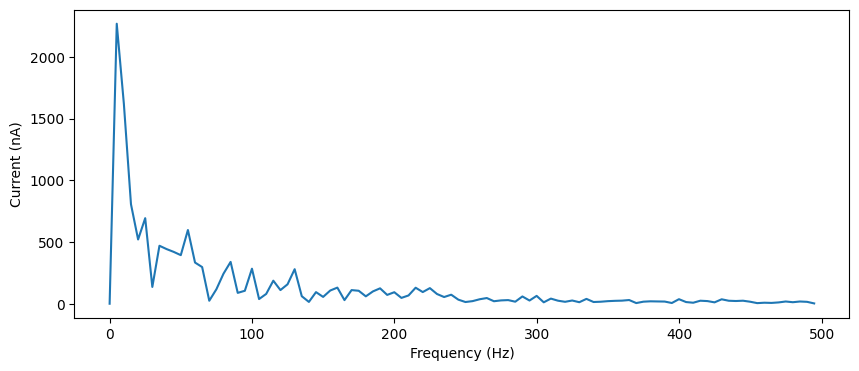

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2268.50856809 2268.50856809]


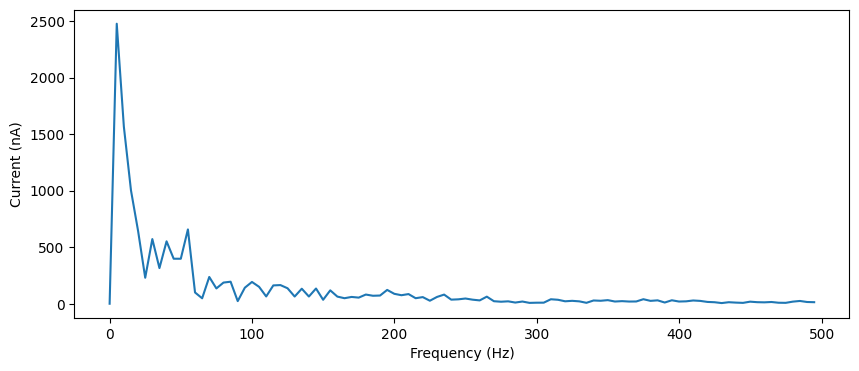

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2475.84517323 2475.84517323]


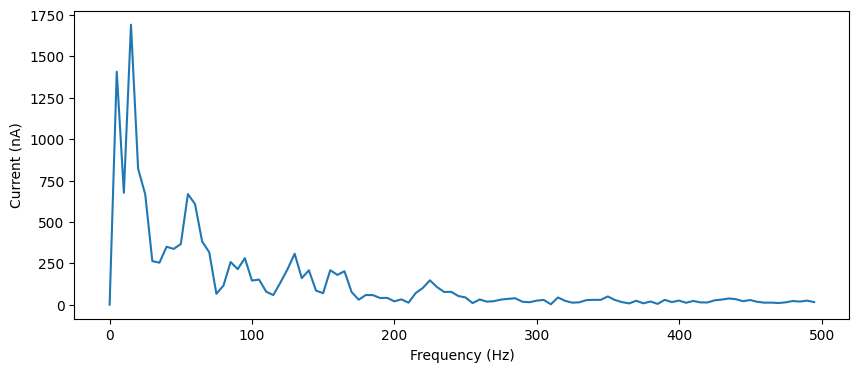

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.002, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[1691.10271414 1691.10271414]


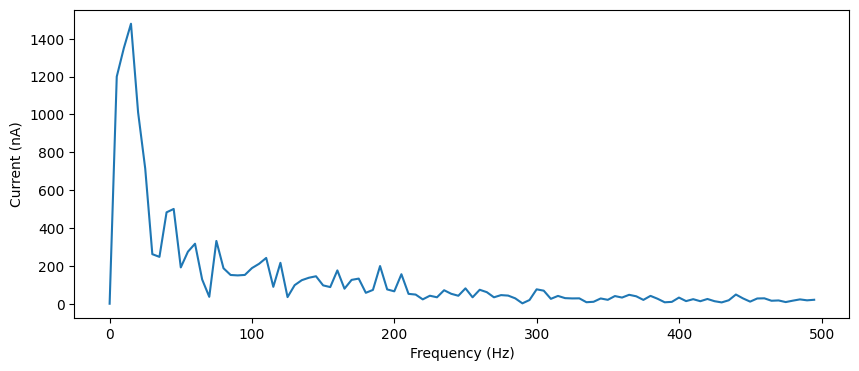

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.0025, peak_freqs=[ 14.99250375 -14.99250375], peak_freqs_amp=[1479.47244368 1479.47244368]


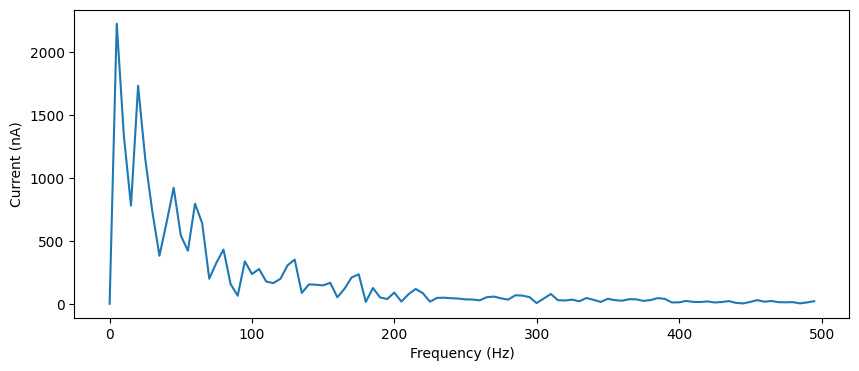

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2228.63268875 2228.63268875]


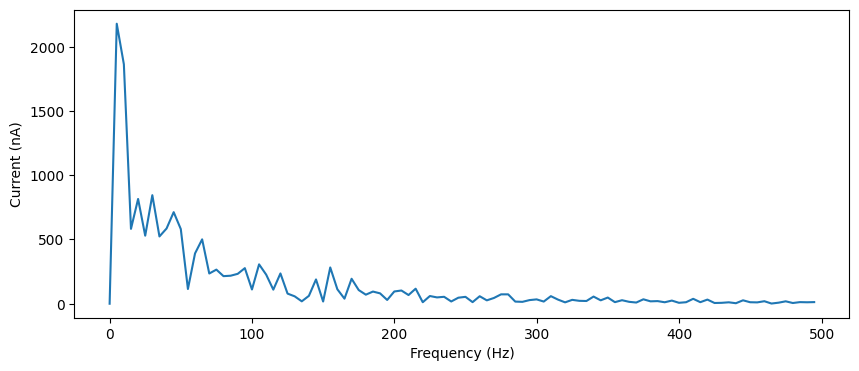

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2179.4176693 2179.4176693]


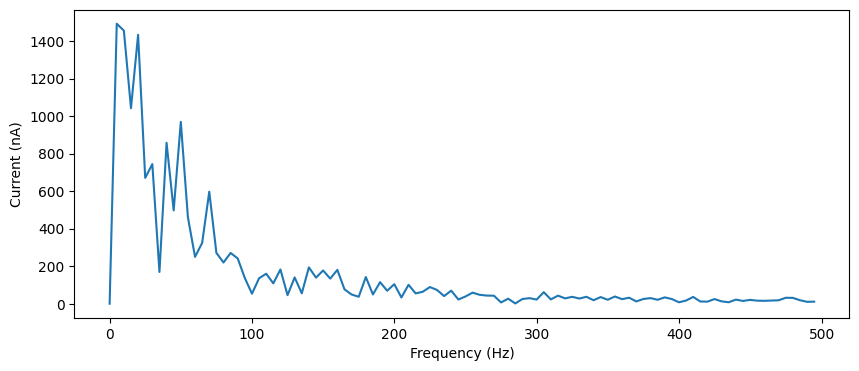

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1493.09723782 1493.09723782]


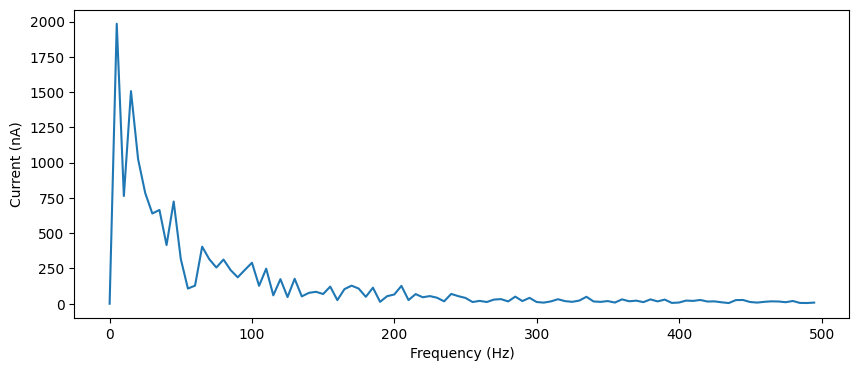

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1985.57334843 1985.57334843]


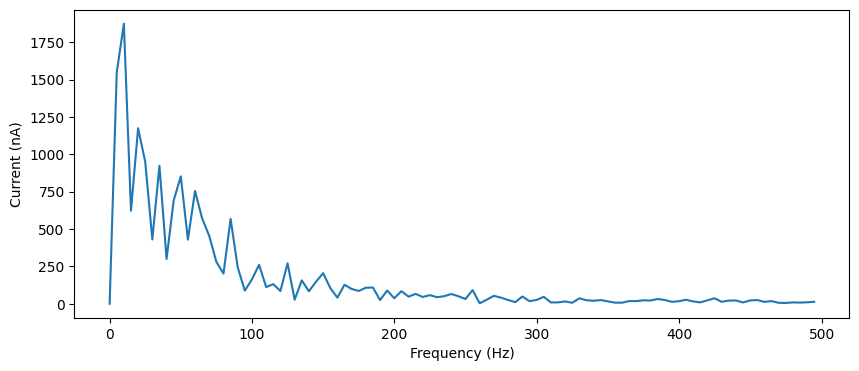

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.005000000000000001, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1874.74886522 1874.74886522]


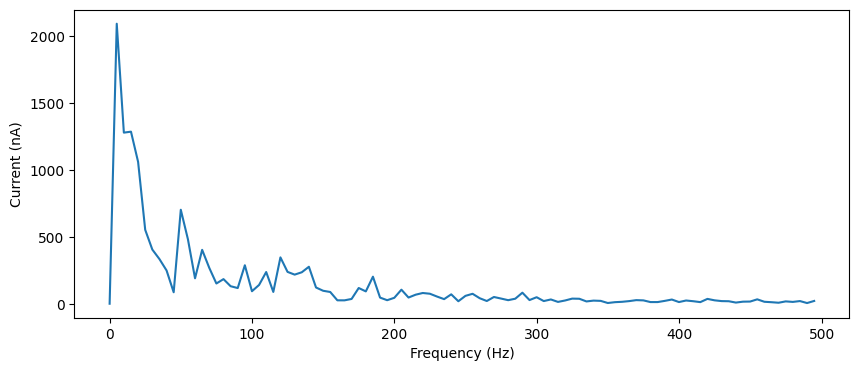

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.0055, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2091.14654944 2091.14654944]


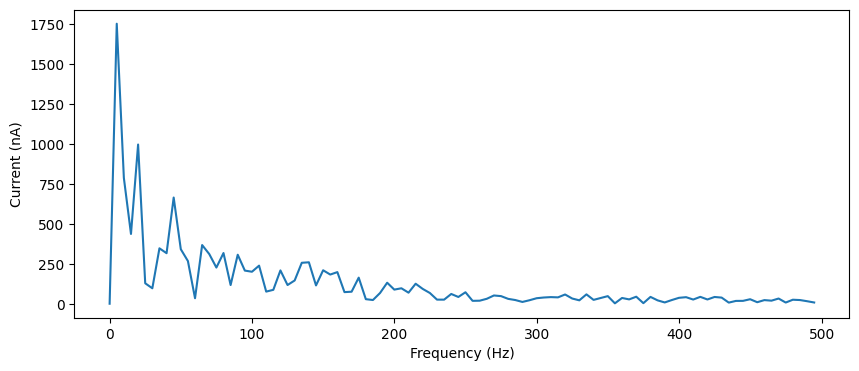

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.006, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1752.13568205 1752.13568205]


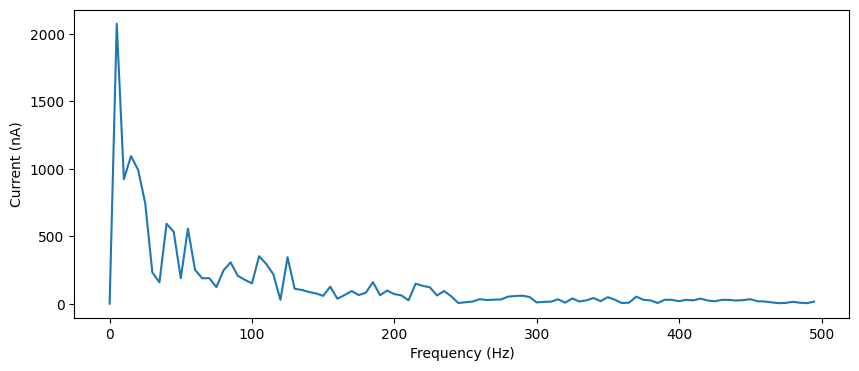

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2074.13832647 2074.13832647]


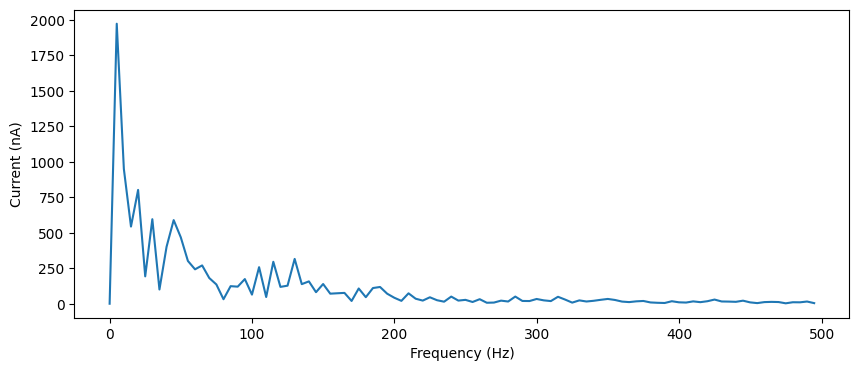

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1972.80861544 1972.80861544]


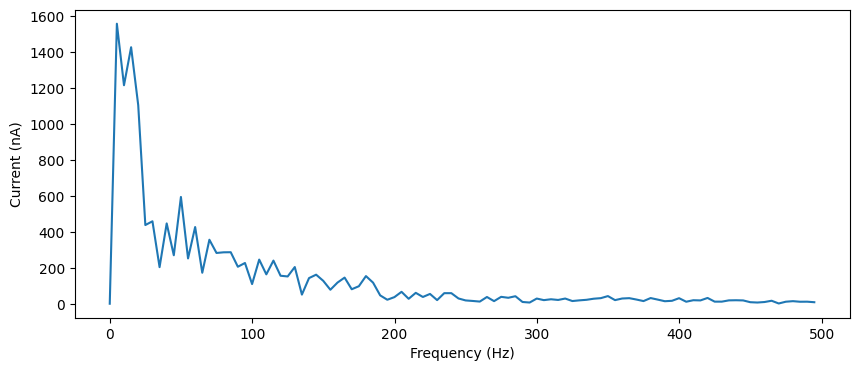

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.0075, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1558.64931207 1558.64931207]


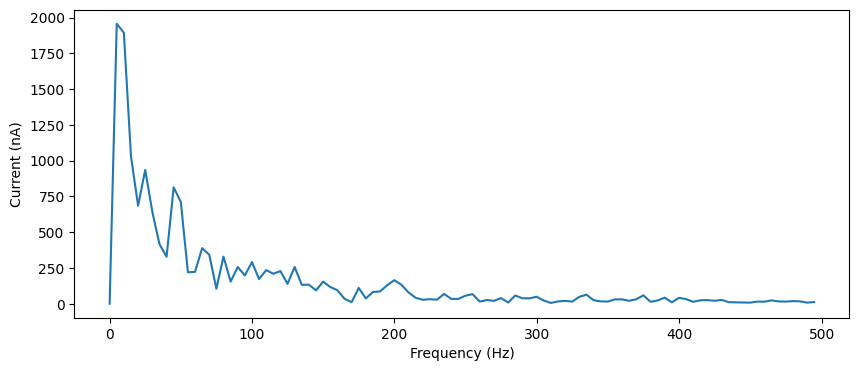

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1957.17039549 1957.17039549]


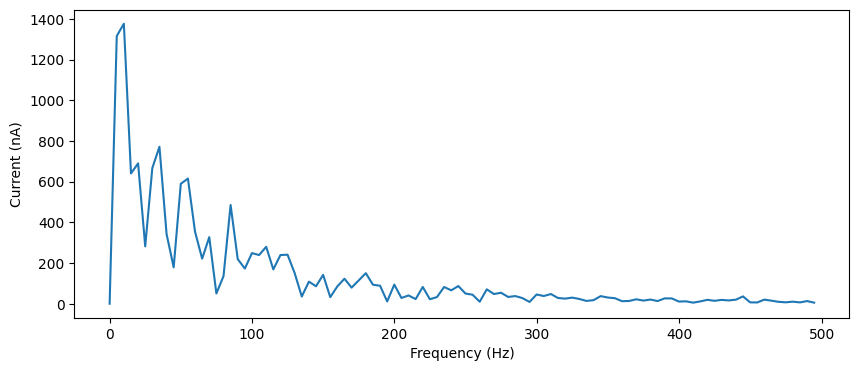

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.0085, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1376.4229759 1376.4229759]


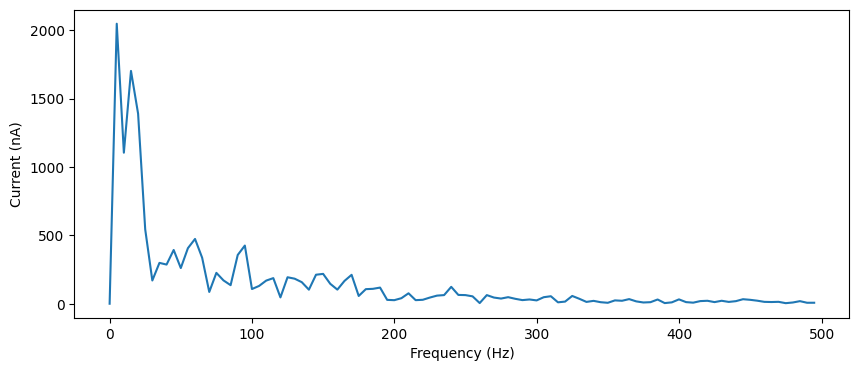

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2048.44038577 2048.44038577]


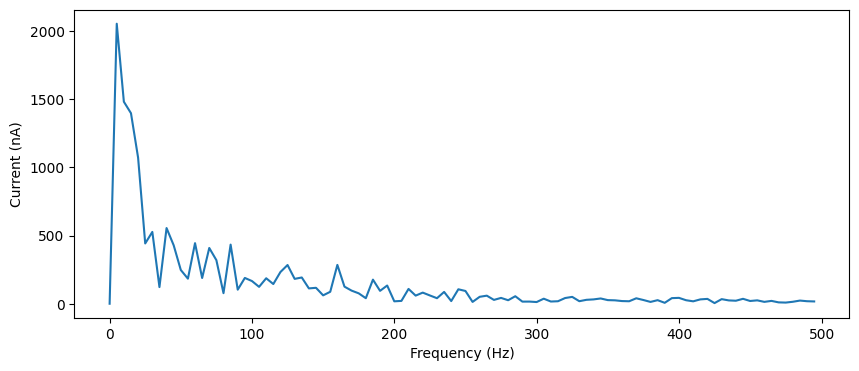

prob12=0.05, prob21=0.05, weight12=0.002, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2054.17414397 2054.17414397]


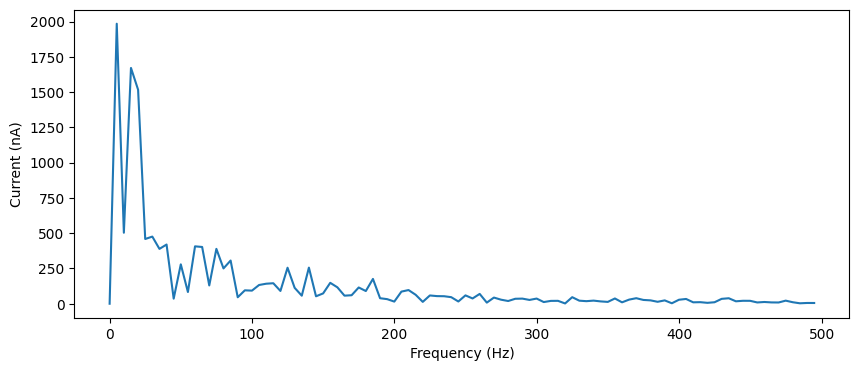

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.0005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1985.37357506 1985.37357506]


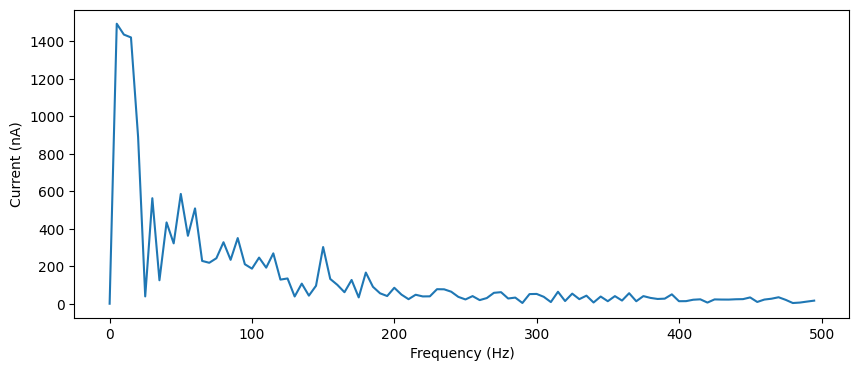

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1494.2330235 1494.2330235]


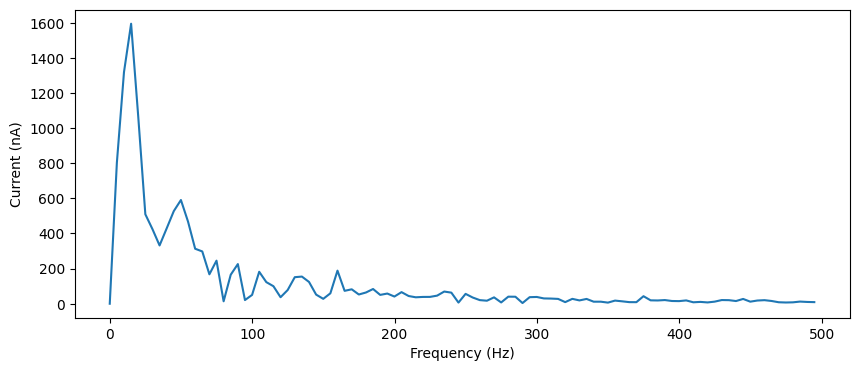

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.0015, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[1594.31707365 1594.31707365]


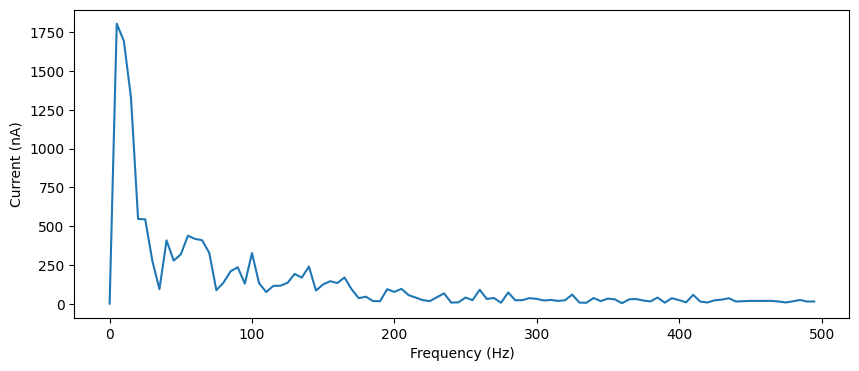

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.002, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1806.22506059 1806.22506059]


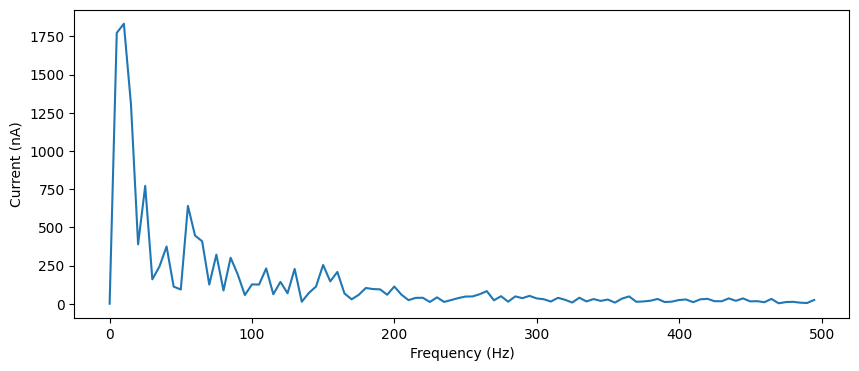

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.0025, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[1833.24818768 1833.24818768]


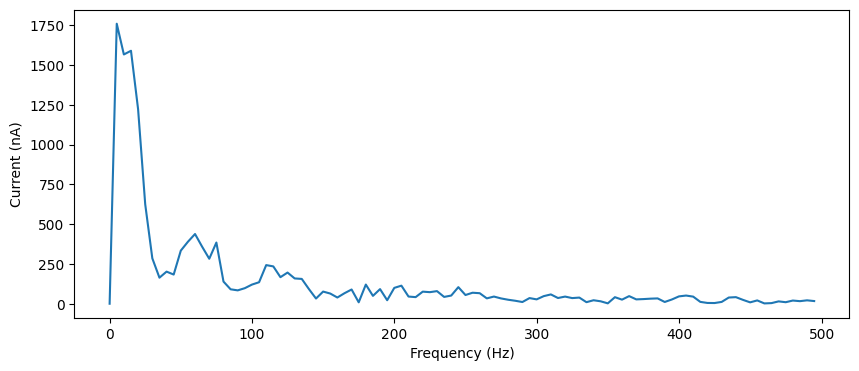

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1760.74648924 1760.74648924]


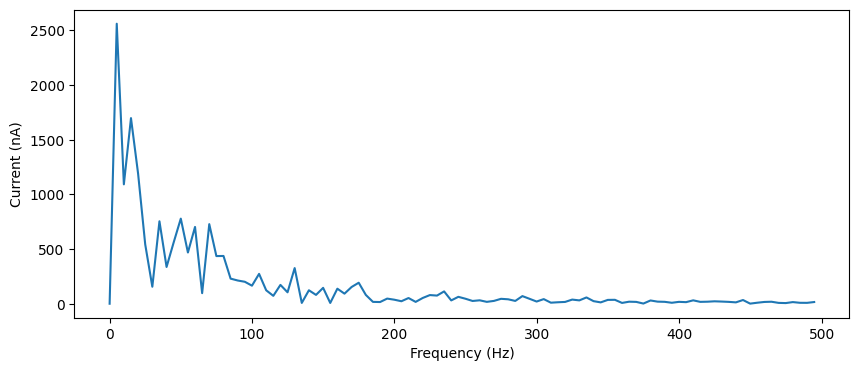

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2561.51713953 2561.51713953]


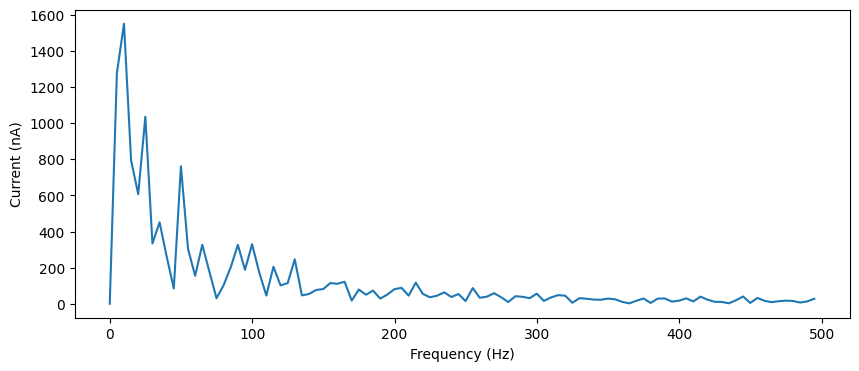

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.004, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1550.77755153 1550.77755153]


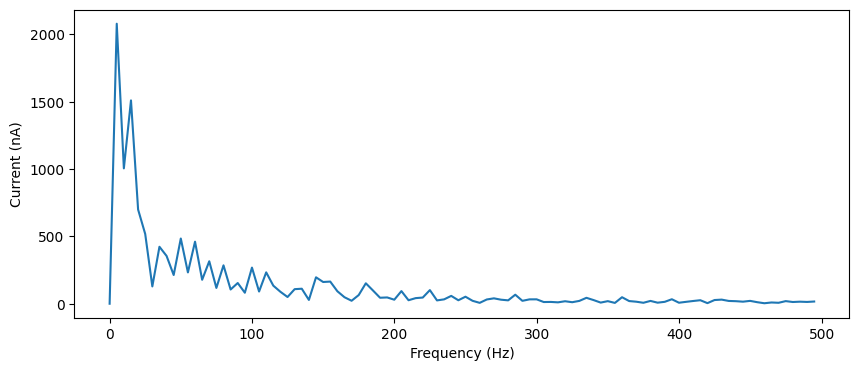

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2079.6232159 2079.6232159]


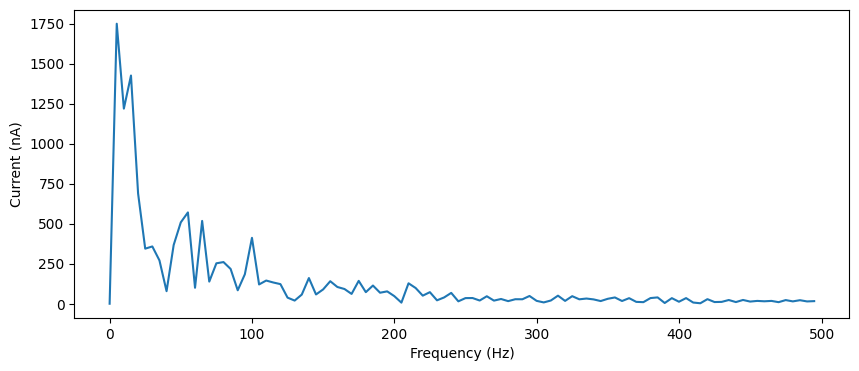

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1749.60909714 1749.60909714]


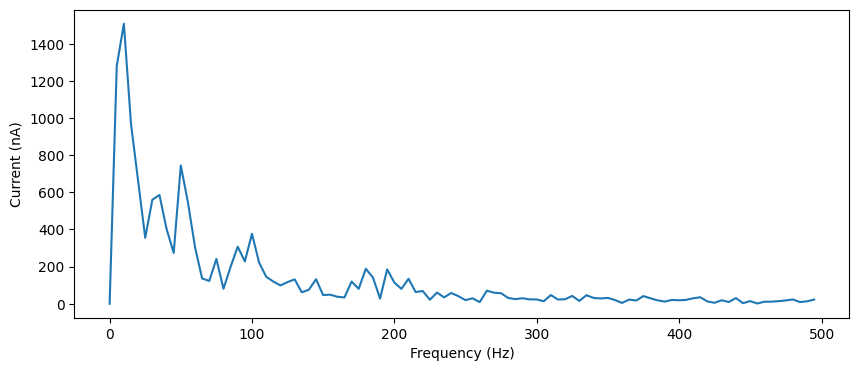

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.0055, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1508.07659227 1508.07659227]


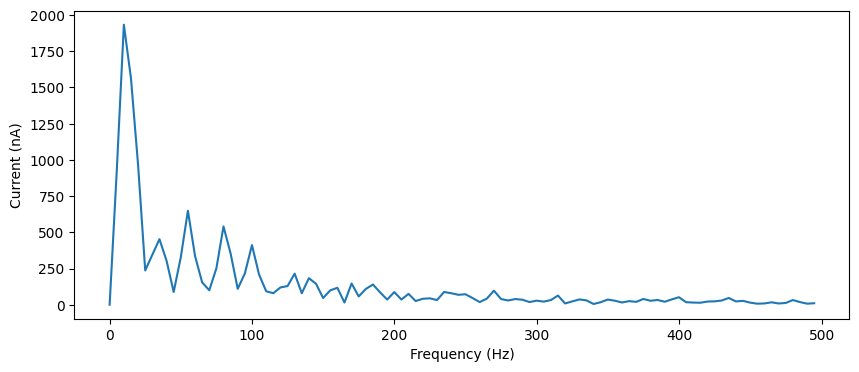

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.006, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1933.4556832 1933.4556832]


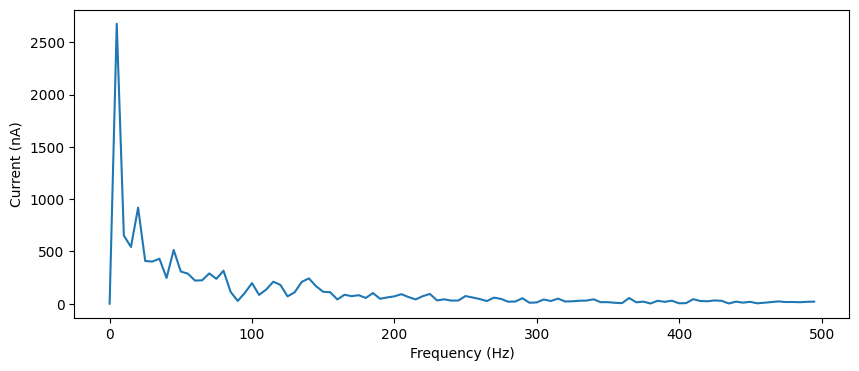

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2679.26135451 2679.26135451]


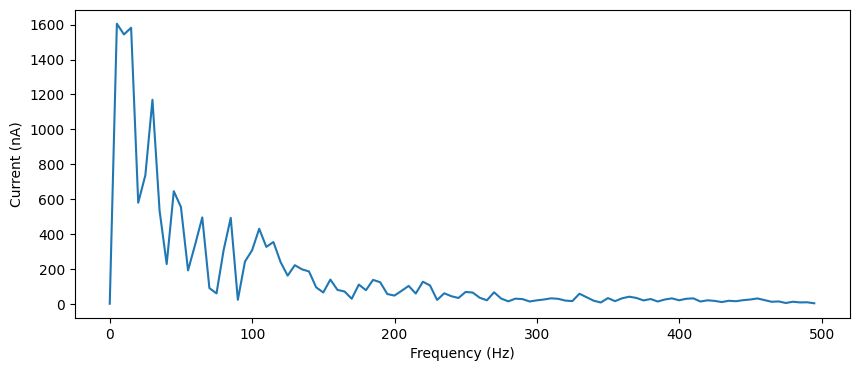

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1605.52724291 1605.52724291]


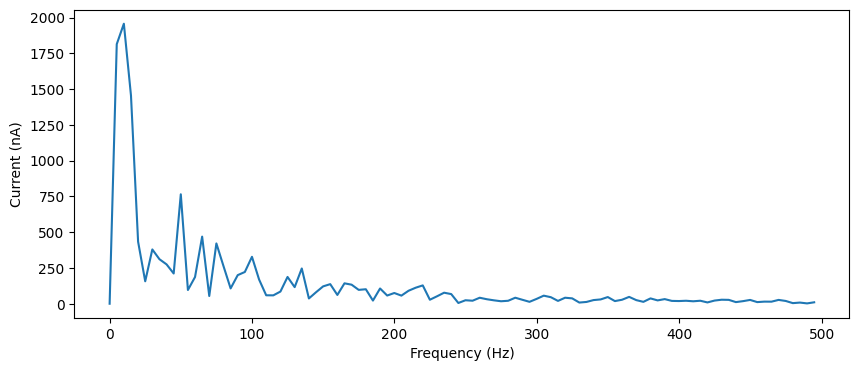

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.0075, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1956.59998192 1956.59998192]


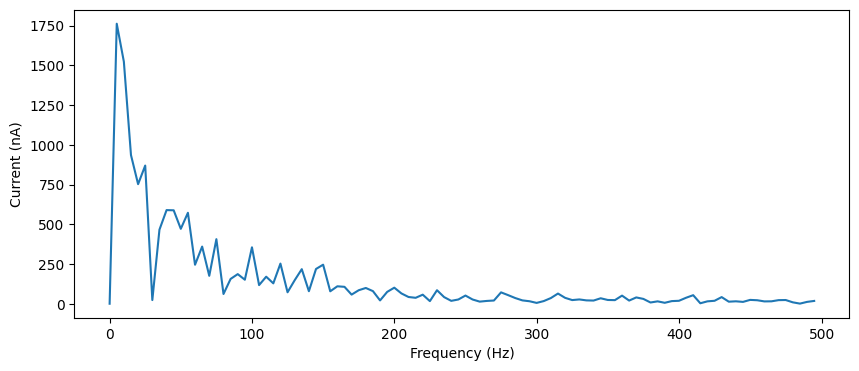

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1762.27200443 1762.27200443]


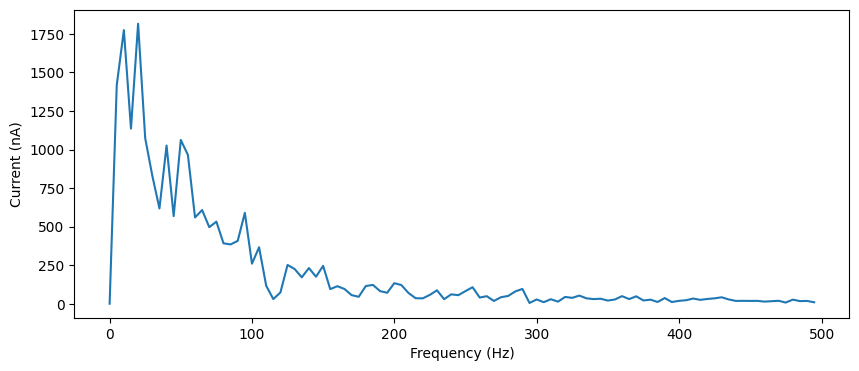

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.0085, peak_freqs=[ 19.990005 -19.990005], peak_freqs_amp=[1815.77468192 1815.77468192]


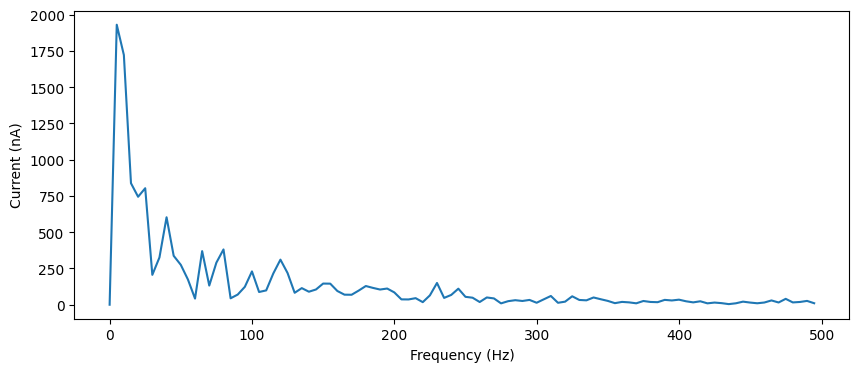

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1930.94385649 1930.94385649]


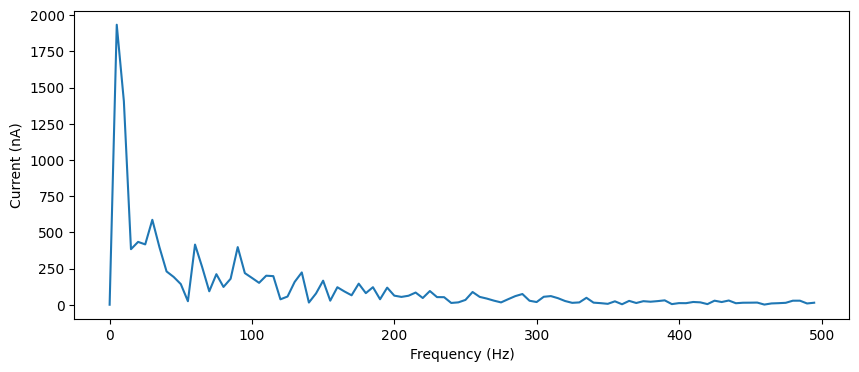

prob12=0.05, prob21=0.05, weight12=0.0025, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1934.21427757 1934.21427757]


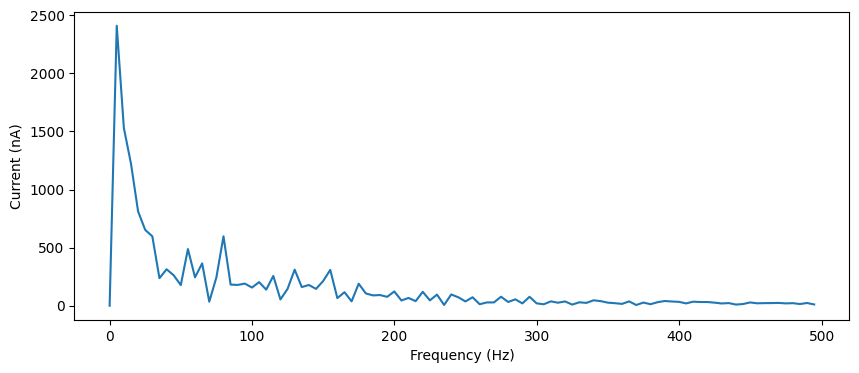

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.0005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2410.17630408 2410.17630408]


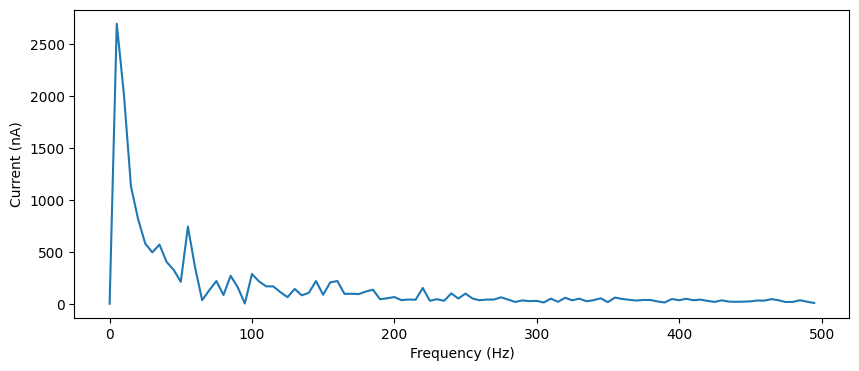

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2695.91992876 2695.91992876]


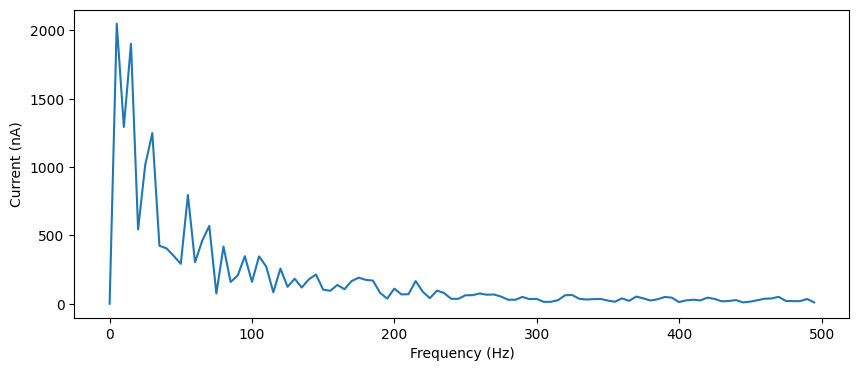

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2049.53127182 2049.53127182]


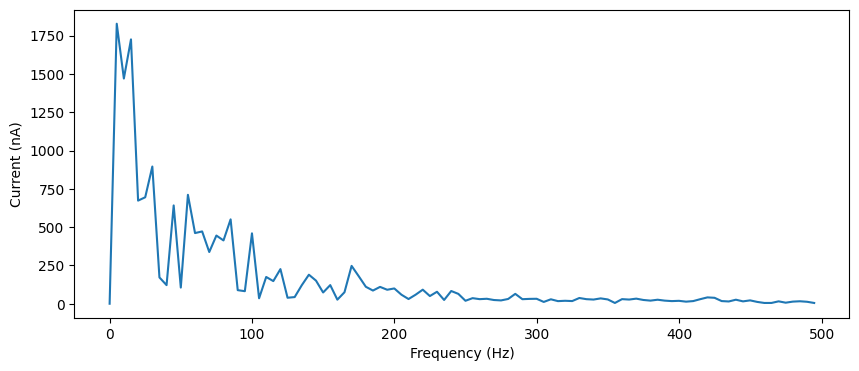

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.002, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1828.32750711 1828.32750711]


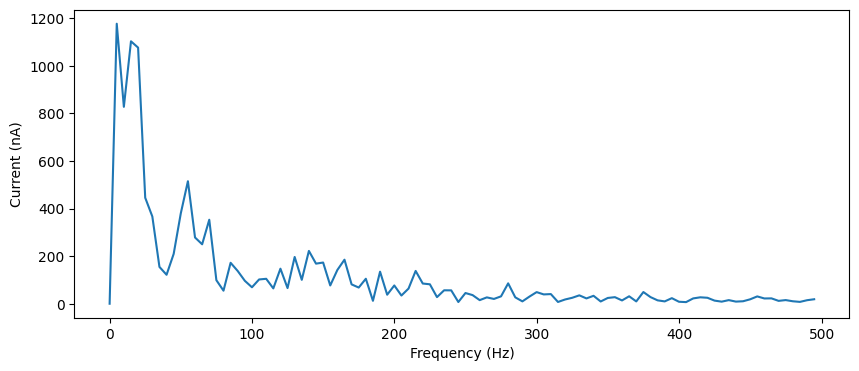

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.0025, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1177.02315755 1177.02315755]


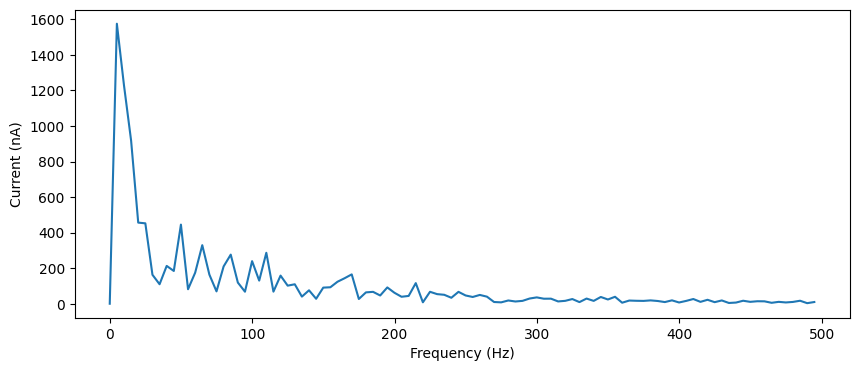

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1575.13349256 1575.13349256]


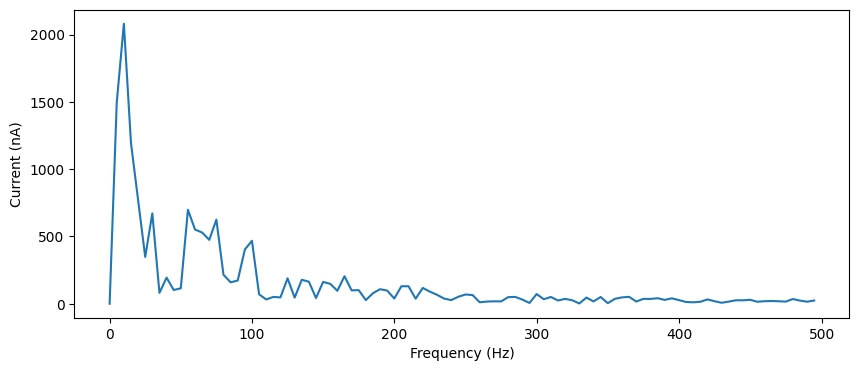

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.0035, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[2081.29021392 2081.29021392]


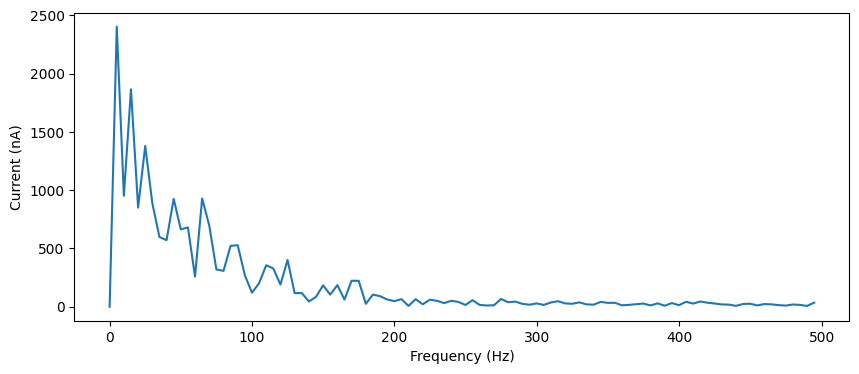

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2402.31132099 2402.31132099]


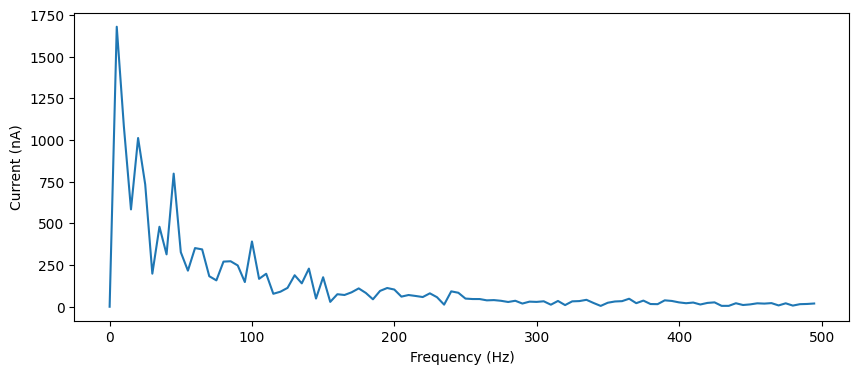

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1679.29787241 1679.29787241]


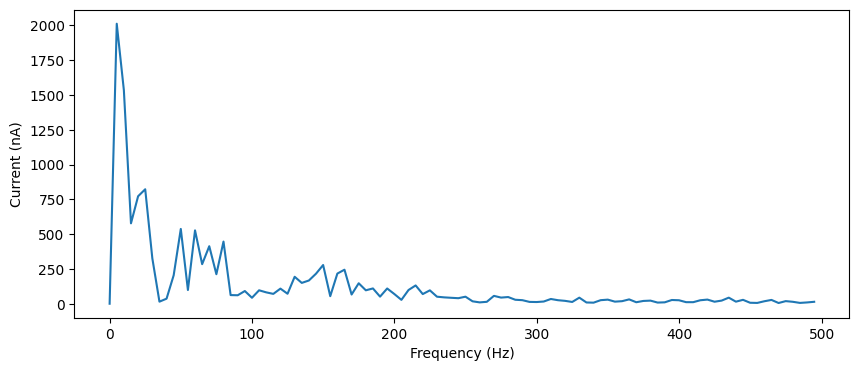

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2011.59672208 2011.59672208]


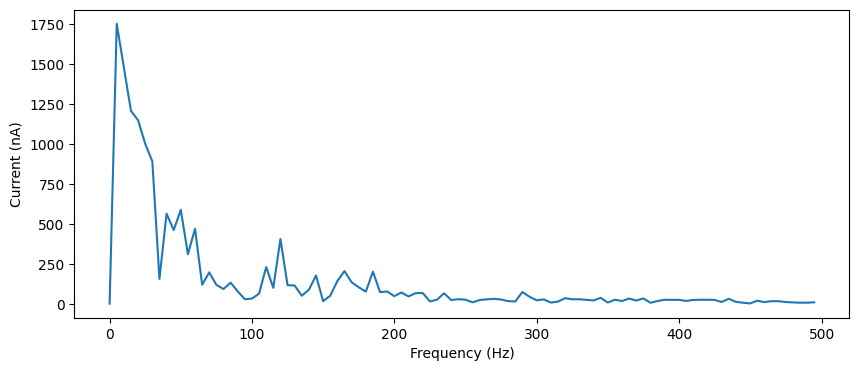

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.0055, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1752.42265887 1752.42265887]


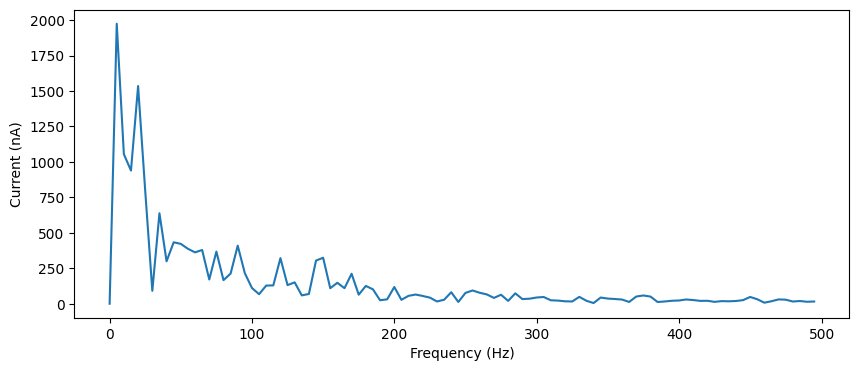

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.006, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1974.24079364 1974.24079364]


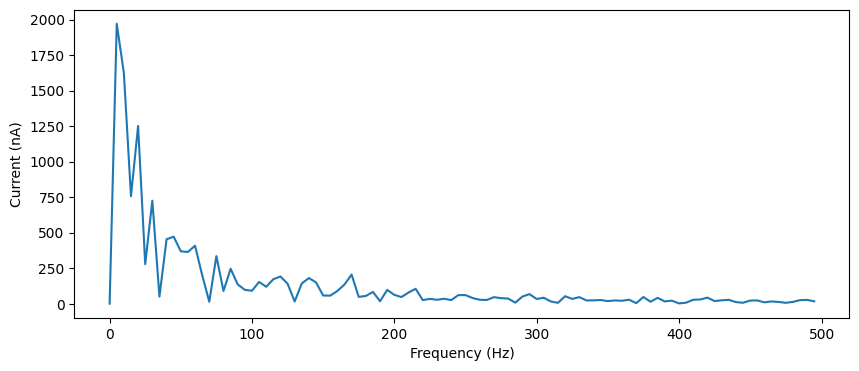

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1971.50832656 1971.50832656]


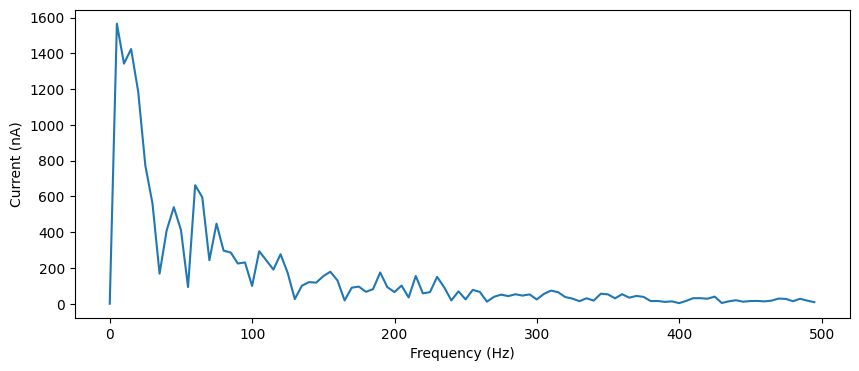

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1566.22525533 1566.22525533]


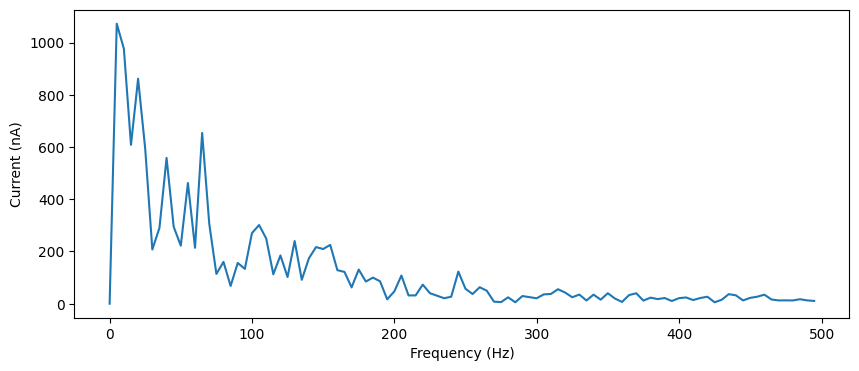

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.0075, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1072.14900051 1072.14900051]


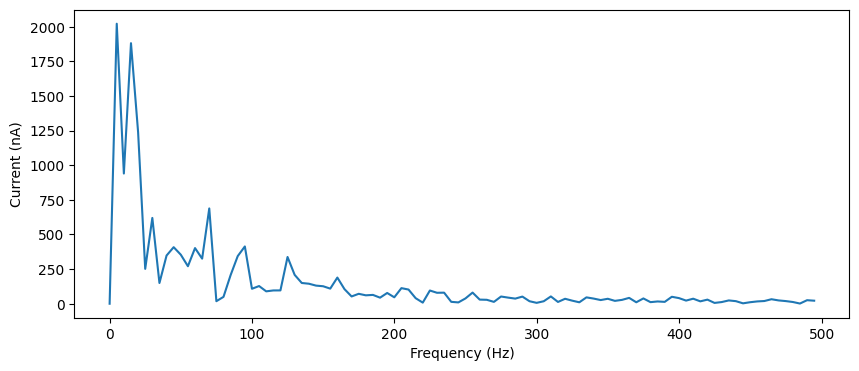

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2021.883849 2021.883849]


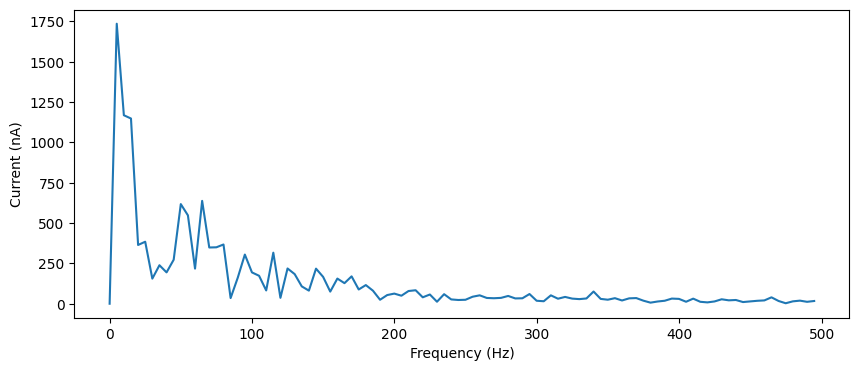

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1735.95784872 1735.95784872]


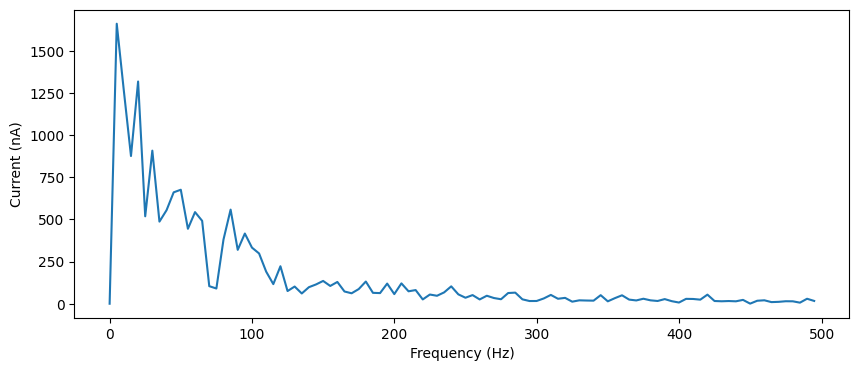

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1660.30349472 1660.30349472]


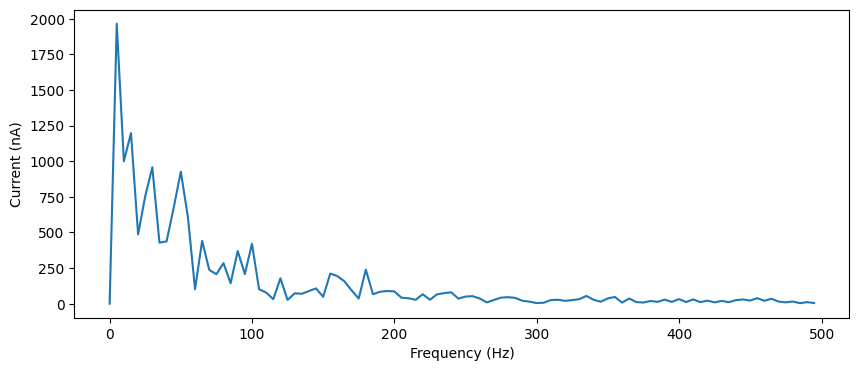

prob12=0.05, prob21=0.05, weight12=0.003, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1965.16343168 1965.16343168]


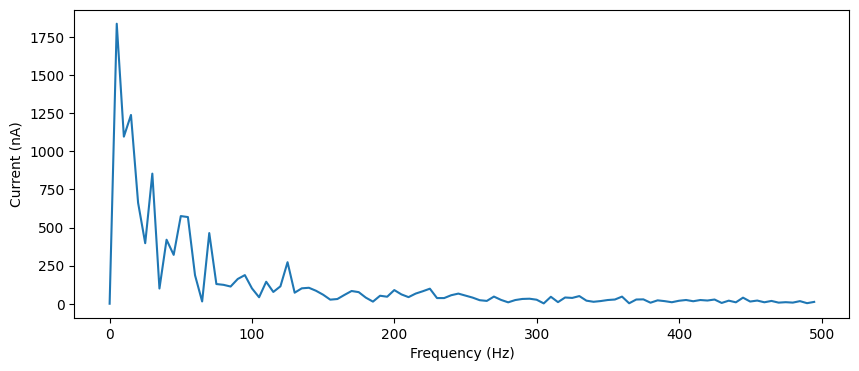

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.0005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1837.49050632 1837.49050632]


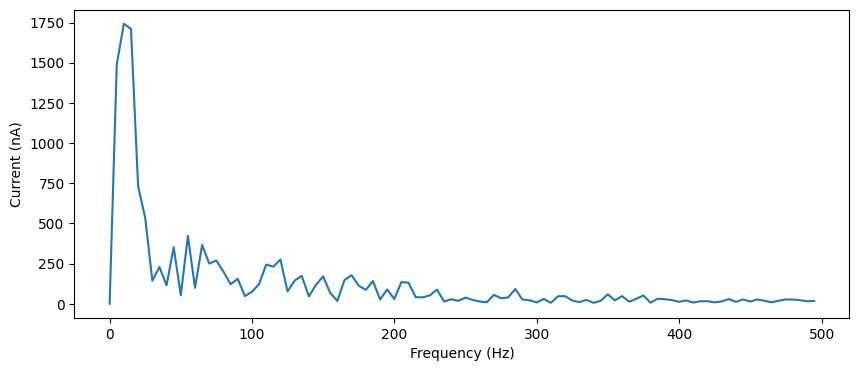

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.001, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1742.50441775 1742.50441775]


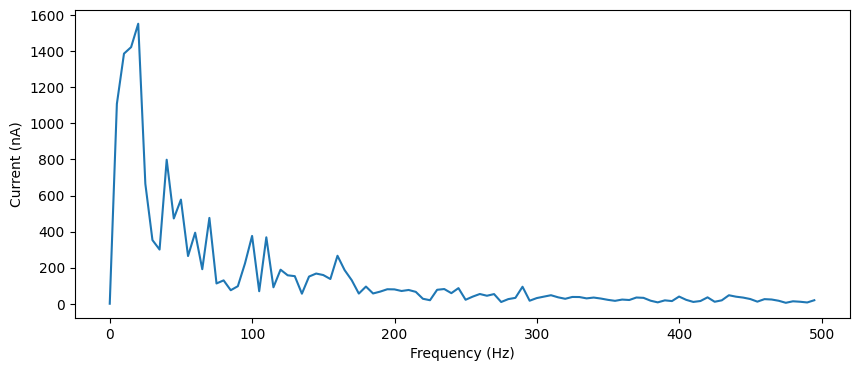

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.0015, peak_freqs=[-19.990005  19.990005], peak_freqs_amp=[1553.15775057 1553.15775057]


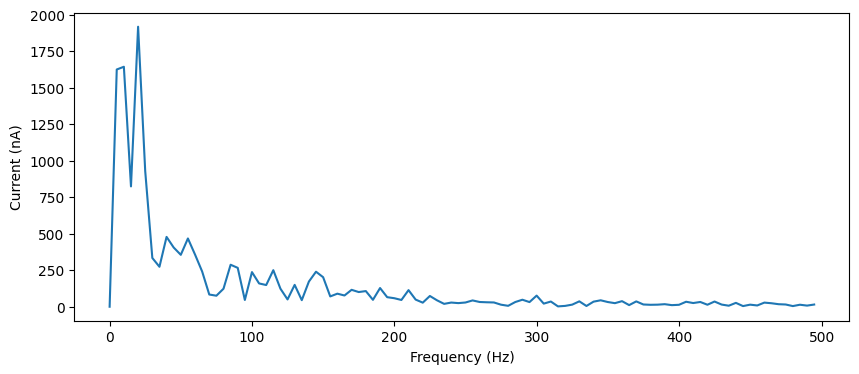

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.002, peak_freqs=[ 19.990005 -19.990005], peak_freqs_amp=[1918.19100609 1918.19100609]


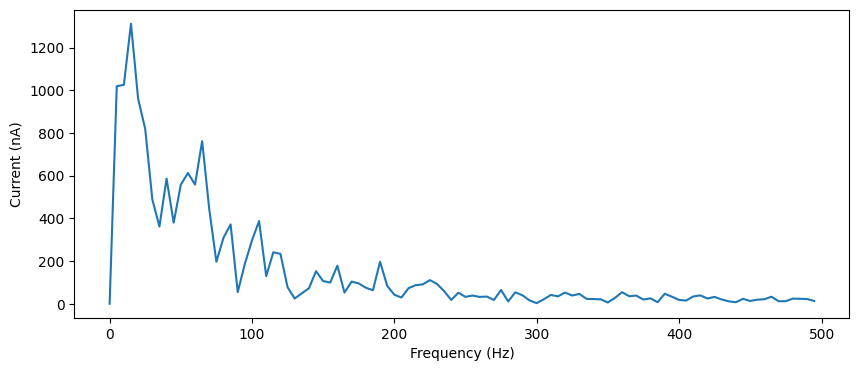

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.0025, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[1311.5069954 1311.5069954]


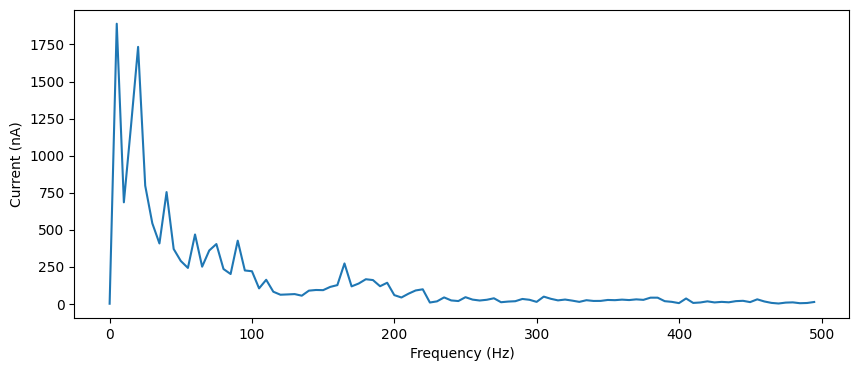

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1890.19262921 1890.19262921]


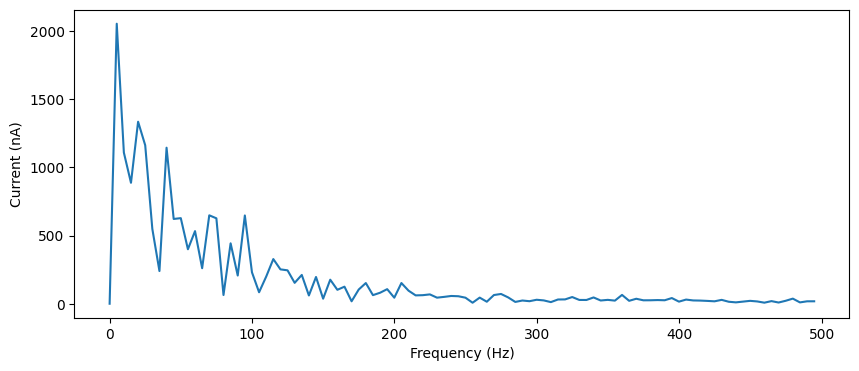

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2054.74756369 2054.74756369]


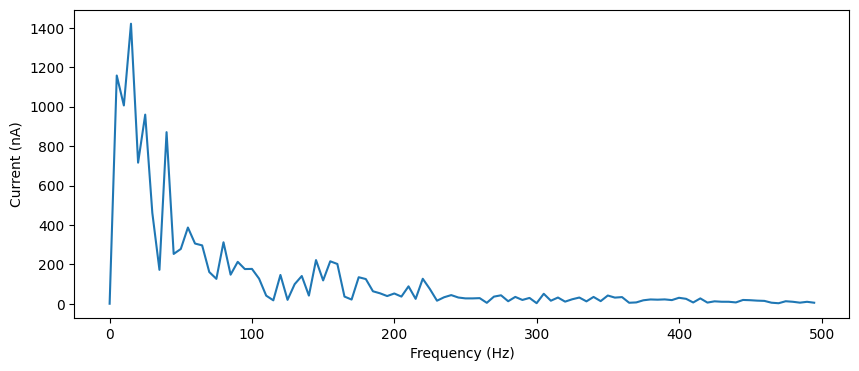

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.004, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[1421.16599792 1421.16599792]


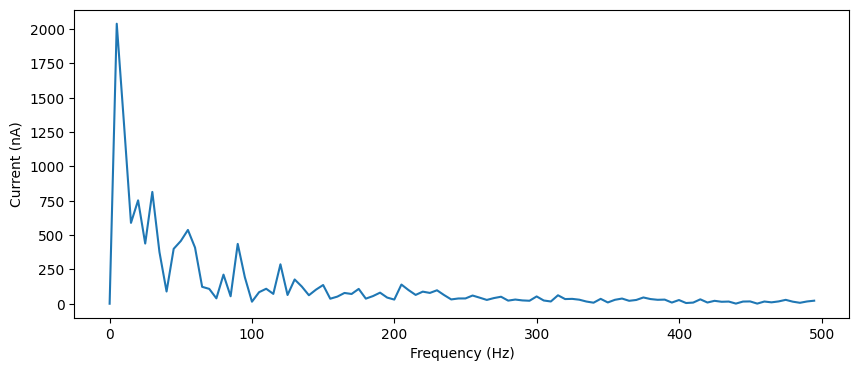

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2039.05493856 2039.05493856]


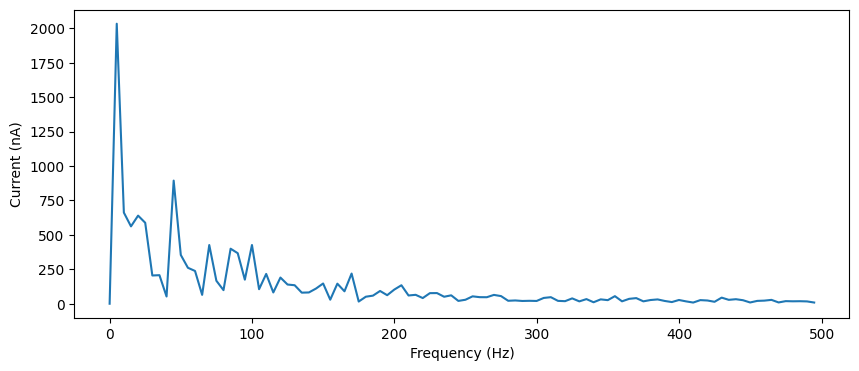

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2033.2237642 2033.2237642]


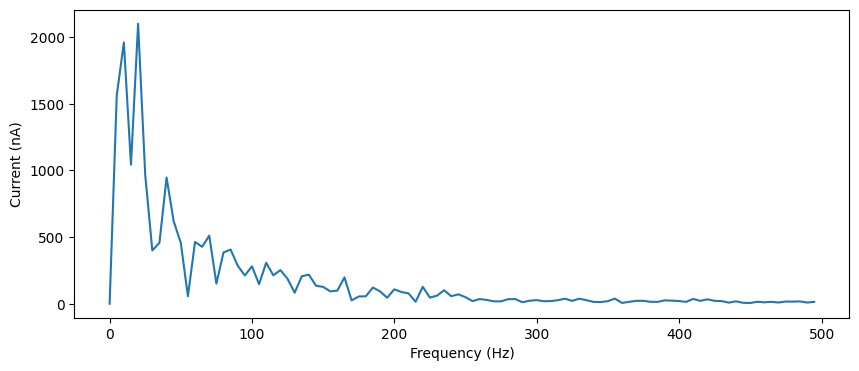

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.0055, peak_freqs=[ 19.990005 -19.990005], peak_freqs_amp=[2101.3315501 2101.3315501]


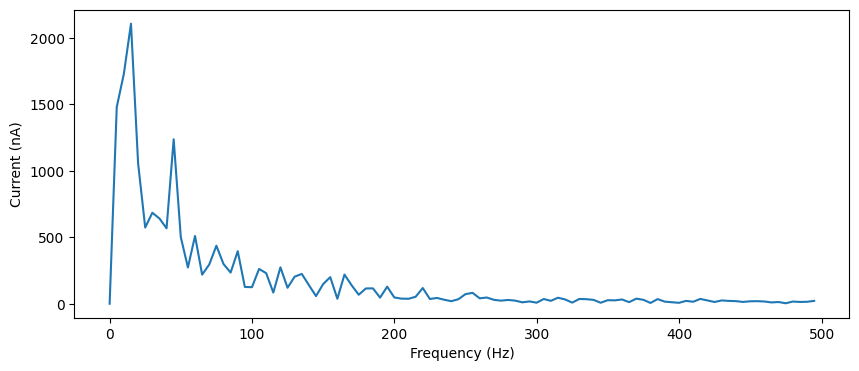

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.006, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[2105.79304662 2105.79304662]


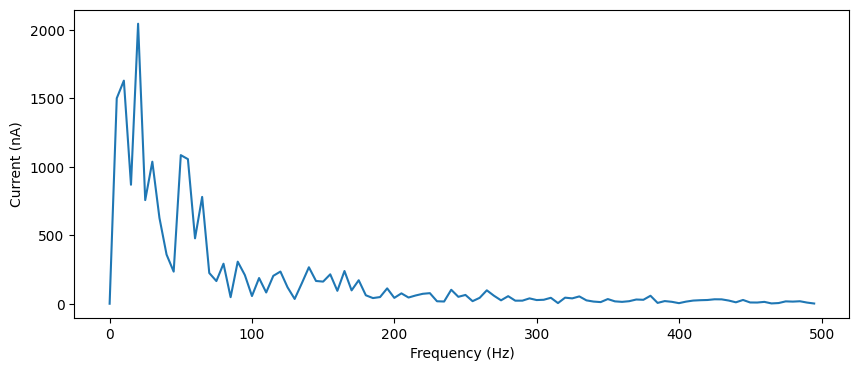

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.006500000000000001, peak_freqs=[-19.990005  19.990005], peak_freqs_amp=[2046.50533252 2046.50533252]


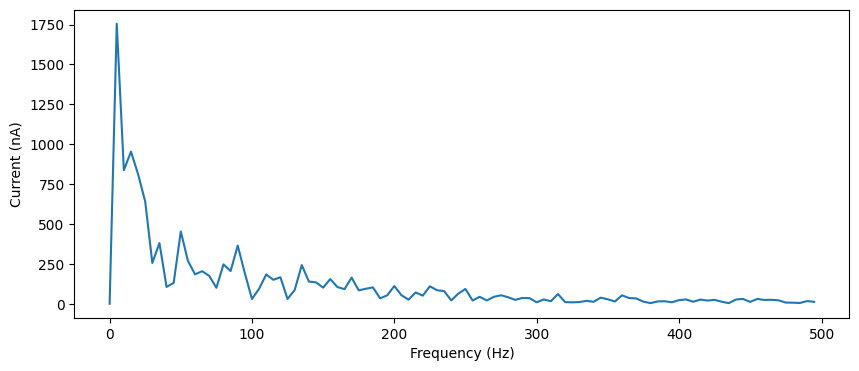

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1755.42384327 1755.42384327]


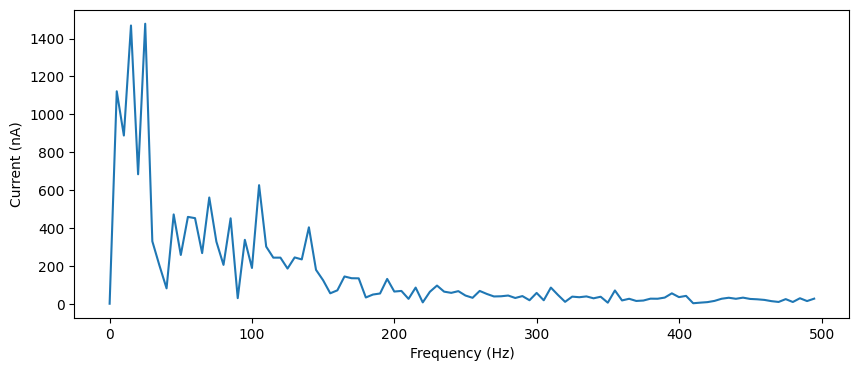

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.0075, peak_freqs=[-24.98750625  24.98750625], peak_freqs_amp=[1478.67894822 1478.67894822]


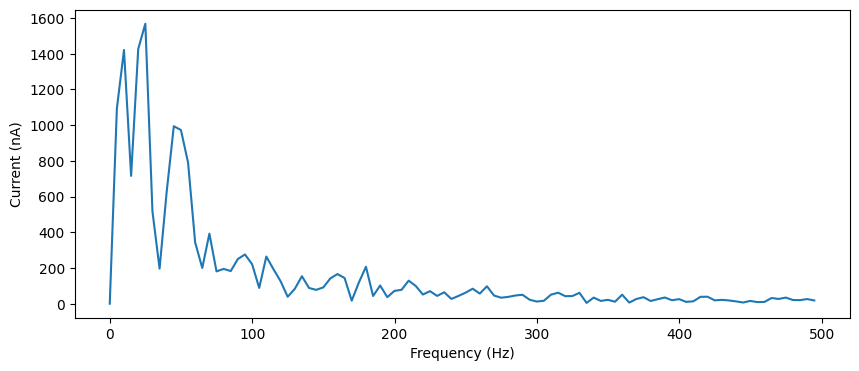

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.008, peak_freqs=[-24.98750625  24.98750625], peak_freqs_amp=[1568.20133652 1568.20133652]


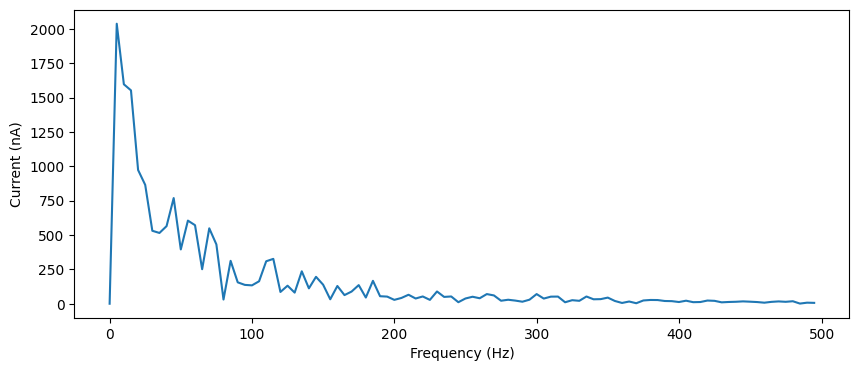

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2038.39221739 2038.39221739]


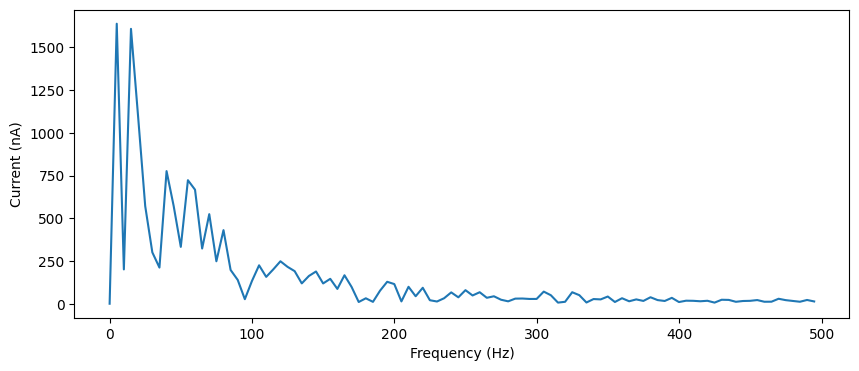

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1638.79726697 1638.79726697]


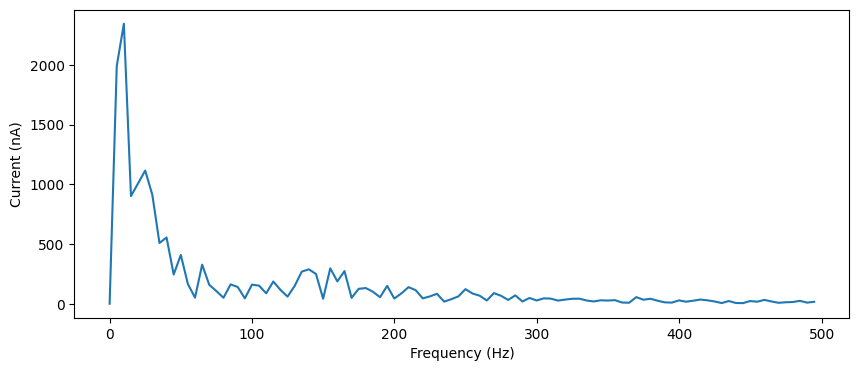

prob12=0.05, prob21=0.05, weight12=0.0035, weight21=0.009500000000000001, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2344.66388937 2344.66388937]


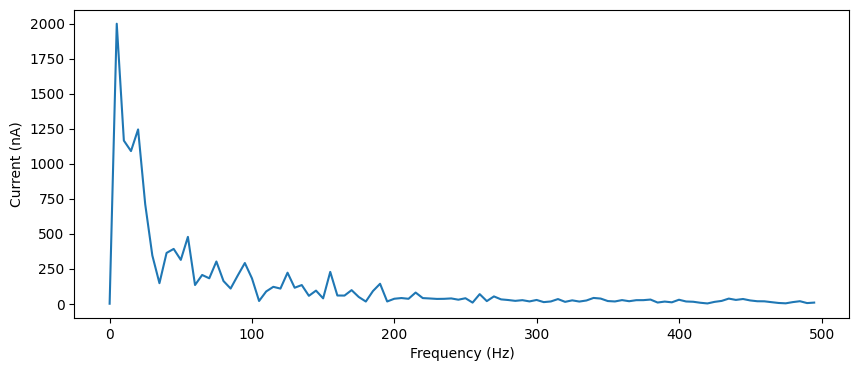

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.0005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1998.68866277 1998.68866277]


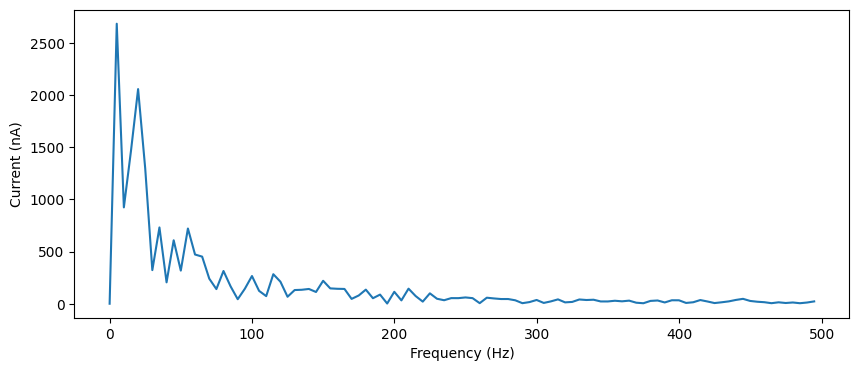

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2684.66990789 2684.66990789]


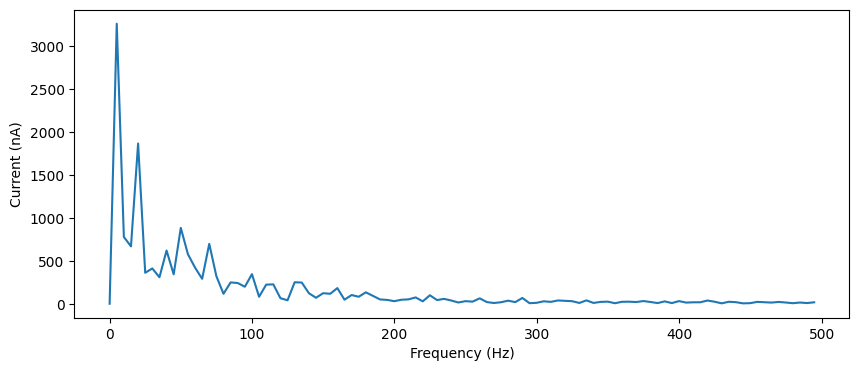

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3260.99140457 3260.99140457]


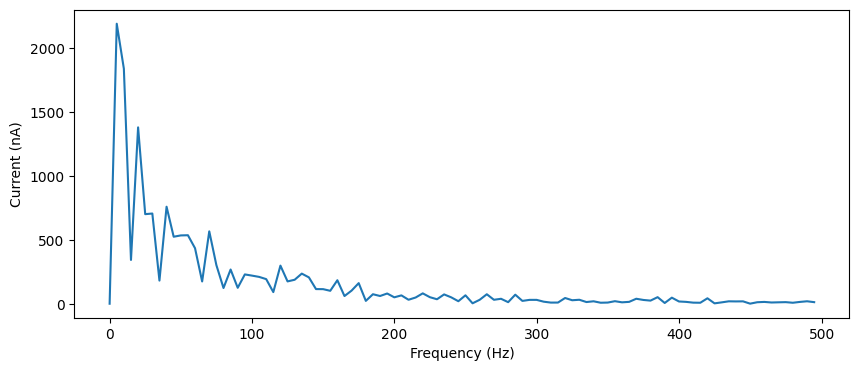

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.002, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2193.97899755 2193.97899755]


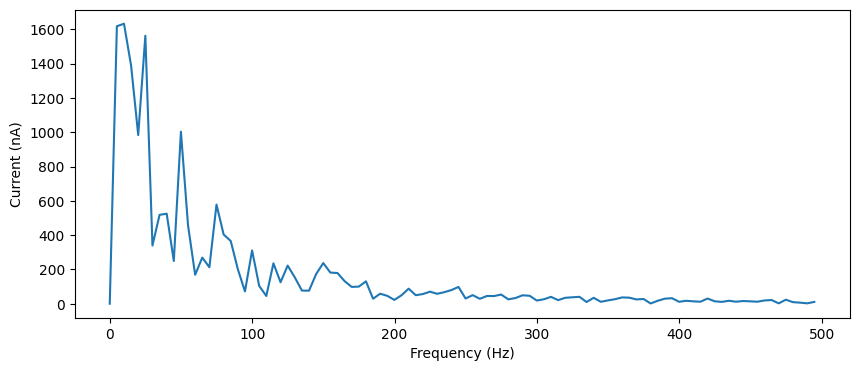

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.0025, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[1632.83522143 1632.83522143]


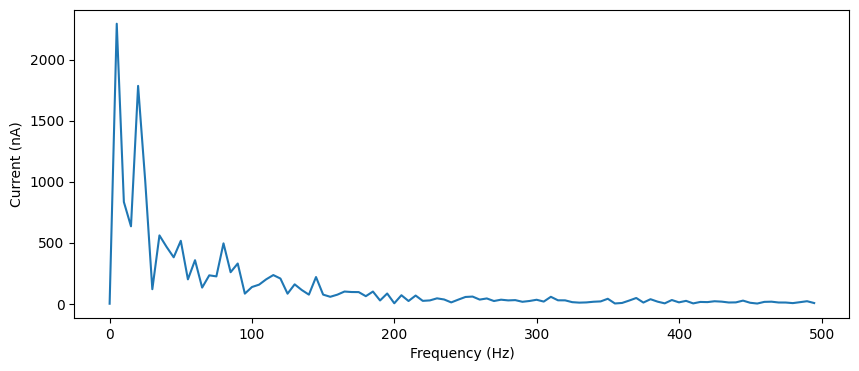

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2294.45188107 2294.45188107]


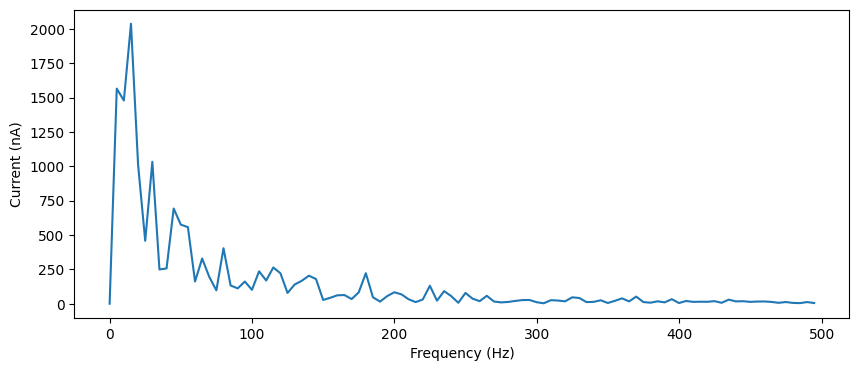

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.0035, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[2038.09277009 2038.09277009]


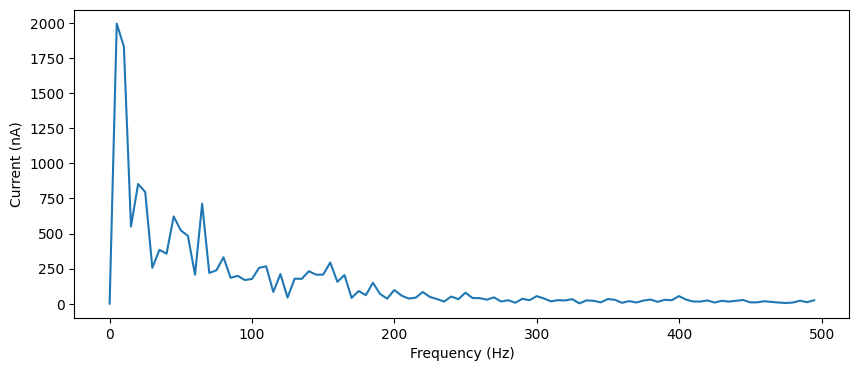

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1994.10141598 1994.10141598]


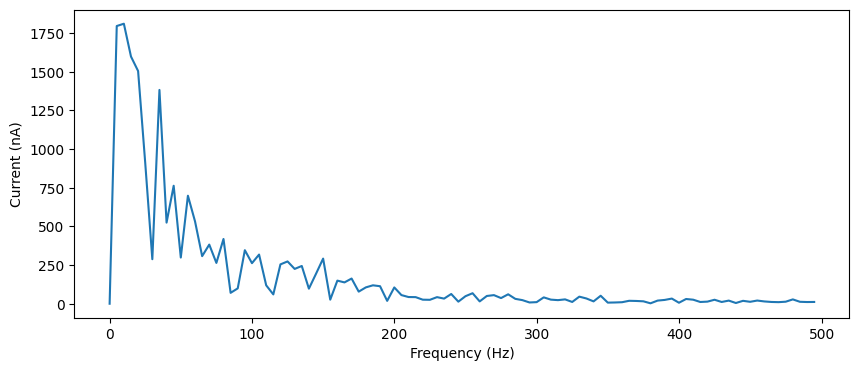

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.0045000000000000005, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[1810.86265795 1810.86265795]


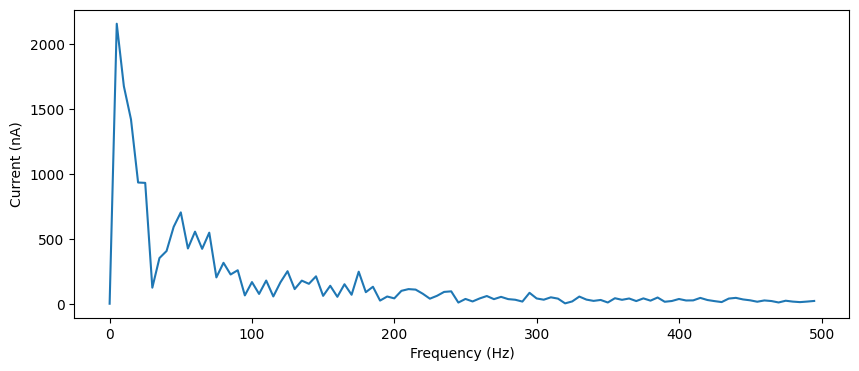

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2159.54844763 2159.54844763]


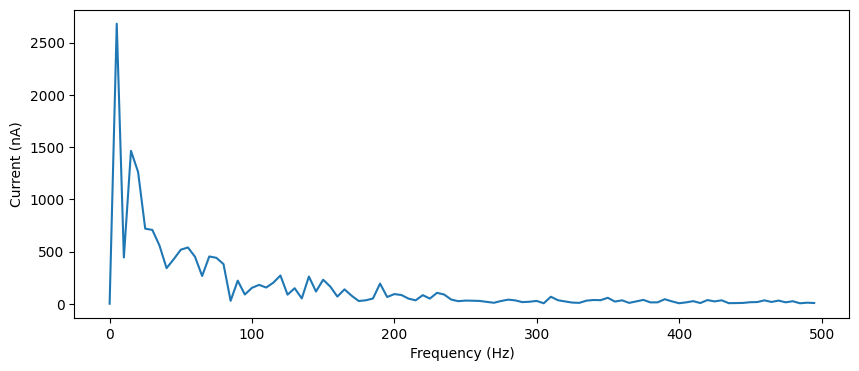

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.0055, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2681.23404777 2681.23404777]


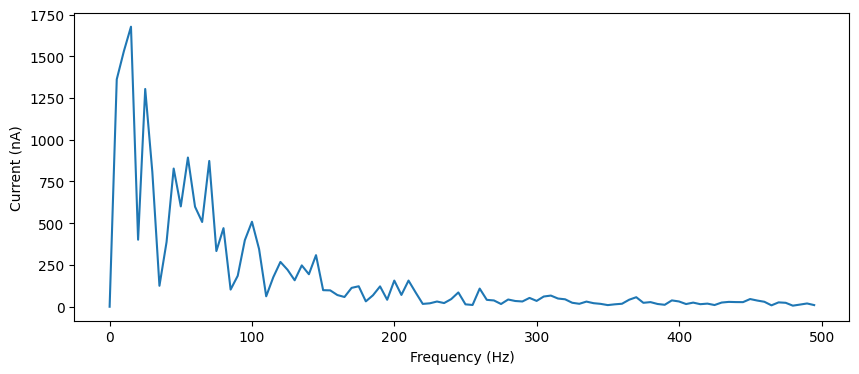

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.006, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[1676.96023421 1676.96023421]


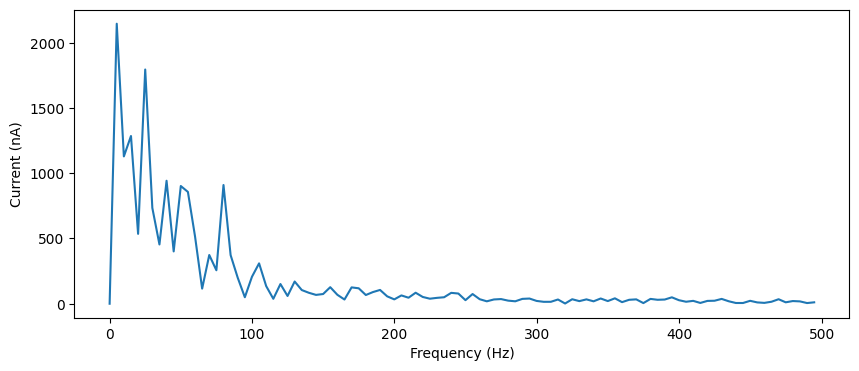

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2145.71135234 2145.71135234]


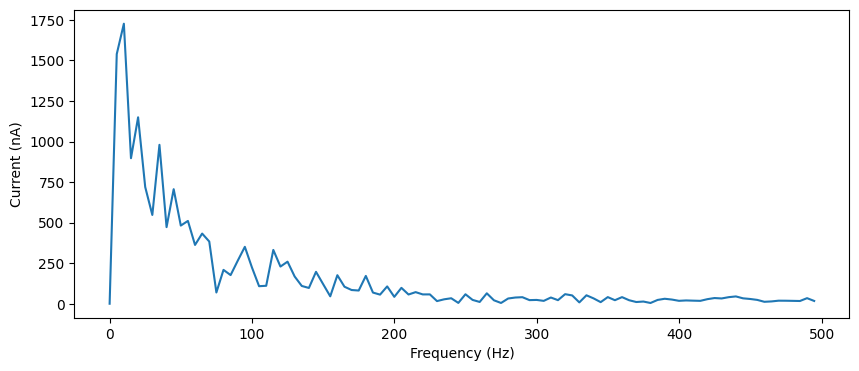

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.007000000000000001, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1726.69158952 1726.69158952]


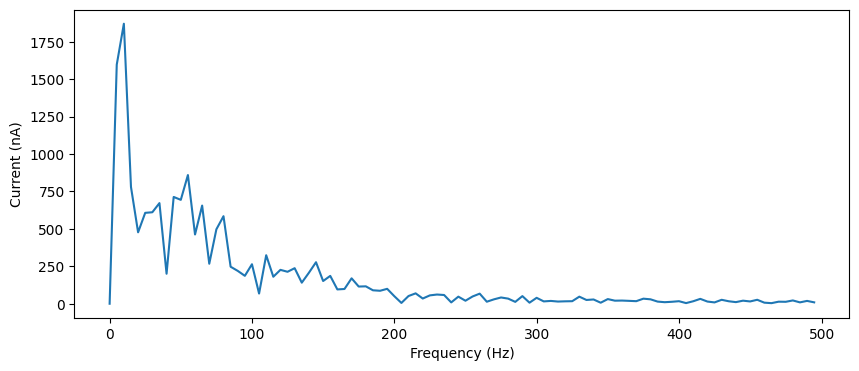

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.0075, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1870.58114373 1870.58114373]


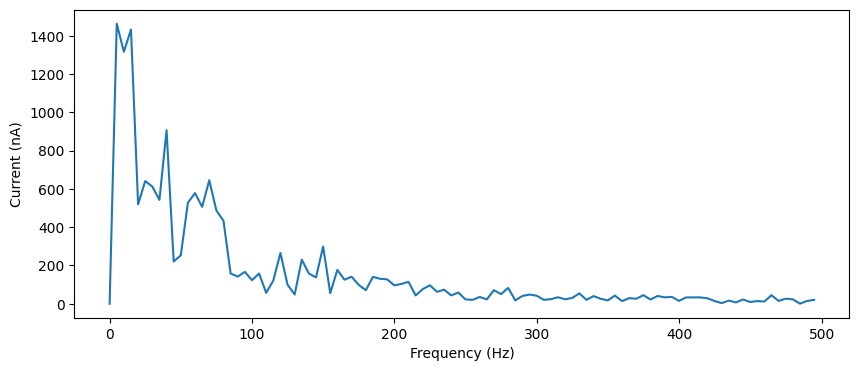

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1463.9847269 1463.9847269]


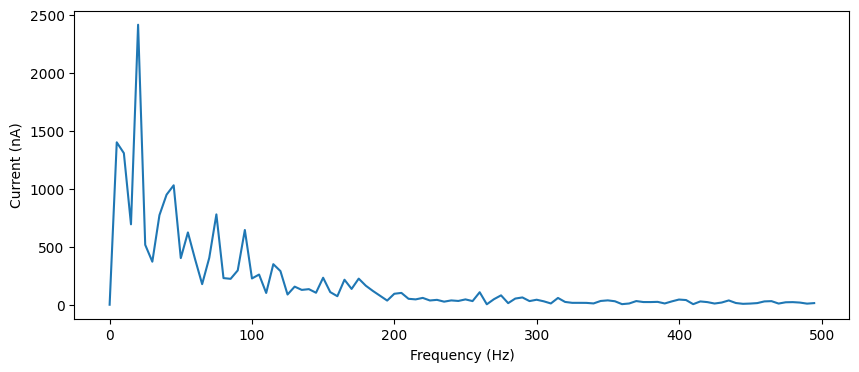

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.0085, peak_freqs=[ 19.990005 -19.990005], peak_freqs_amp=[2415.95269482 2415.95269482]


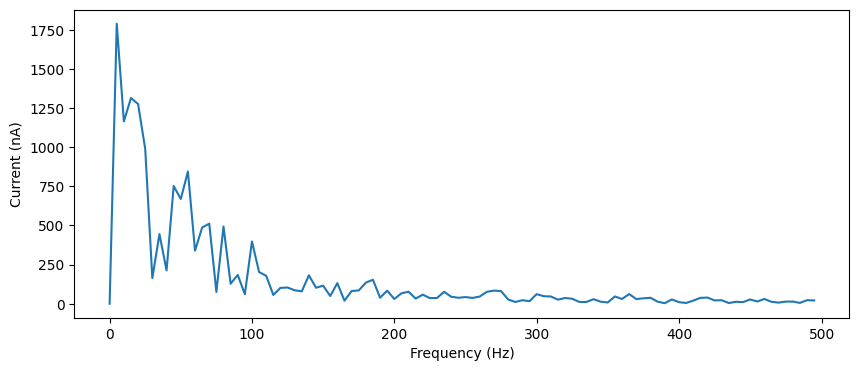

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1788.60724096 1788.60724096]


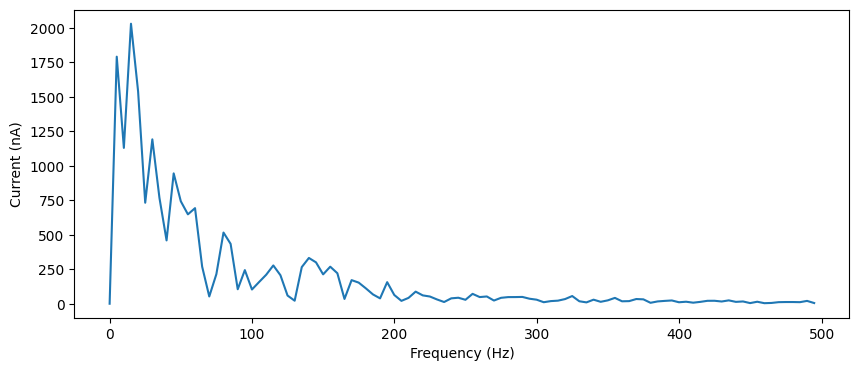

prob12=0.05, prob21=0.05, weight12=0.004, weight21=0.009500000000000001, peak_freqs=[ 14.99250375 -14.99250375], peak_freqs_amp=[2029.40534903 2029.40534903]


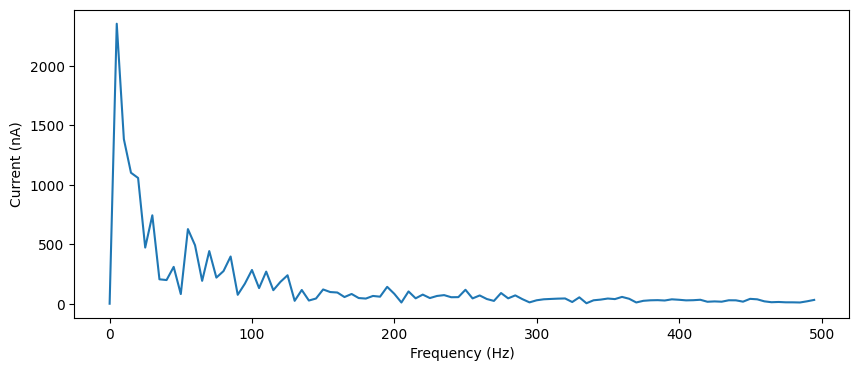

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.0005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2355.70820004 2355.70820004]


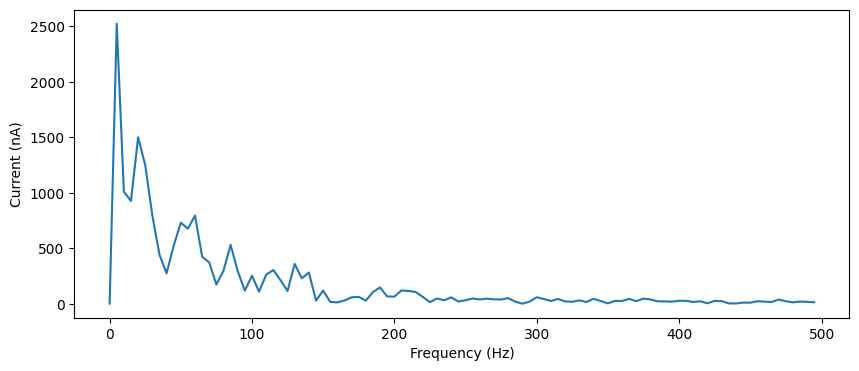

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2523.66069577 2523.66069577]


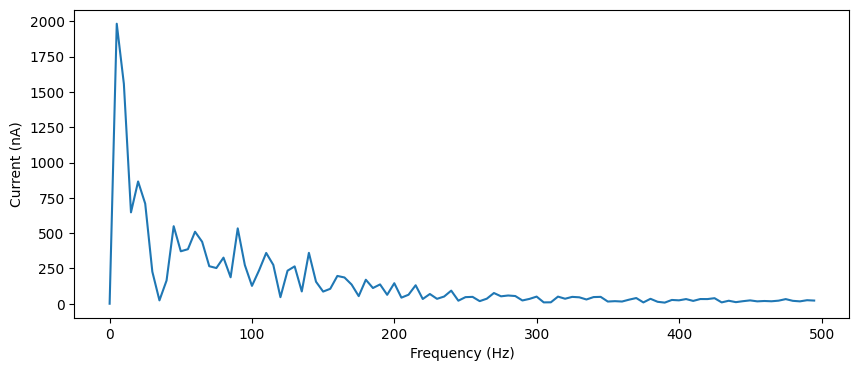

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1983.49610362 1983.49610362]


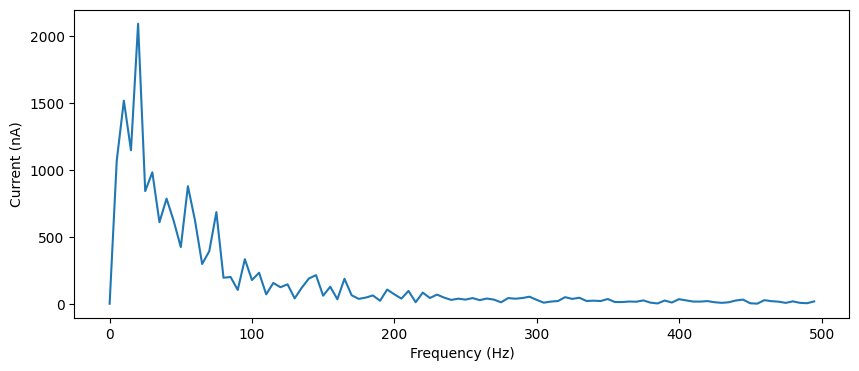

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.002, peak_freqs=[-19.990005  19.990005], peak_freqs_amp=[2090.35950318 2090.35950318]


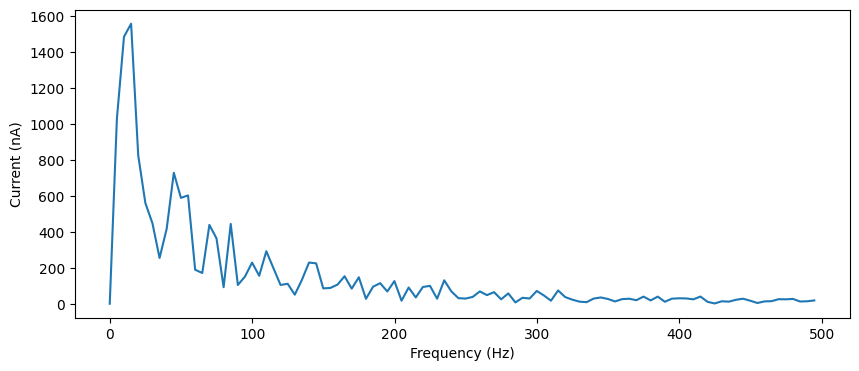

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.0025, peak_freqs=[ 14.99250375 -14.99250375], peak_freqs_amp=[1558.29121817 1558.29121817]


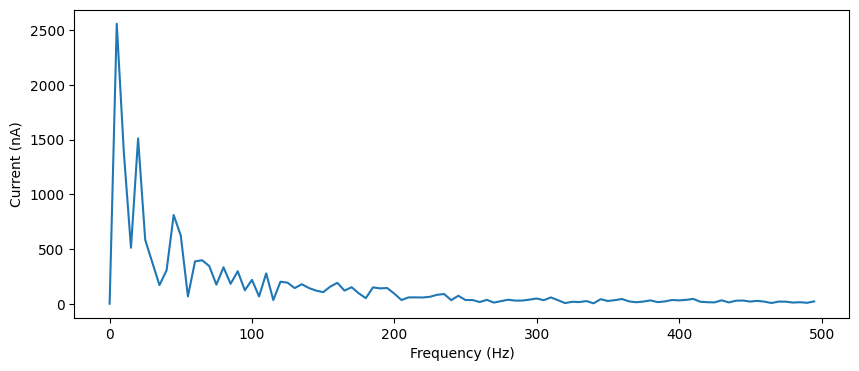

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2560.19893234 2560.19893234]


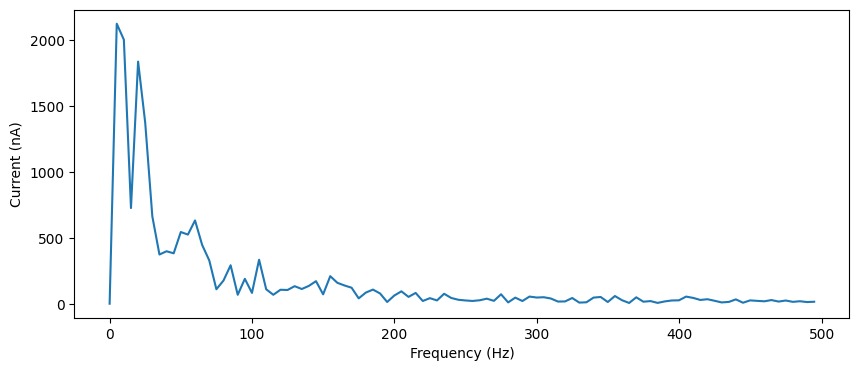

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2126.38421539 2126.38421539]


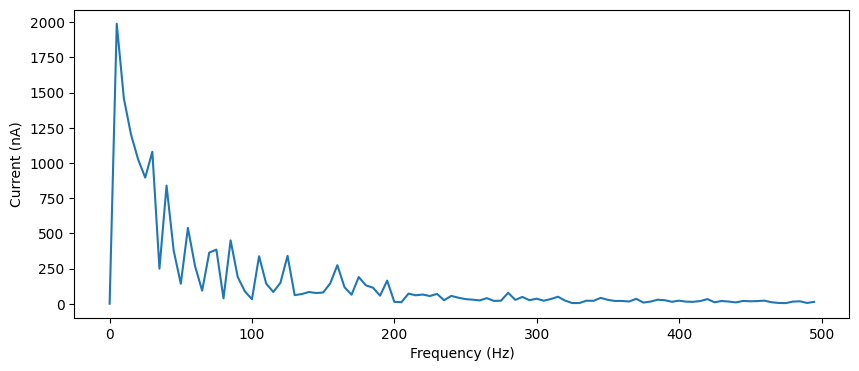

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1989.66681345 1989.66681345]


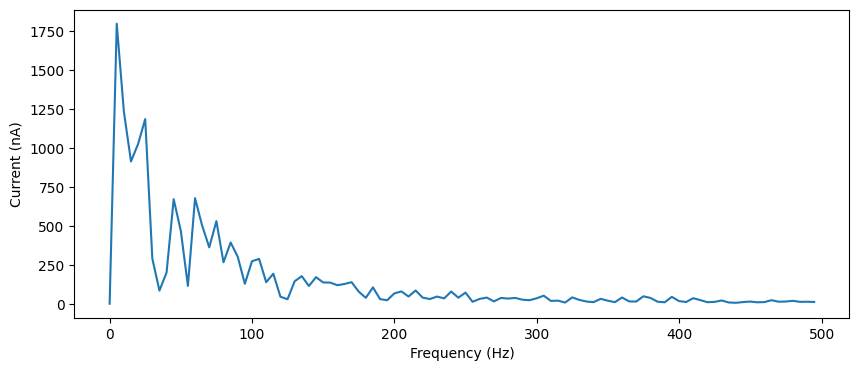

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1795.01730672 1795.01730672]


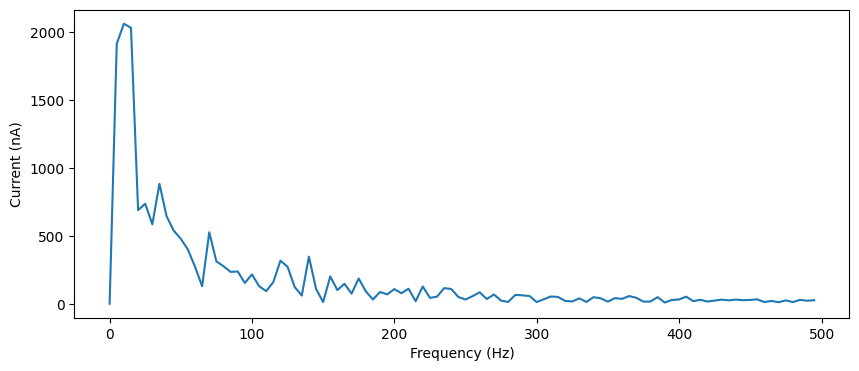

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.005000000000000001, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2064.67825732 2064.67825732]


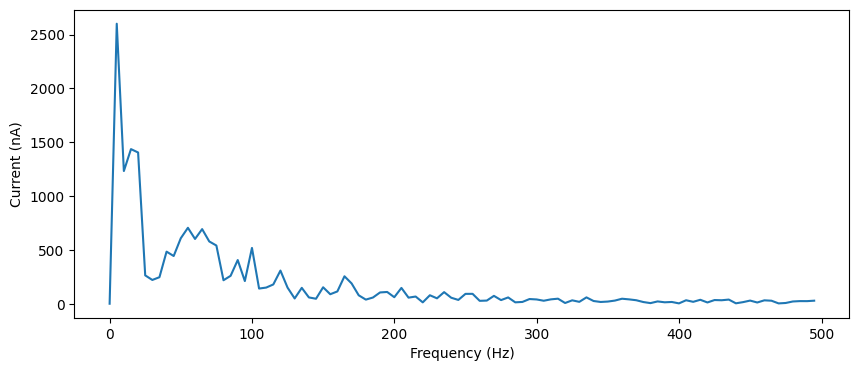

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.0055, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2601.80836571 2601.80836571]


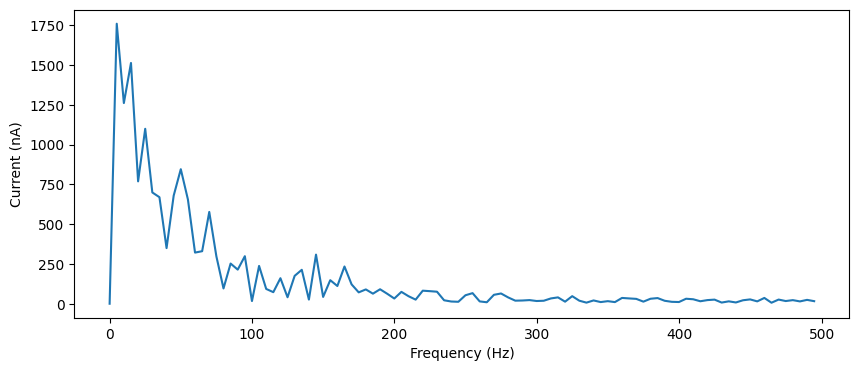

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.006, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1758.90578824 1758.90578824]


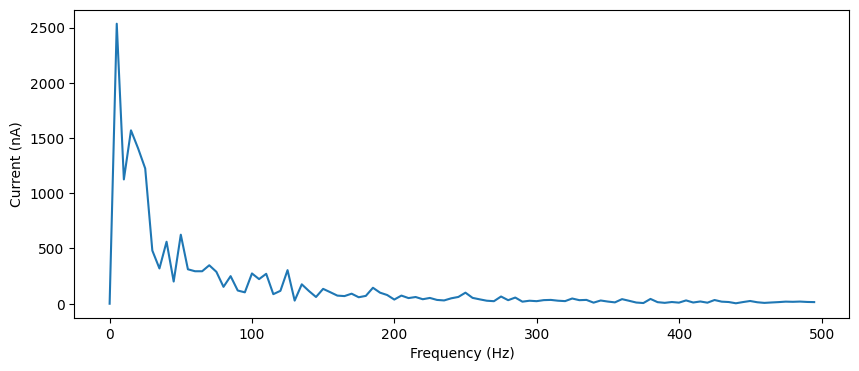

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2535.03848362 2535.03848362]


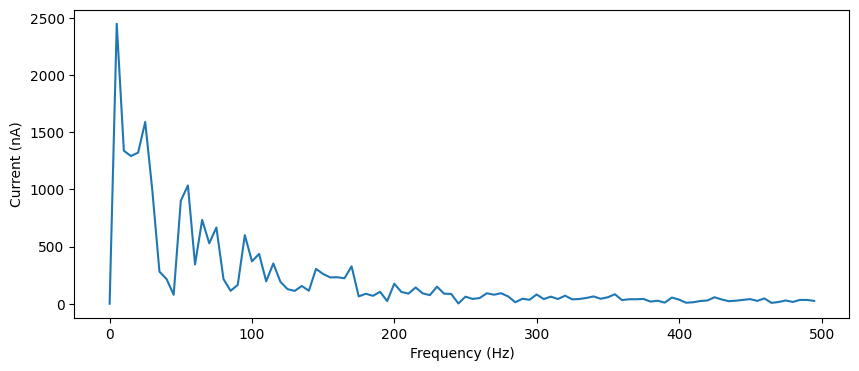

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2449.65095538 2449.65095538]


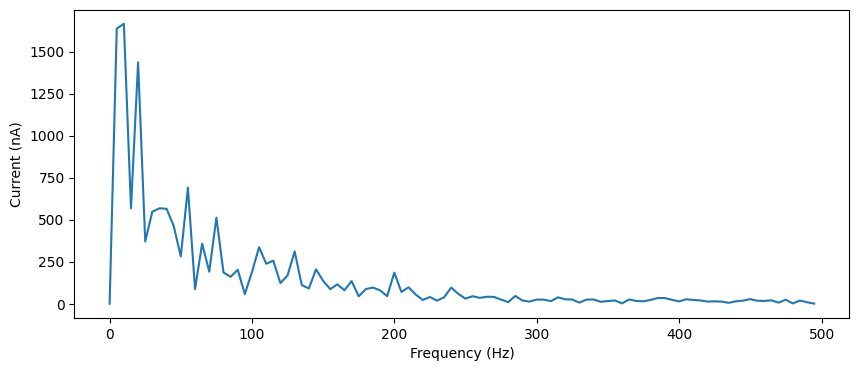

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.0075, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[1665.23412314 1665.23412314]


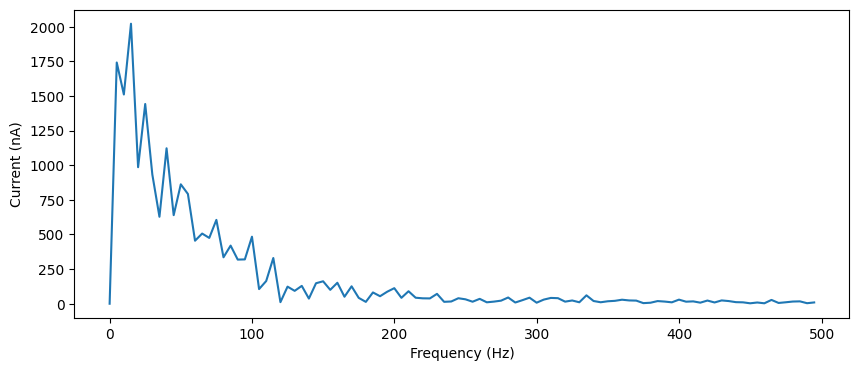

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.008, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[2022.26949049 2022.26949049]


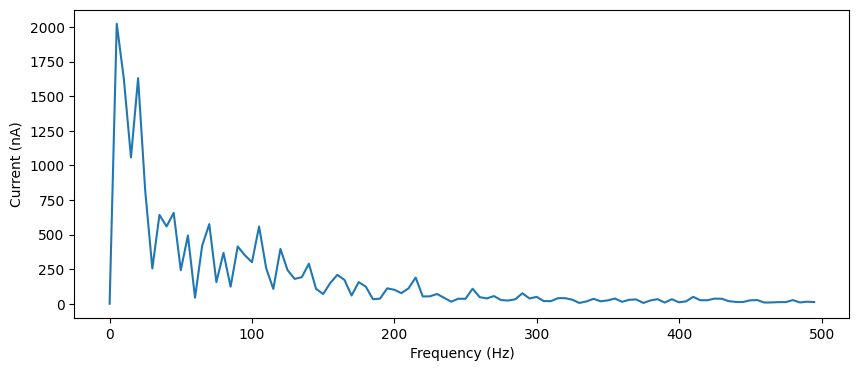

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2023.12631185 2023.12631185]


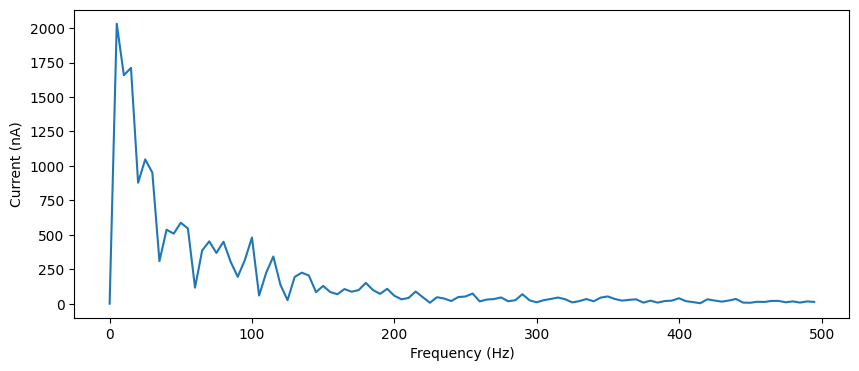

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2032.15407845 2032.15407845]


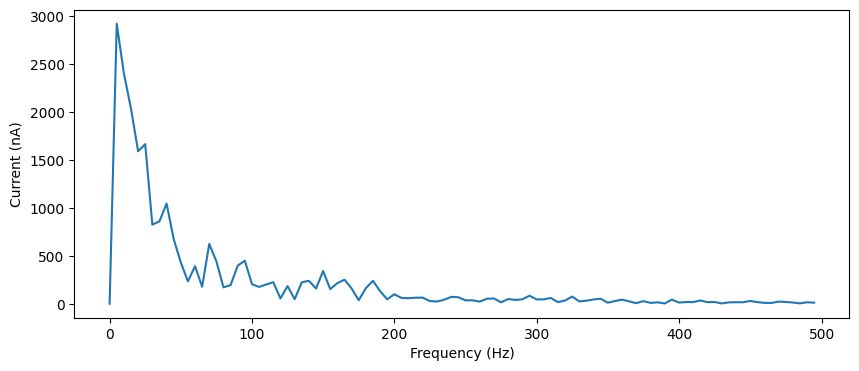

prob12=0.05, prob21=0.05, weight12=0.0045000000000000005, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2922.84071071 2922.84071071]


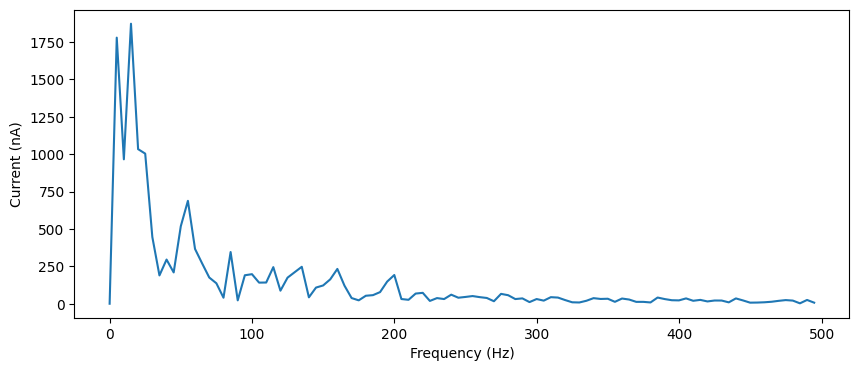

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.0005, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[1872.11745721 1872.11745721]


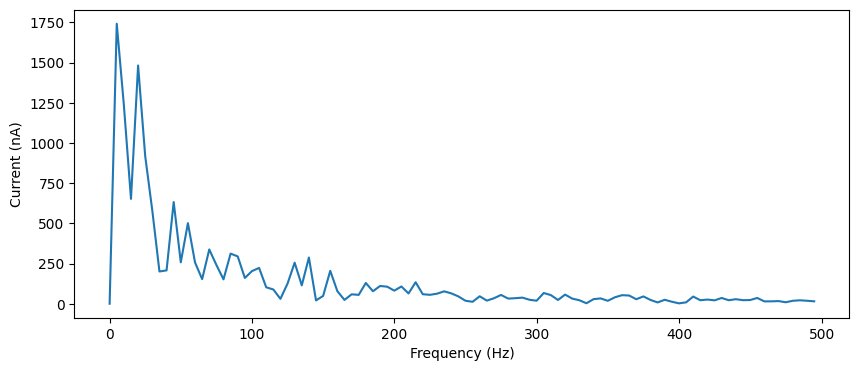

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1741.36765121 1741.36765121]


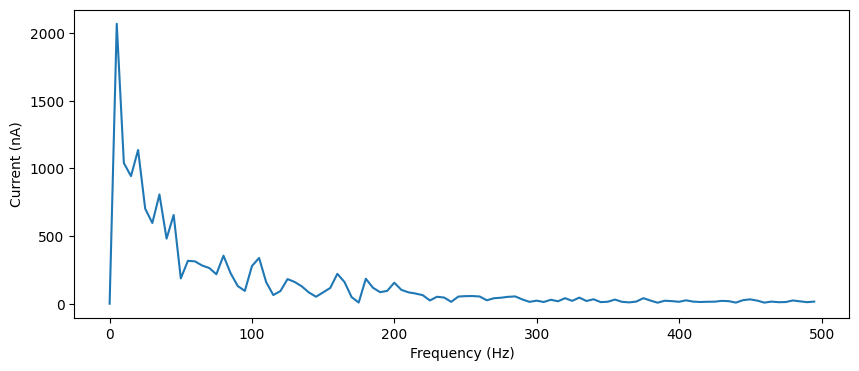

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2070.33245621 2070.33245621]


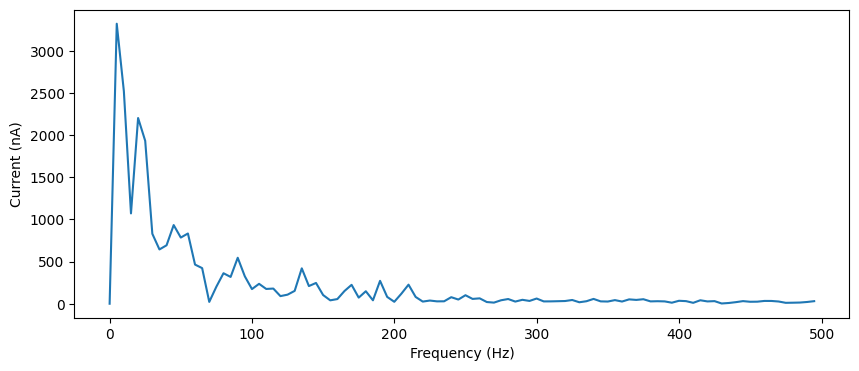

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.002, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3321.8370509 3321.8370509]


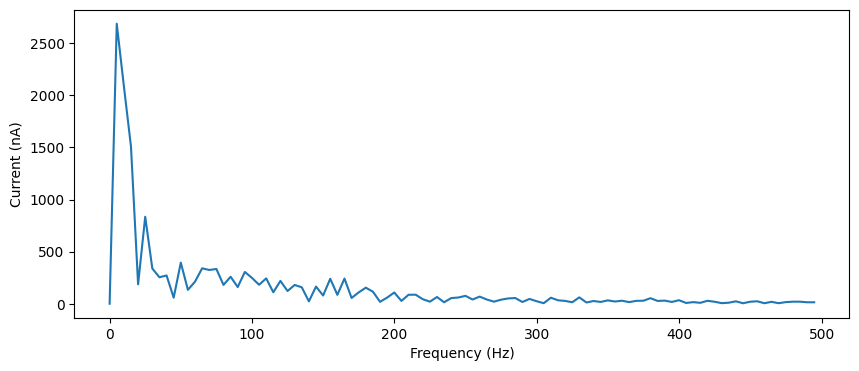

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.0025, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2687.34703582 2687.34703582]


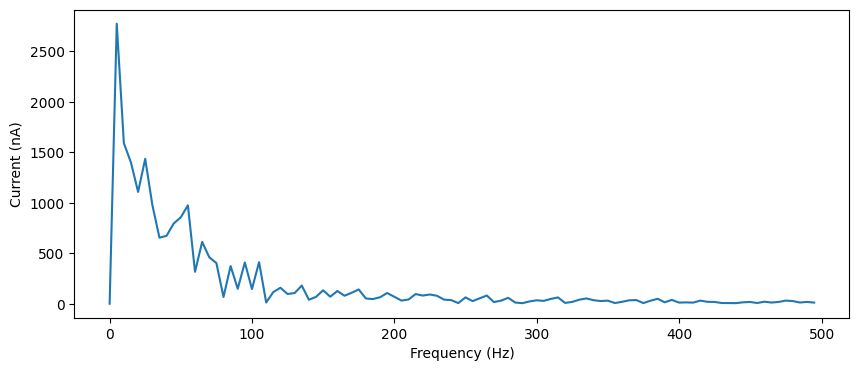

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2772.76229438 2772.76229438]


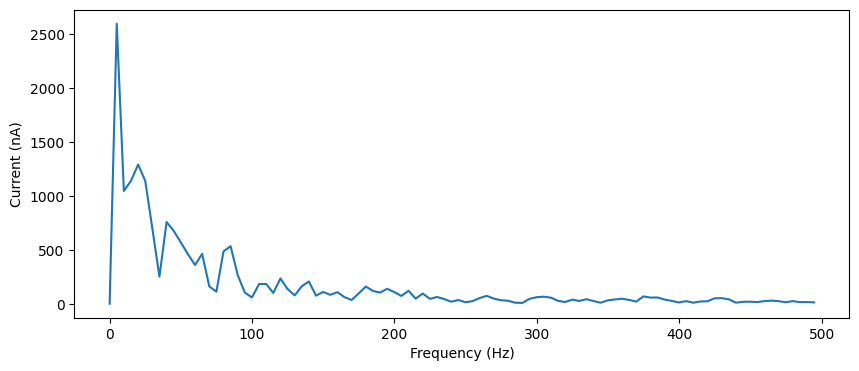

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2594.05505094 2594.05505094]


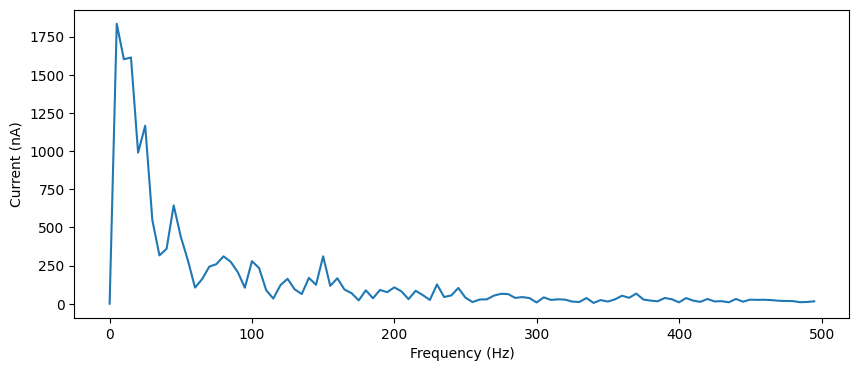

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1834.69263059 1834.69263059]


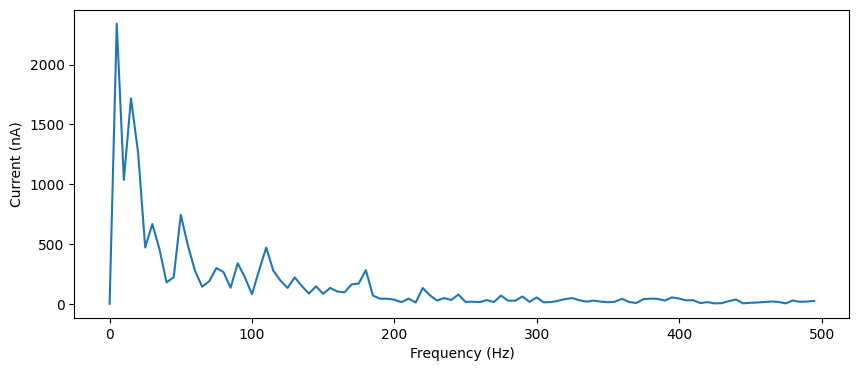

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2340.97513915 2340.97513915]


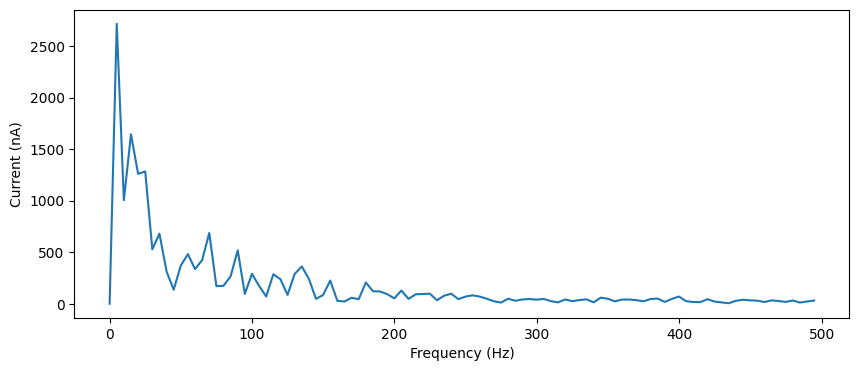

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2716.54865426 2716.54865426]


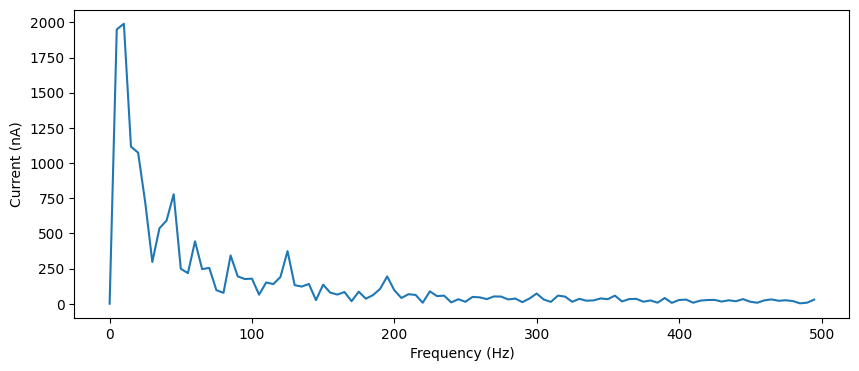

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.0055, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[1990.29948952 1990.29948952]


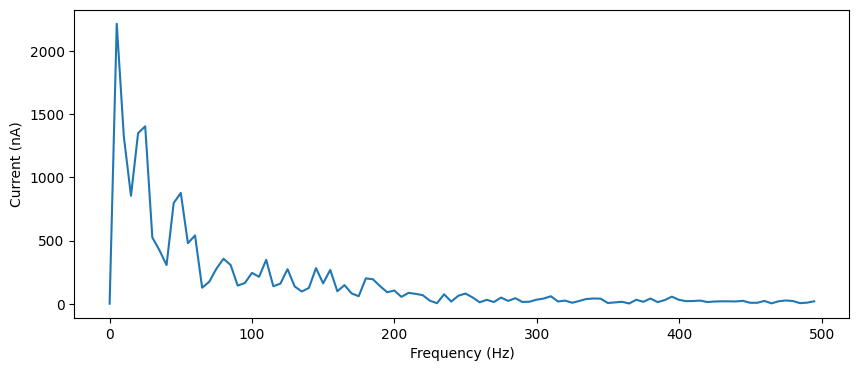

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.006, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2217.80798988 2217.80798988]


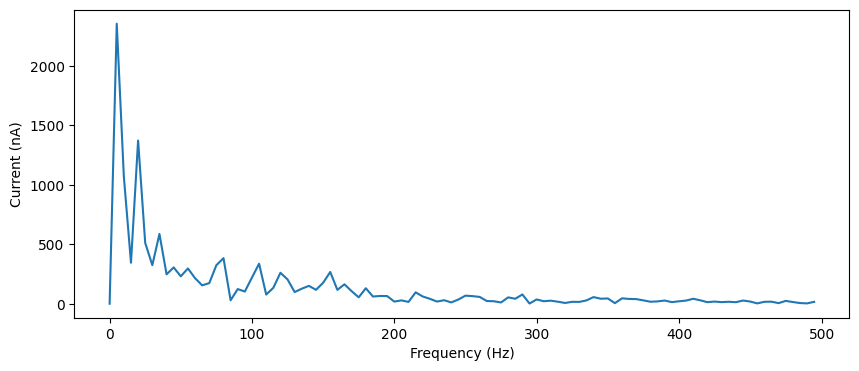

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2353.1437939 2353.1437939]


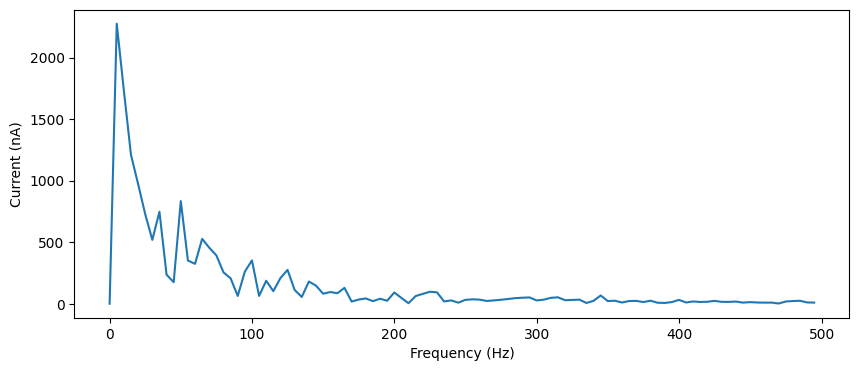

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2275.98788561 2275.98788561]


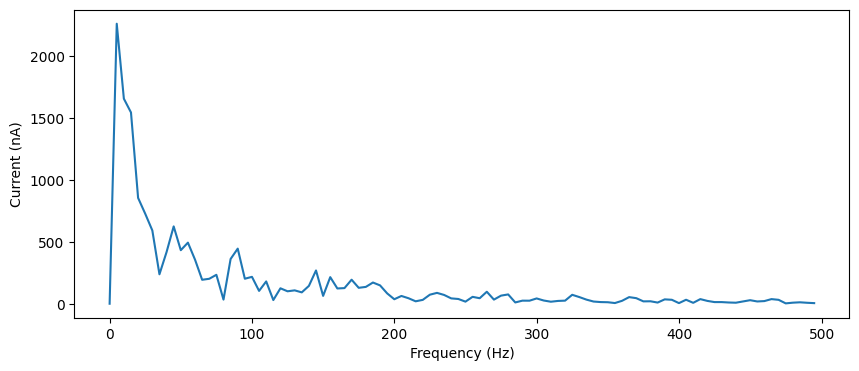

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.0075, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2264.20546178 2264.20546178]


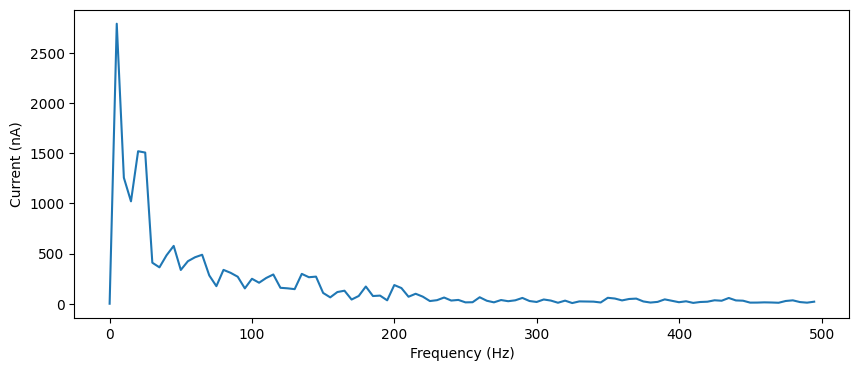

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2789.33050213 2789.33050213]


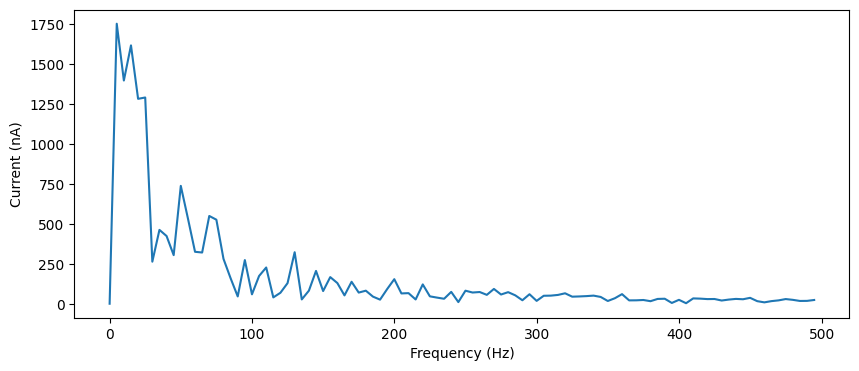

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1751.3473189 1751.3473189]


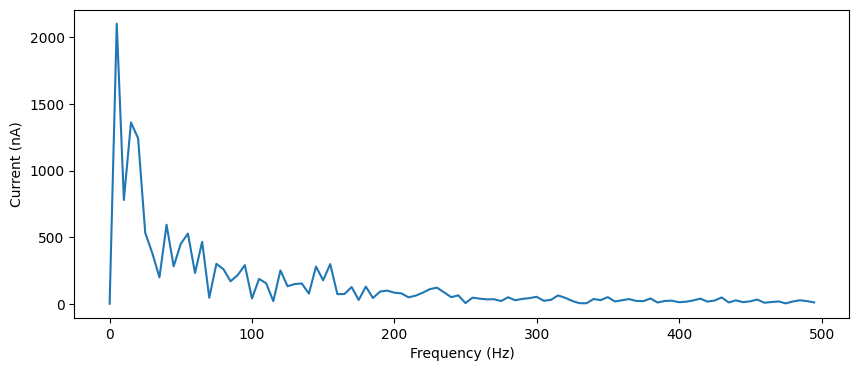

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2102.06989137 2102.06989137]


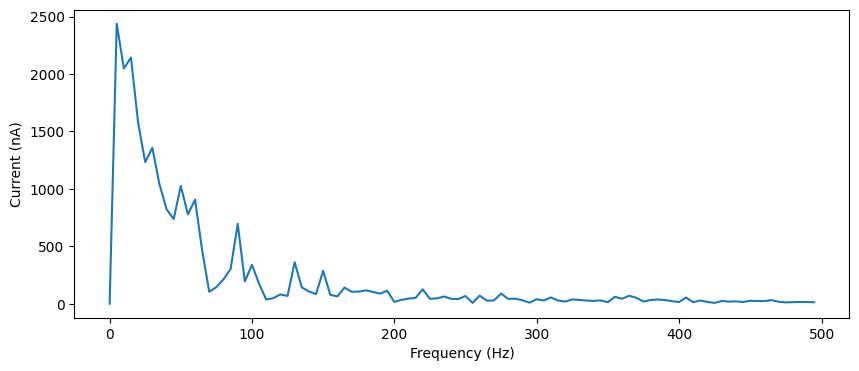

prob12=0.05, prob21=0.05, weight12=0.005000000000000001, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2437.75595323 2437.75595323]


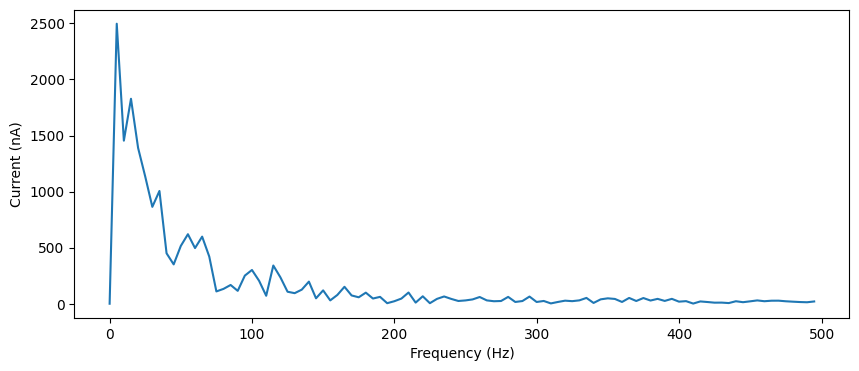

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.0005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2496.7969574 2496.7969574]


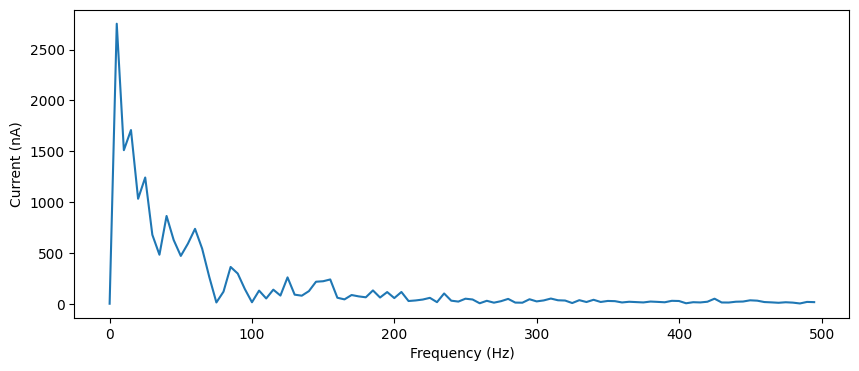

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2753.8802191 2753.8802191]


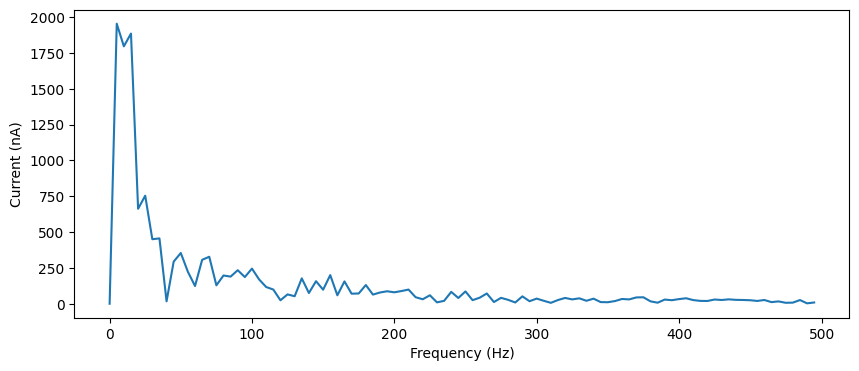

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1953.9456524 1953.9456524]


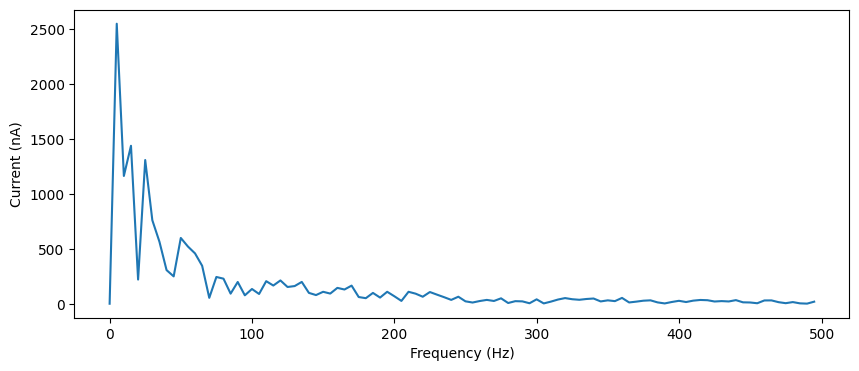

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.002, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2551.50057581 2551.50057581]


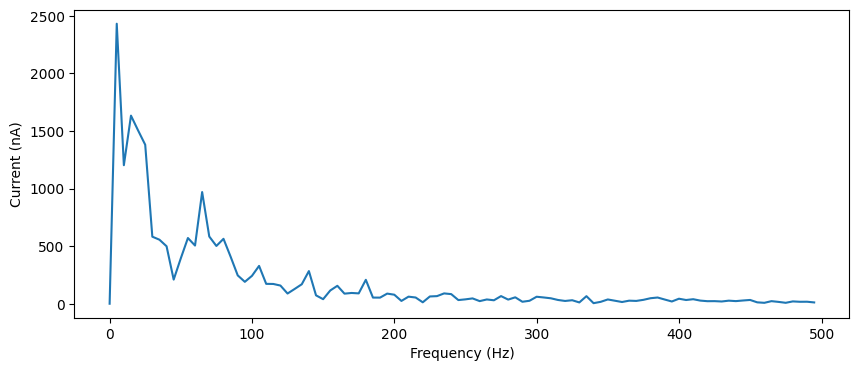

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.0025, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2431.44317151 2431.44317151]


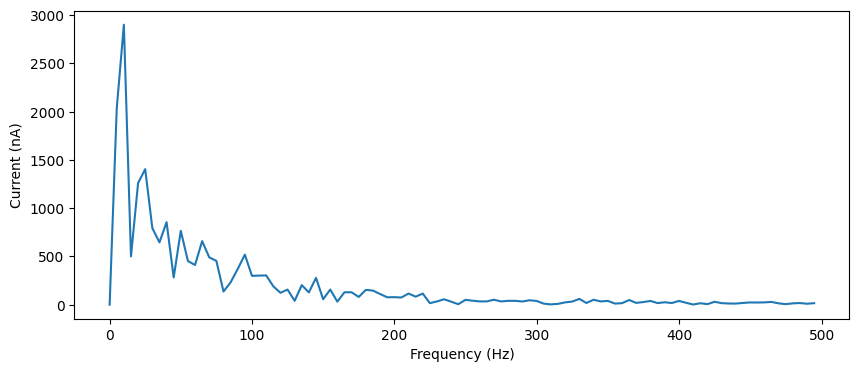

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.003, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2901.37908417 2901.37908417]


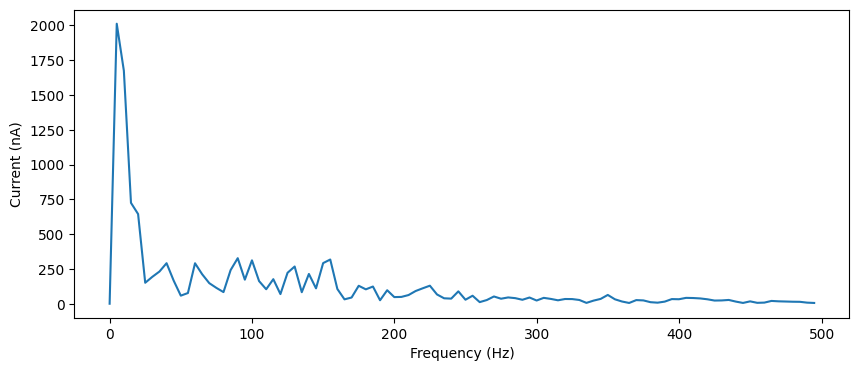

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2011.8759294 2011.8759294]


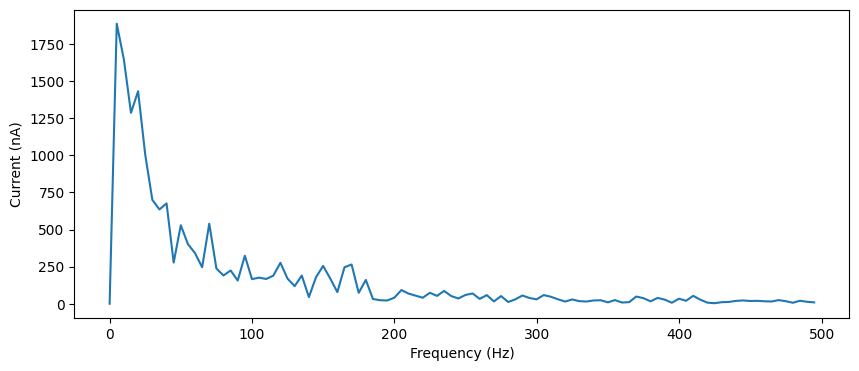

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1887.34354366 1887.34354366]


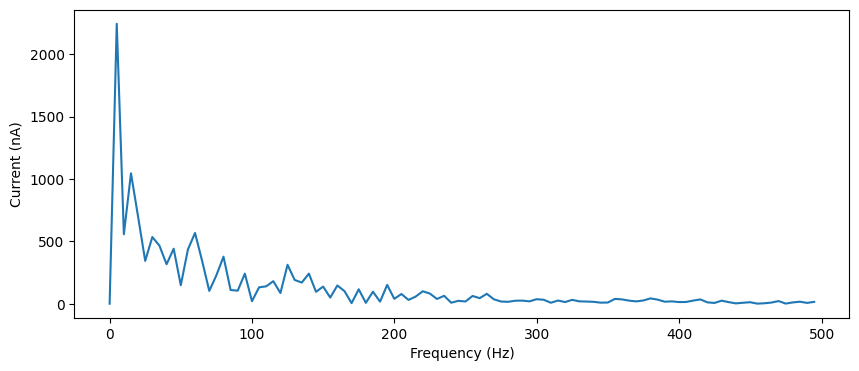

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2244.78863477 2244.78863477]


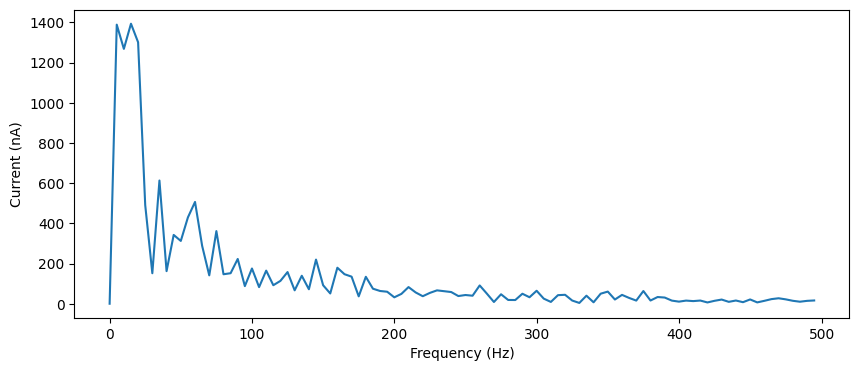

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.005000000000000001, peak_freqs=[ 14.99250375 -14.99250375], peak_freqs_amp=[1393.09264875 1393.09264875]


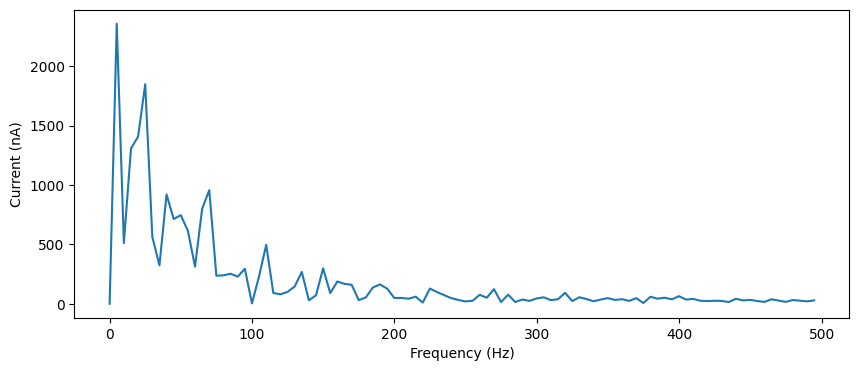

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.0055, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2358.01101405 2358.01101405]


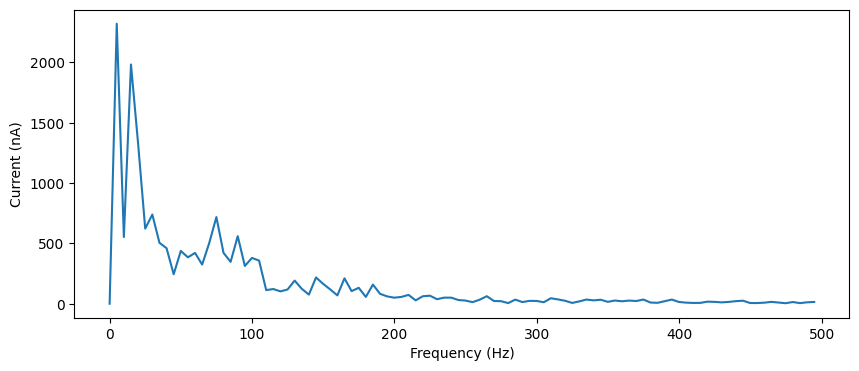

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.006, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2321.47709566 2321.47709566]


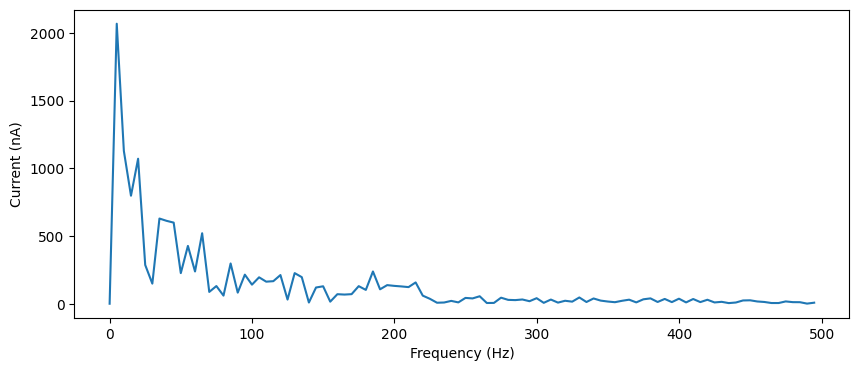

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2068.19174245 2068.19174245]


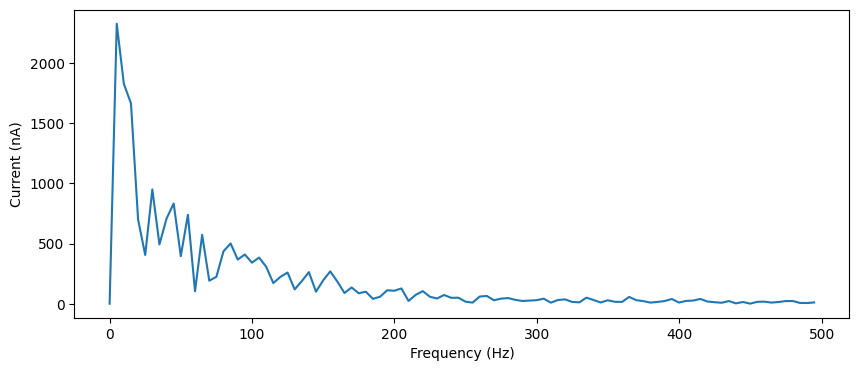

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2327.47733409 2327.47733409]


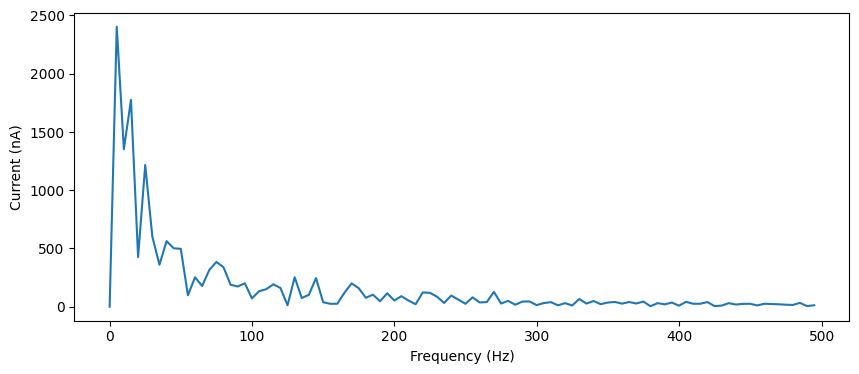

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.0075, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2403.25134809 2403.25134809]


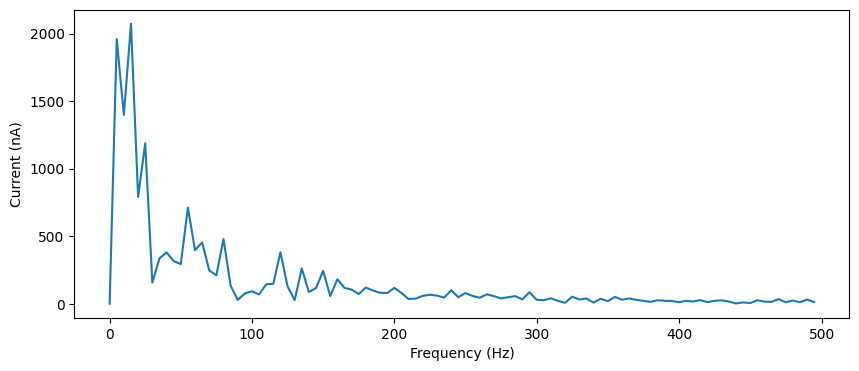

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.008, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[2072.59681029 2072.59681029]


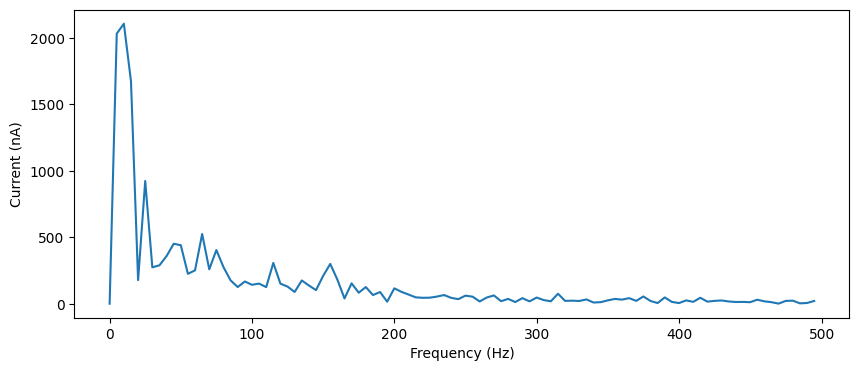

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.0085, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2105.86903229 2105.86903229]


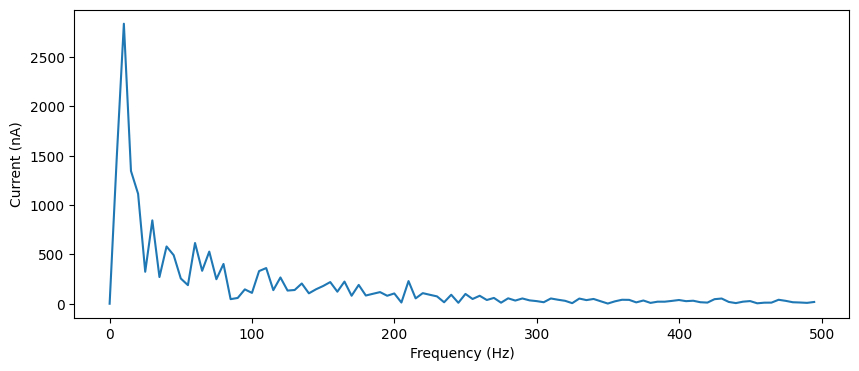

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.009000000000000001, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[2838.84117382 2838.84117382]


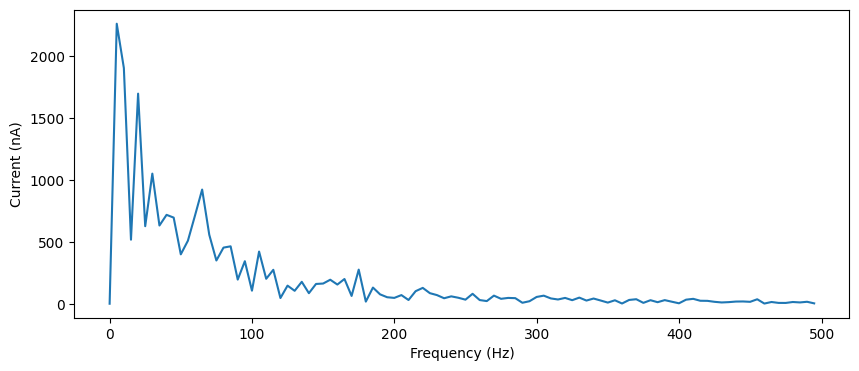

prob12=0.05, prob21=0.05, weight12=0.0055, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2264.33218216 2264.33218216]


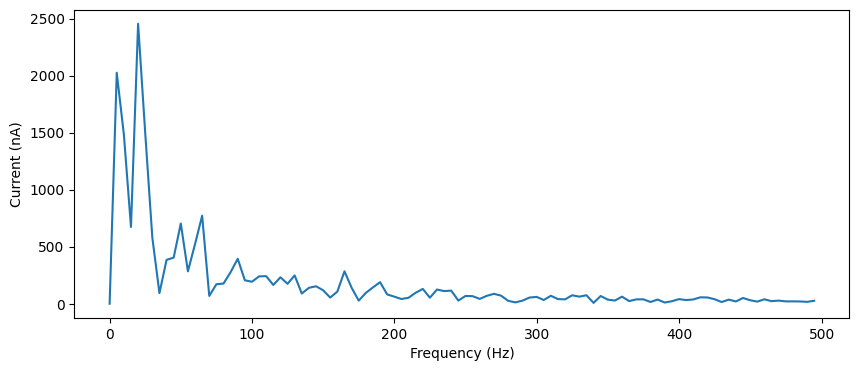

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.0005, peak_freqs=[ 19.990005 -19.990005], peak_freqs_amp=[2455.12253224 2455.12253224]


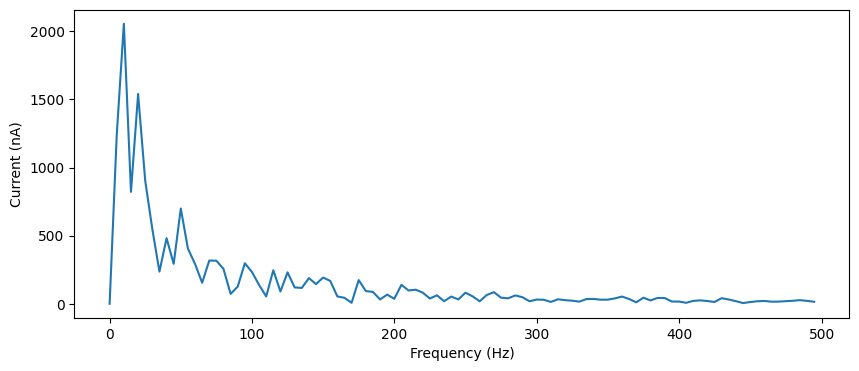

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.001, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2055.82023766 2055.82023766]


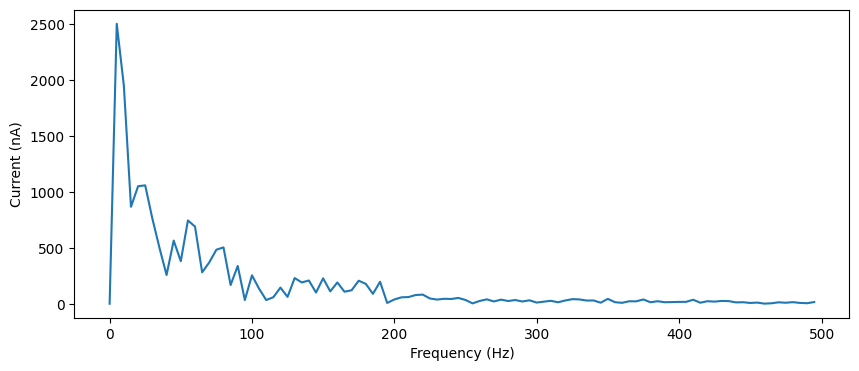

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2506.30985016 2506.30985016]


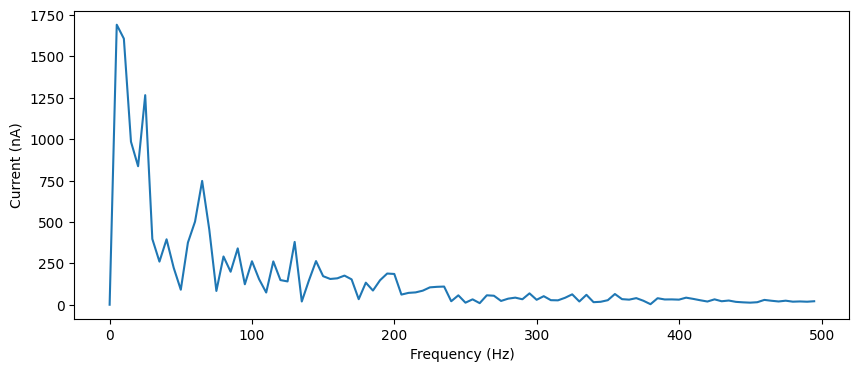

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.002, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1691.67991388 1691.67991388]


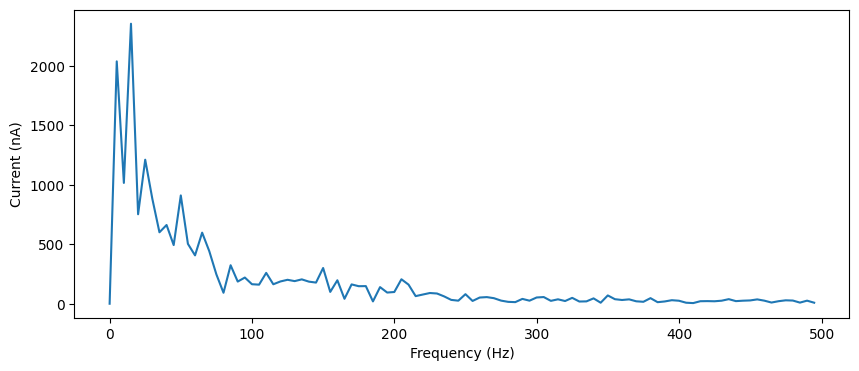

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.0025, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[2356.44856986 2356.44856986]


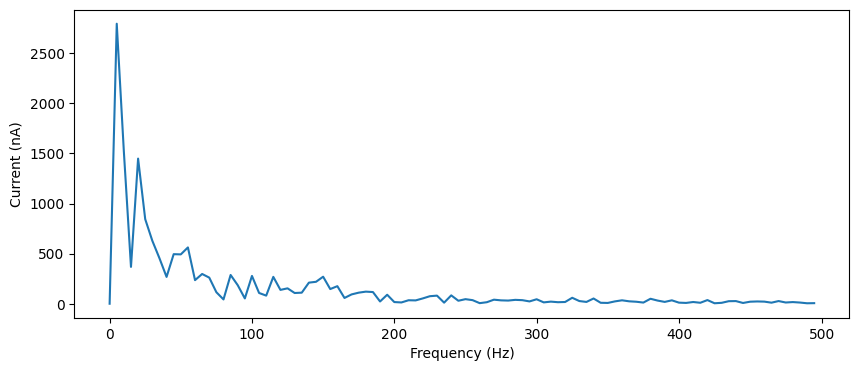

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2793.87199529 2793.87199529]


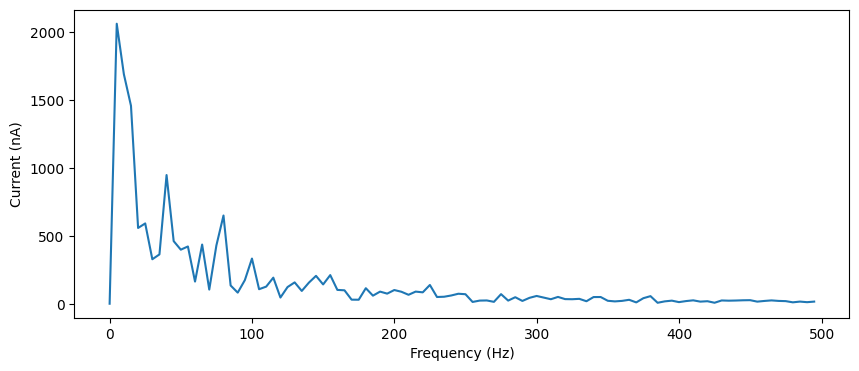

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2060.69850606 2060.69850606]


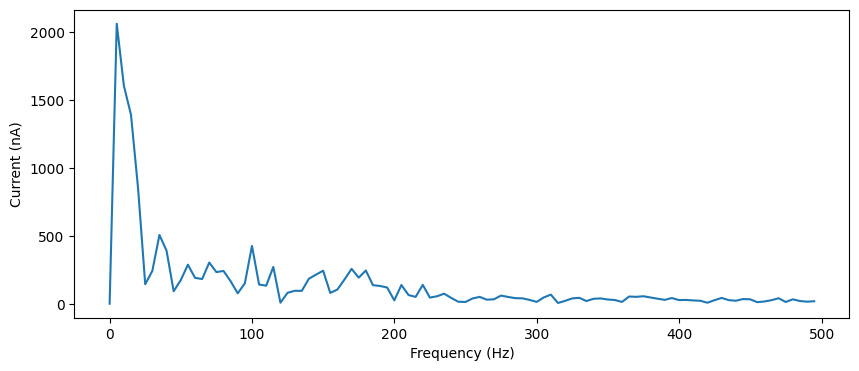

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2064.56851746 2064.56851746]


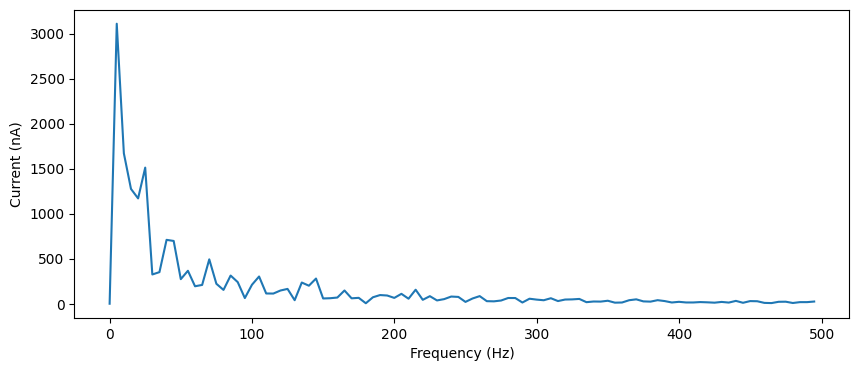

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3109.26069878 3109.26069878]


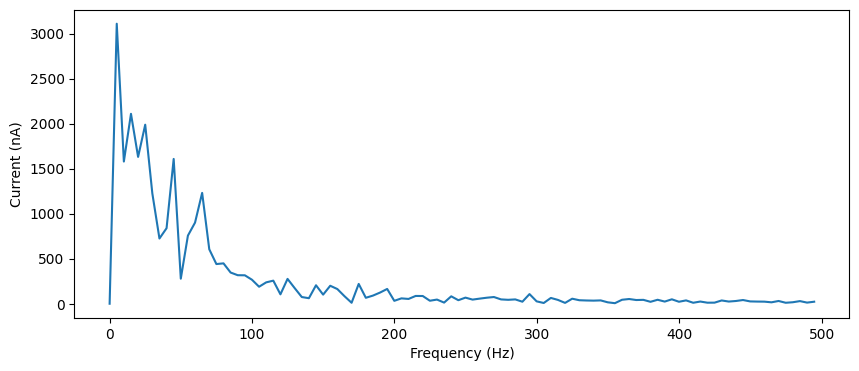

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3108.7135727 3108.7135727]


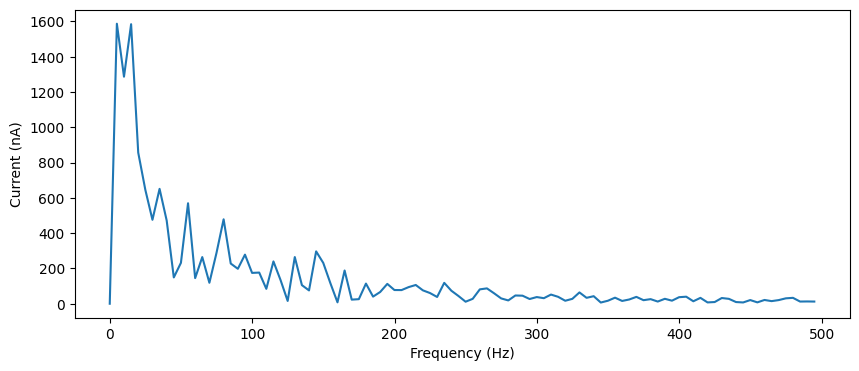

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.0055, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1587.2732432 1587.2732432]


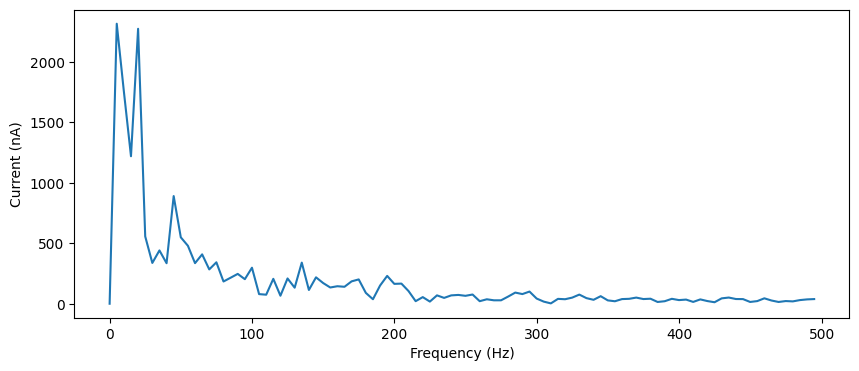

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.006, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2315.24835265 2315.24835265]


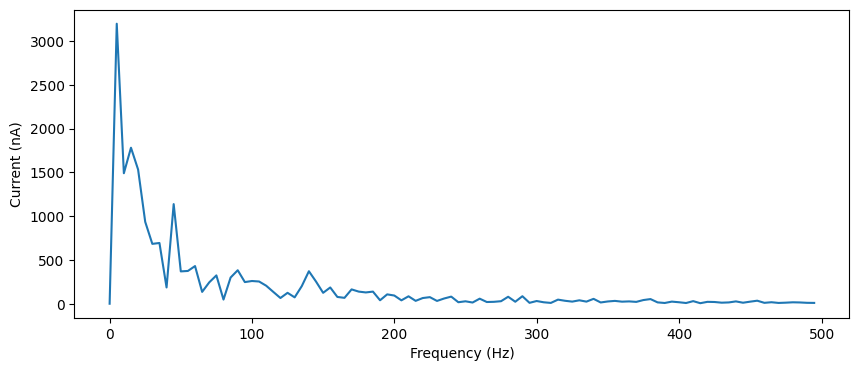

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3196.80596555 3196.80596555]


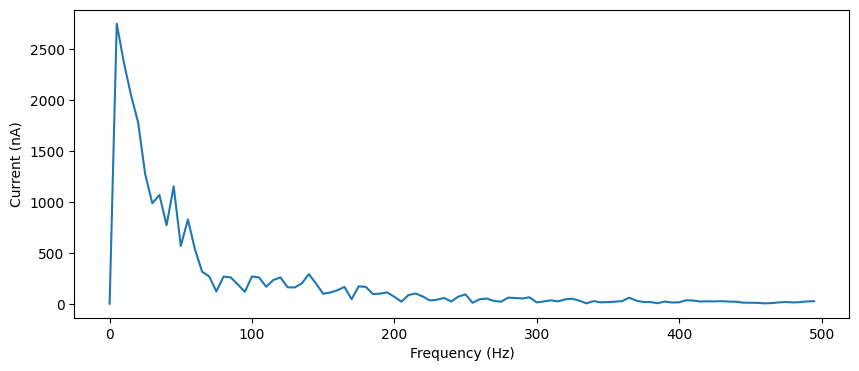

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2748.5941847 2748.5941847]


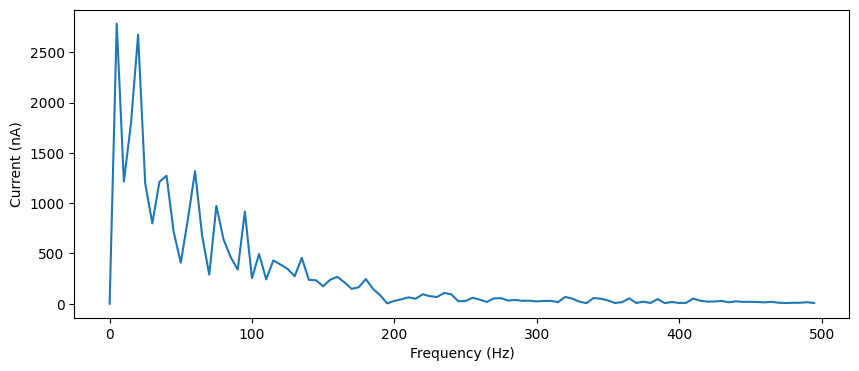

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.0075, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2784.44458433 2784.44458433]


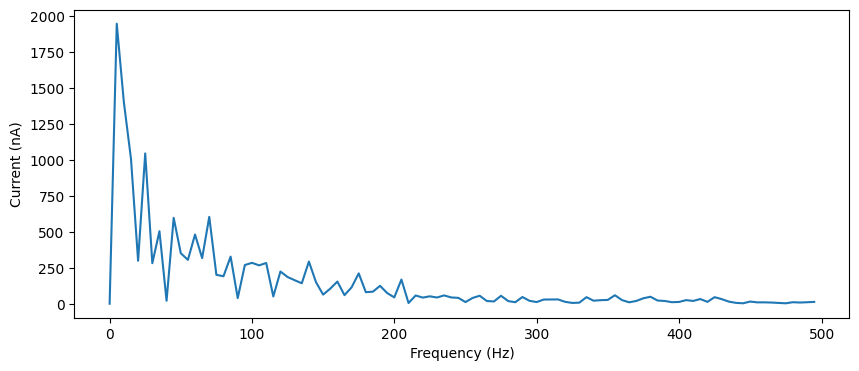

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1948.00666669 1948.00666669]


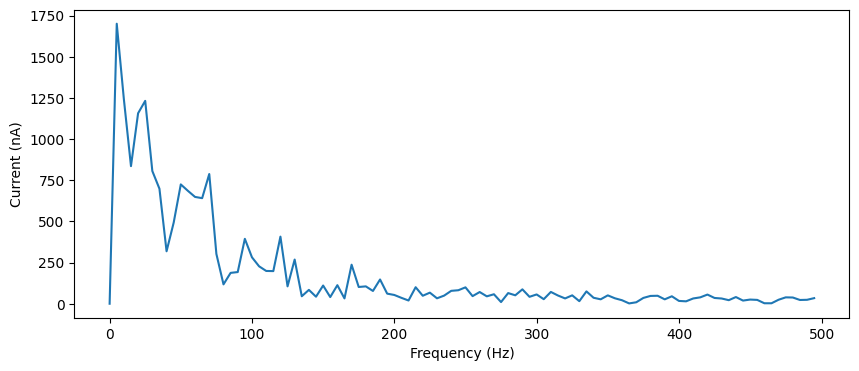

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1701.24836106 1701.24836106]


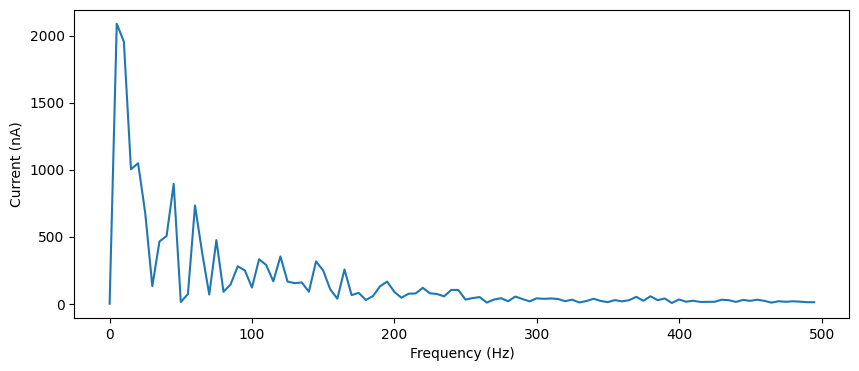

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2088.68043932 2088.68043932]


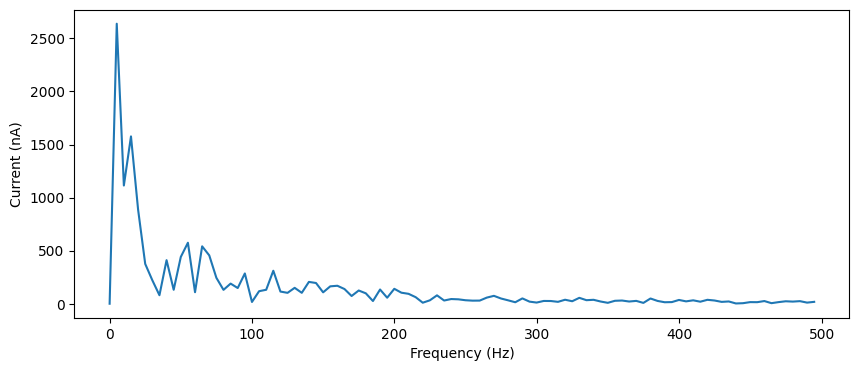

prob12=0.05, prob21=0.05, weight12=0.006, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2638.34539159 2638.34539159]


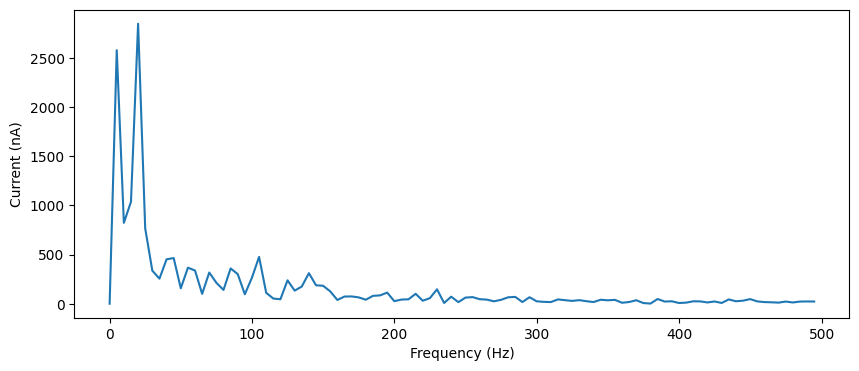

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.0005, peak_freqs=[ 19.990005 -19.990005], peak_freqs_amp=[2850.17462821 2850.17462821]


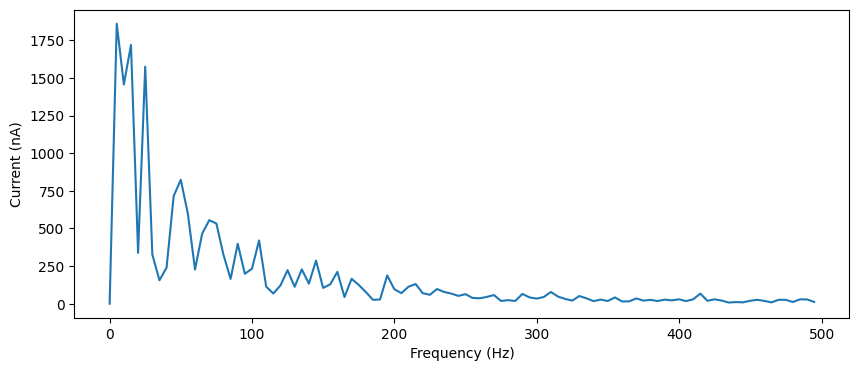

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1860.93748831 1860.93748831]


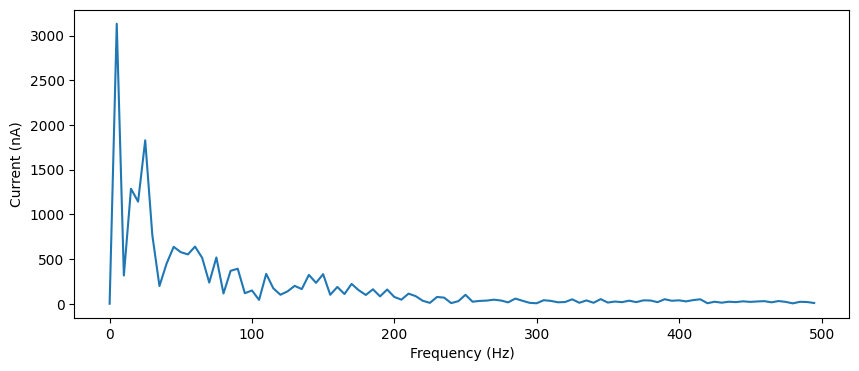

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3133.16528625 3133.16528625]


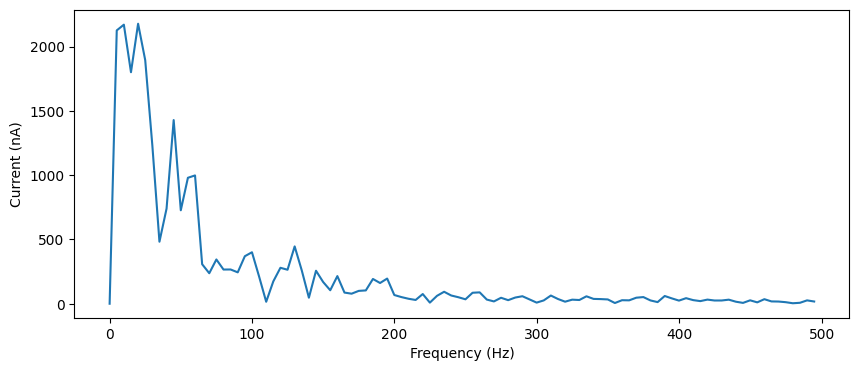

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.002, peak_freqs=[ 19.990005 -19.990005], peak_freqs_amp=[2177.16698783 2177.16698783]


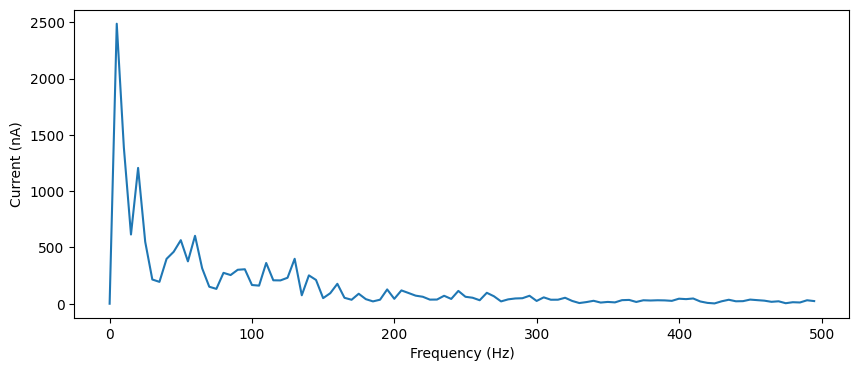

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.0025, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2487.22372681 2487.22372681]


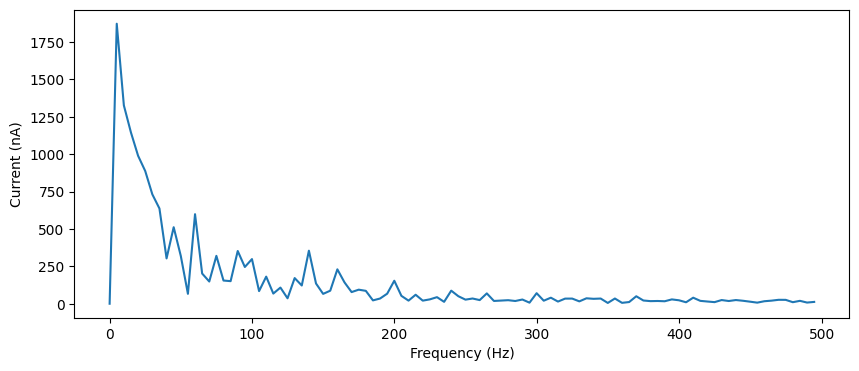

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1872.76902642 1872.76902642]


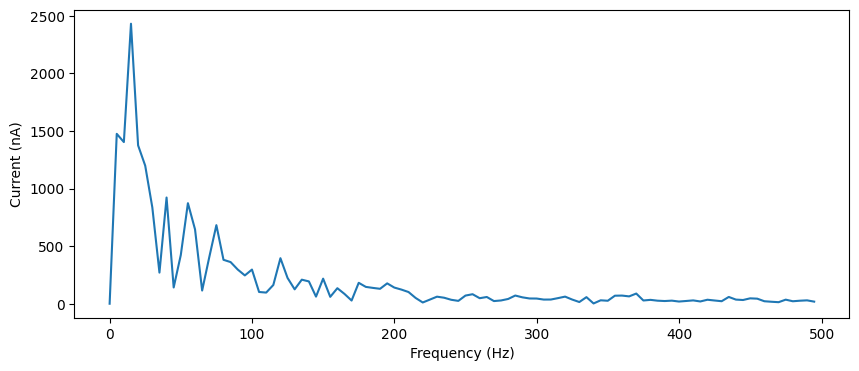

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.0035, peak_freqs=[ 14.99250375 -14.99250375], peak_freqs_amp=[2432.35365007 2432.35365007]


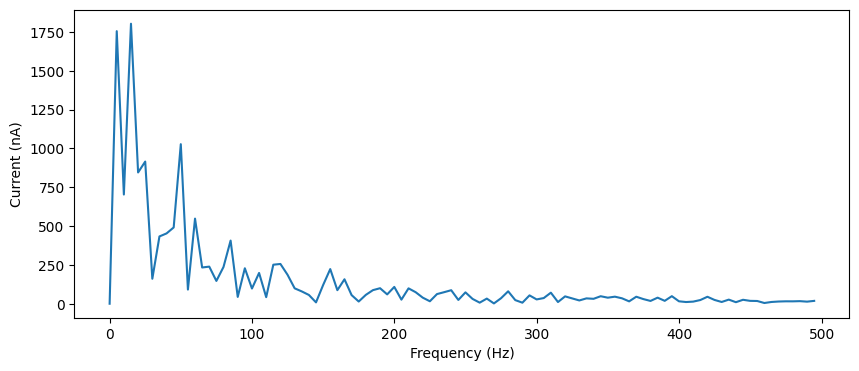

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.004, peak_freqs=[ 14.99250375 -14.99250375], peak_freqs_amp=[1803.02292776 1803.02292776]


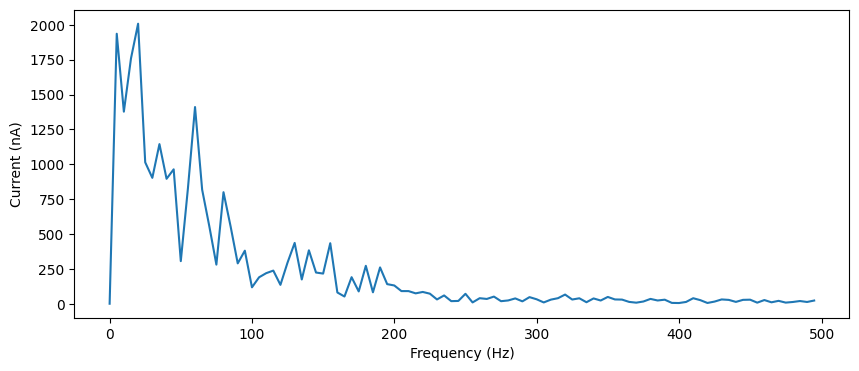

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.0045000000000000005, peak_freqs=[-19.990005  19.990005], peak_freqs_amp=[2008.17306699 2008.17306699]


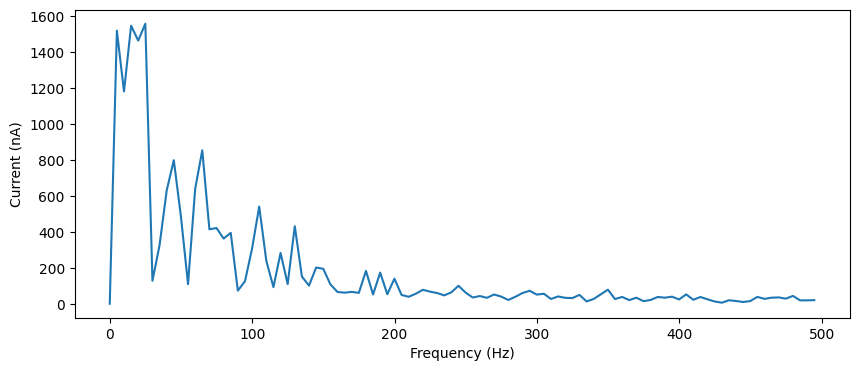

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.005000000000000001, peak_freqs=[-24.98750625  24.98750625], peak_freqs_amp=[1555.93947709 1555.93947709]


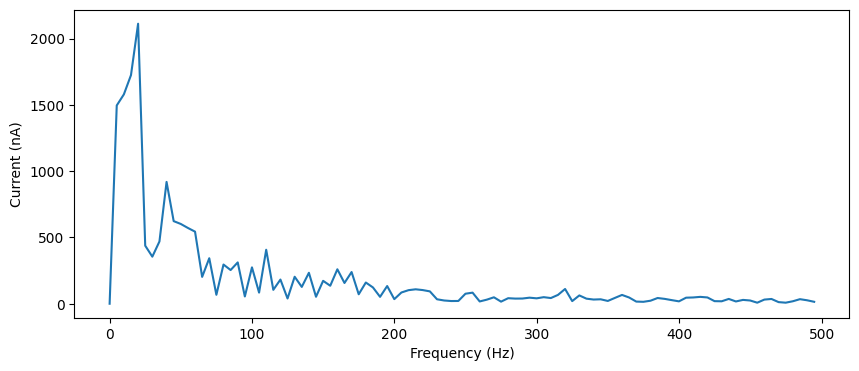

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.0055, peak_freqs=[-19.990005  19.990005], peak_freqs_amp=[2113.08847912 2113.08847912]


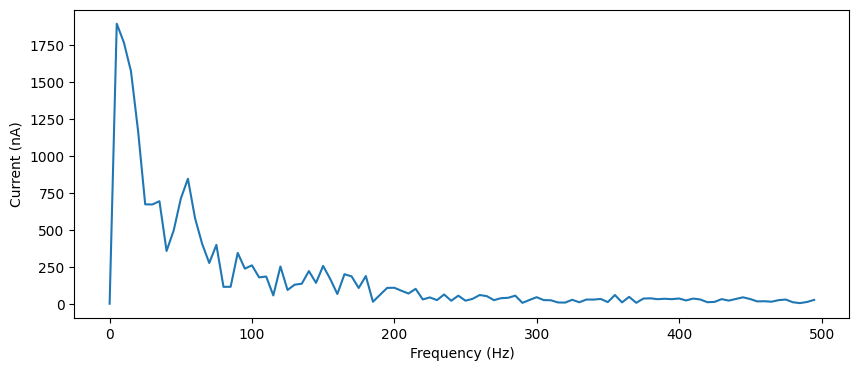

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.006, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1895.30263179 1895.30263179]


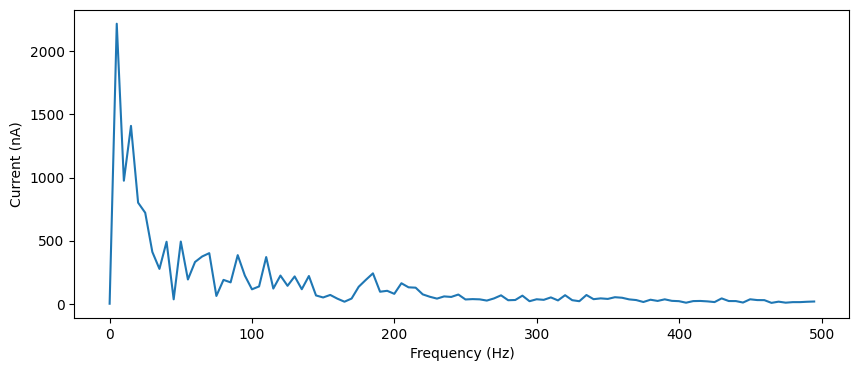

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2218.8784118 2218.8784118]


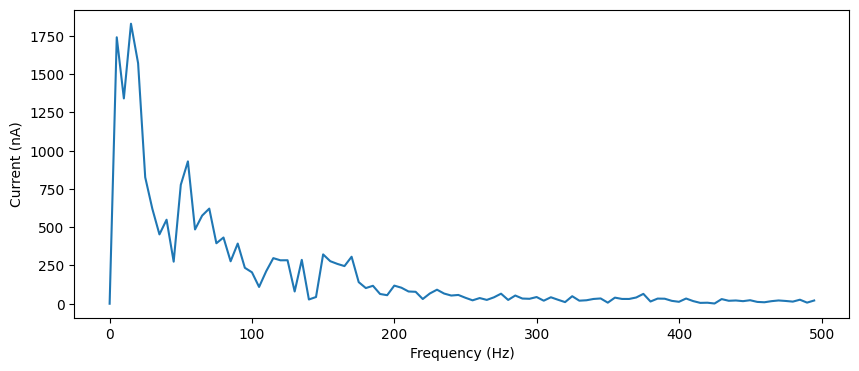

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.007000000000000001, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[1830.23088865 1830.23088865]


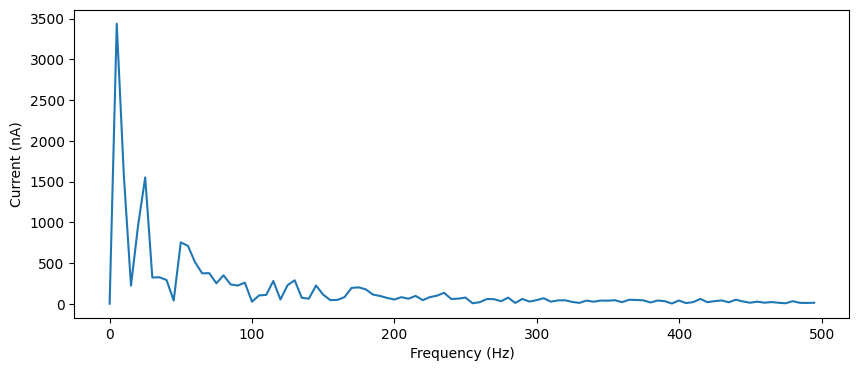

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.0075, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3437.59230308 3437.59230308]


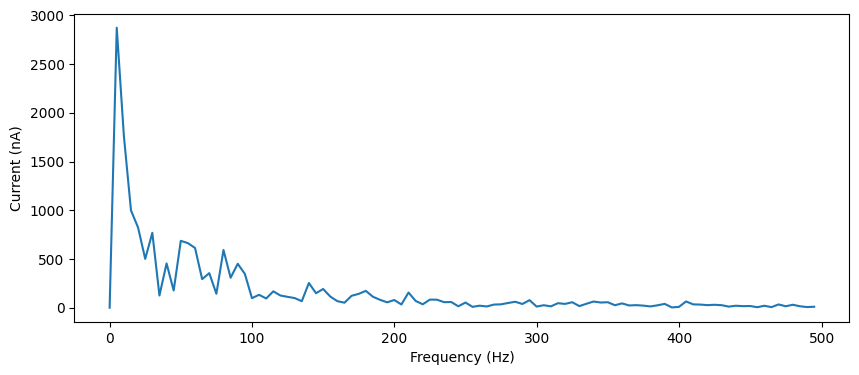

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2872.47460776 2872.47460776]


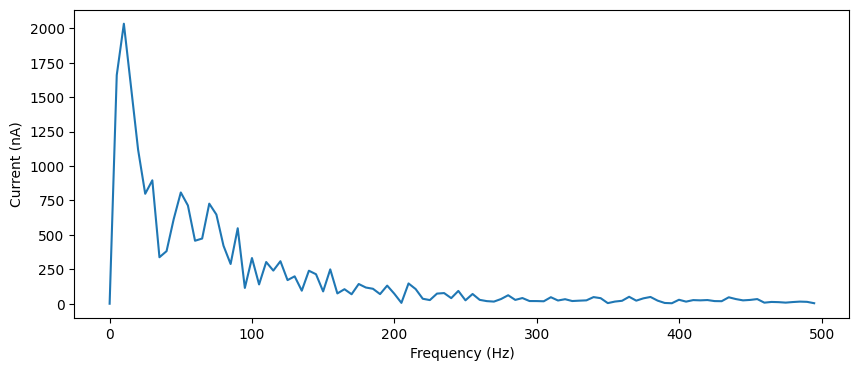

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.0085, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[2033.7431996 2033.7431996]


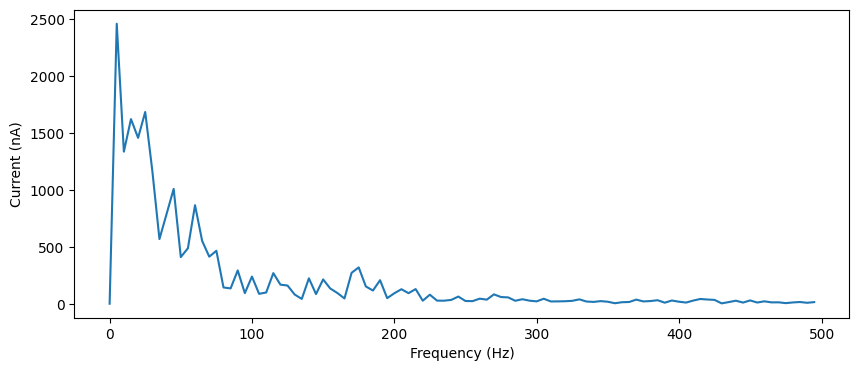

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2456.86265582 2456.86265582]


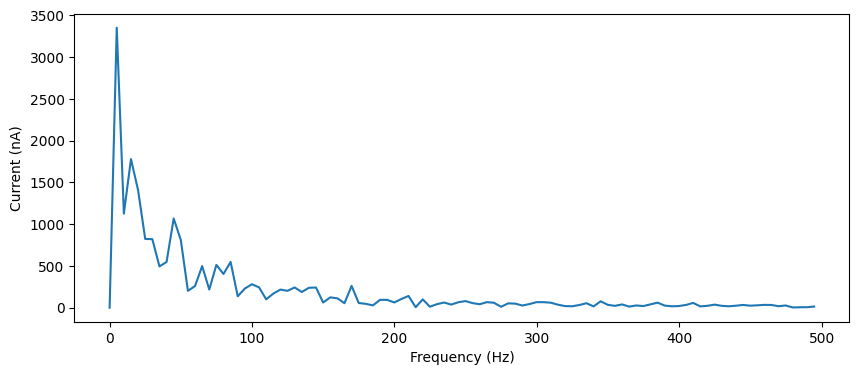

prob12=0.05, prob21=0.05, weight12=0.006500000000000001, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3352.56376626 3352.56376626]


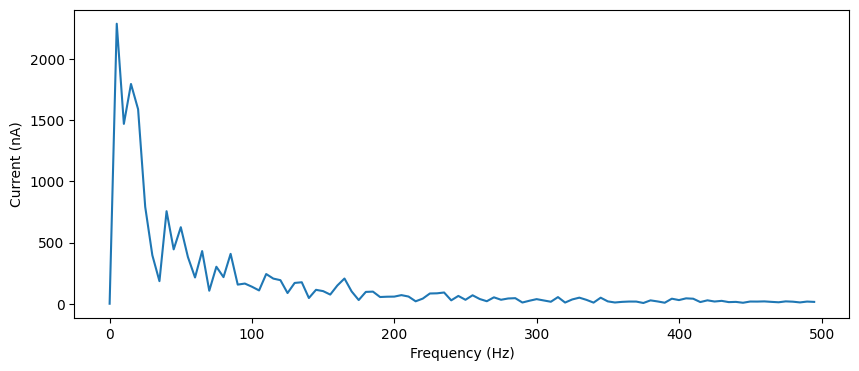

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.0005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2290.05538901 2290.05538901]


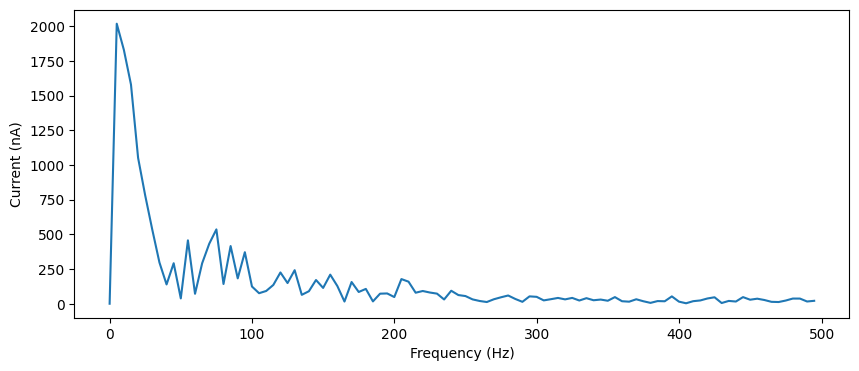

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2017.89254478 2017.89254478]


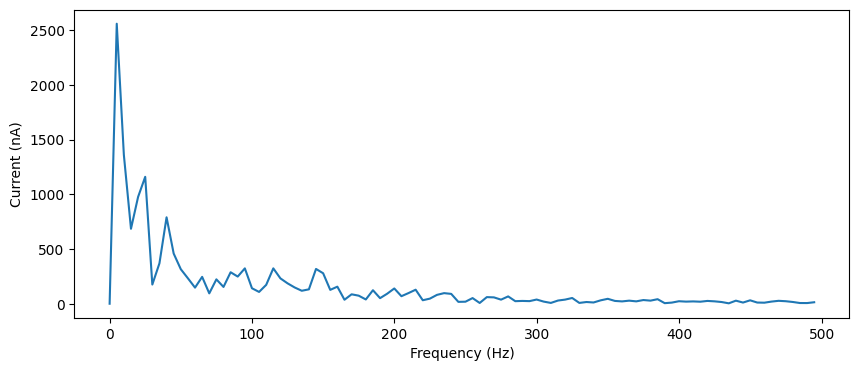

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2560.78908203 2560.78908203]


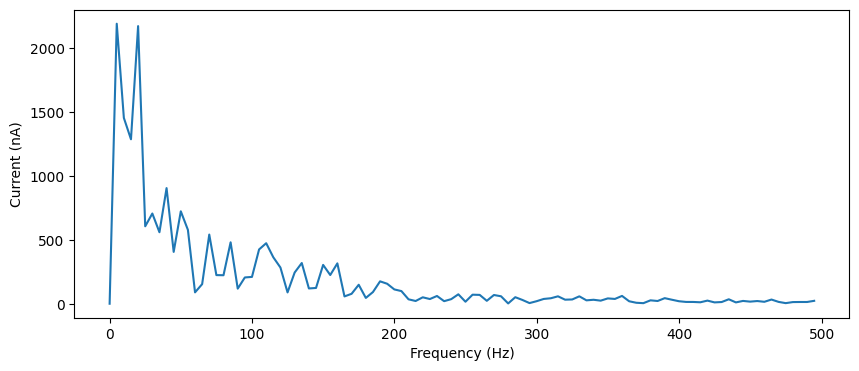

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.002, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2191.00929125 2191.00929125]


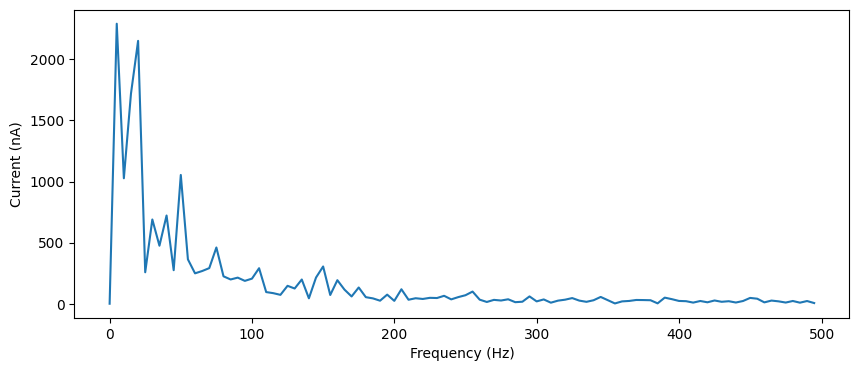

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.0025, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2291.72351846 2291.72351846]


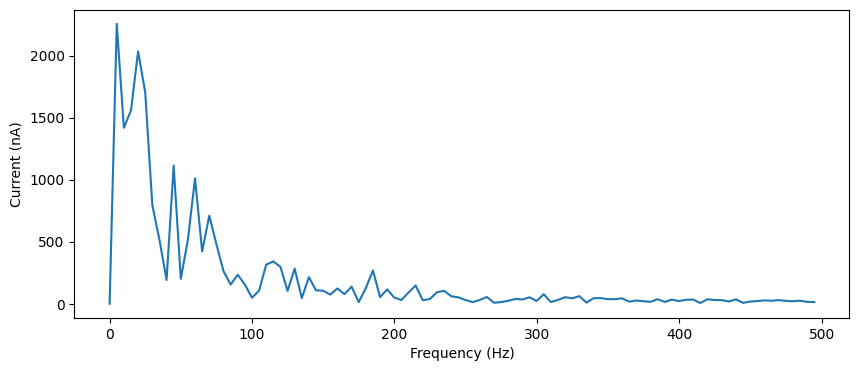

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2257.50725074 2257.50725074]


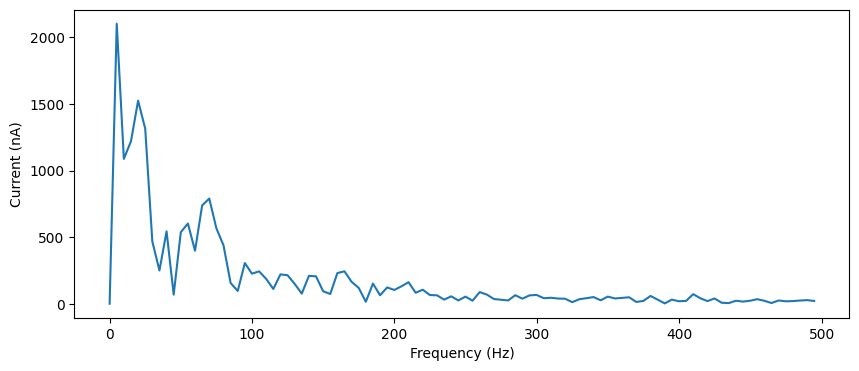

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2103.41130021 2103.41130021]


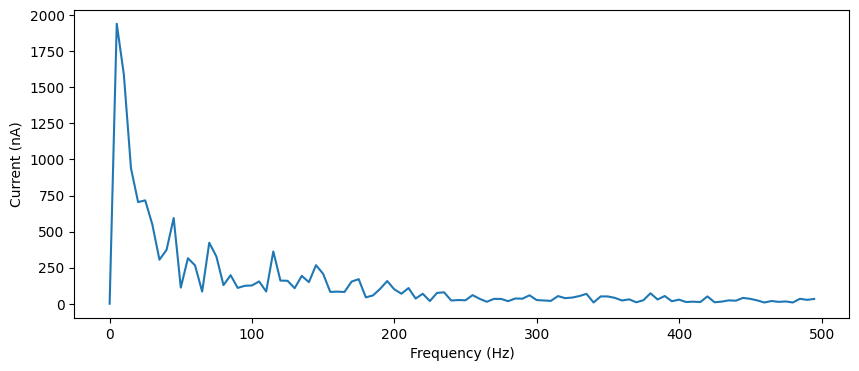

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1941.37586671 1941.37586671]


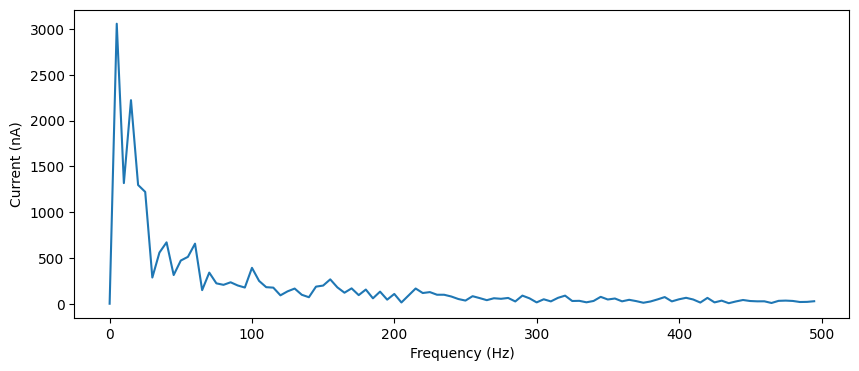

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3057.27861096 3057.27861096]


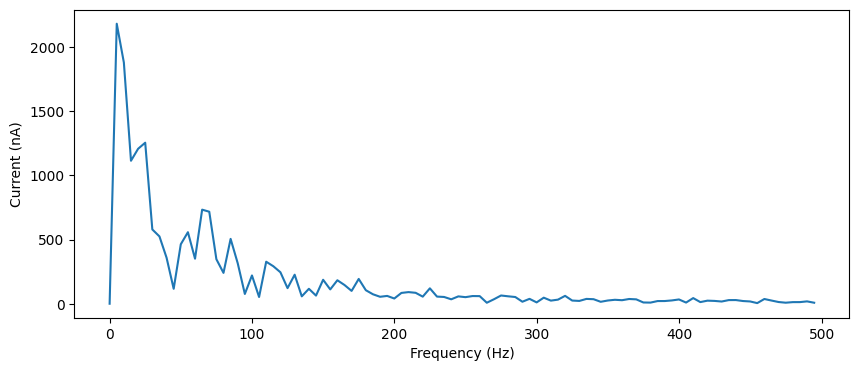

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2181.71240677 2181.71240677]


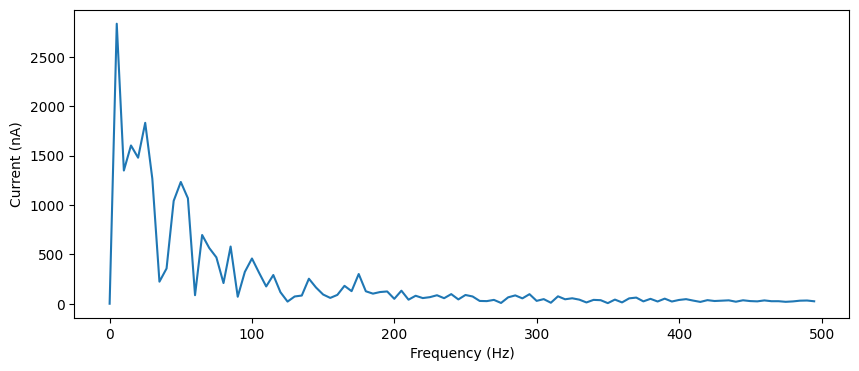

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.0055, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2836.70190403 2836.70190403]


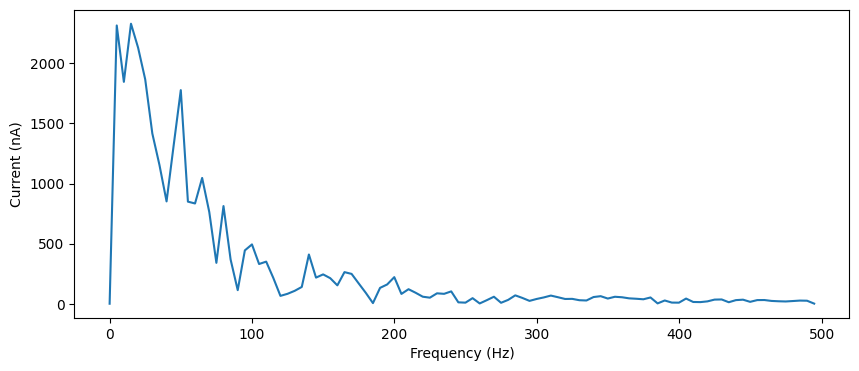

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.006, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[2329.13366817 2329.13366817]


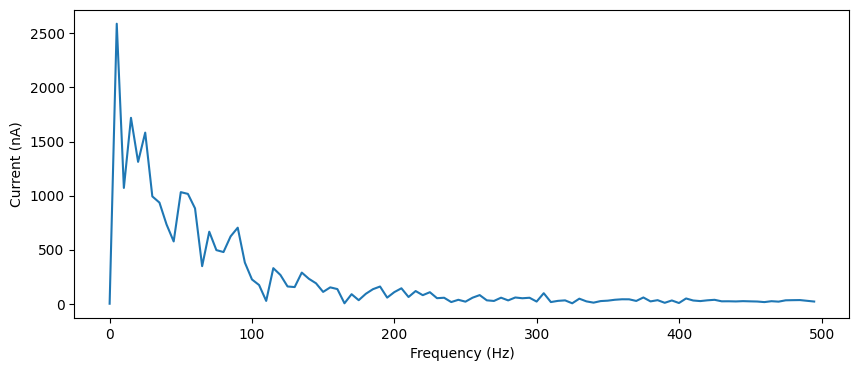

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2589.41636547 2589.41636547]


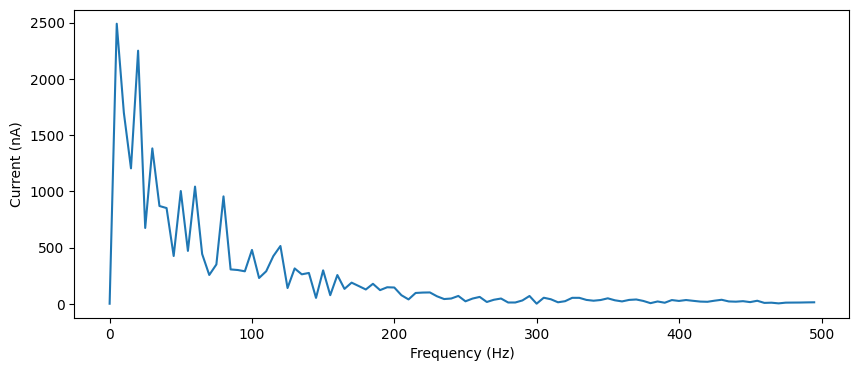

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2490.46812997 2490.46812997]


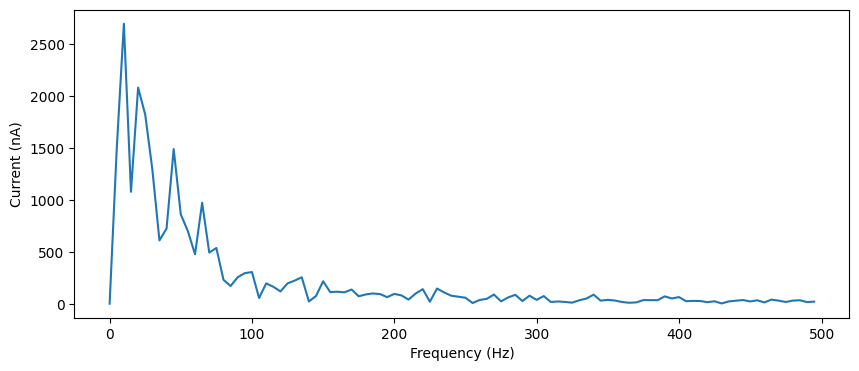

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.0075, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[2694.86990661 2694.86990661]


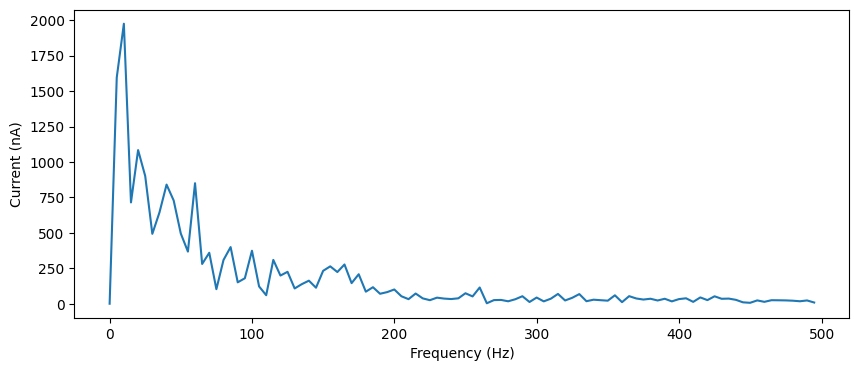

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.008, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1975.4798077 1975.4798077]


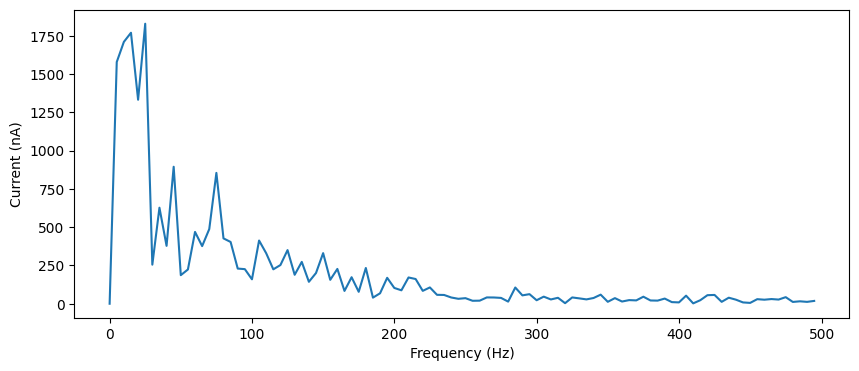

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.0085, peak_freqs=[ 24.98750625 -24.98750625], peak_freqs_amp=[1829.67127164 1829.67127164]


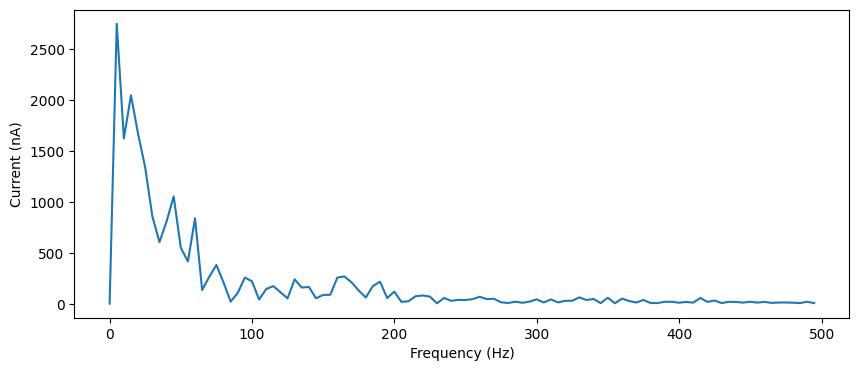

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2752.81111946 2752.81111946]


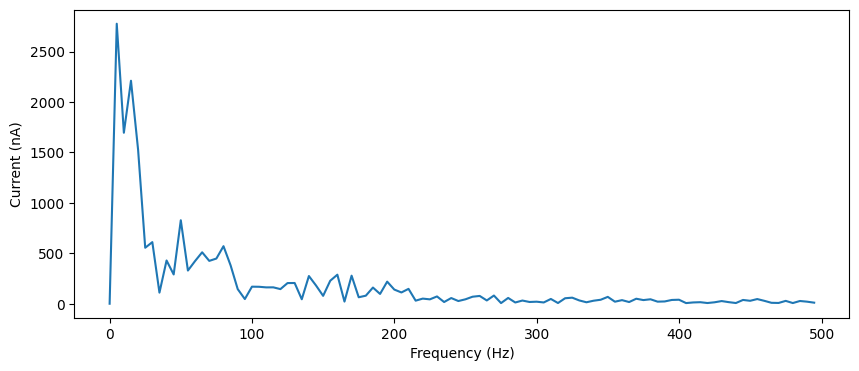

prob12=0.05, prob21=0.05, weight12=0.007000000000000001, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2777.07169641 2777.07169641]


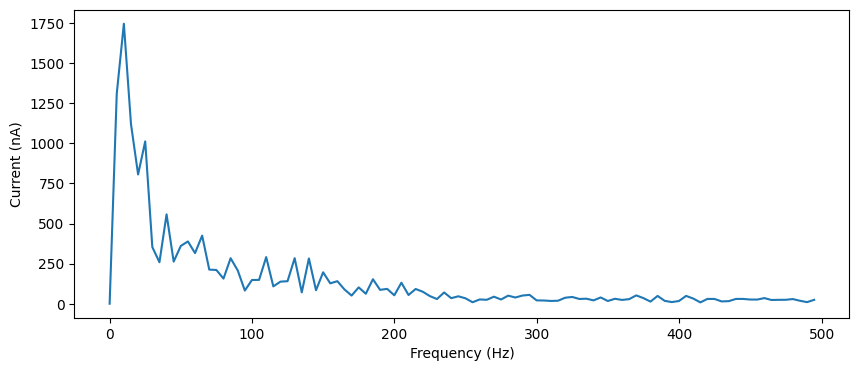

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.0005, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1745.19788274 1745.19788274]


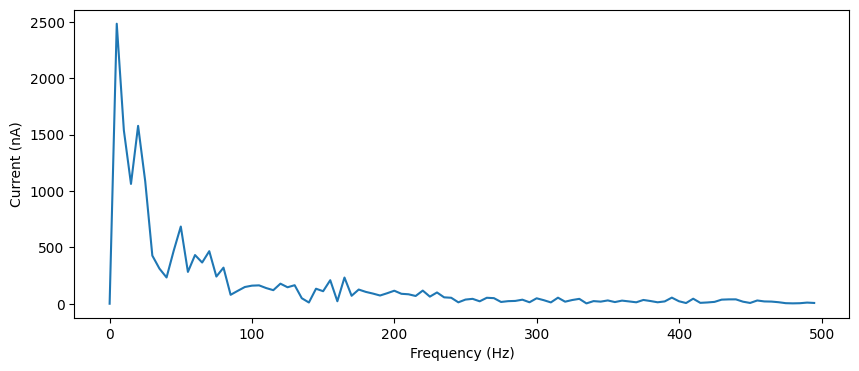

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2484.2154161 2484.2154161]


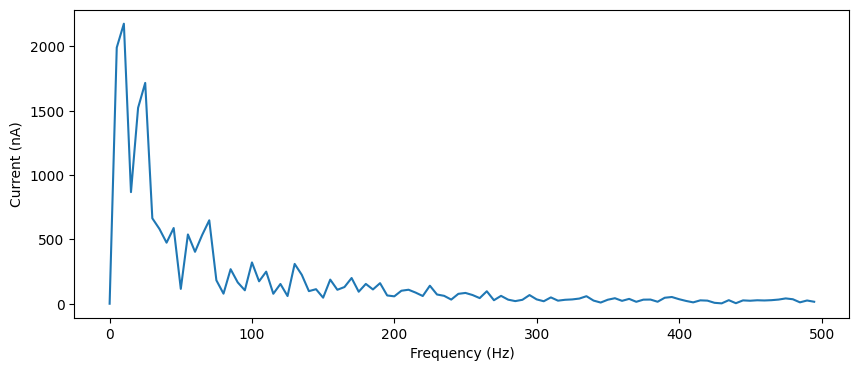

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.0015, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2176.71383312 2176.71383312]


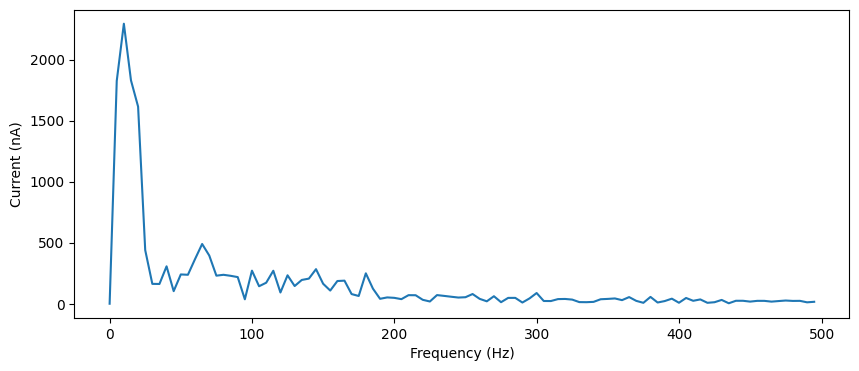

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.002, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2293.7401243 2293.7401243]


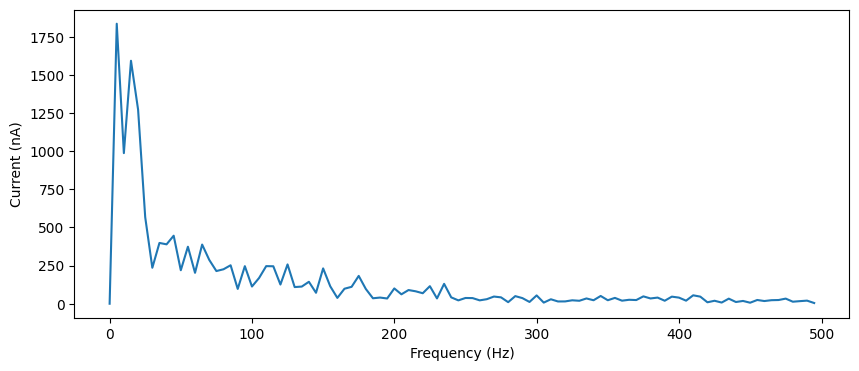

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.0025, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1835.85140732 1835.85140732]


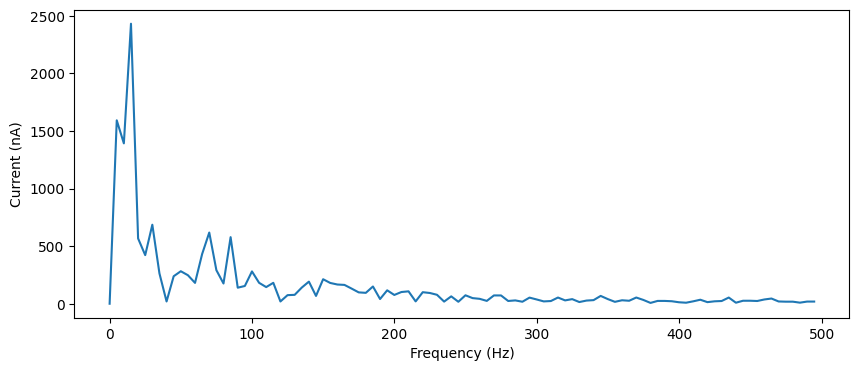

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.003, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[2432.23423576 2432.23423576]


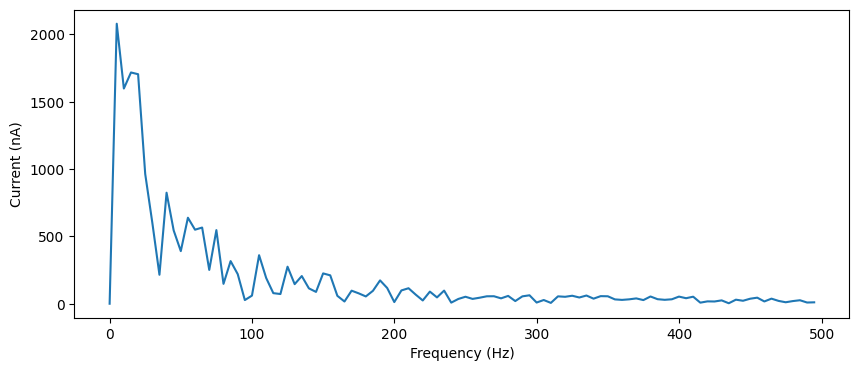

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2079.84538151 2079.84538151]


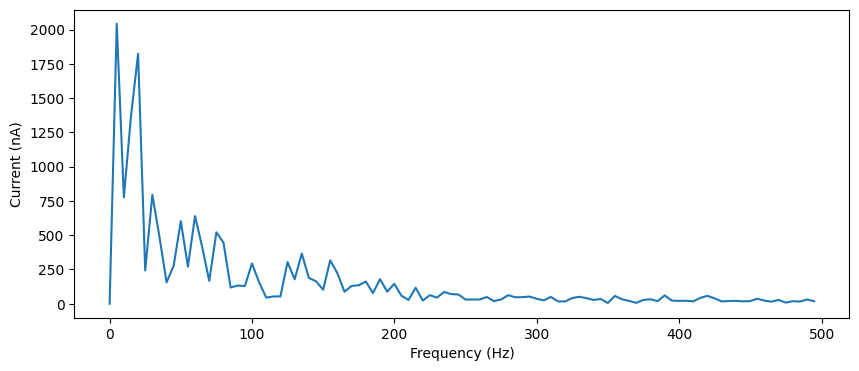

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2042.76164247 2042.76164247]


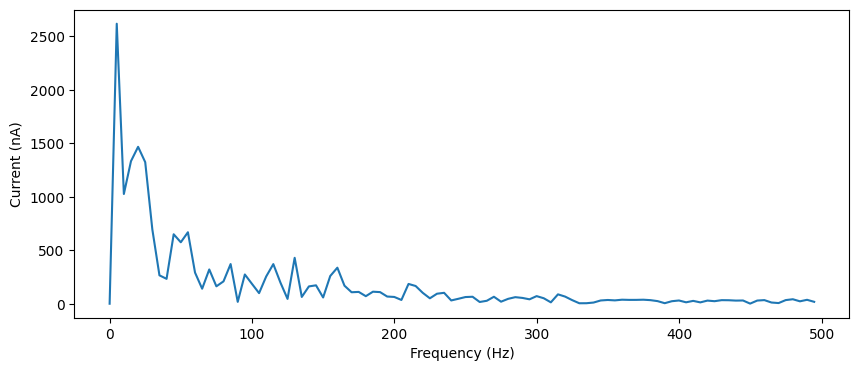

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2618.94974404 2618.94974404]


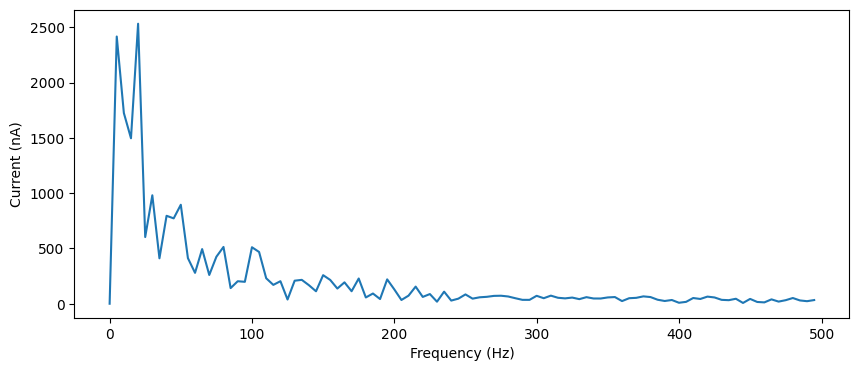

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.005000000000000001, peak_freqs=[ 19.990005 -19.990005], peak_freqs_amp=[2532.28378163 2532.28378163]


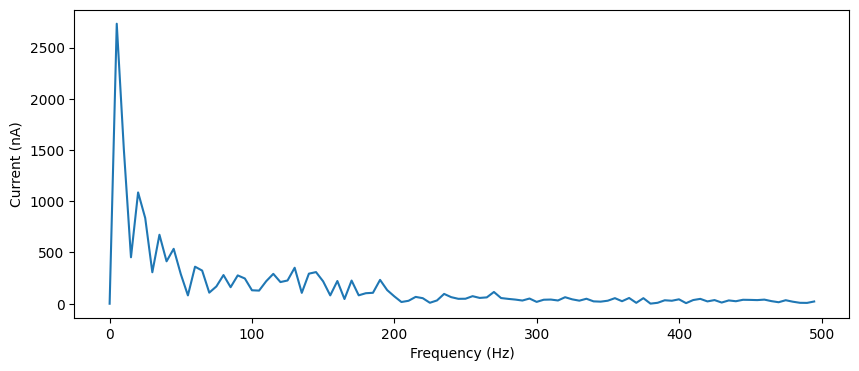

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.0055, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2732.84598395 2732.84598395]


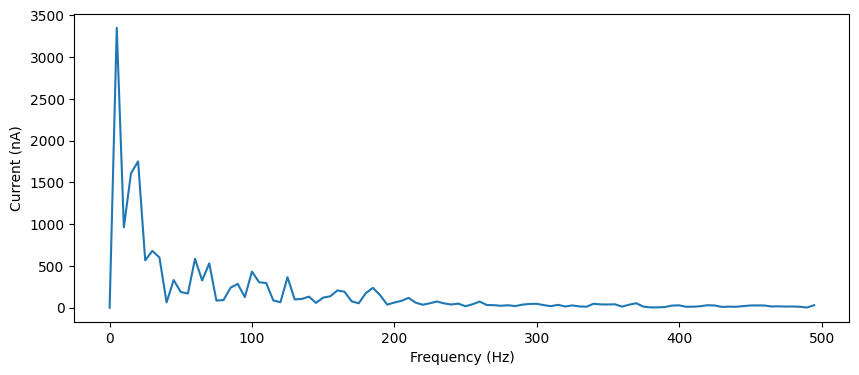

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.006, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3351.0168764 3351.0168764]


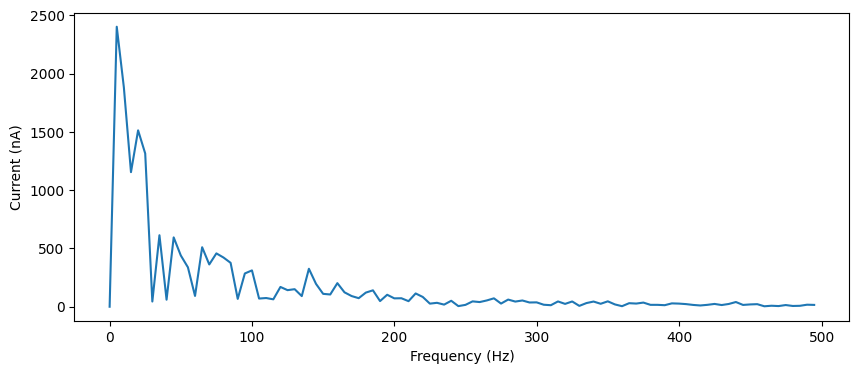

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2401.87250327 2401.87250327]


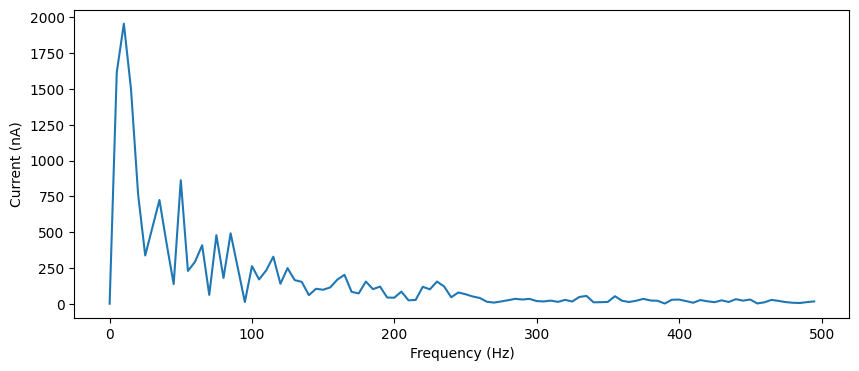

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.007000000000000001, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1956.4701289 1956.4701289]


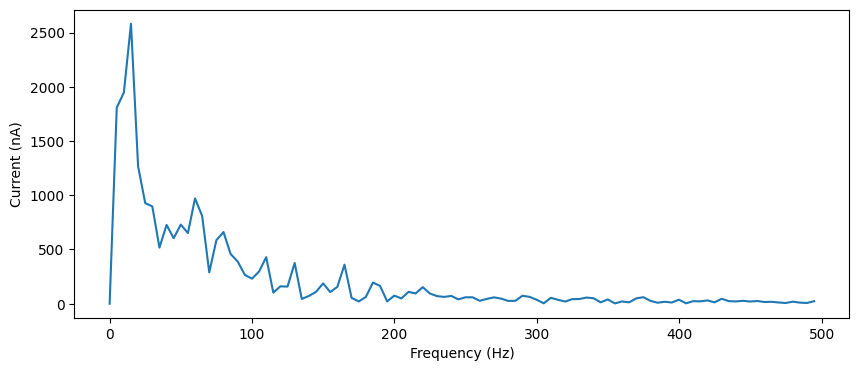

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.0075, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[2581.20362701 2581.20362701]


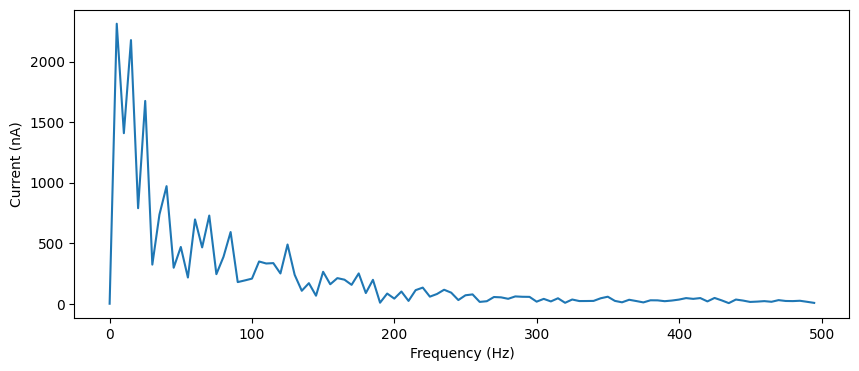

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2313.31629858 2313.31629858]


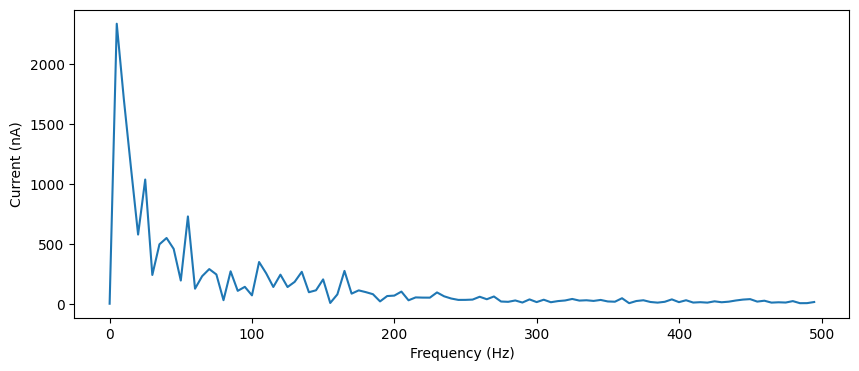

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2337.30734468 2337.30734468]


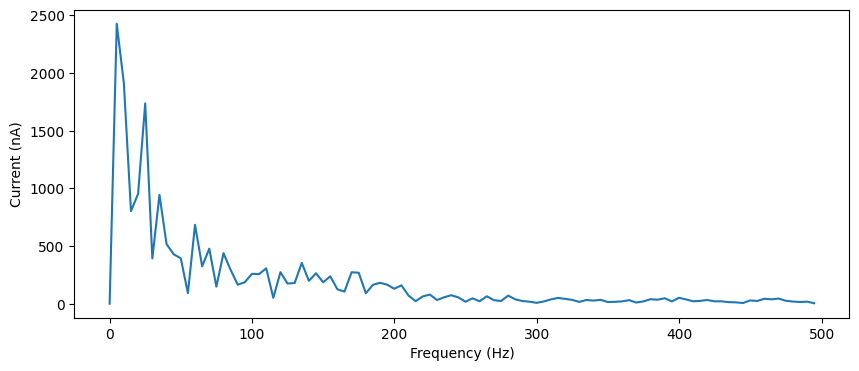

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2428.1152575 2428.1152575]


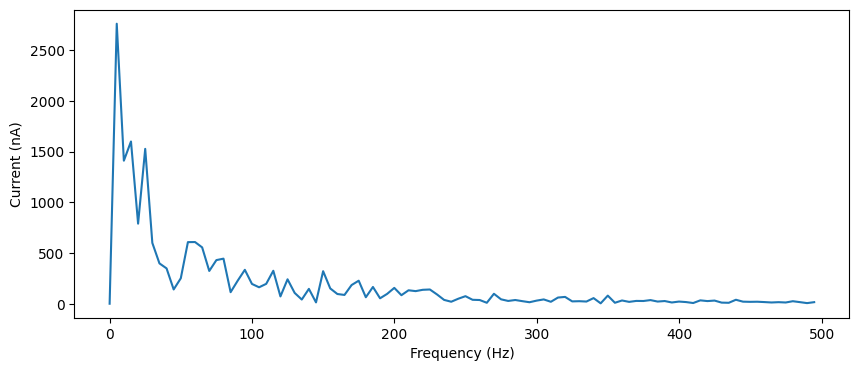

prob12=0.05, prob21=0.05, weight12=0.0075, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2761.04747097 2761.04747097]


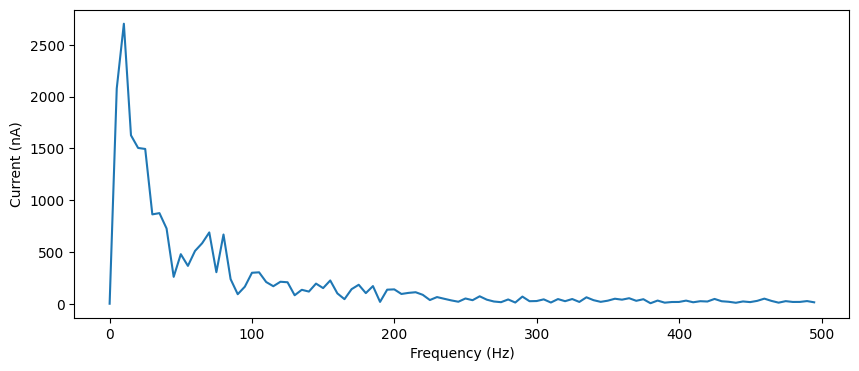

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.0005, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2703.65207094 2703.65207094]


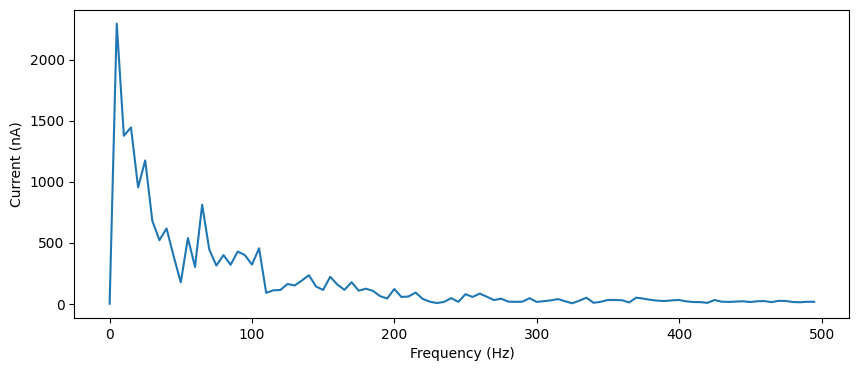

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2293.41233559 2293.41233559]


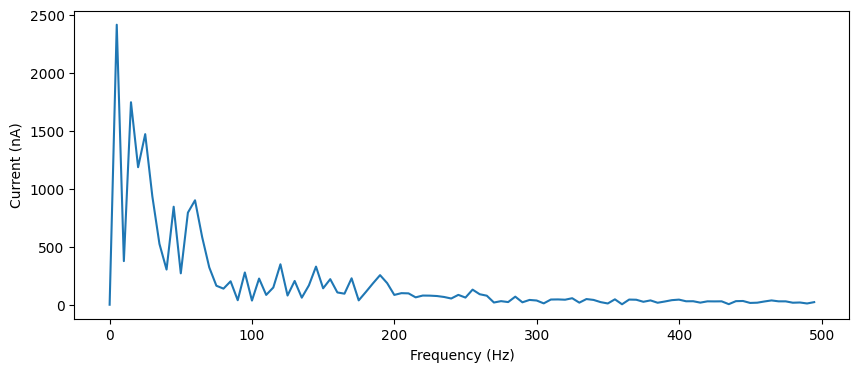

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2413.6525615 2413.6525615]


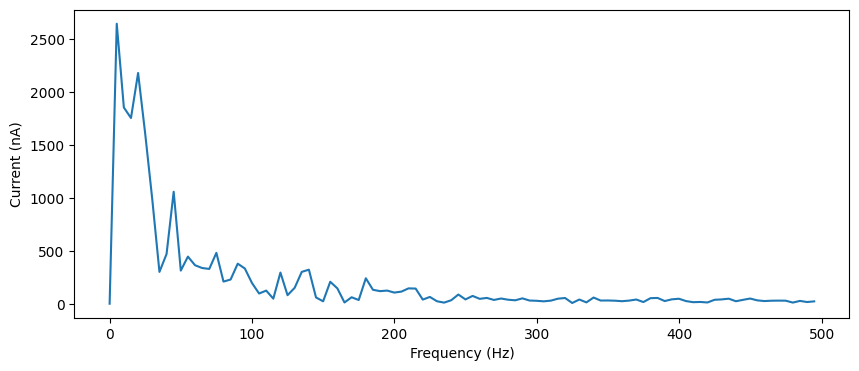

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.002, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2646.84559124 2646.84559124]


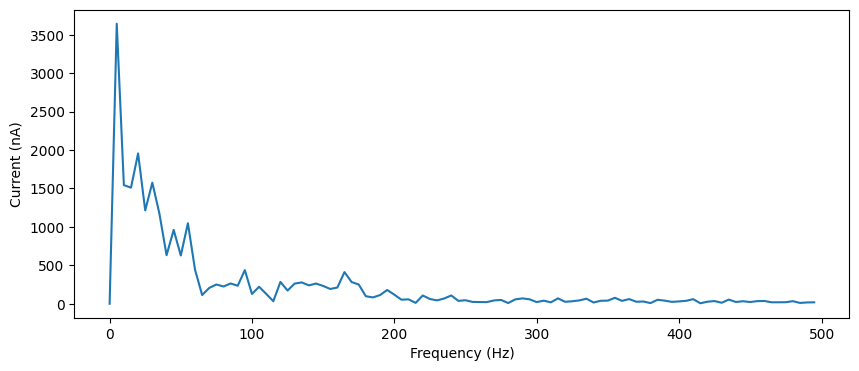

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.0025, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3643.27619051 3643.27619051]


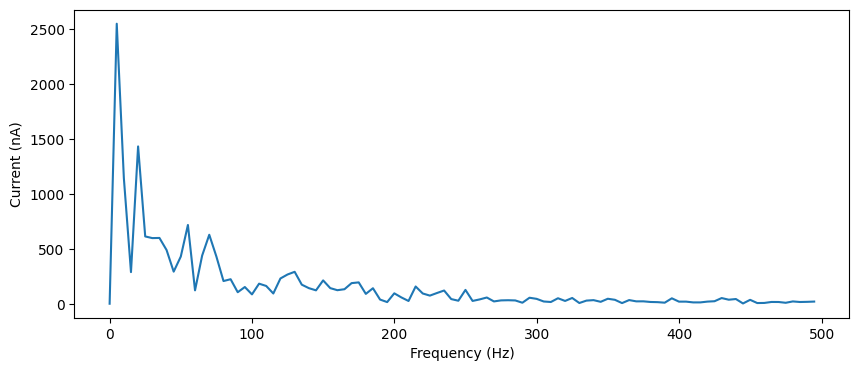

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2551.86099781 2551.86099781]


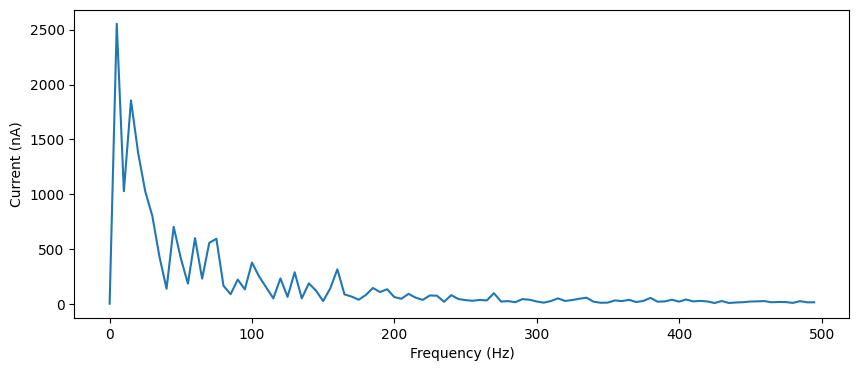

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2554.68621173 2554.68621173]


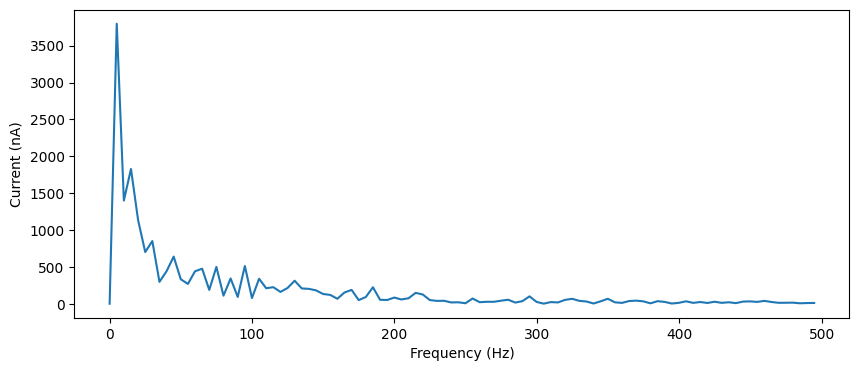

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3798.05554797 3798.05554797]


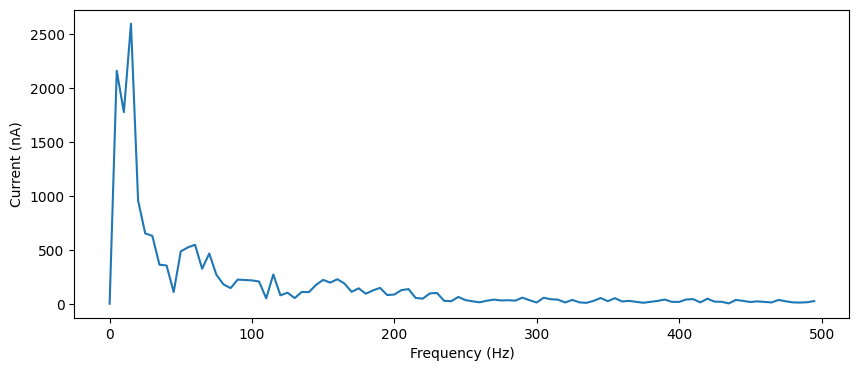

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.0045000000000000005, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[2598.75315298 2598.75315298]


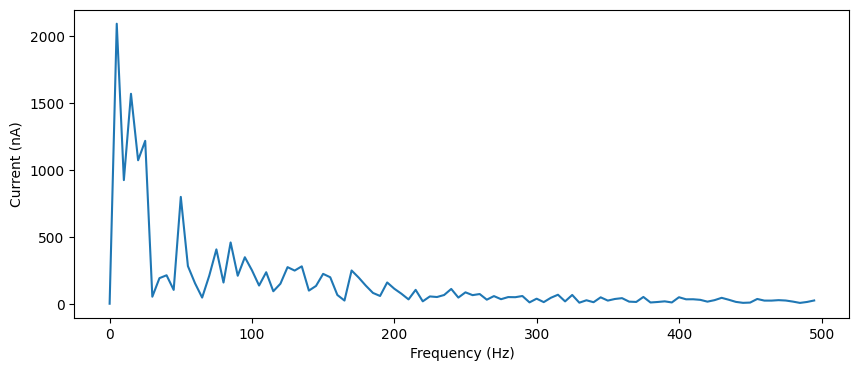

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2092.25388901 2092.25388901]


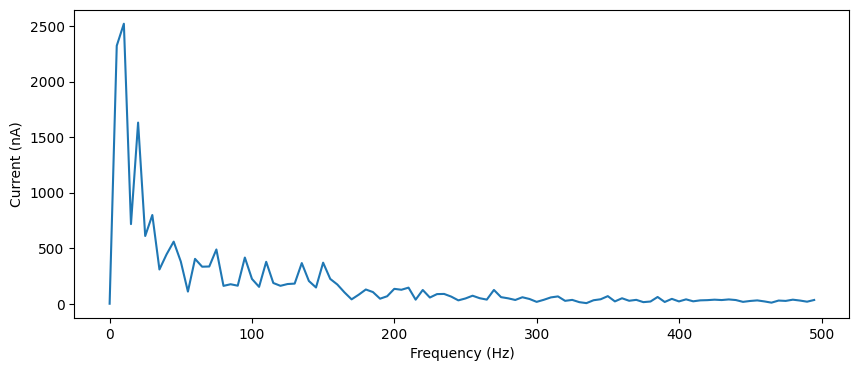

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.0055, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2521.18148469 2521.18148469]


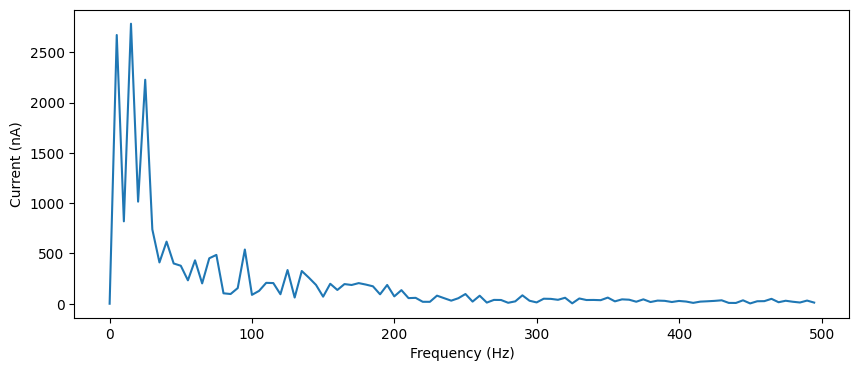

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.006, peak_freqs=[ 14.99250375 -14.99250375], peak_freqs_amp=[2783.00874775 2783.00874775]


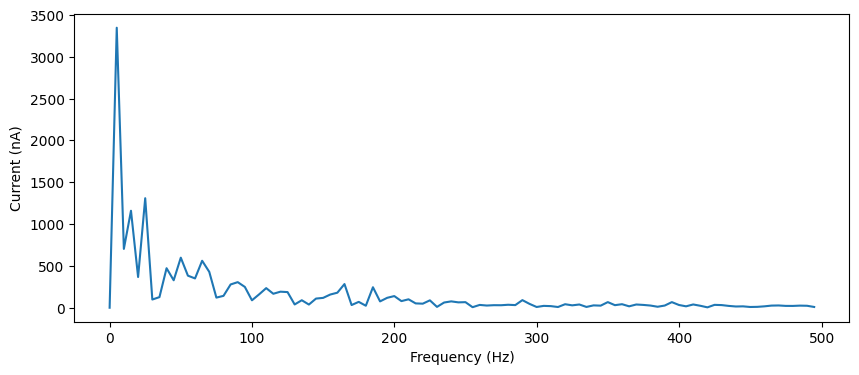

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3347.98982002 3347.98982002]


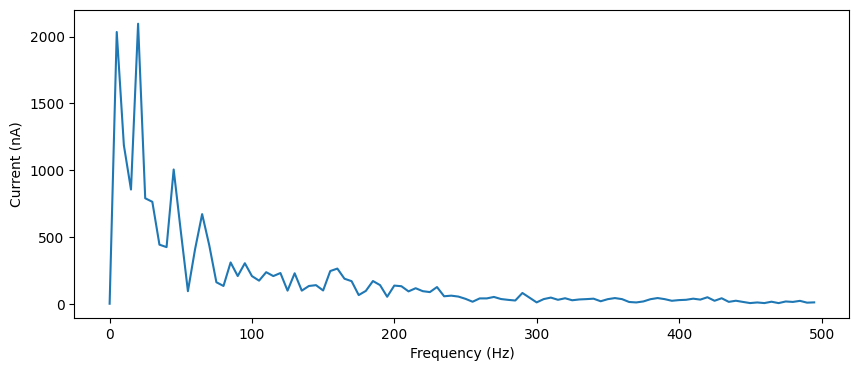

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.007000000000000001, peak_freqs=[ 19.990005 -19.990005], peak_freqs_amp=[2096.90161847 2096.90161847]


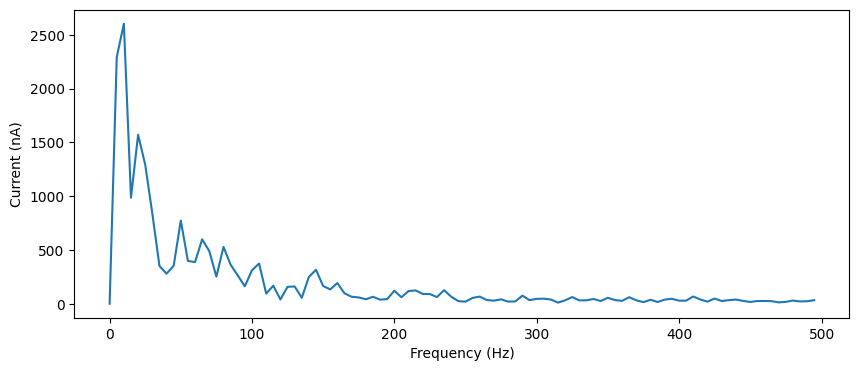

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.0075, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2604.24331691 2604.24331691]


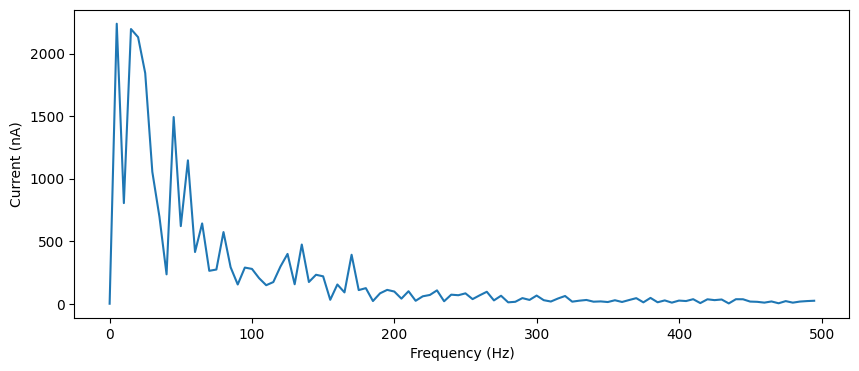

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2238.46241774 2238.46241774]


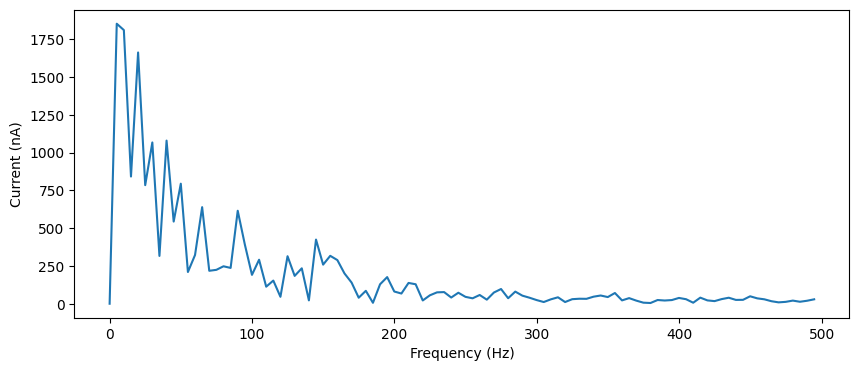

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1852.26916419 1852.26916419]


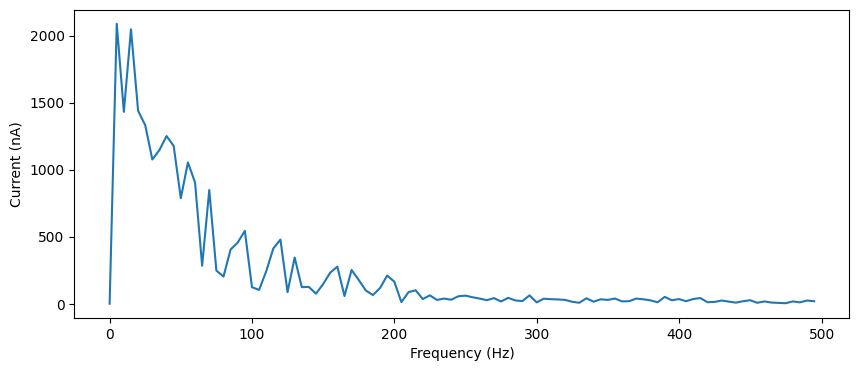

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2089.2554603 2089.2554603]


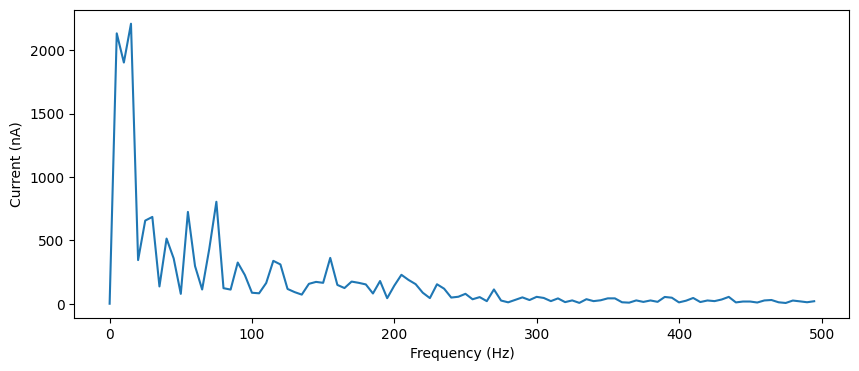

prob12=0.05, prob21=0.05, weight12=0.008, weight21=0.009500000000000001, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[2210.1539887 2210.1539887]


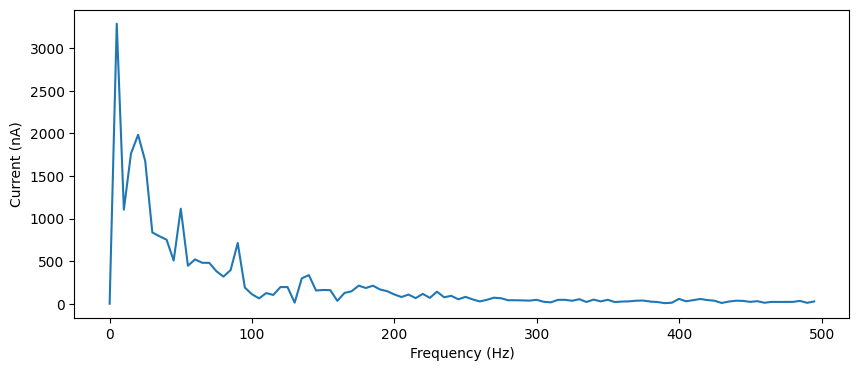

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.0005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3288.45849524 3288.45849524]


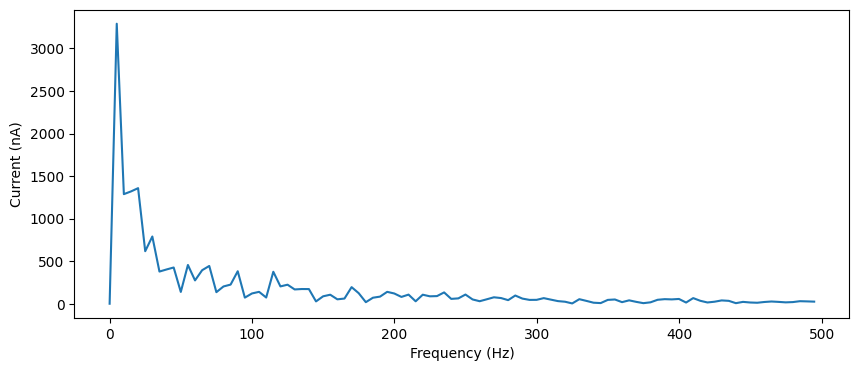

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3290.1869724 3290.1869724]


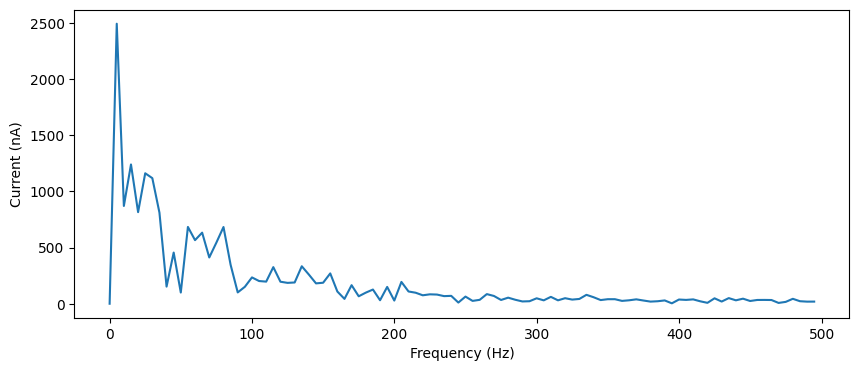

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2493.05521564 2493.05521564]


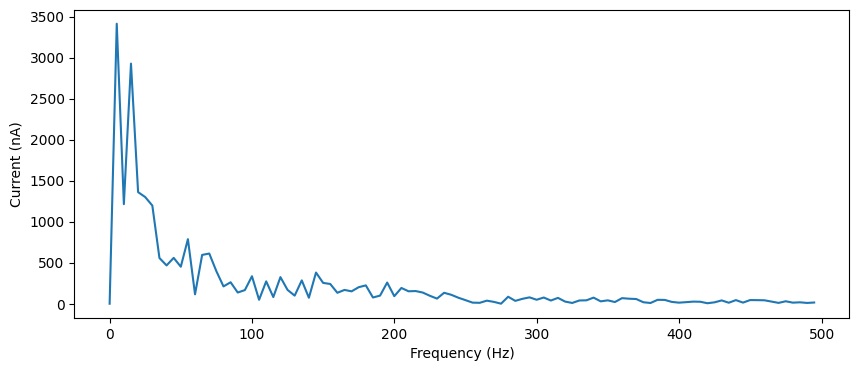

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.002, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3413.2591492 3413.2591492]


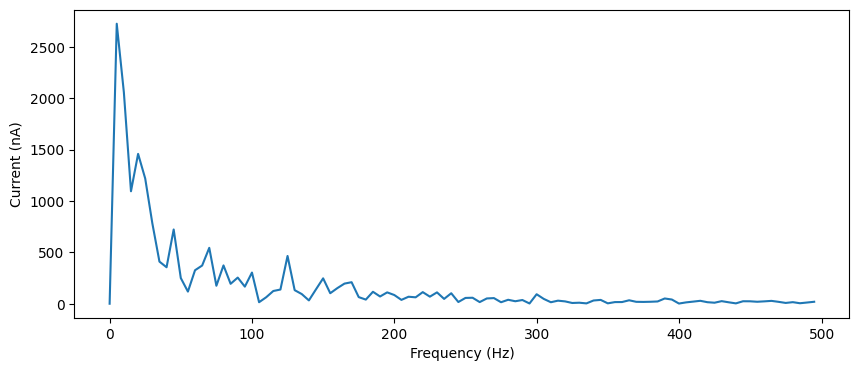

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.0025, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2726.72914444 2726.72914444]


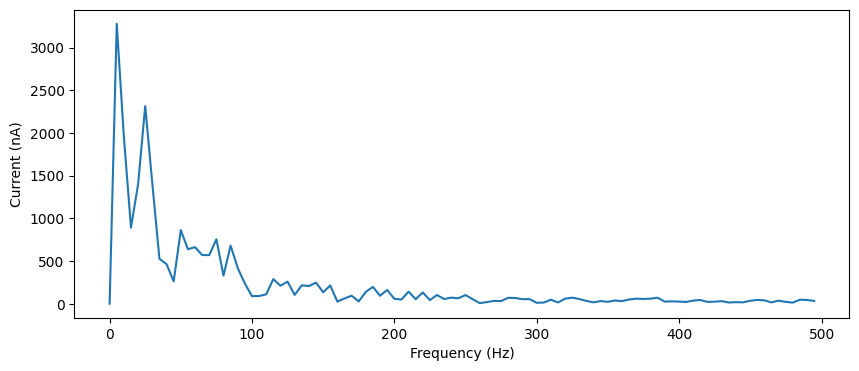

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3279.46983433 3279.46983433]


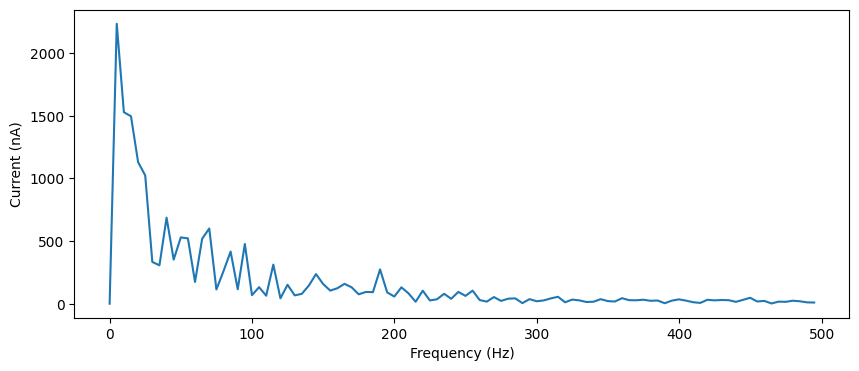

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2234.46920105 2234.46920105]


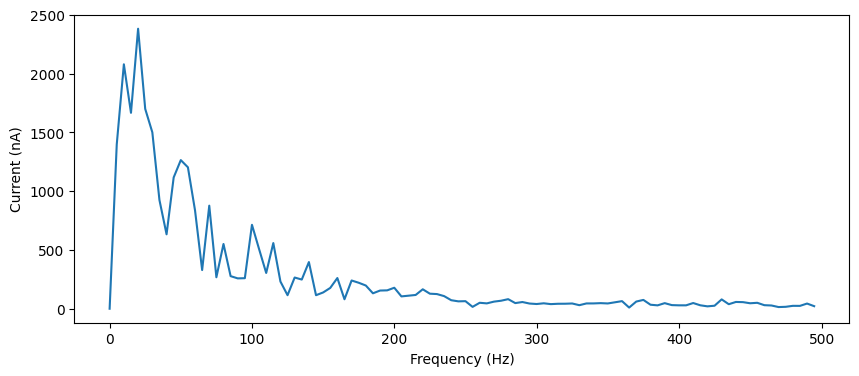

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.004, peak_freqs=[-19.990005  19.990005], peak_freqs_amp=[2382.43446686 2382.43446686]


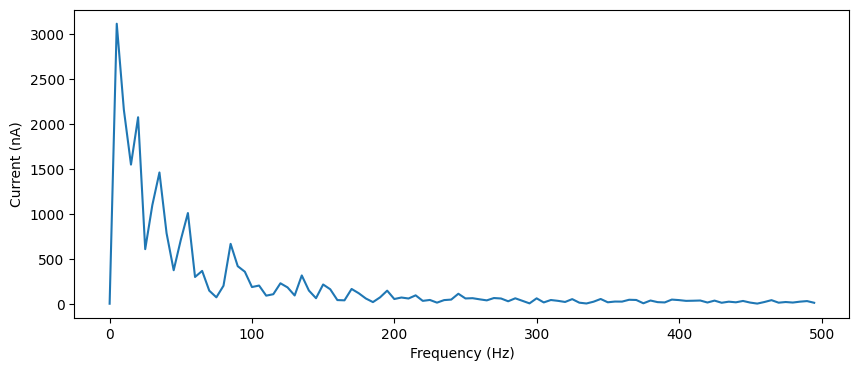

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3118.3099819 3118.3099819]


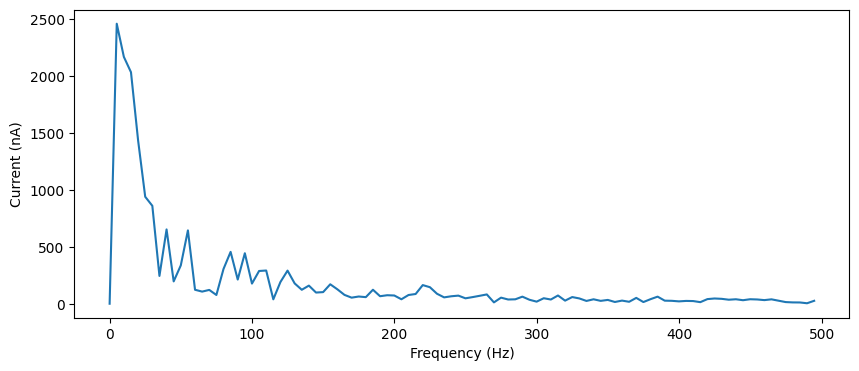

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2460.68352911 2460.68352911]


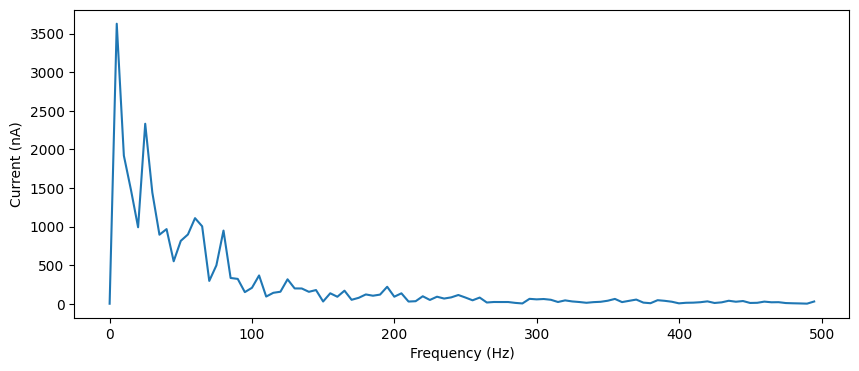

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.0055, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3628.18685689 3628.18685689]


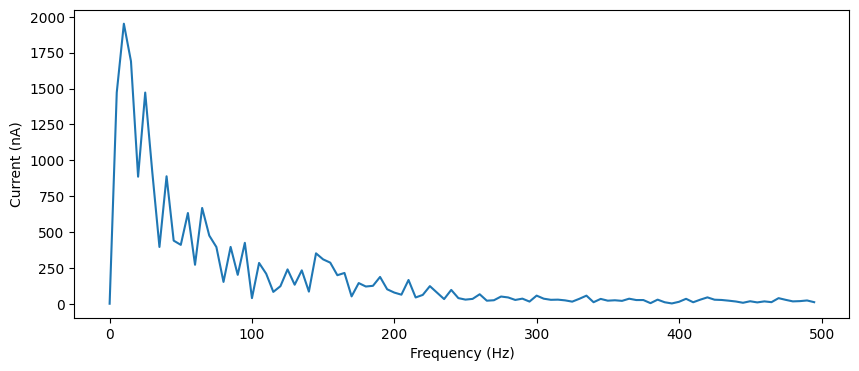

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.006, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1952.07928106 1952.07928106]


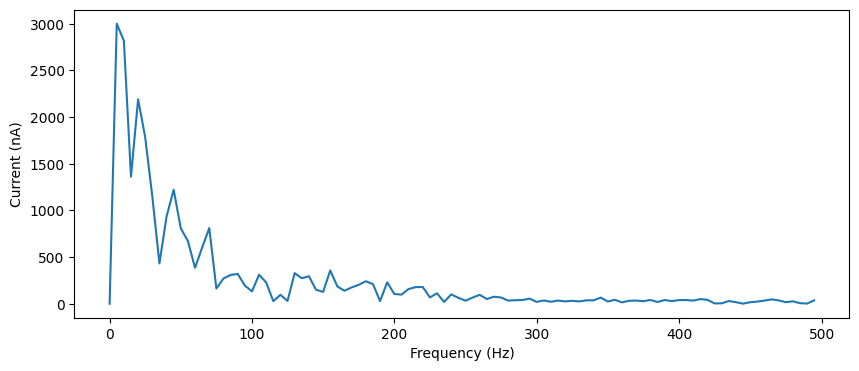

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3000.63336395 3000.63336395]


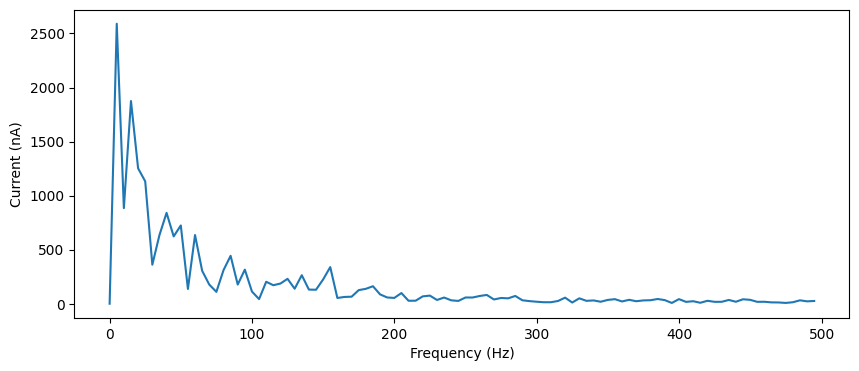

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2590.22533838 2590.22533838]


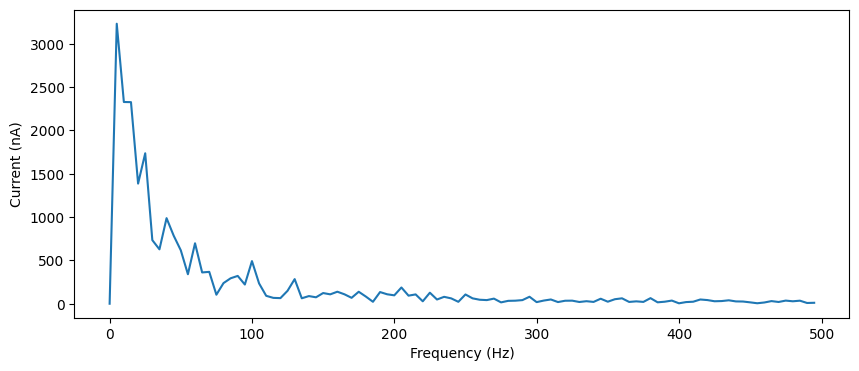

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.0075, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3231.77151926 3231.77151926]


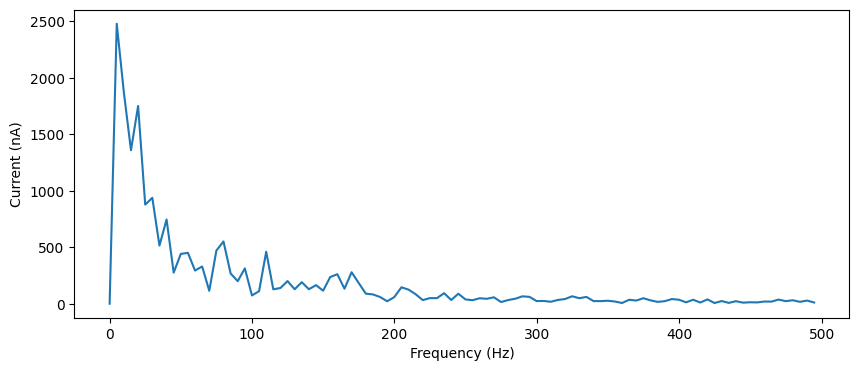

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2478.22303674 2478.22303674]


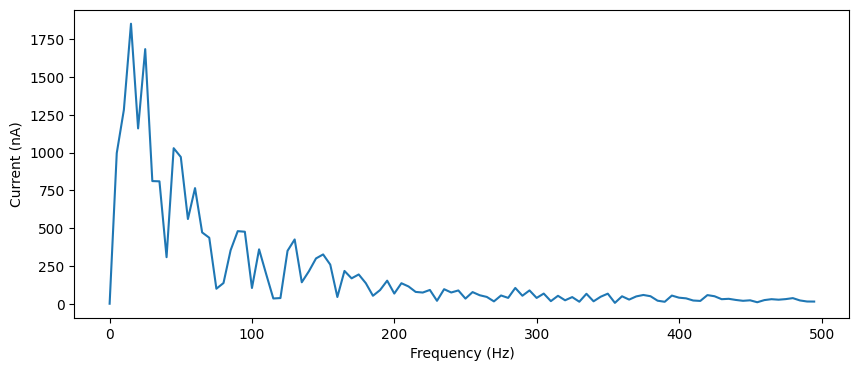

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.0085, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[1853.86785327 1853.86785327]


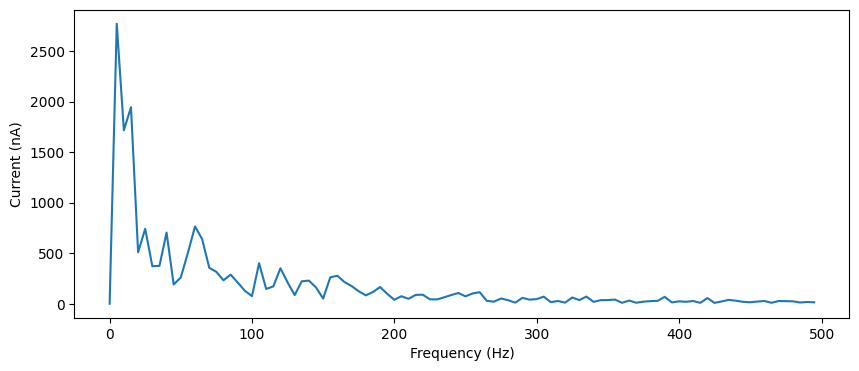

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2771.33572313 2771.33572313]


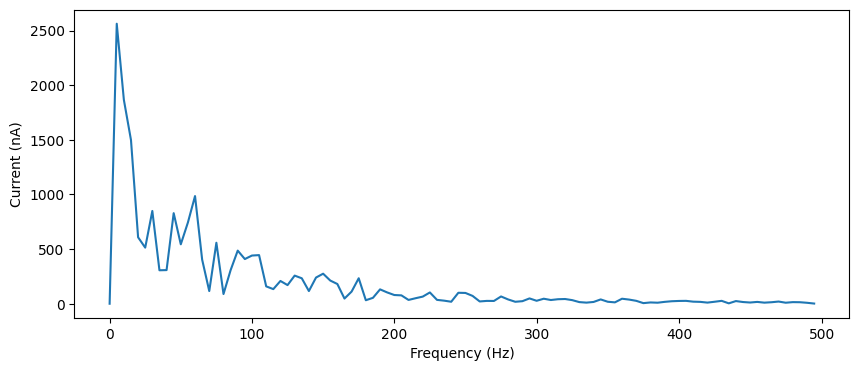

prob12=0.05, prob21=0.05, weight12=0.0085, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2562.33923982 2562.33923982]


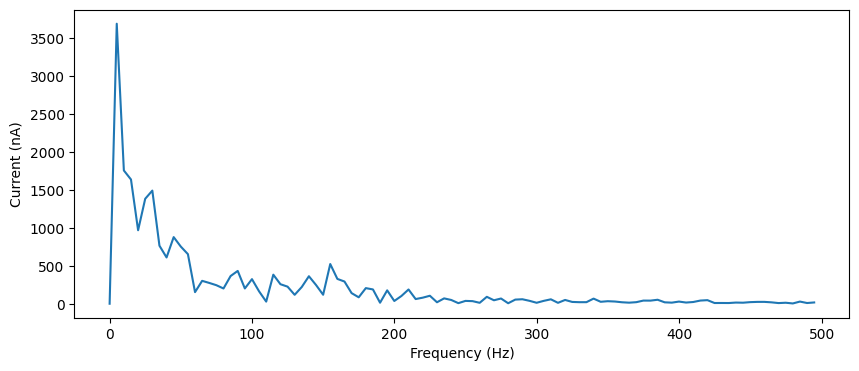

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.0005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3694.14852092 3694.14852092]


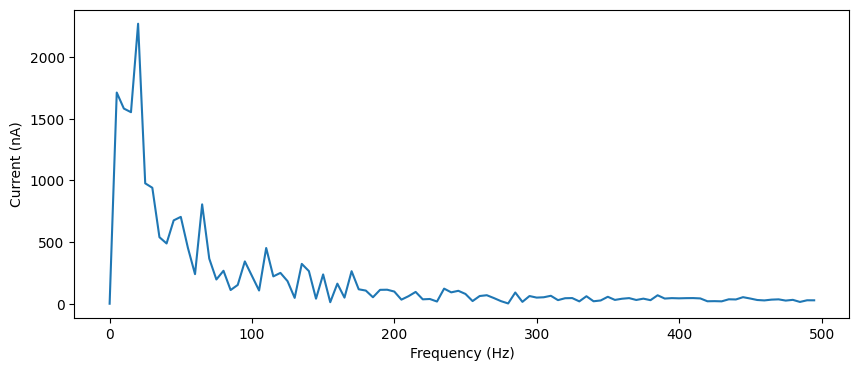

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.001, peak_freqs=[ 19.990005 -19.990005], peak_freqs_amp=[2271.97879745 2271.97879745]


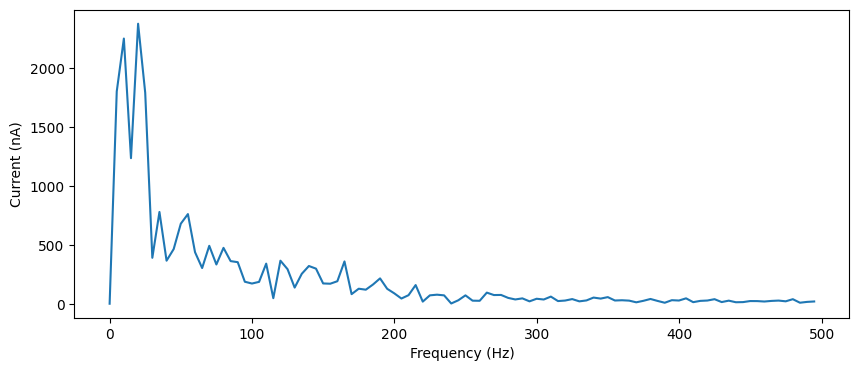

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.0015, peak_freqs=[ 19.990005 -19.990005], peak_freqs_amp=[2373.43599448 2373.43599448]


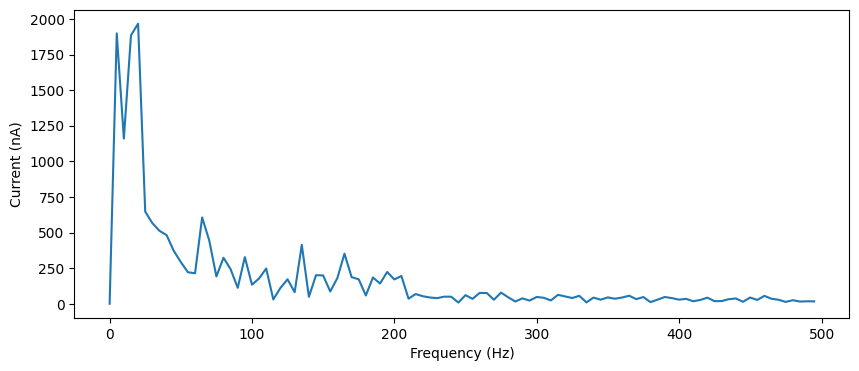

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.002, peak_freqs=[ 19.990005 -19.990005], peak_freqs_amp=[1966.26585076 1966.26585076]


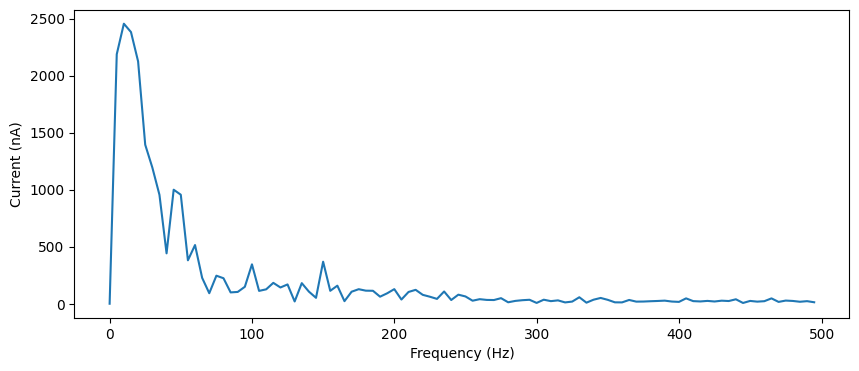

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.0025, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[2454.30954995 2454.30954995]


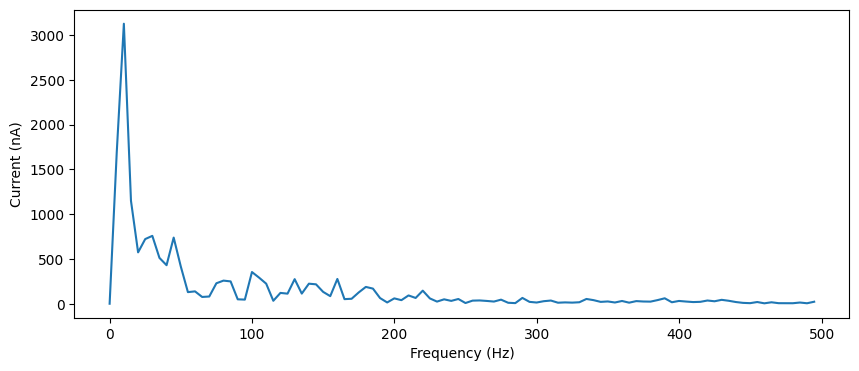

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.003, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[3126.7652883 3126.7652883]


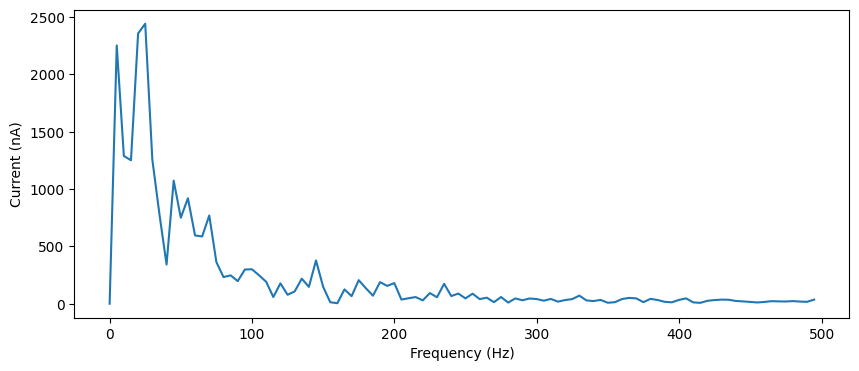

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.0035, peak_freqs=[-24.98750625  24.98750625], peak_freqs_amp=[2442.91623574 2442.91623574]


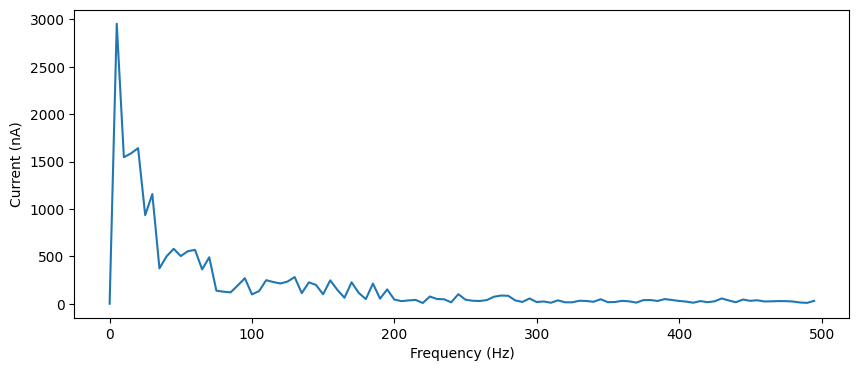

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2954.55814885 2954.55814885]


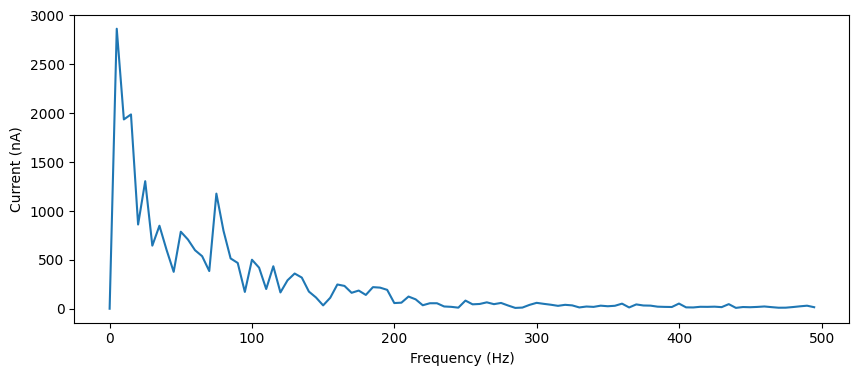

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2864.35727201 2864.35727201]


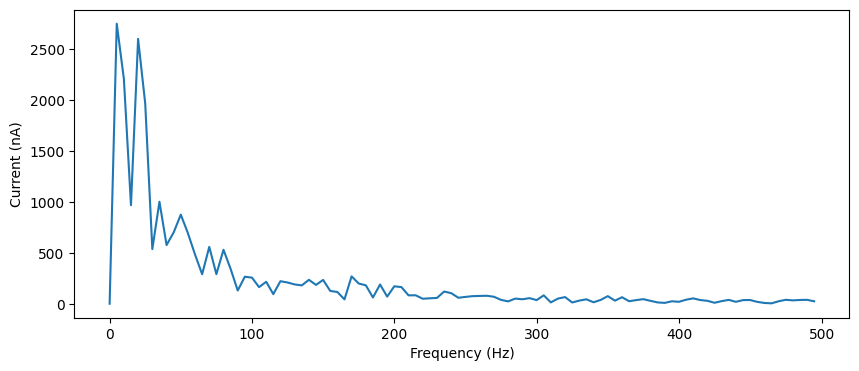

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2746.07594648 2746.07594648]


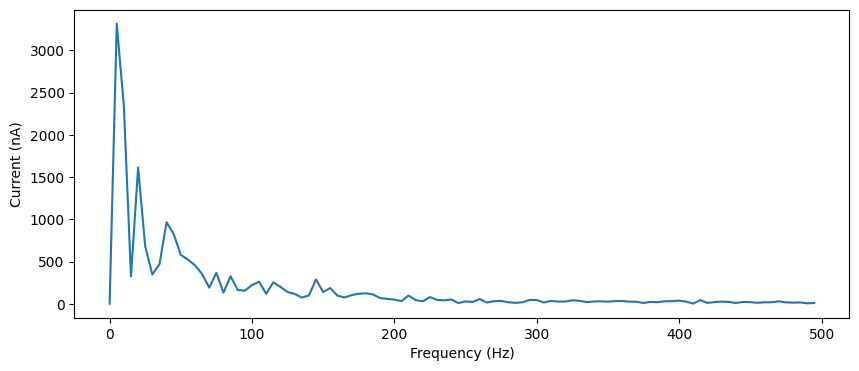

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.0055, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3315.8624293 3315.8624293]


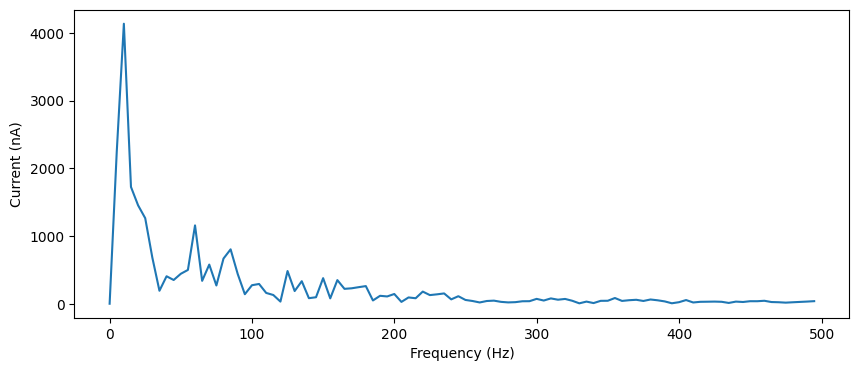

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.006, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[4136.93277266 4136.93277266]


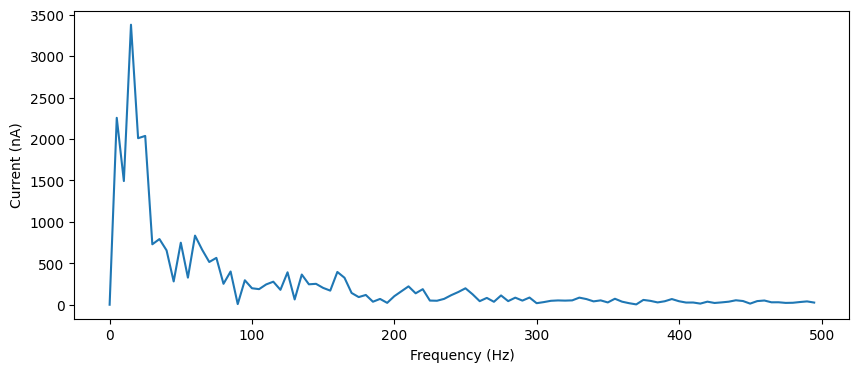

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.006500000000000001, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[3378.8132219 3378.8132219]


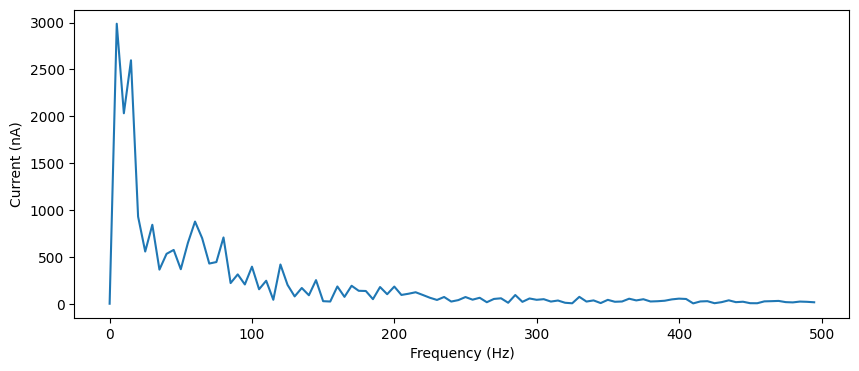

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2988.56539493 2988.56539493]


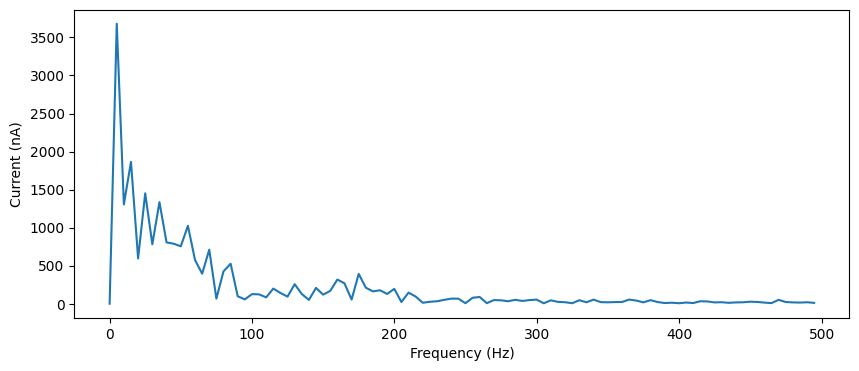

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.0075, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3680.43753502 3680.43753502]


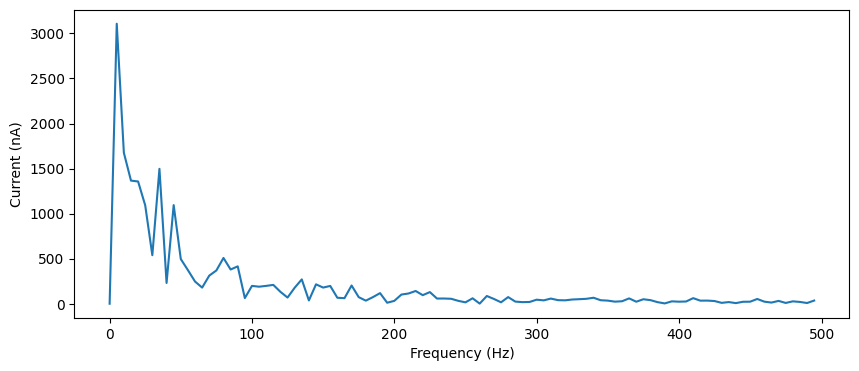

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3107.59116827 3107.59116827]


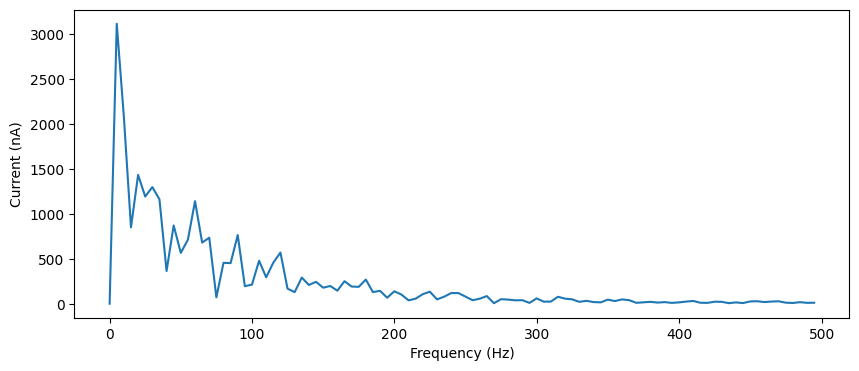

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3115.50897291 3115.50897291]


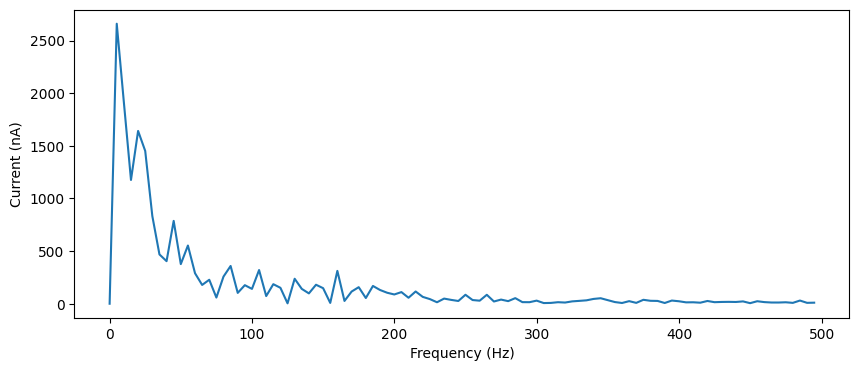

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2659.7931821 2659.7931821]


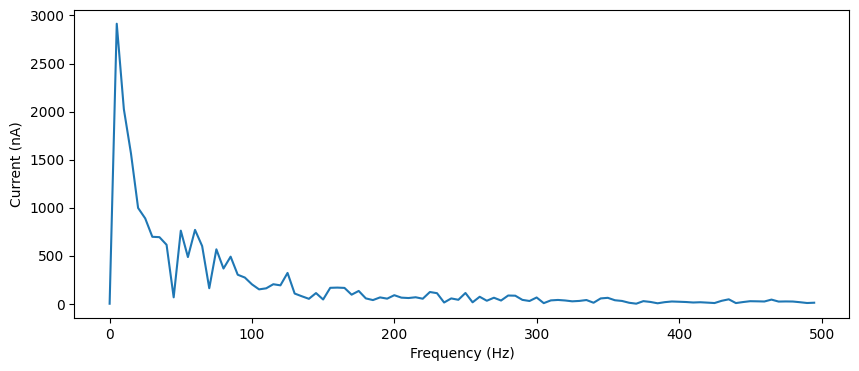

prob12=0.05, prob21=0.05, weight12=0.009000000000000001, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2914.0666436 2914.0666436]


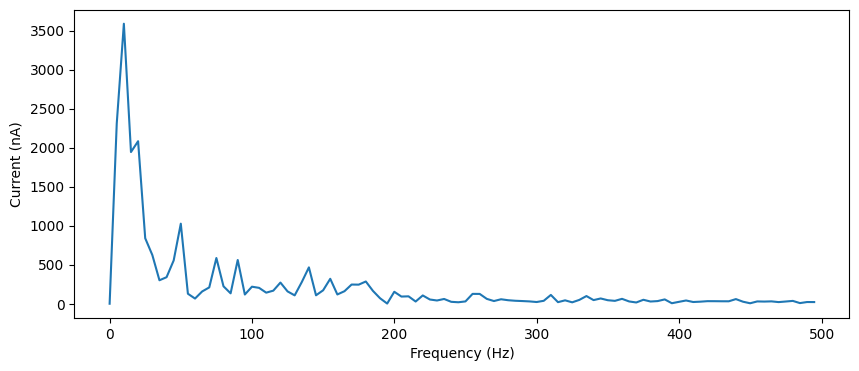

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.0005, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[3587.83313317 3587.83313317]


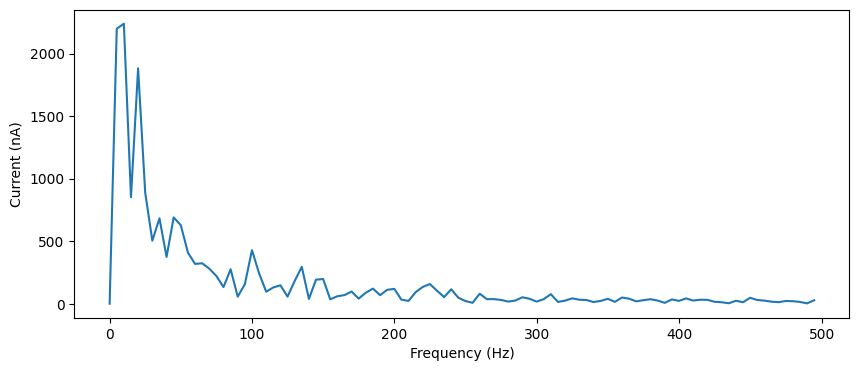

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.001, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2238.9480885 2238.9480885]


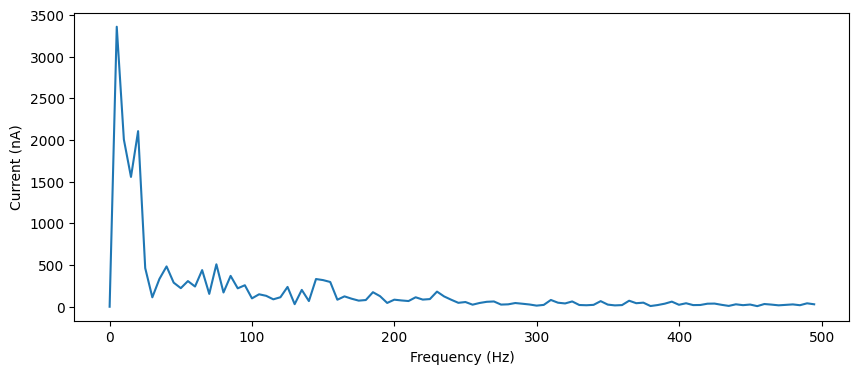

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3358.71252272 3358.71252272]


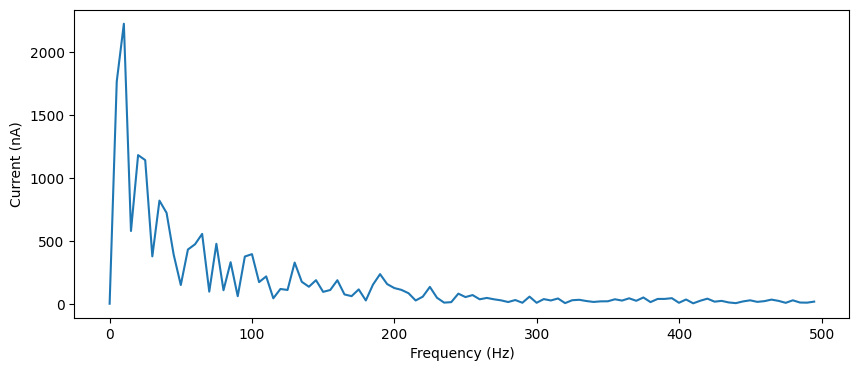

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.002, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2229.0727553 2229.0727553]


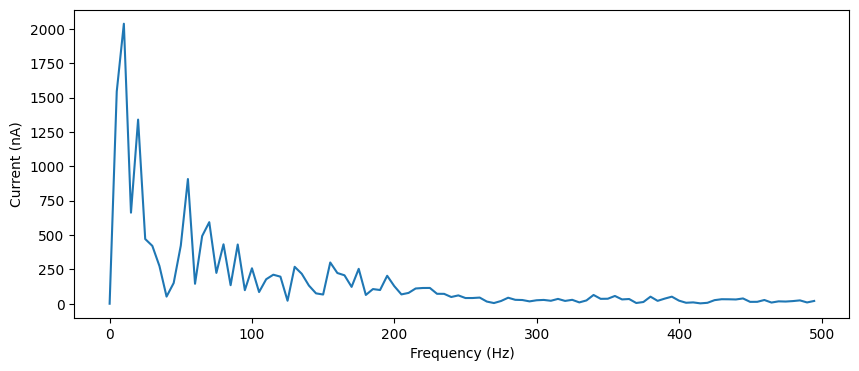

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.0025, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2036.69046749 2036.69046749]


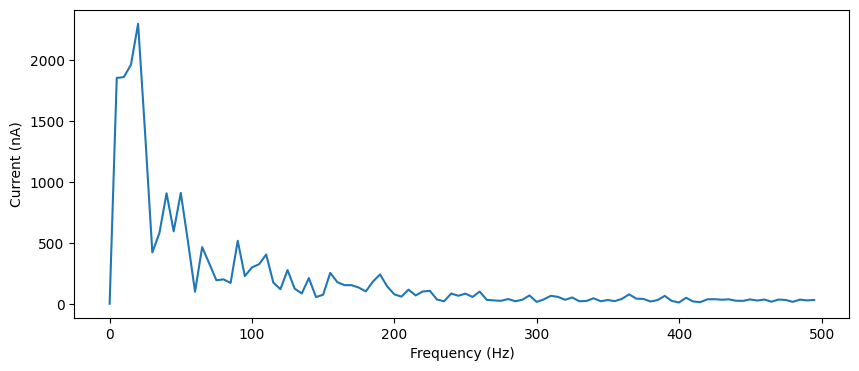

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.003, peak_freqs=[-19.990005  19.990005], peak_freqs_amp=[2301.03242502 2301.03242502]


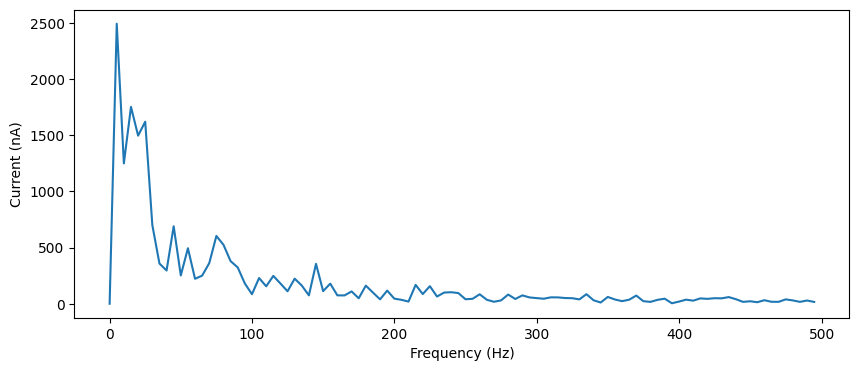

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2491.83989585 2491.83989585]


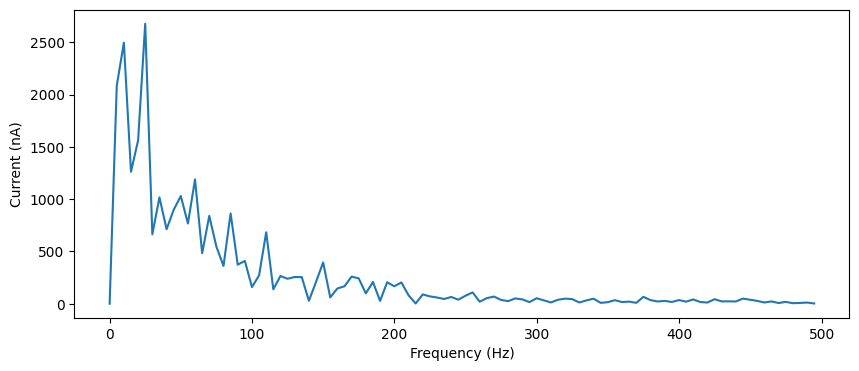

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.004, peak_freqs=[ 24.98750625 -24.98750625], peak_freqs_amp=[2677.82919752 2677.82919752]


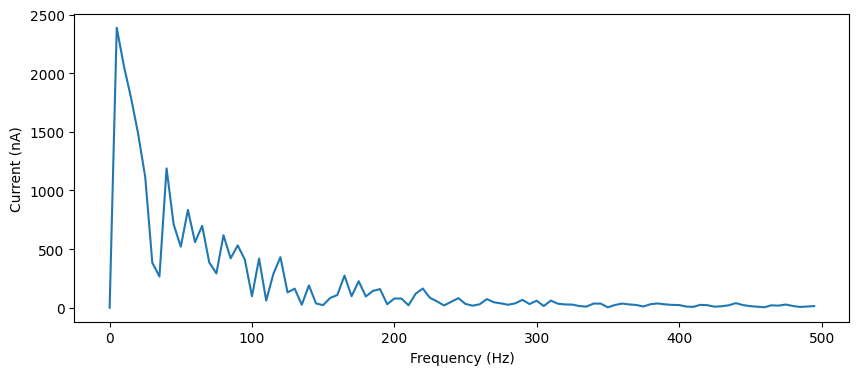

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2387.34230475 2387.34230475]


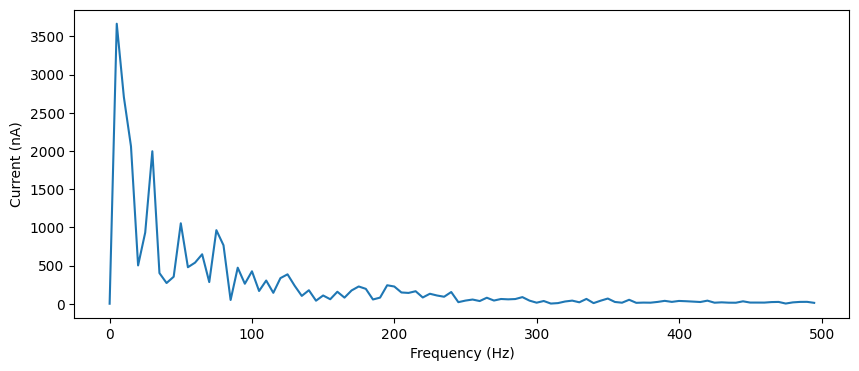

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3667.21430376 3667.21430376]


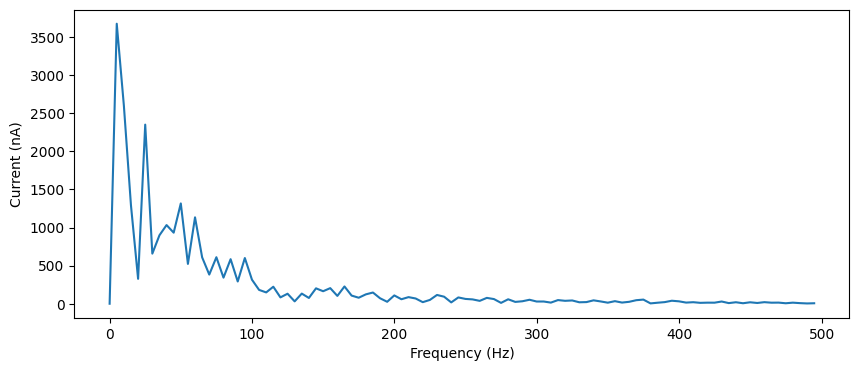

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.0055, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3675.69308986 3675.69308986]


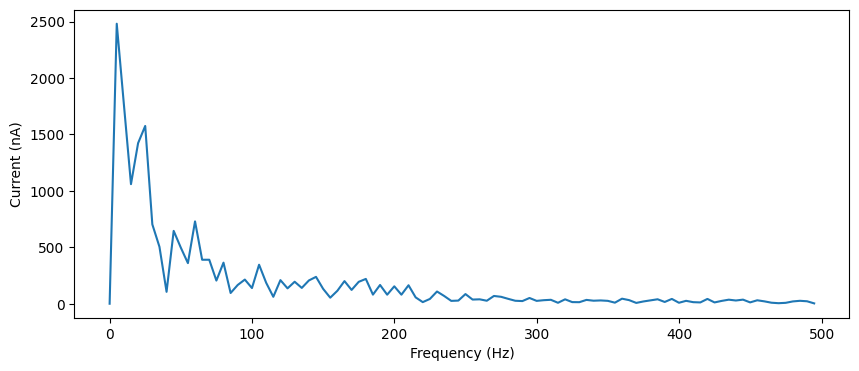

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.006, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2480.86988427 2480.86988427]


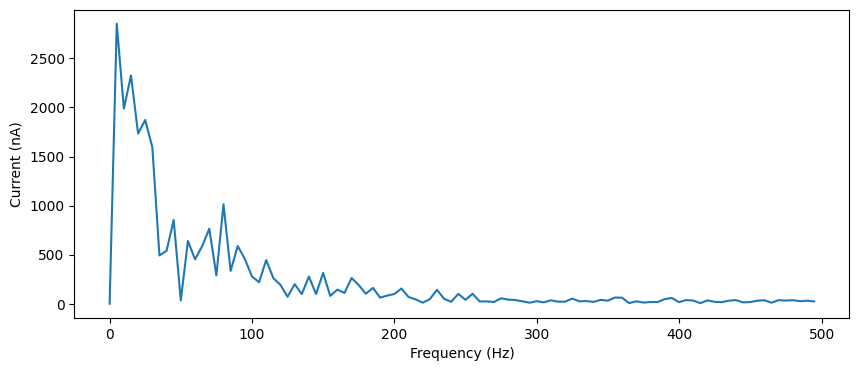

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2852.90096492 2852.90096492]


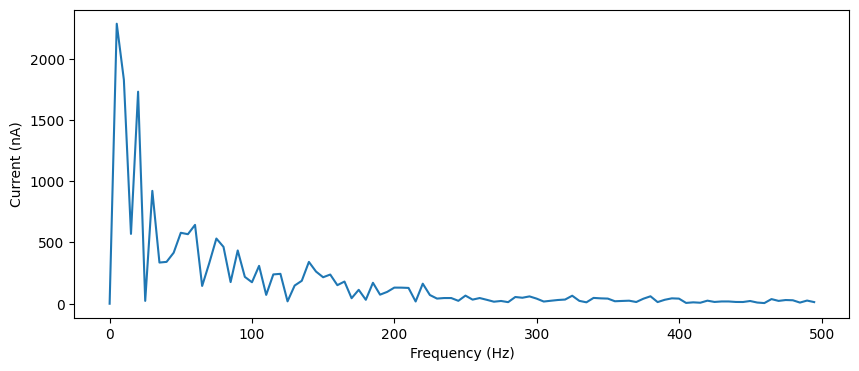

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2286.01424799 2286.01424799]


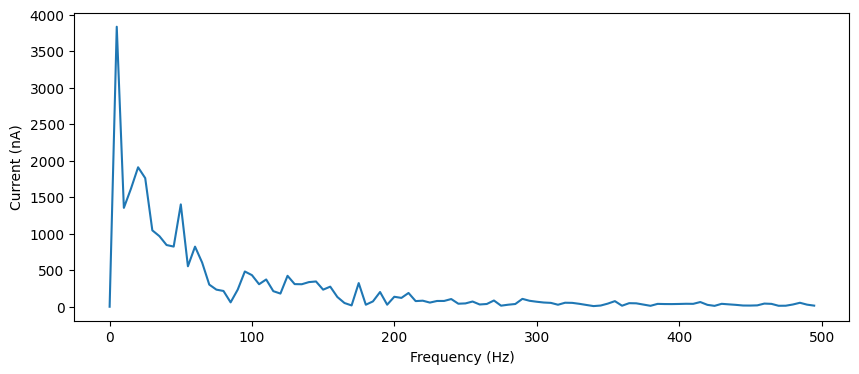

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.0075, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3836.24211809 3836.24211809]


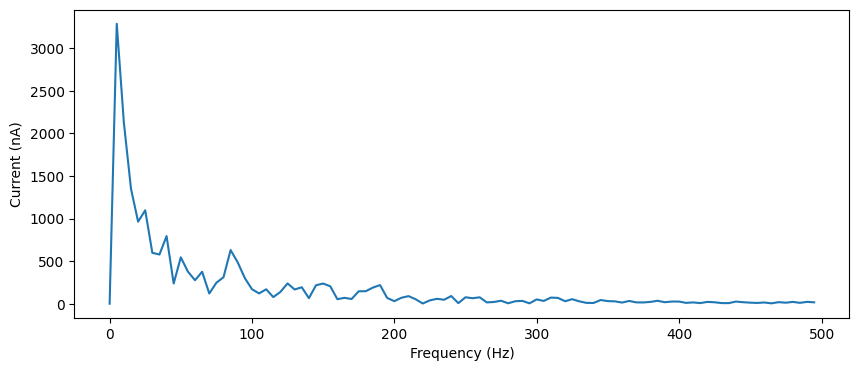

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3288.96631218 3288.96631218]


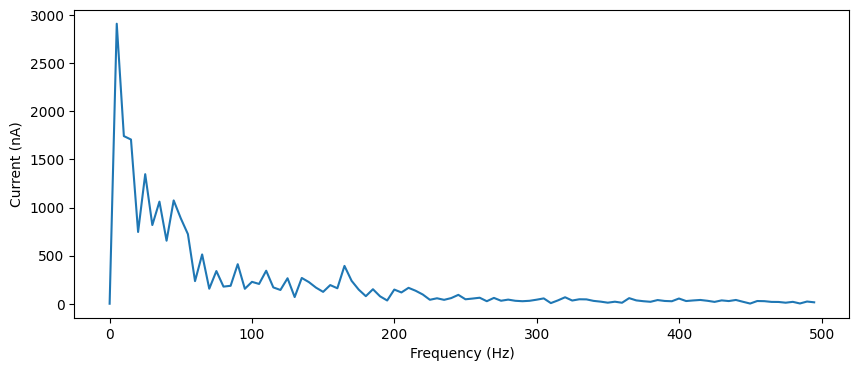

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2911.70951339 2911.70951339]


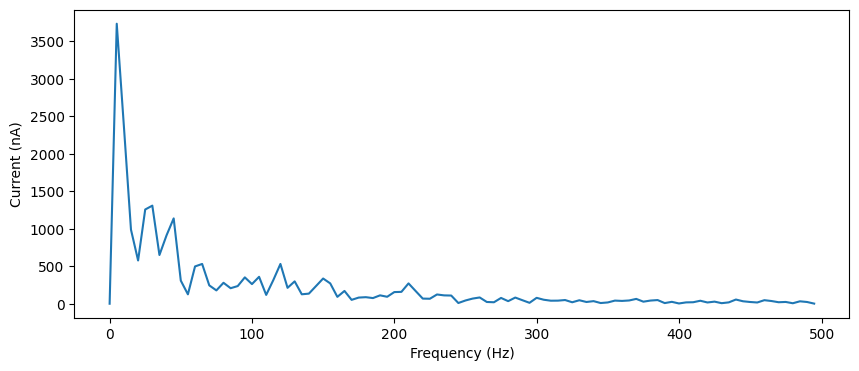

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[3735.97970686 3735.97970686]


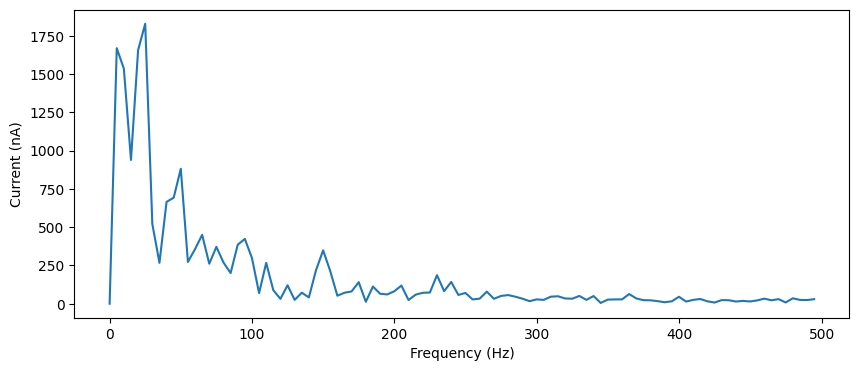

prob12=0.05, prob21=0.05, weight12=0.009500000000000001, weight21=0.009500000000000001, peak_freqs=[-24.98750625  24.98750625], peak_freqs_amp=[1829.20354242 1829.20354242]


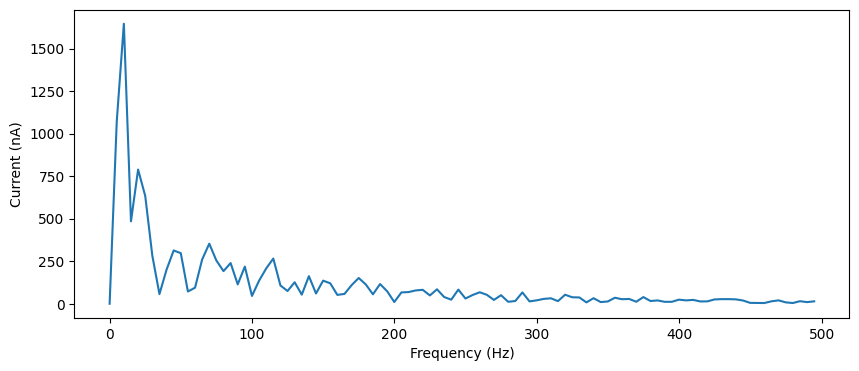

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.0005, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[1646.33404526 1646.33404526]


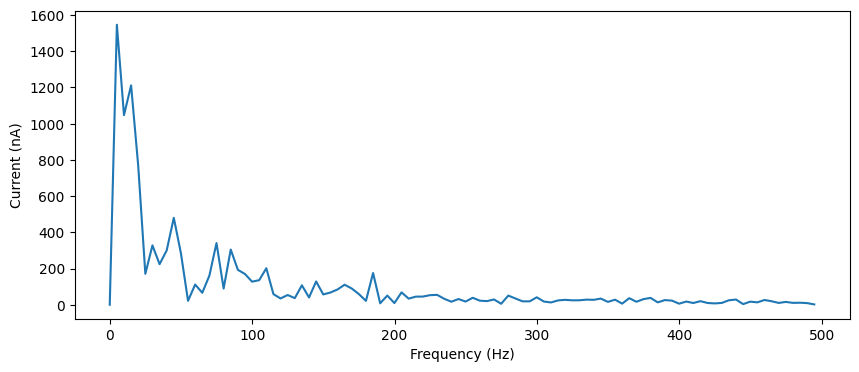

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1546.766247 1546.766247]


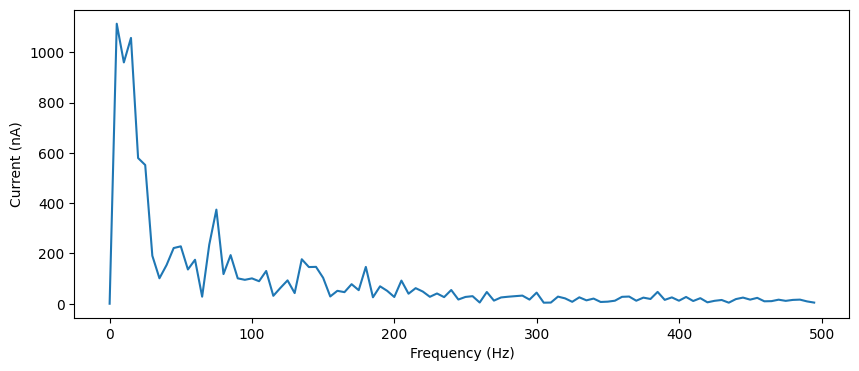

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1114.24909736 1114.24909736]


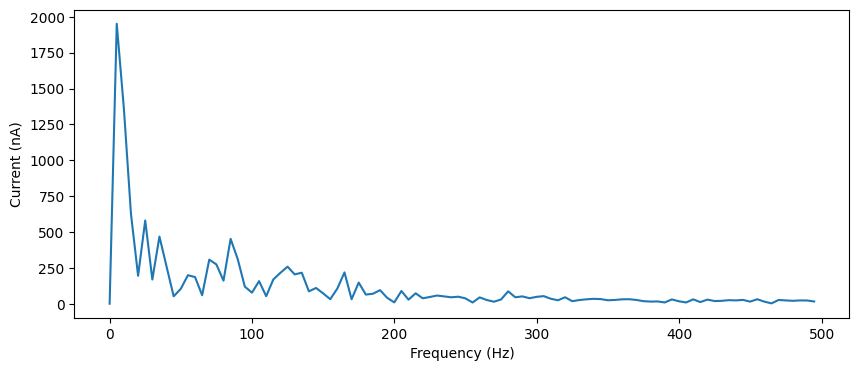

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.002, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1951.85706213 1951.85706213]


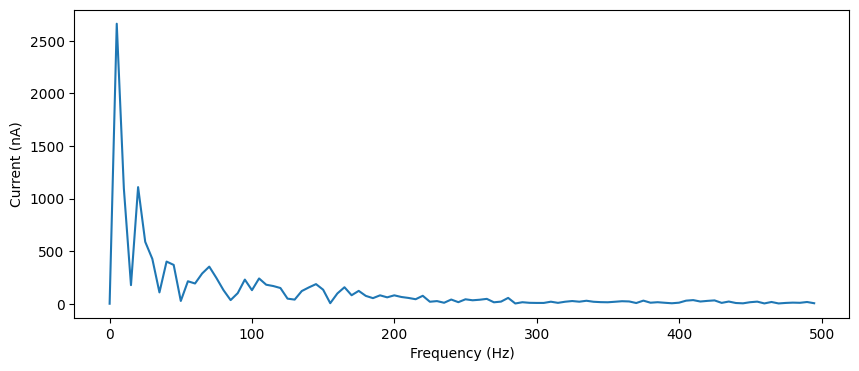

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.0025, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2662.46066922 2662.46066922]


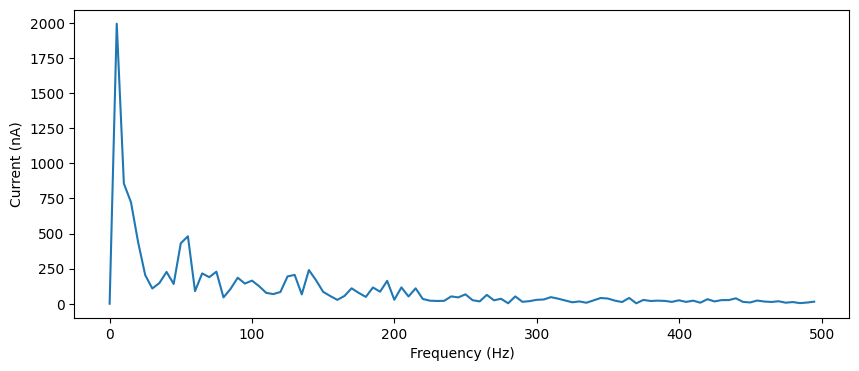

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1993.71672089 1993.71672089]


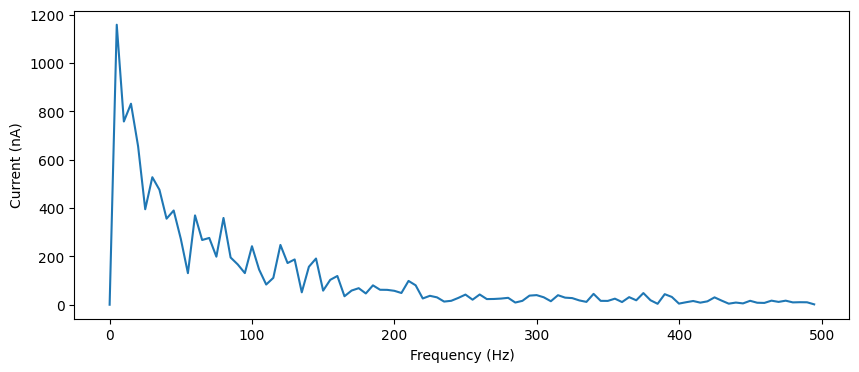

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1158.17831647 1158.17831647]


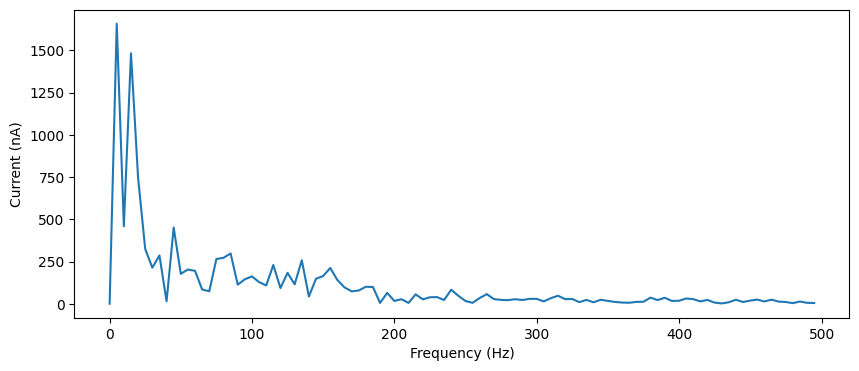

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1658.08613758 1658.08613758]


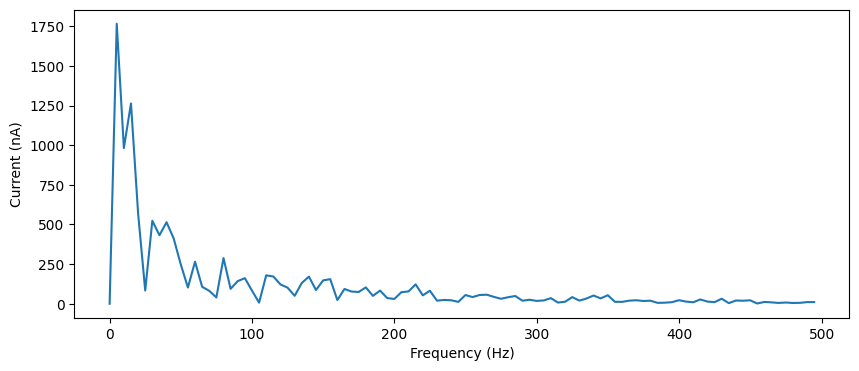

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1766.06880277 1766.06880277]


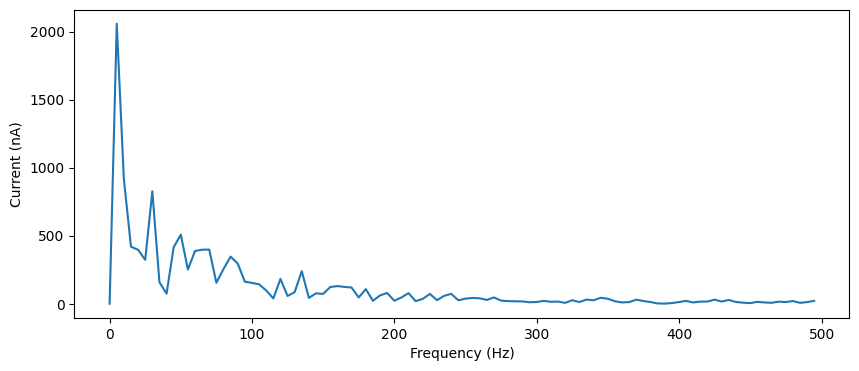

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2058.47943536 2058.47943536]


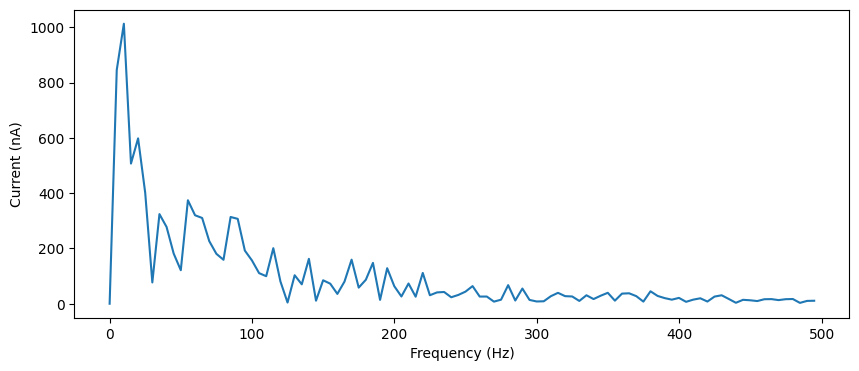

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.0055, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[1013.11105189 1013.11105189]


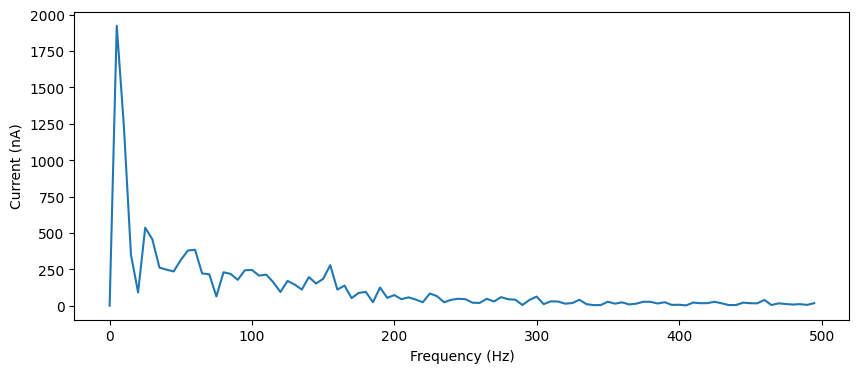

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.006, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1924.14262801 1924.14262801]


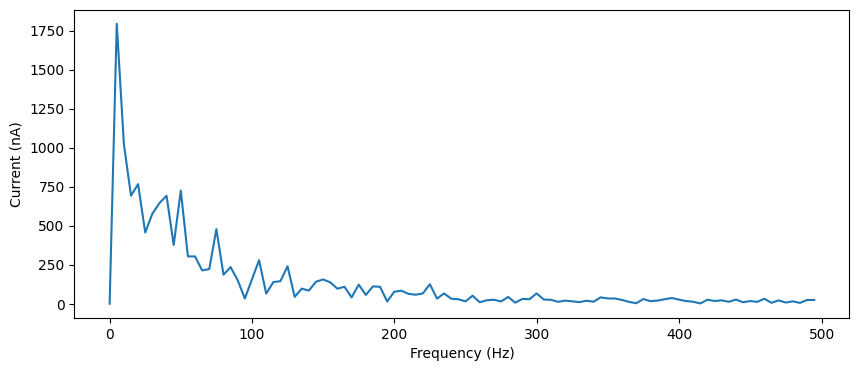

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1793.9466008 1793.9466008]


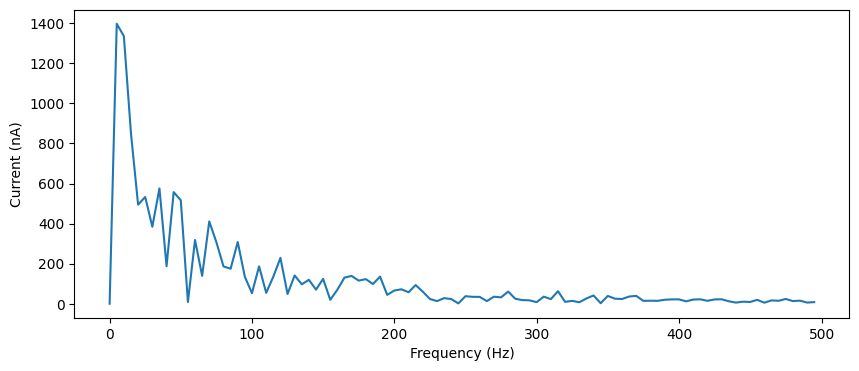

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1397.54539163 1397.54539163]


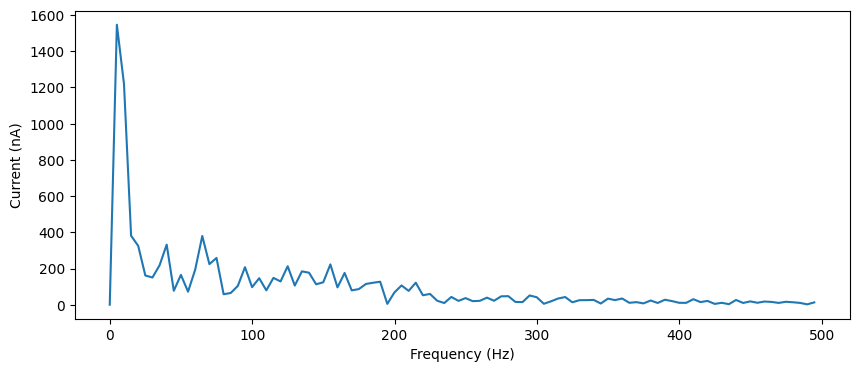

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.0075, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1546.46041691 1546.46041691]


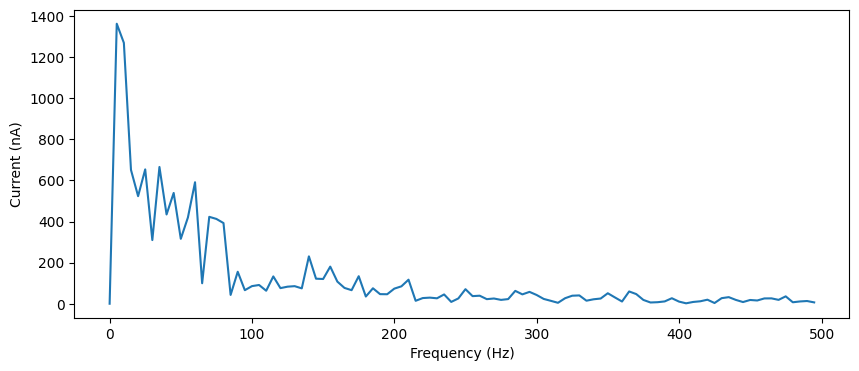

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1363.34183064 1363.34183064]


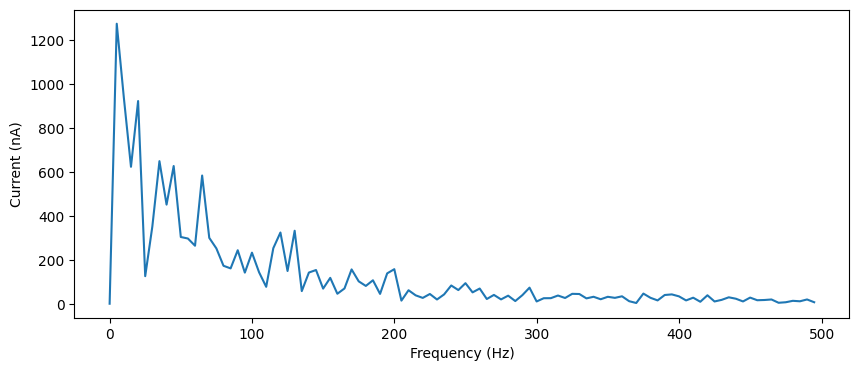

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1273.75487629 1273.75487629]


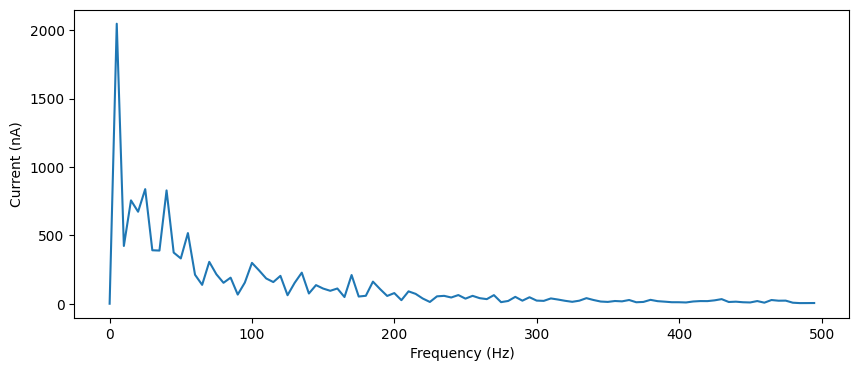

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2048.64828631 2048.64828631]


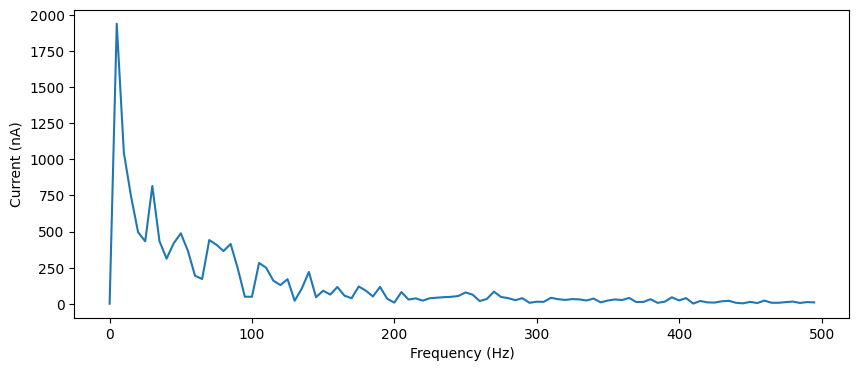

prob12=0.05, prob21=0.1, weight12=0.0005, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1940.1997805 1940.1997805]


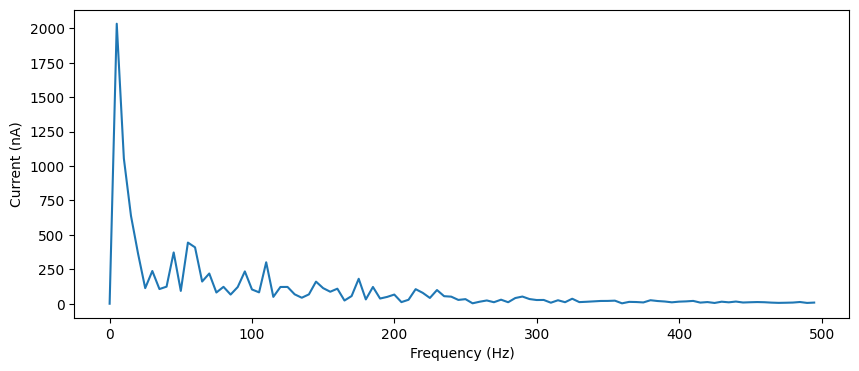

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.0005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2034.27513991 2034.27513991]


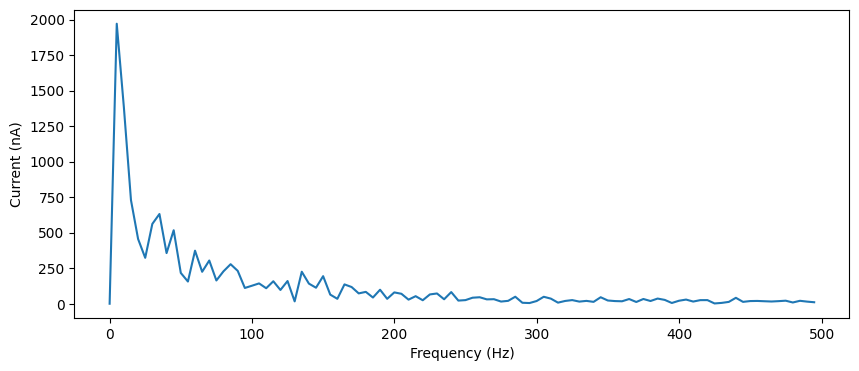

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1971.8038824 1971.8038824]


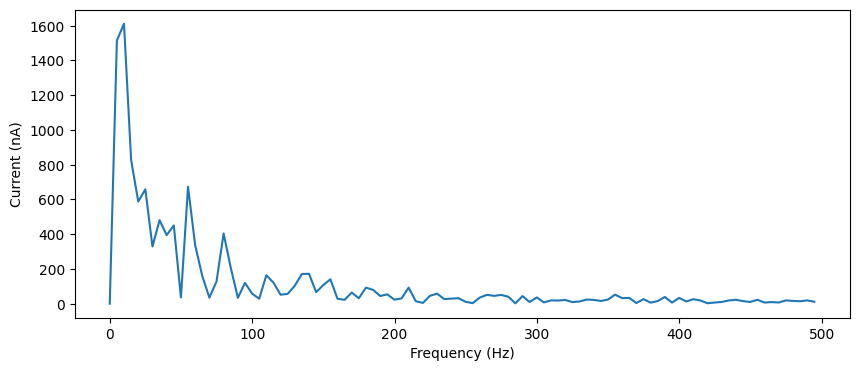

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.0015, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1611.68225147 1611.68225147]


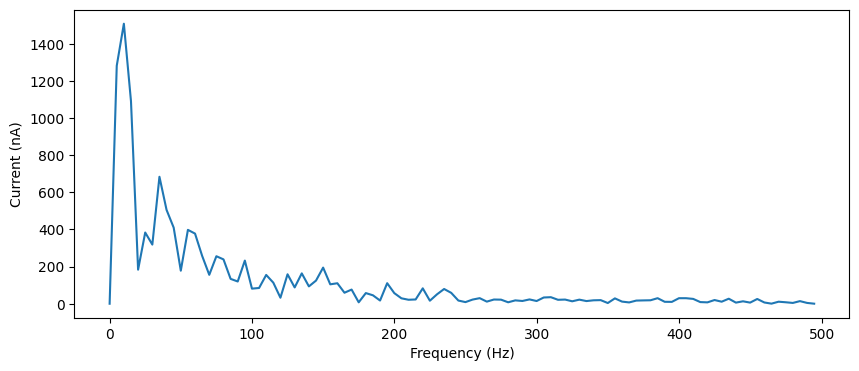

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.002, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1507.94181597 1507.94181597]


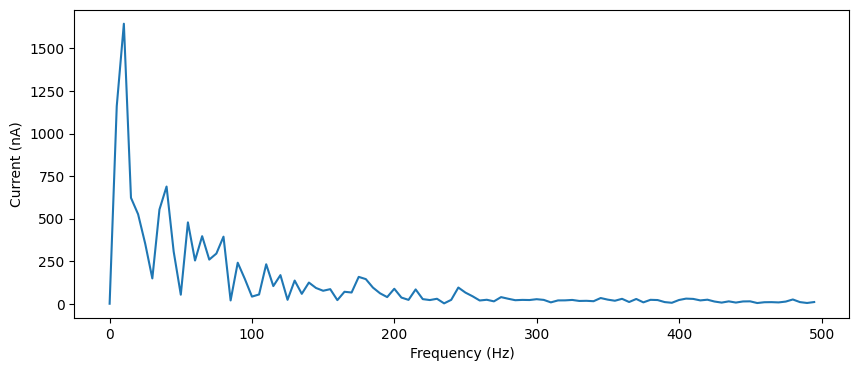

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.0025, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1645.19950891 1645.19950891]


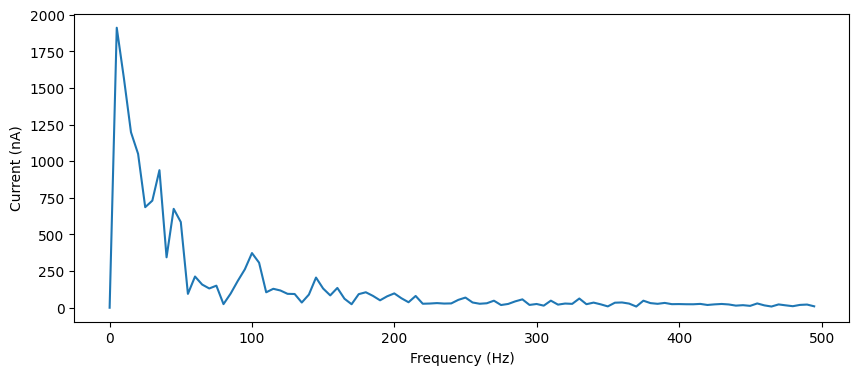

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1911.38395437 1911.38395437]


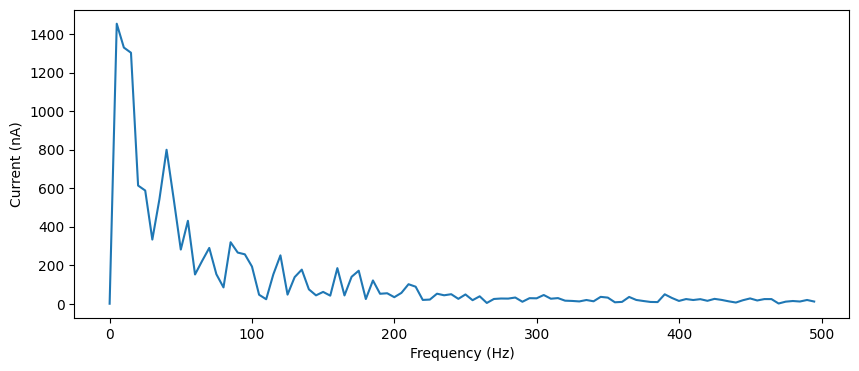

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1454.0341787 1454.0341787]


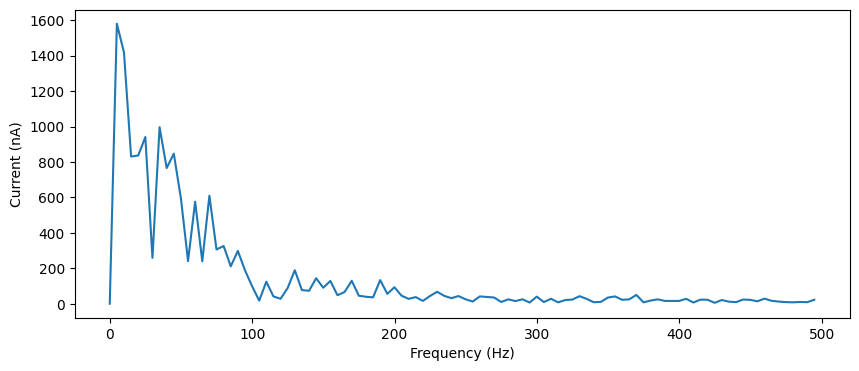

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1580.37775499 1580.37775499]


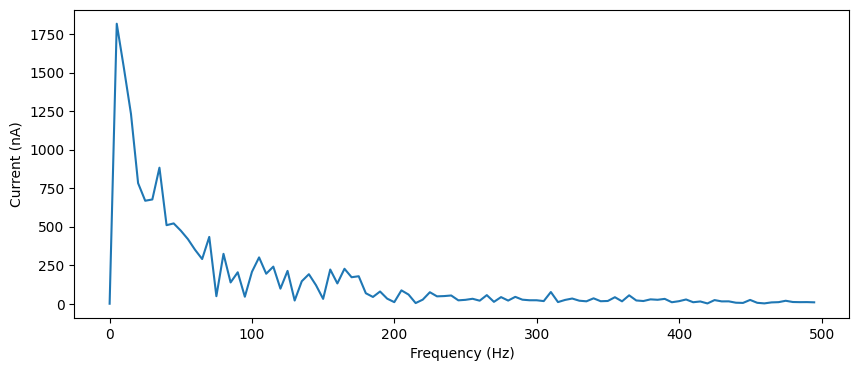

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1817.85444803 1817.85444803]


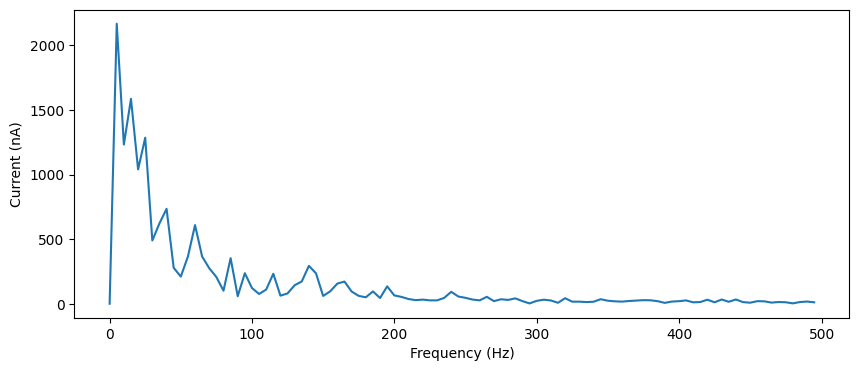

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2166.85727912 2166.85727912]


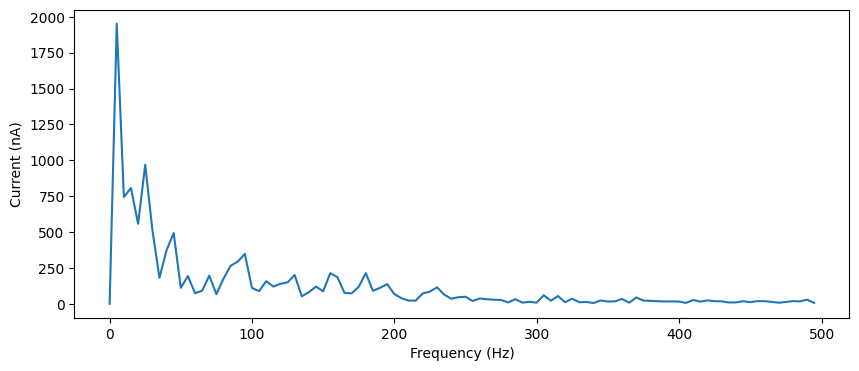

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.0055, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1951.70250921 1951.70250921]


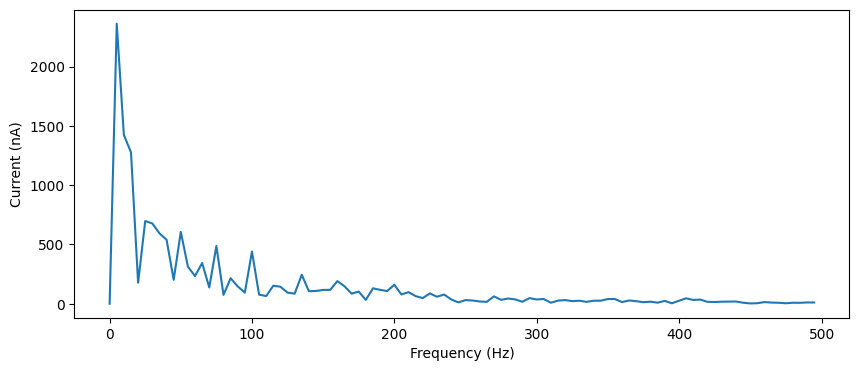

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.006, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2360.95837317 2360.95837317]


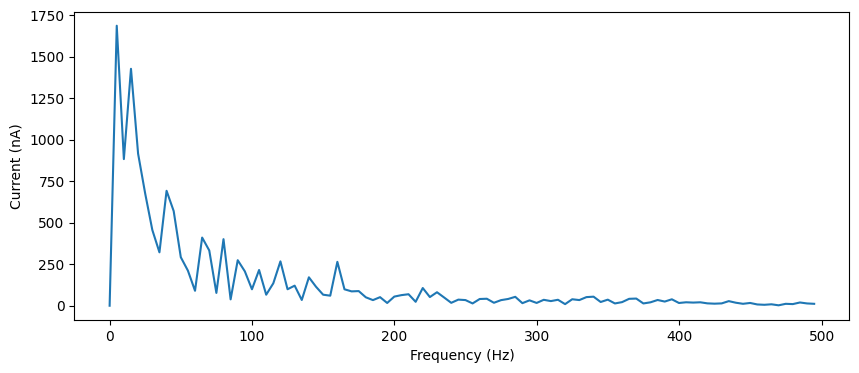

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1687.43814735 1687.43814735]


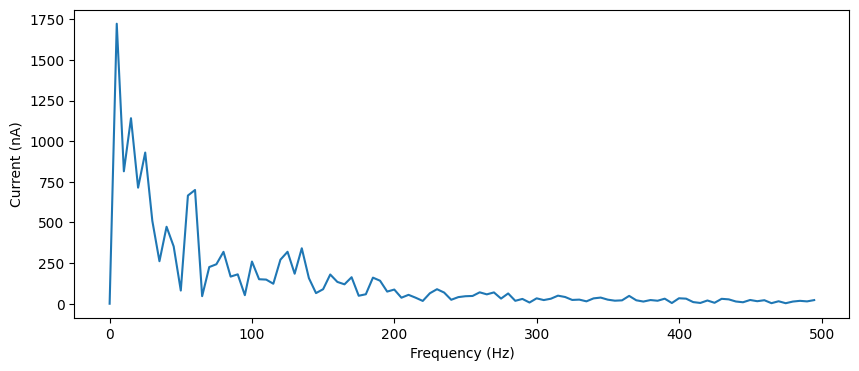

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1723.55970322 1723.55970322]


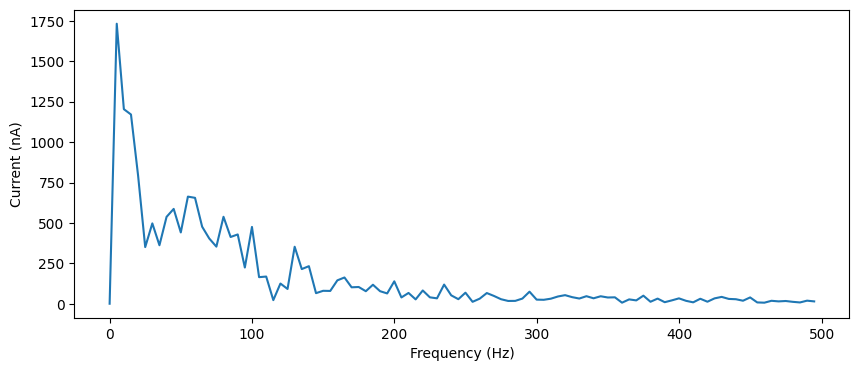

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.0075, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1732.62908099 1732.62908099]


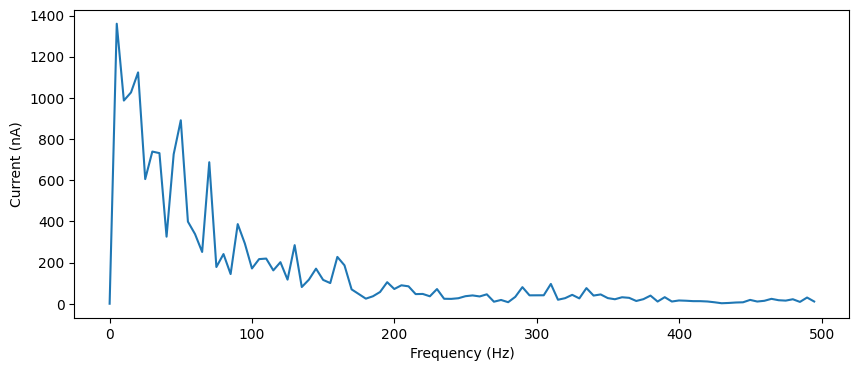

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1360.31075841 1360.31075841]


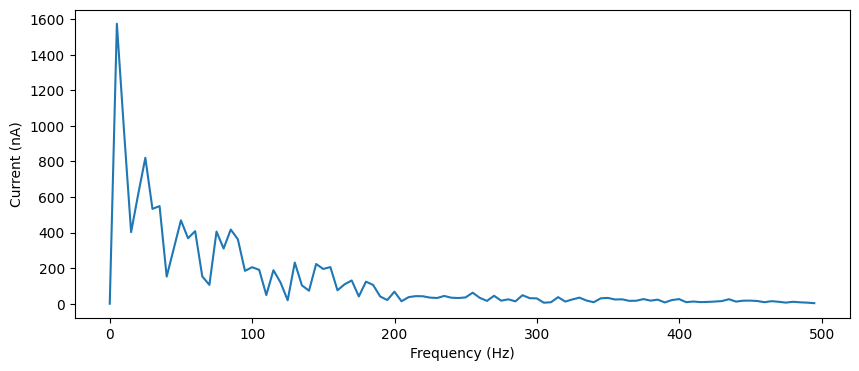

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1574.39215688 1574.39215688]


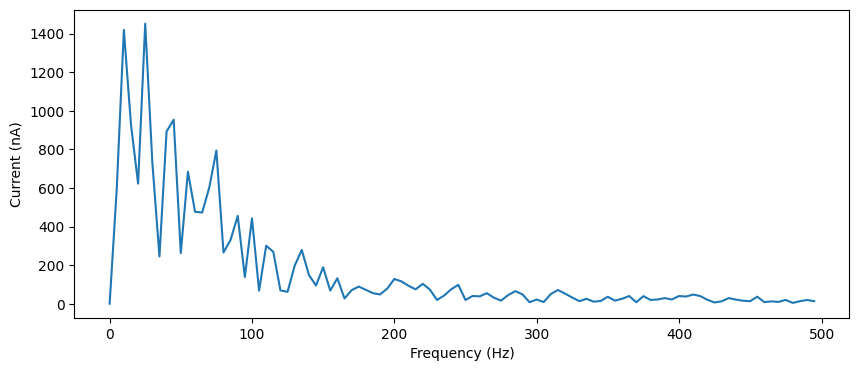

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.009000000000000001, peak_freqs=[-24.98750625  24.98750625], peak_freqs_amp=[1451.76567243 1451.76567243]


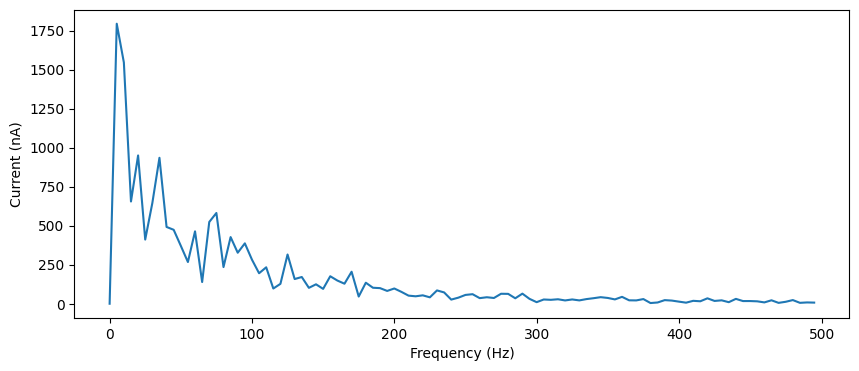

prob12=0.05, prob21=0.1, weight12=0.001, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1794.02924173 1794.02924173]


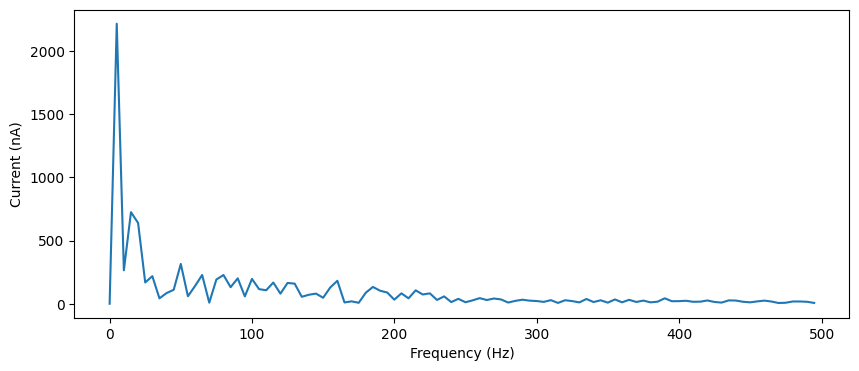

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.0005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2218.1959587 2218.1959587]


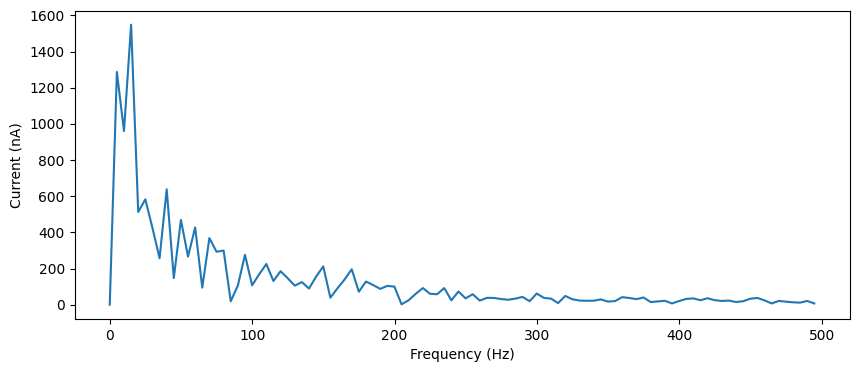

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.001, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[1548.4175859 1548.4175859]


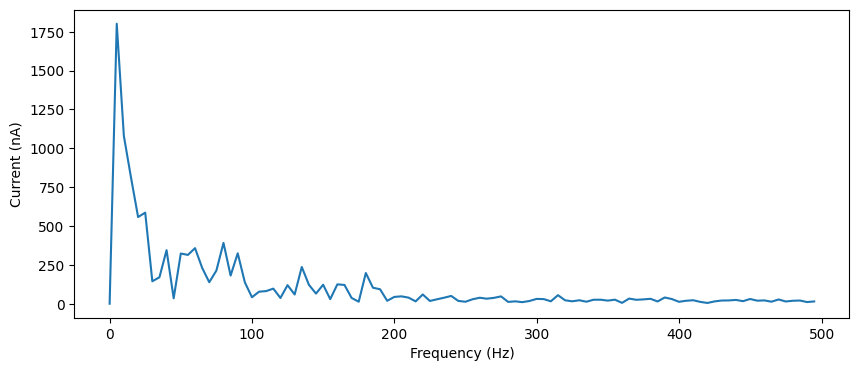

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1801.89218264 1801.89218264]


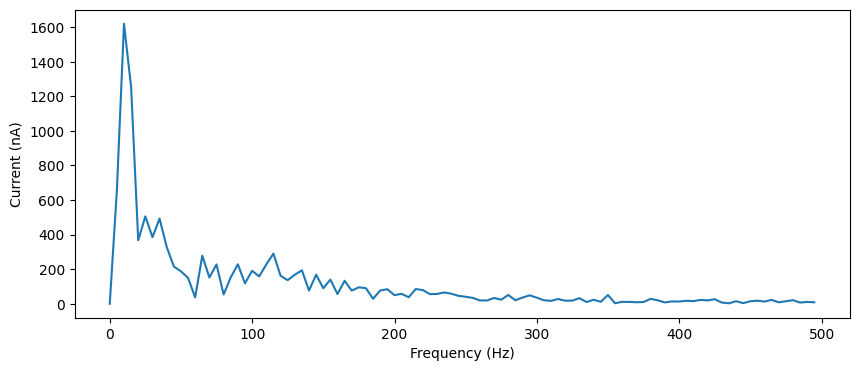

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.002, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1620.33828555 1620.33828555]


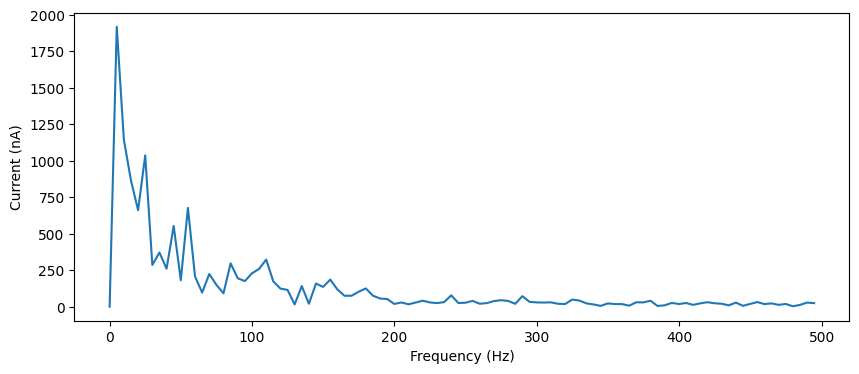

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.0025, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1919.83440366 1919.83440366]


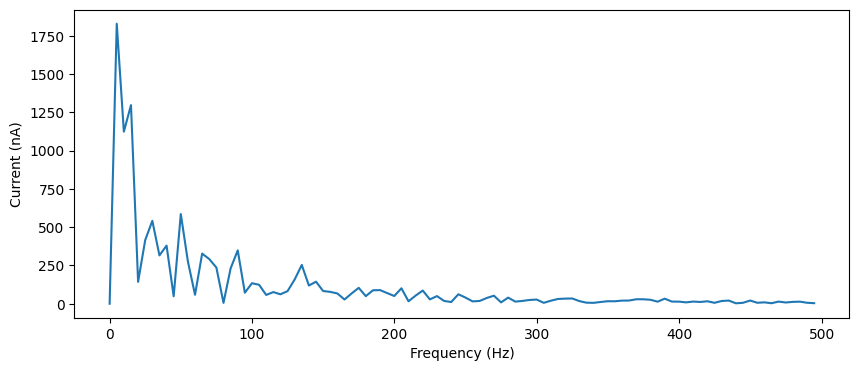

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1828.50862229 1828.50862229]


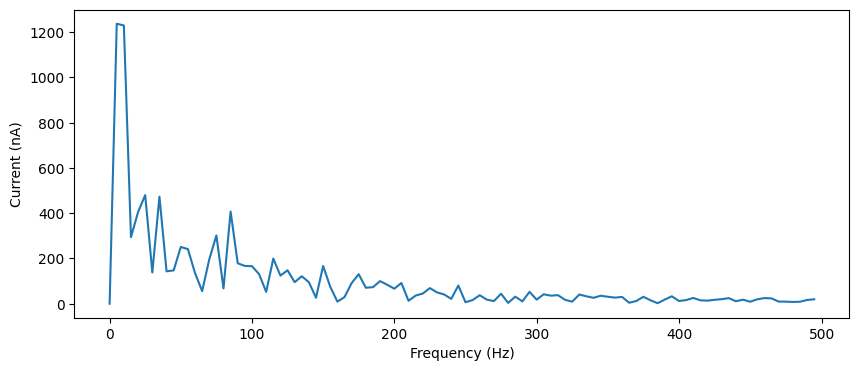

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1237.58357674 1237.58357674]


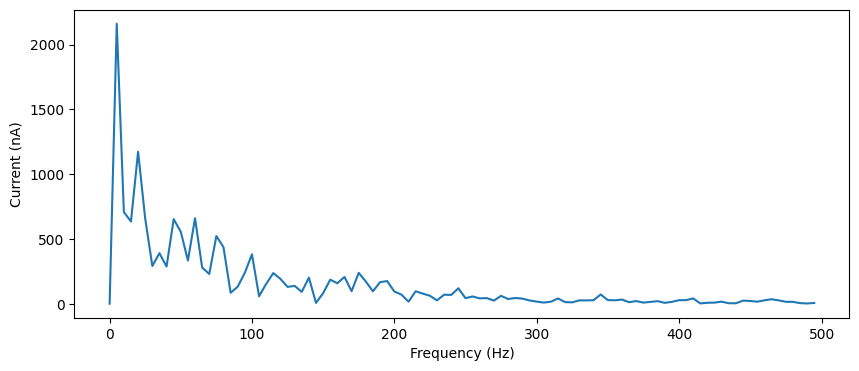

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2160.83888968 2160.83888968]


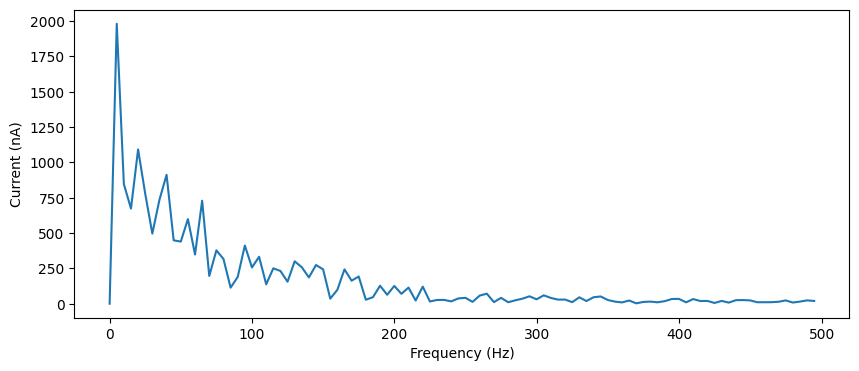

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1981.32155507 1981.32155507]


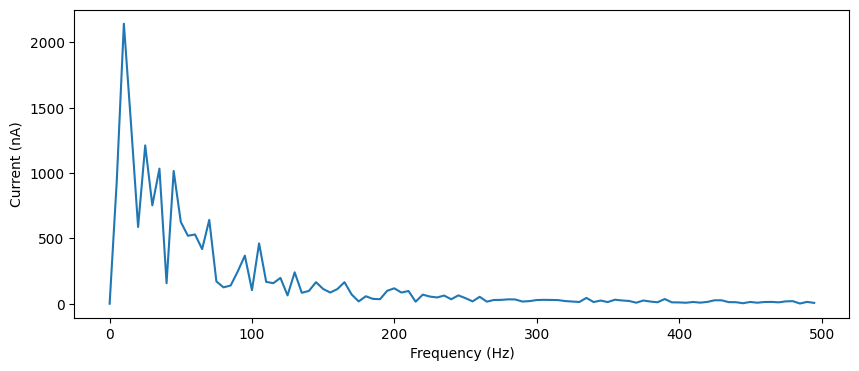

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.005000000000000001, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[2143.60412458 2143.60412458]


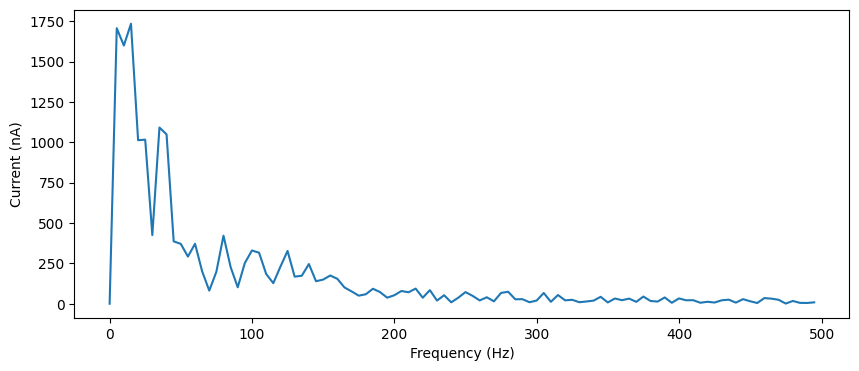

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.0055, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[1735.40239344 1735.40239344]


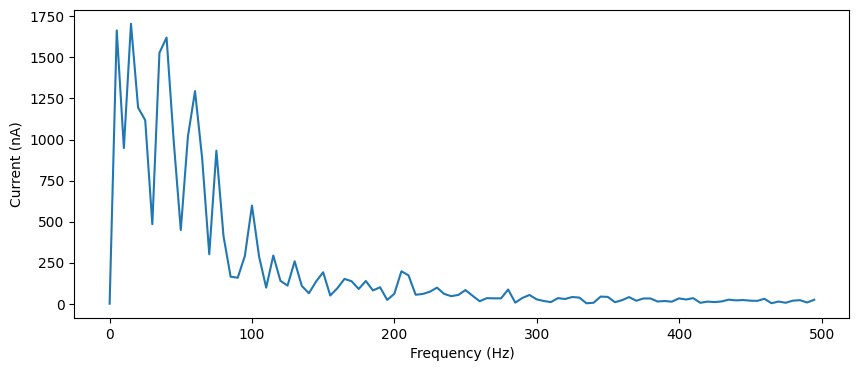

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.006, peak_freqs=[ 14.99250375 -14.99250375], peak_freqs_amp=[1705.19522414 1705.19522414]


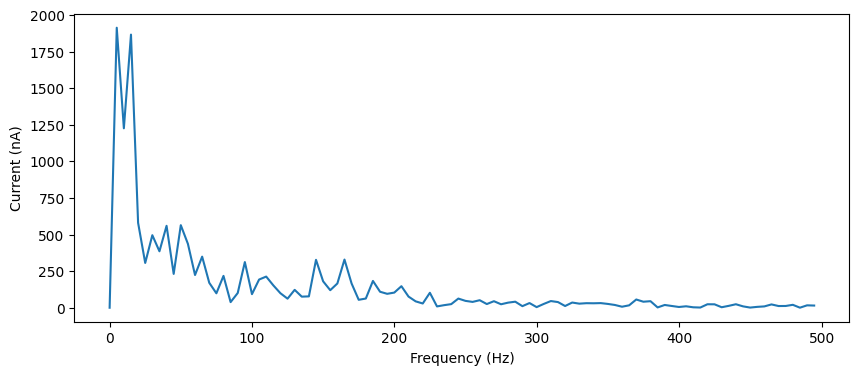

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1912.52555398 1912.52555398]


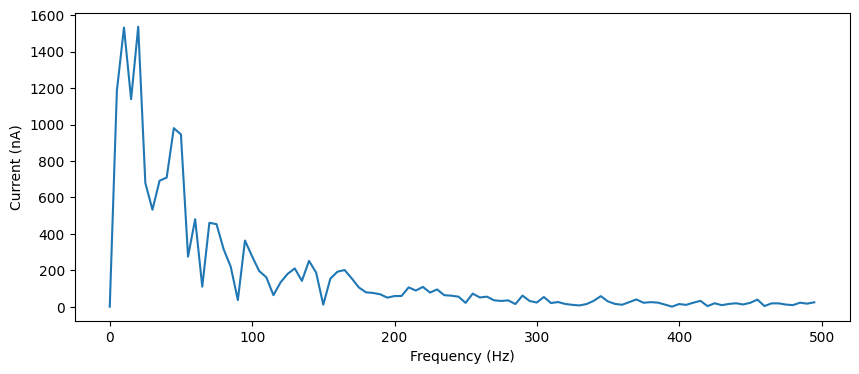

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.007000000000000001, peak_freqs=[ 19.990005 -19.990005], peak_freqs_amp=[1536.70001326 1536.70001326]


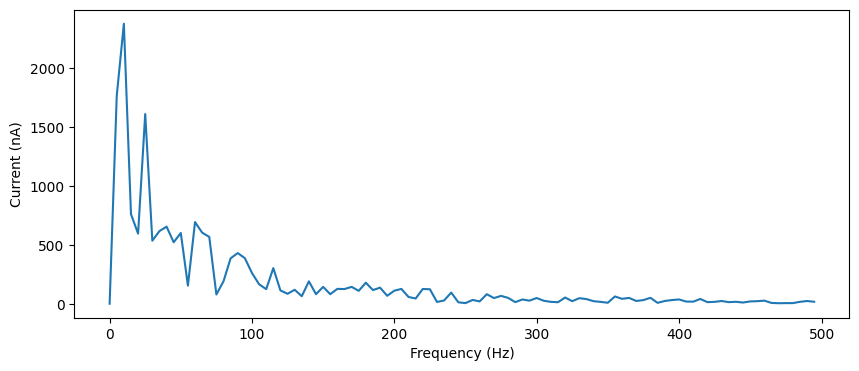

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.0075, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[2377.91523794 2377.91523794]


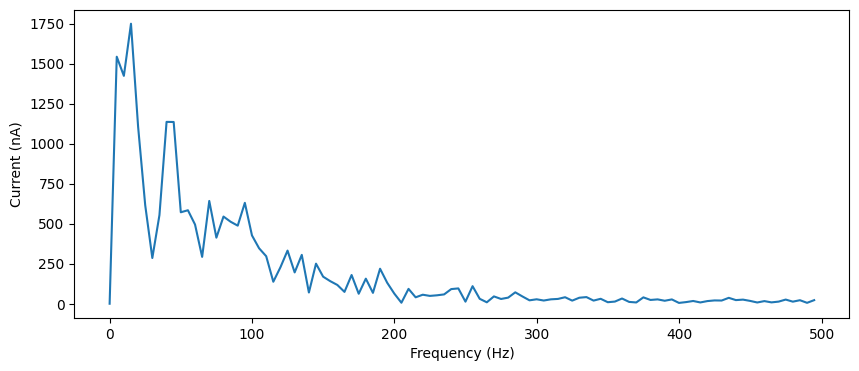

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.008, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[1749.3184629 1749.3184629]


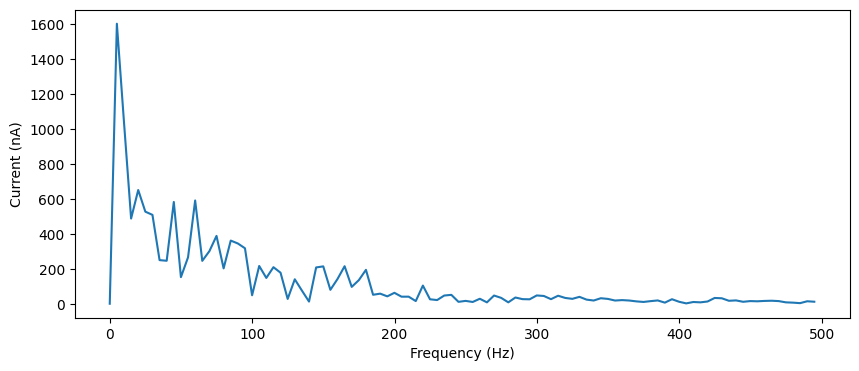

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1602.2769174 1602.2769174]


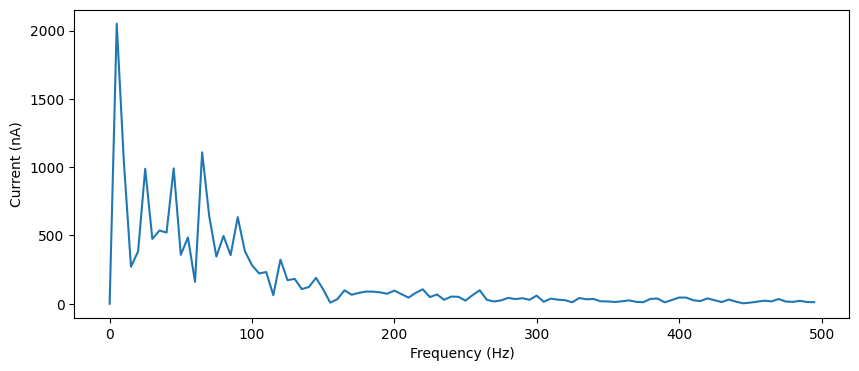

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2051.00465459 2051.00465459]


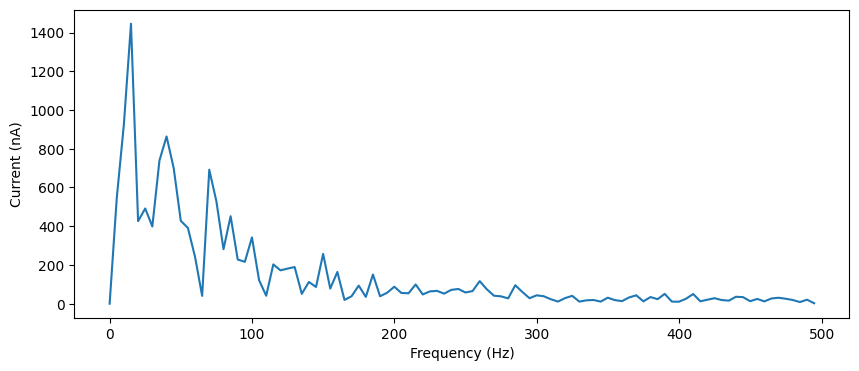

prob12=0.05, prob21=0.1, weight12=0.0015, weight21=0.009500000000000001, peak_freqs=[ 14.99250375 -14.99250375], peak_freqs_amp=[1445.35186904 1445.35186904]


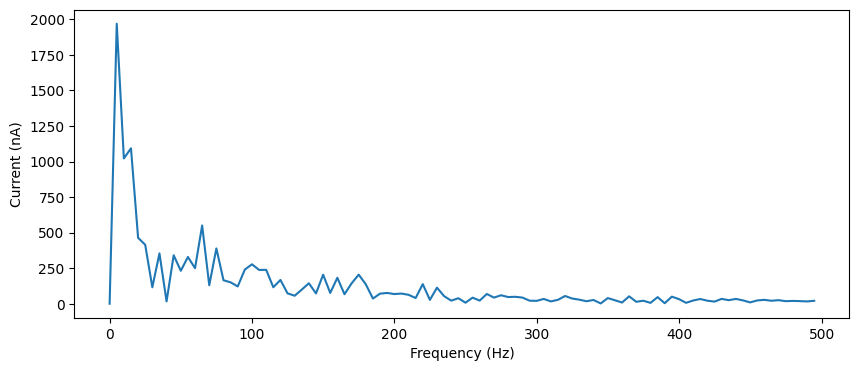

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.0005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1968.97797005 1968.97797005]


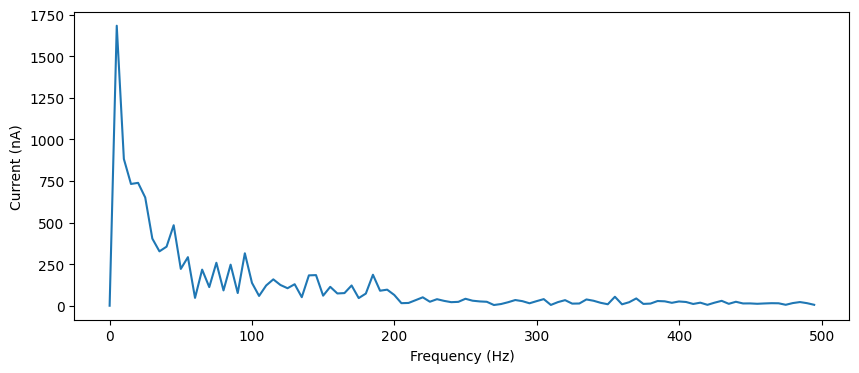

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1682.89923574 1682.89923574]


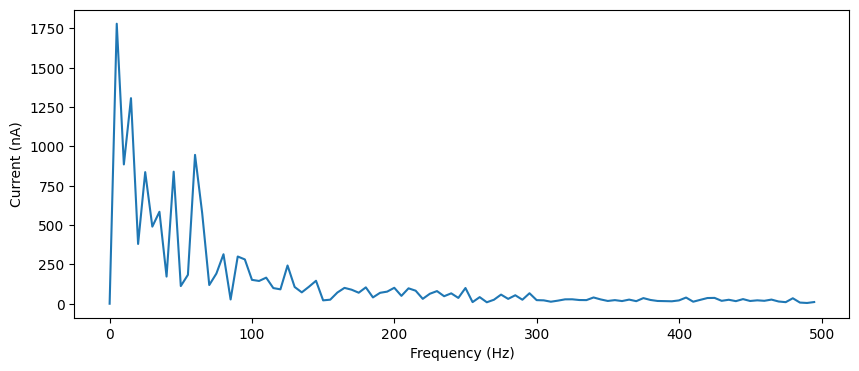

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1779.67682857 1779.67682857]


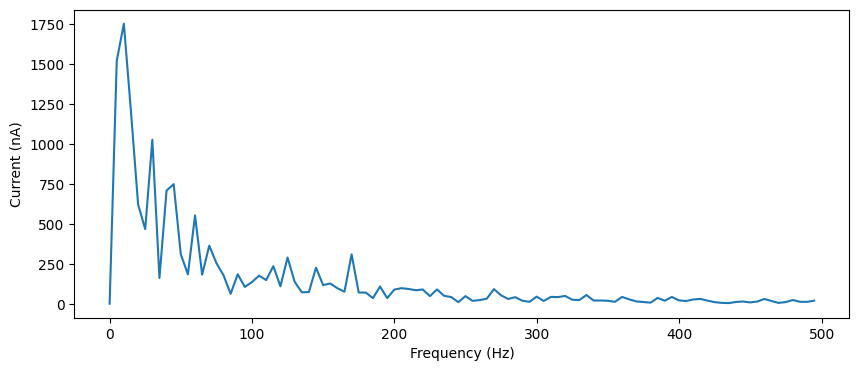

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.002, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[1754.05698385 1754.05698385]


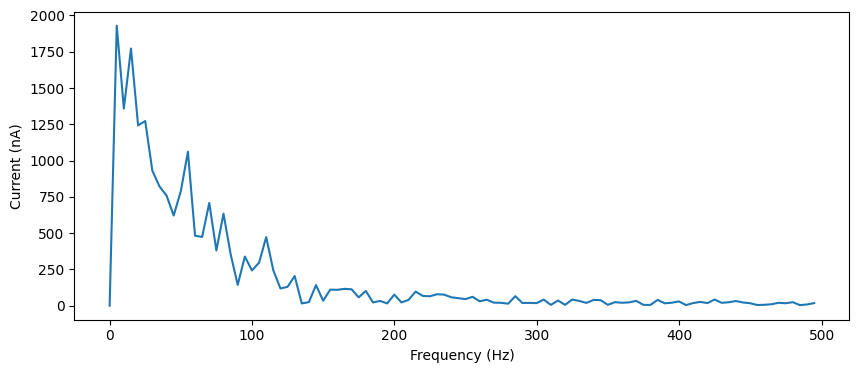

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.0025, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1929.23095607 1929.23095607]


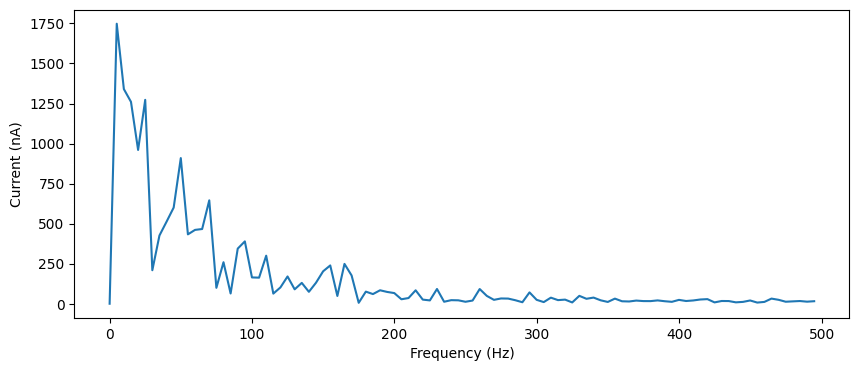

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1748.16058902 1748.16058902]


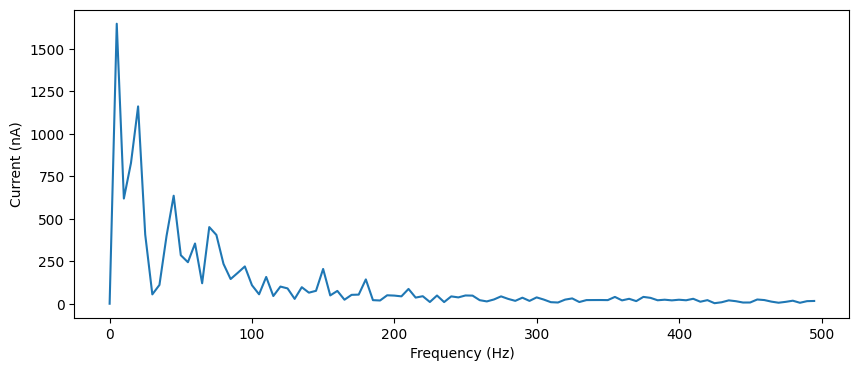

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1649.13006677 1649.13006677]


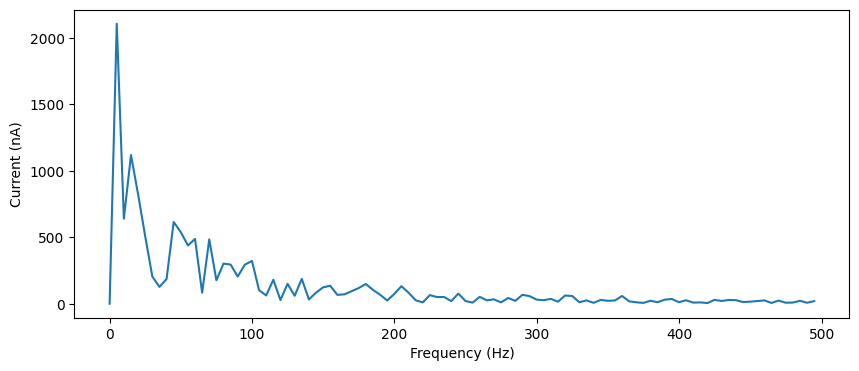

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2107.77277497 2107.77277497]


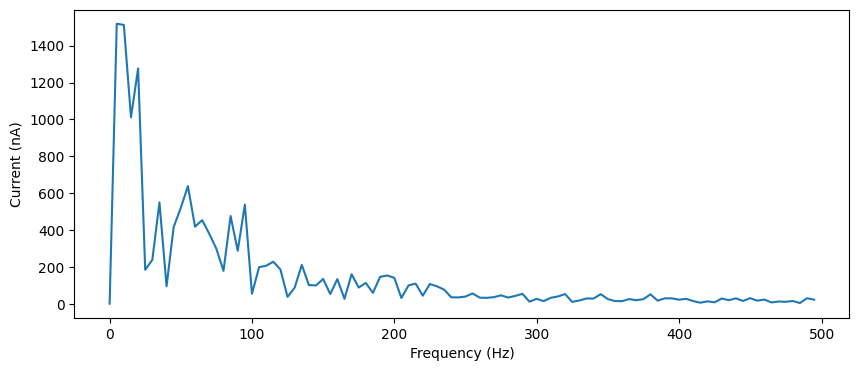

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1518.92506494 1518.92506494]


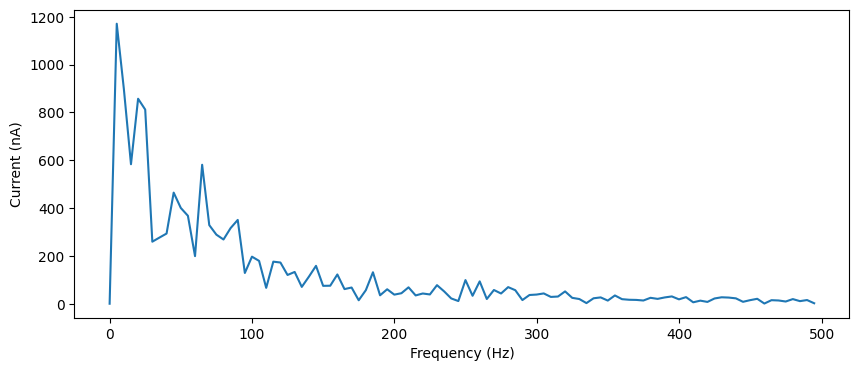

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1170.98880393 1170.98880393]


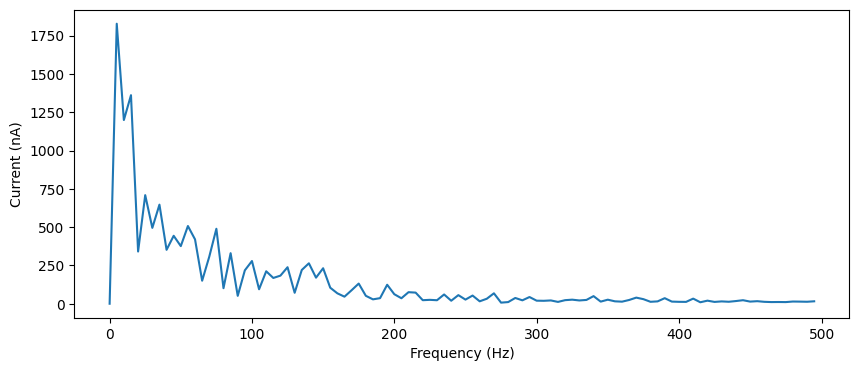

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.0055, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1827.58079038 1827.58079038]


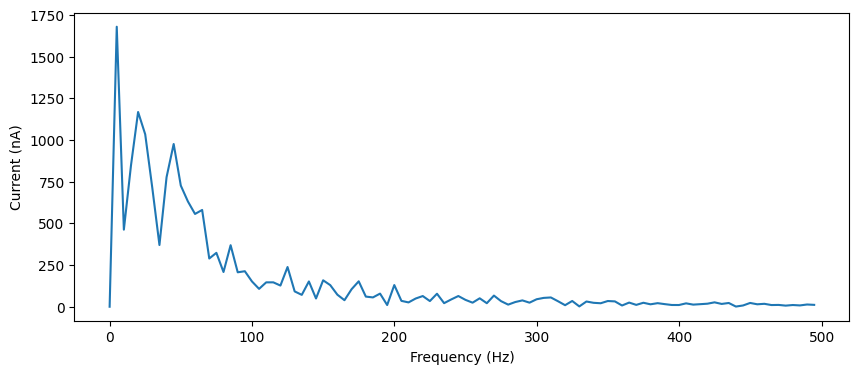

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.006, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1679.21233333 1679.21233333]


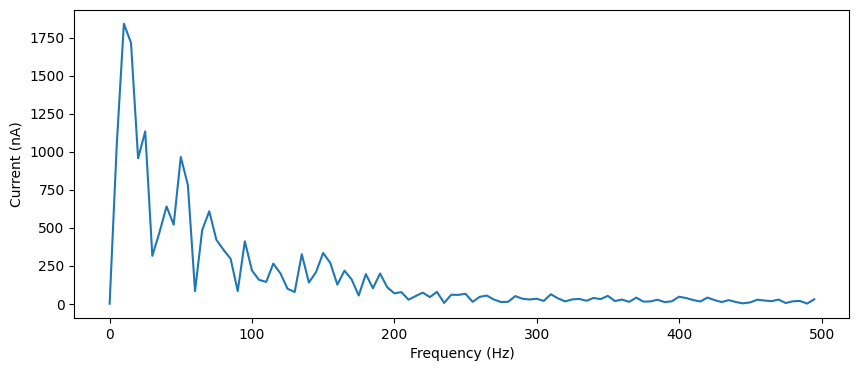

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.006500000000000001, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[1841.11135604 1841.11135604]


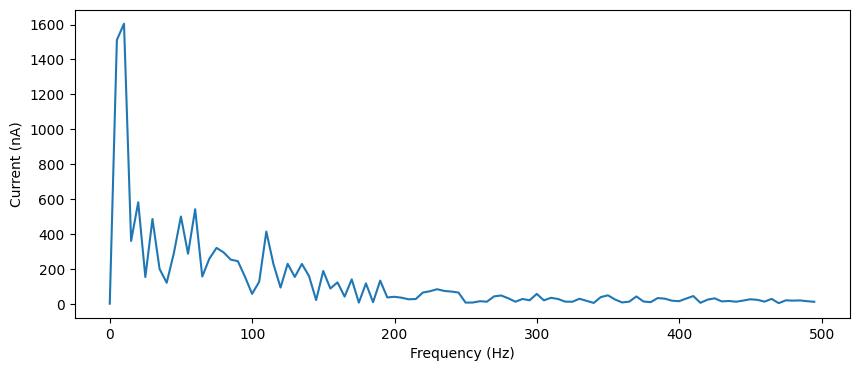

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.007000000000000001, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1604.68562079 1604.68562079]


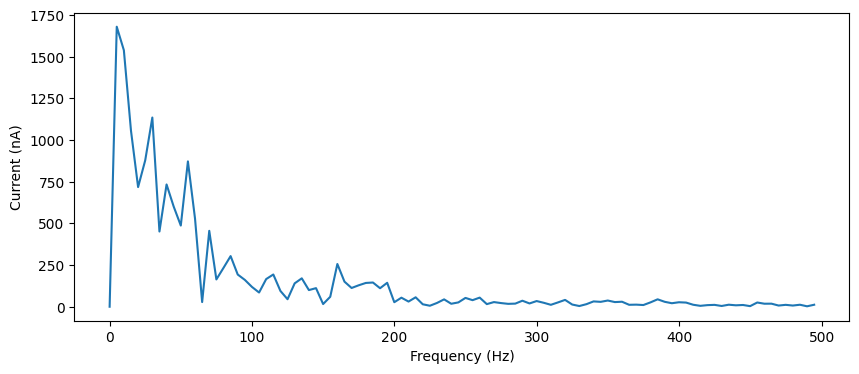

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.0075, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1679.70902917 1679.70902917]


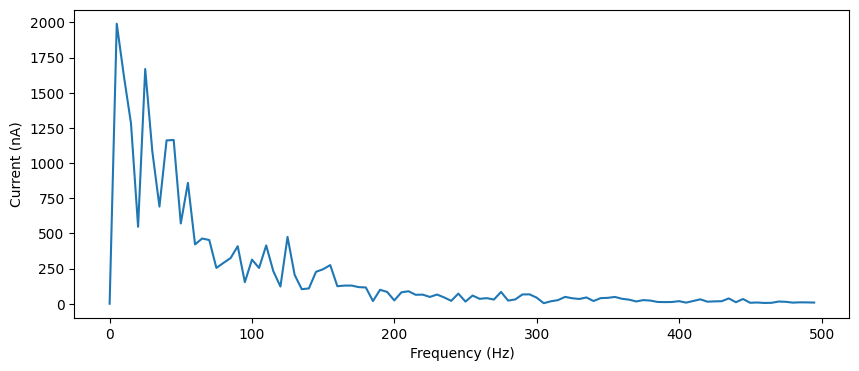

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1990.55347604 1990.55347604]


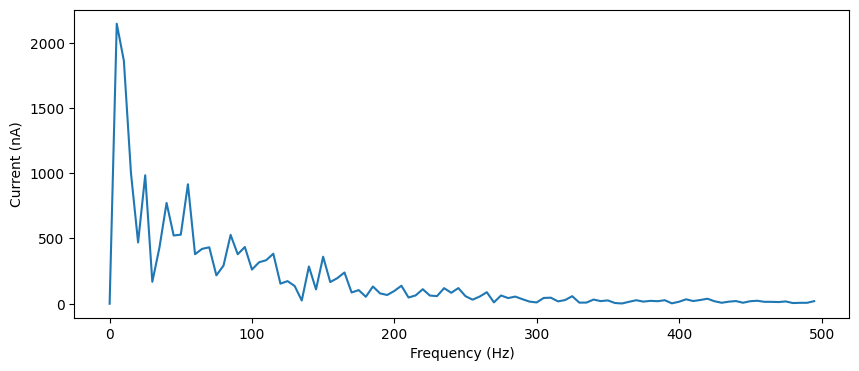

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2146.47772161 2146.47772161]


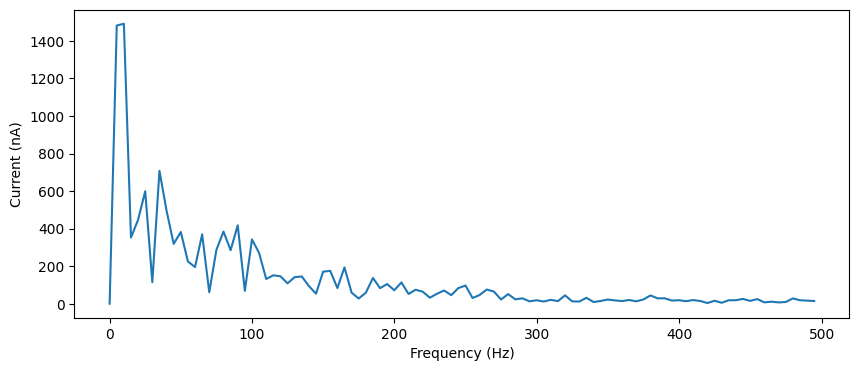

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.009000000000000001, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1491.84928946 1491.84928946]


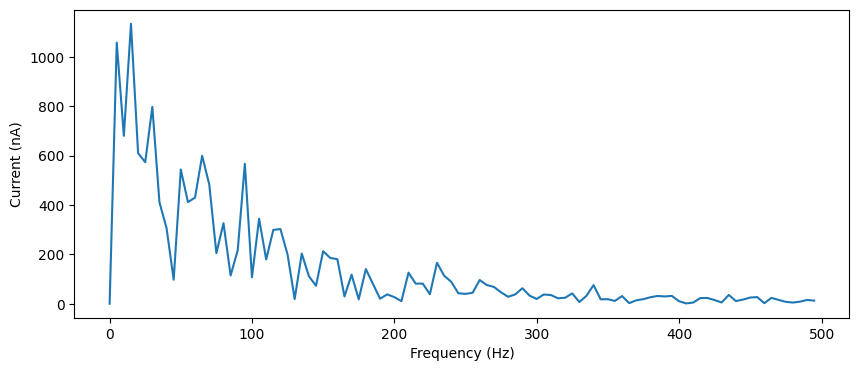

prob12=0.05, prob21=0.1, weight12=0.002, weight21=0.009500000000000001, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[1134.08877623 1134.08877623]


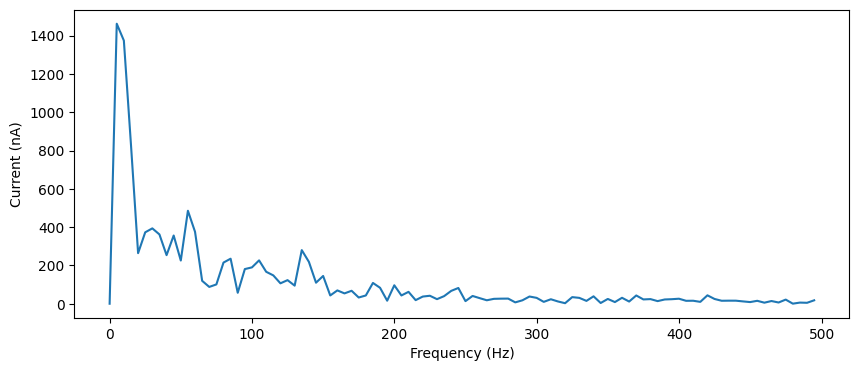

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.0005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1462.63290613 1462.63290613]


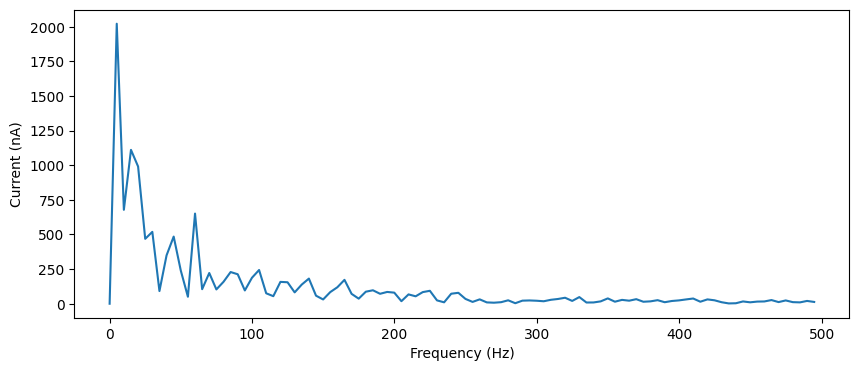

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2022.44799423 2022.44799423]


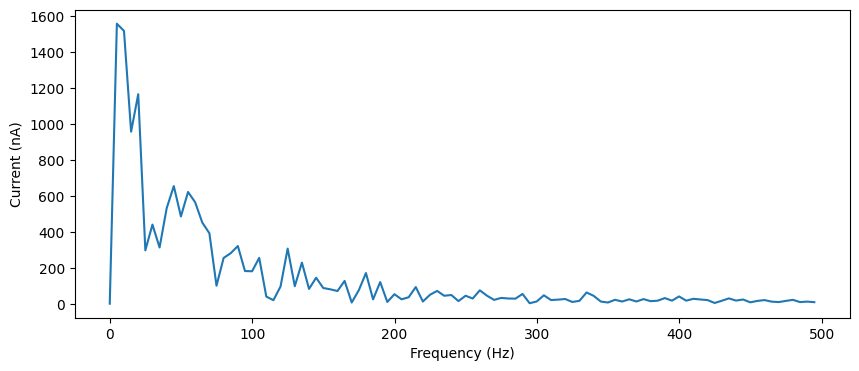

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1555.86719095 1555.86719095]


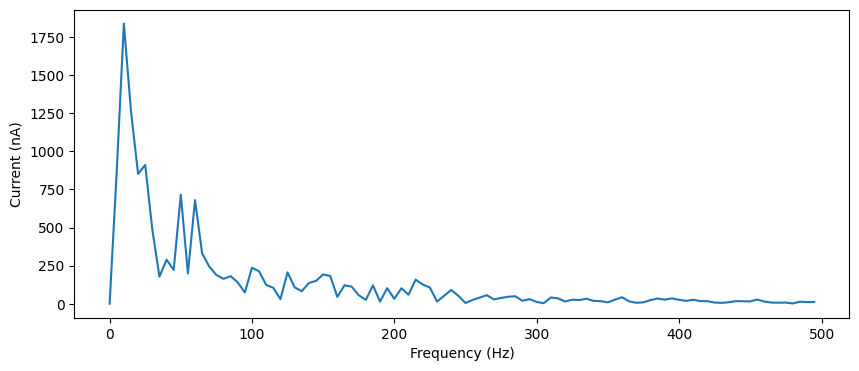

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.002, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1837.13814184 1837.13814184]


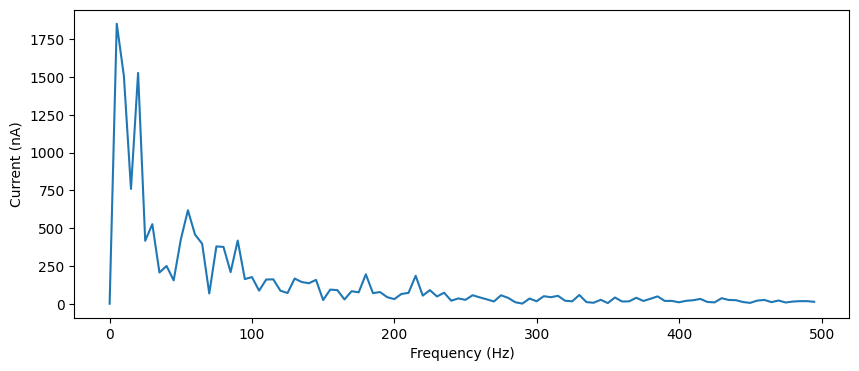

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.0025, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1851.93284871 1851.93284871]


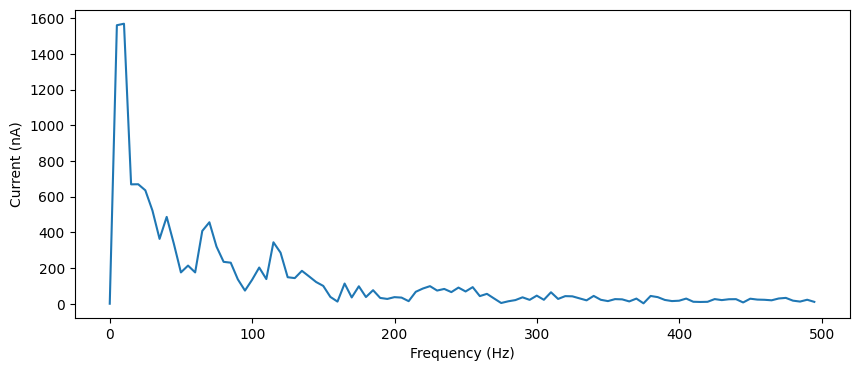

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.003, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[1568.94646875 1568.94646875]


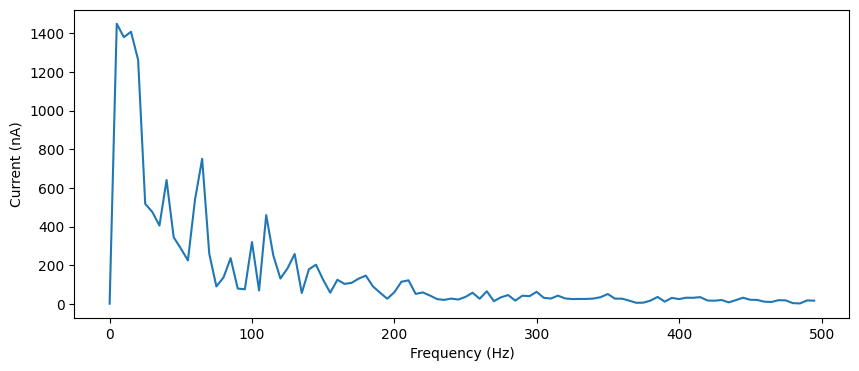

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.0035, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1450.59748212 1450.59748212]


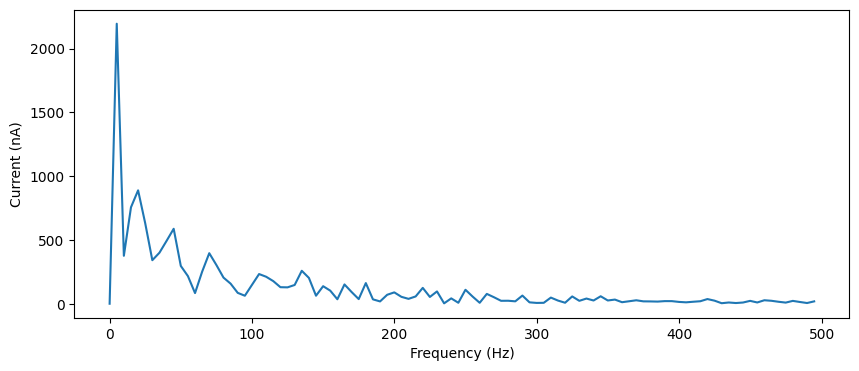

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2195.2670016 2195.2670016]


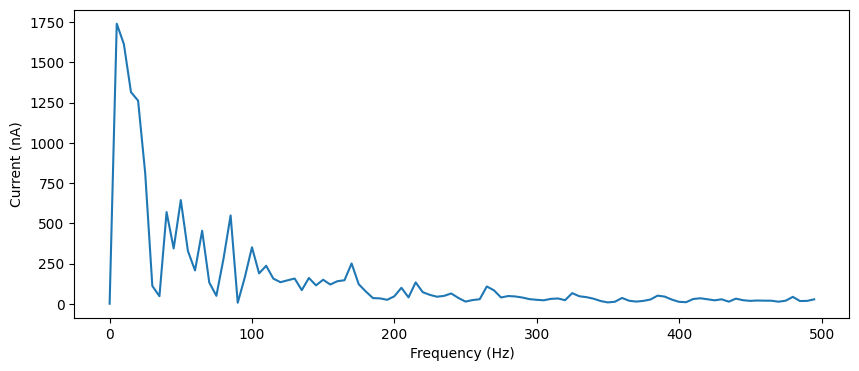

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1740.41467089 1740.41467089]


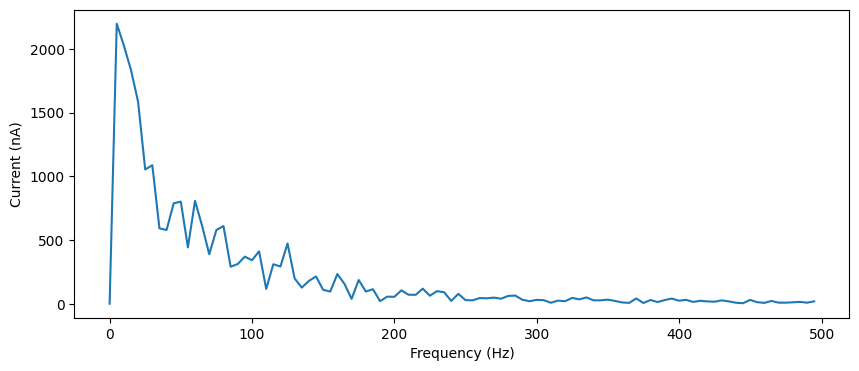

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2197.76825233 2197.76825233]


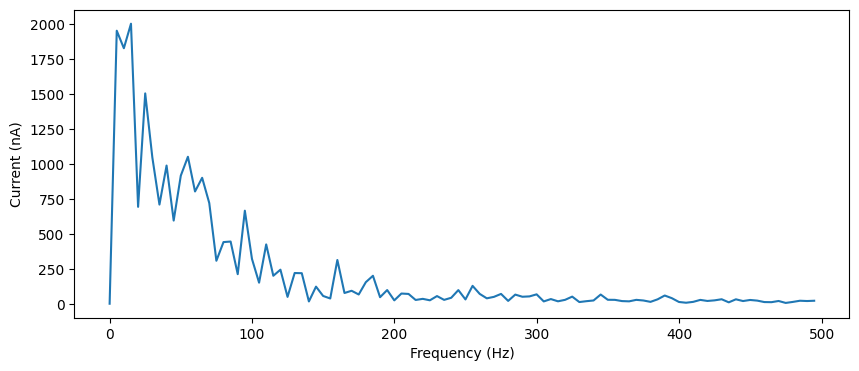

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.0055, peak_freqs=[ 14.99250375 -14.99250375], peak_freqs_amp=[2003.47234586 2003.47234586]


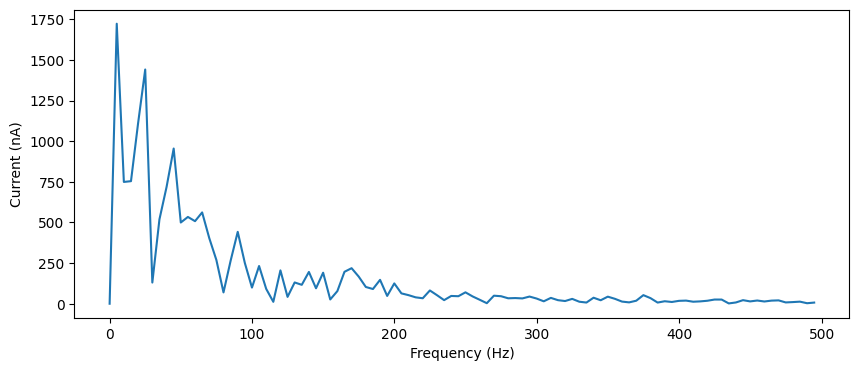

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.006, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1723.03897417 1723.03897417]


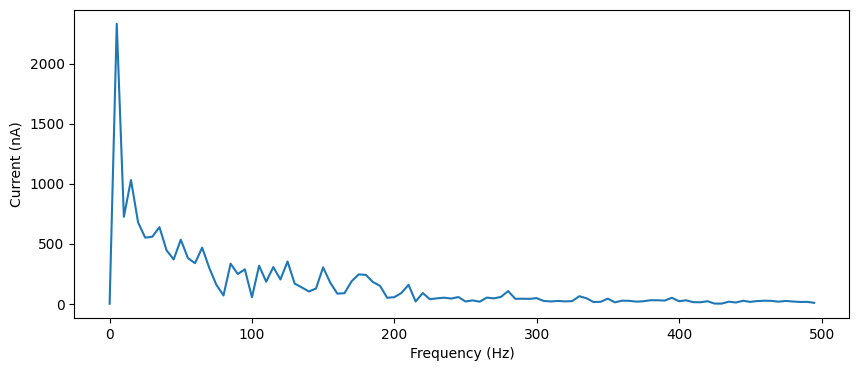

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2331.53364492 2331.53364492]


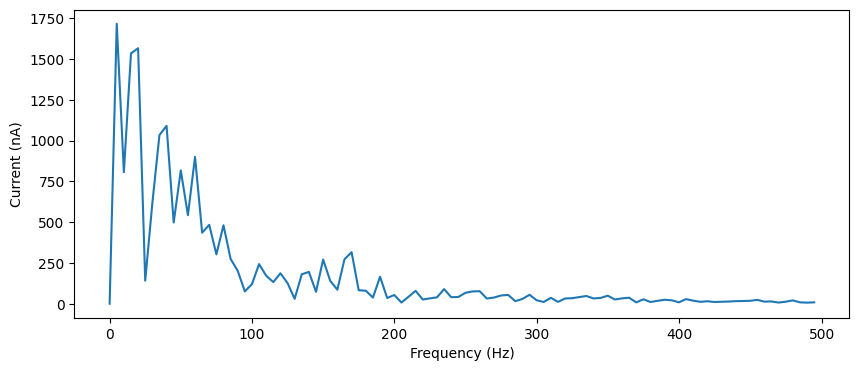

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1717.56132848 1717.56132848]


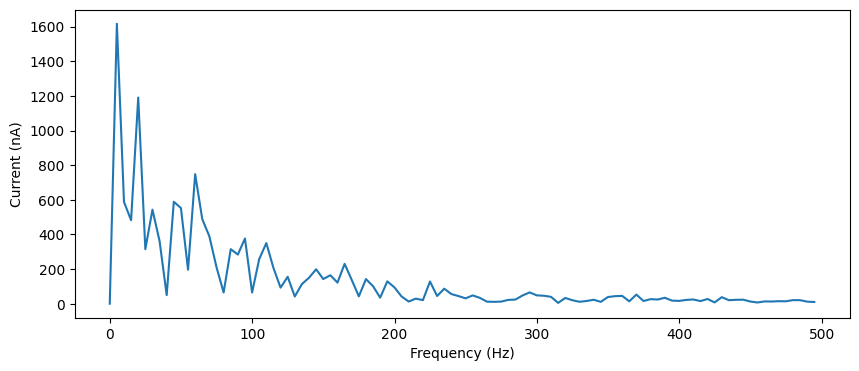

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.0075, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1616.82873978 1616.82873978]


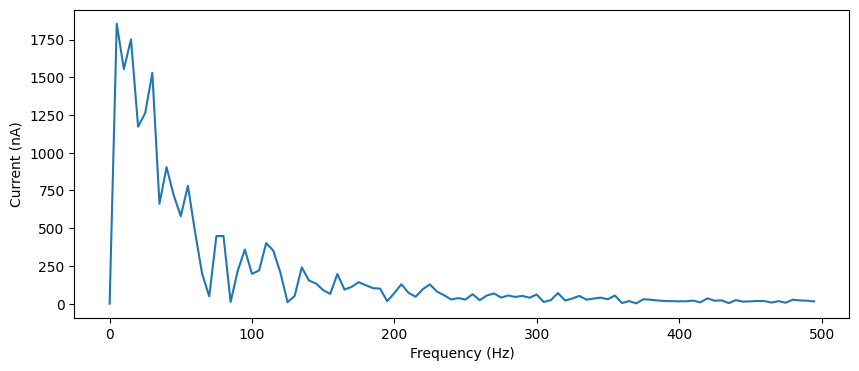

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1854.75013051 1854.75013051]


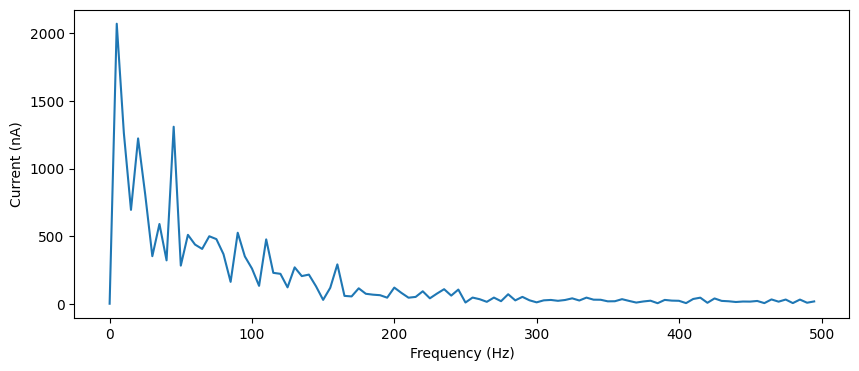

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2071.68747612 2071.68747612]


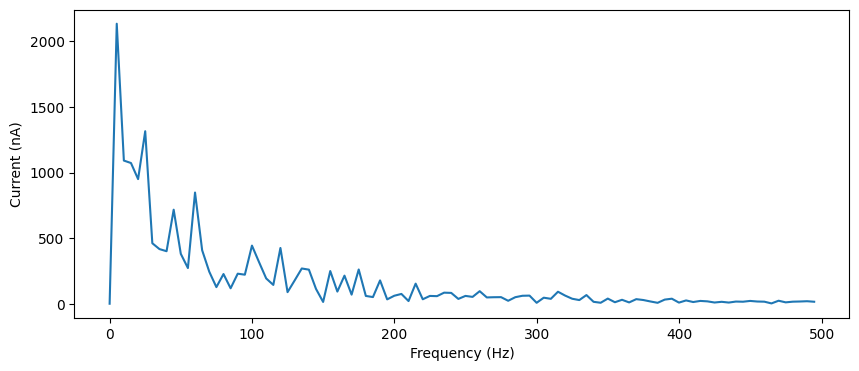

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2133.99831369 2133.99831369]


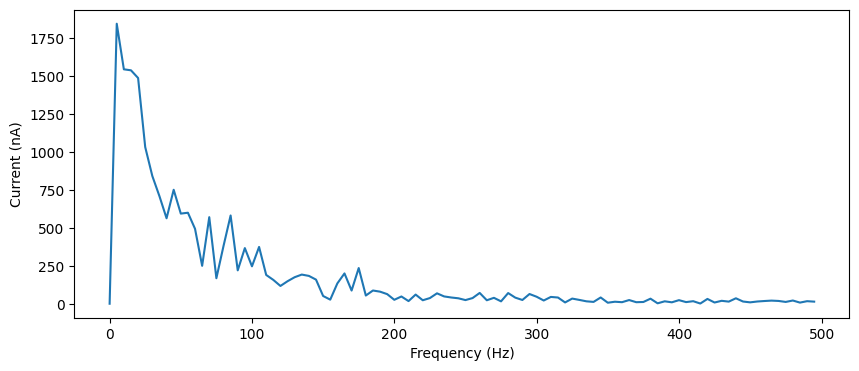

prob12=0.05, prob21=0.1, weight12=0.0025, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1845.80755658 1845.80755658]


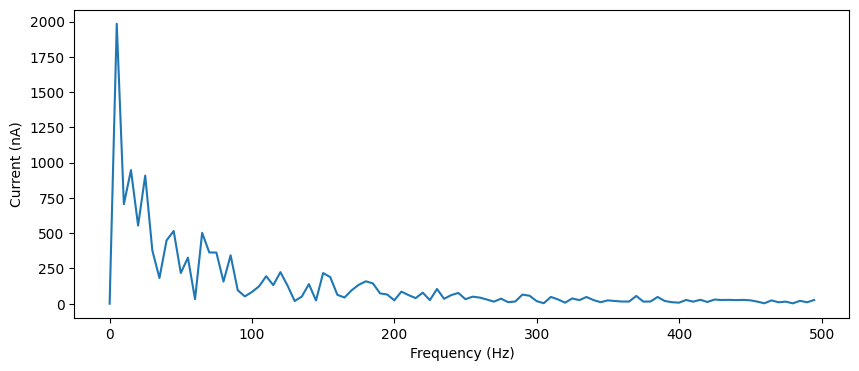

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.0005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1985.69964143 1985.69964143]


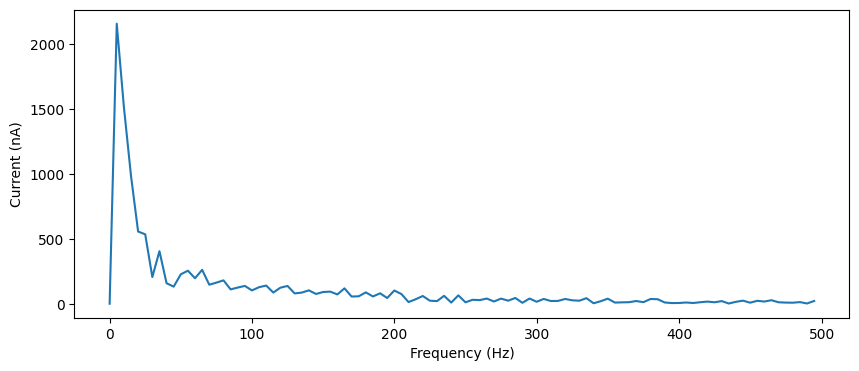

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2160.14765725 2160.14765725]


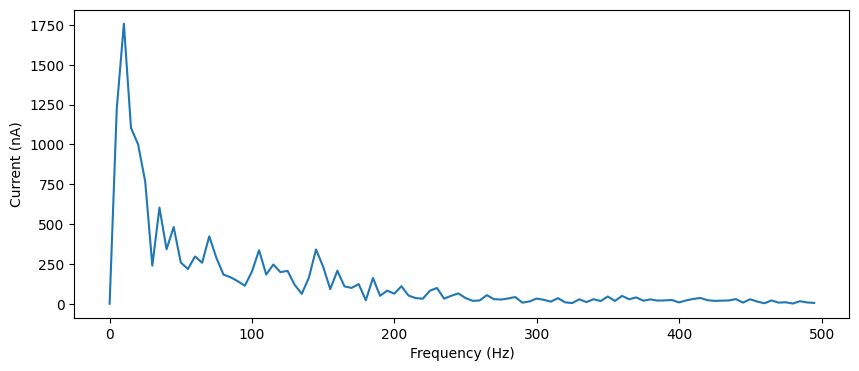

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.0015, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1758.40780697 1758.40780697]


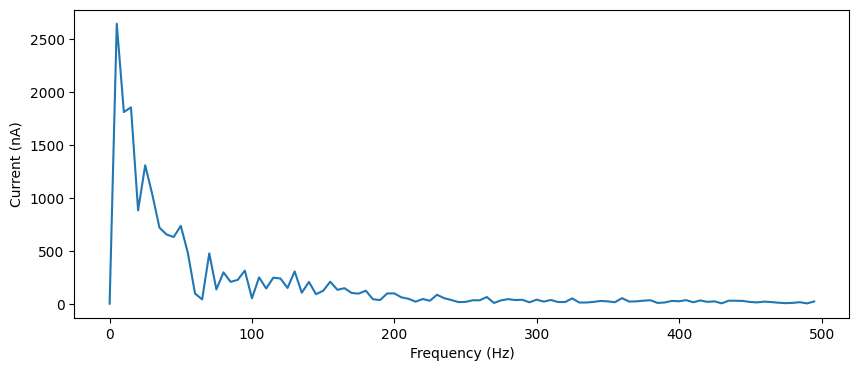

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.002, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2647.36246888 2647.36246888]


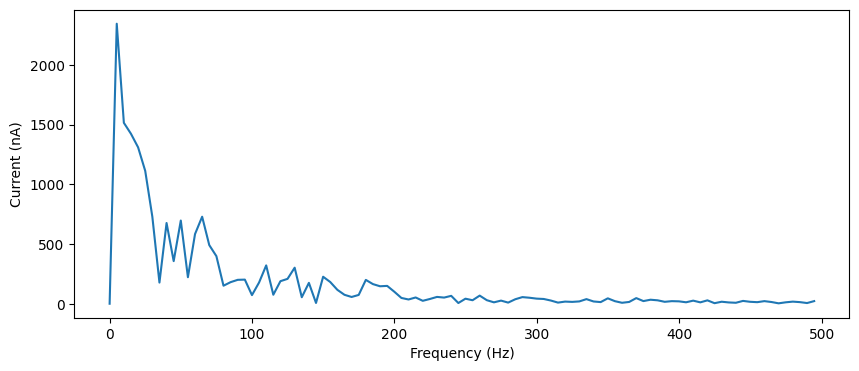

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.0025, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2345.45495417 2345.45495417]


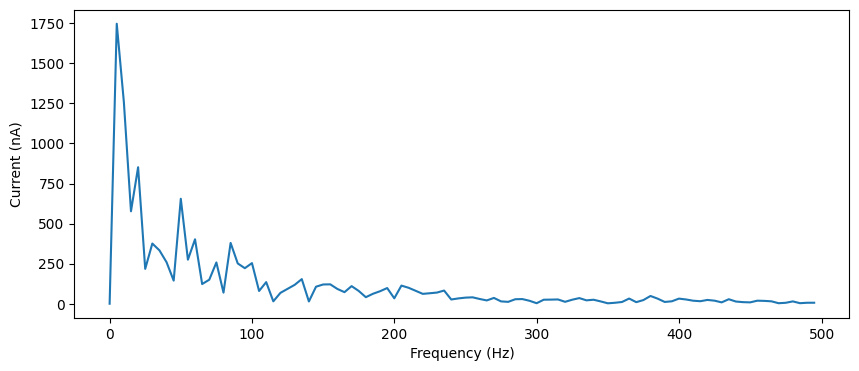

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1746.77337972 1746.77337972]


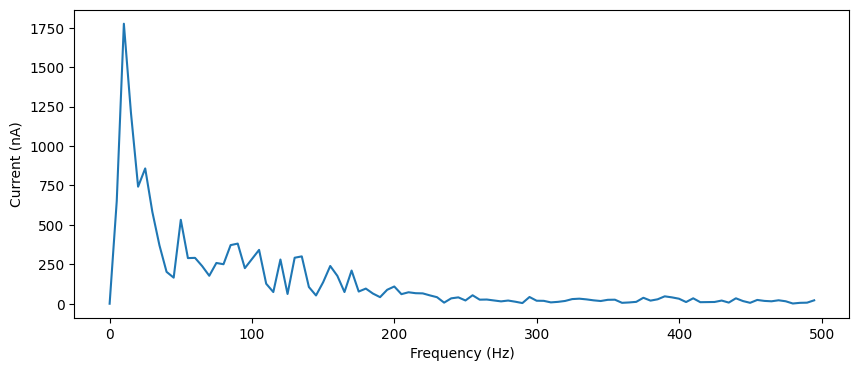

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.0035, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[1776.26203114 1776.26203114]


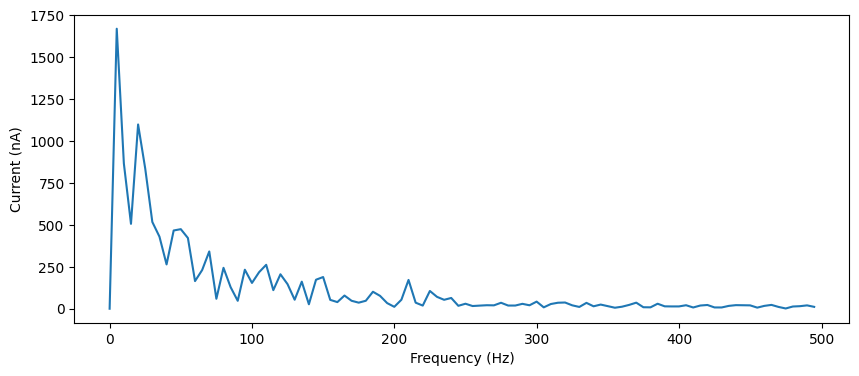

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1669.79618072 1669.79618072]


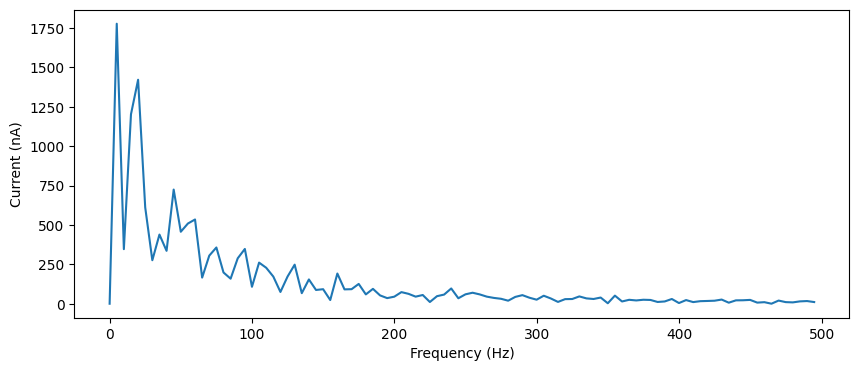

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1777.09624701 1777.09624701]


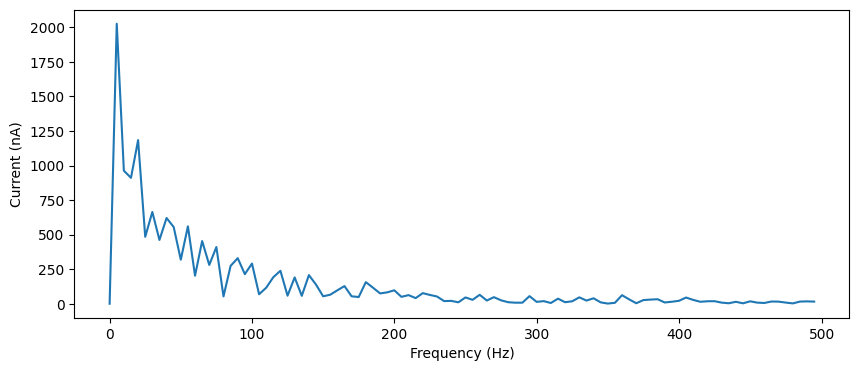

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2026.7558239 2026.7558239]


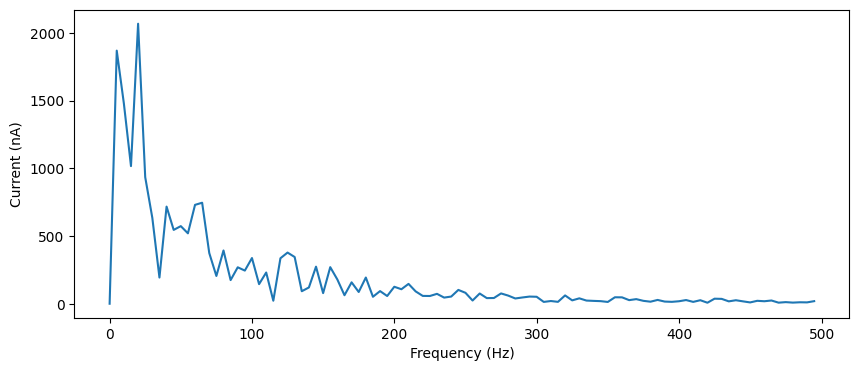

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.0055, peak_freqs=[ 19.990005 -19.990005], peak_freqs_amp=[2067.66458832 2067.66458832]


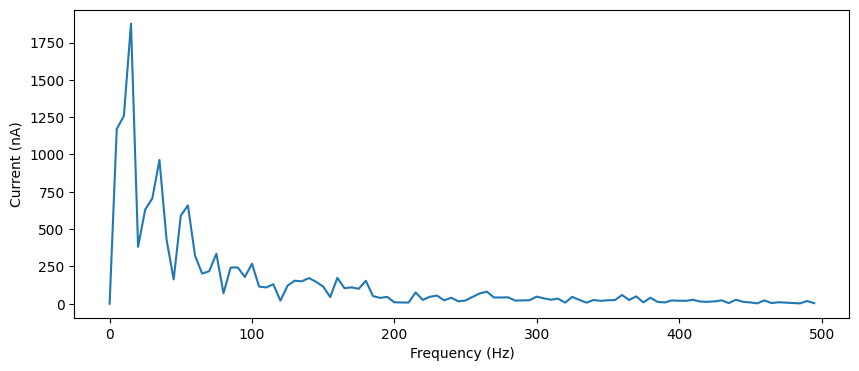

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.006, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[1876.03623494 1876.03623494]


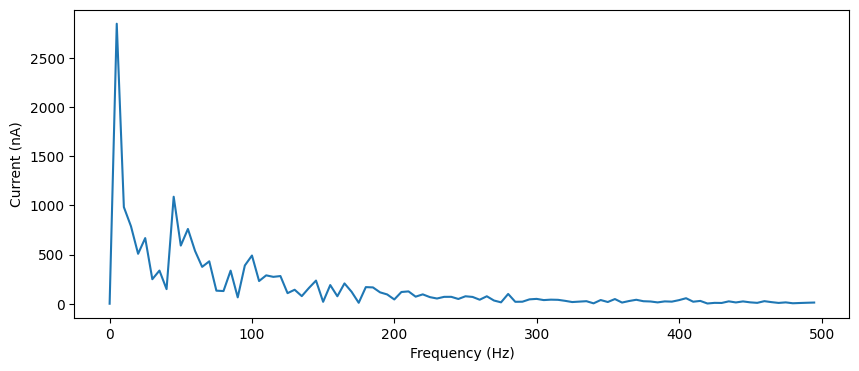

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2848.91907982 2848.91907982]


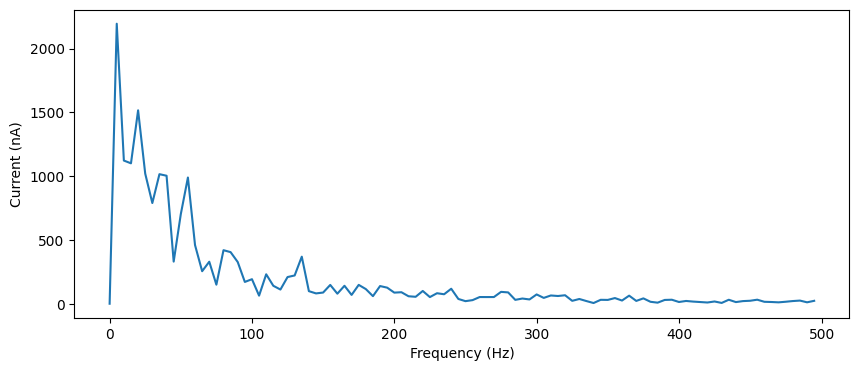

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.007000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2195.32591891 2195.32591891]


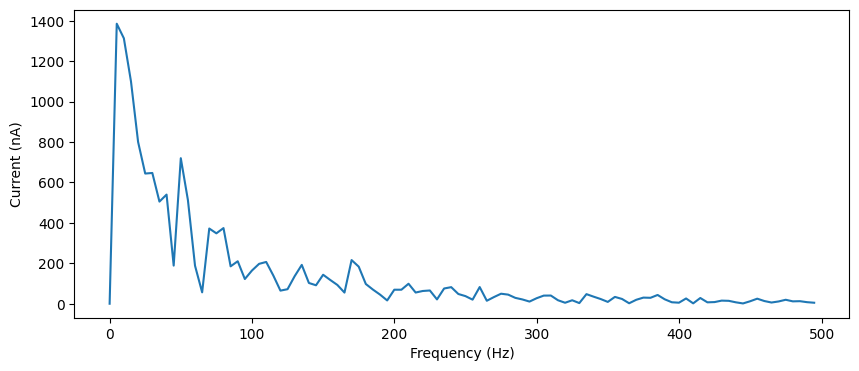

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.0075, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1385.73088068 1385.73088068]


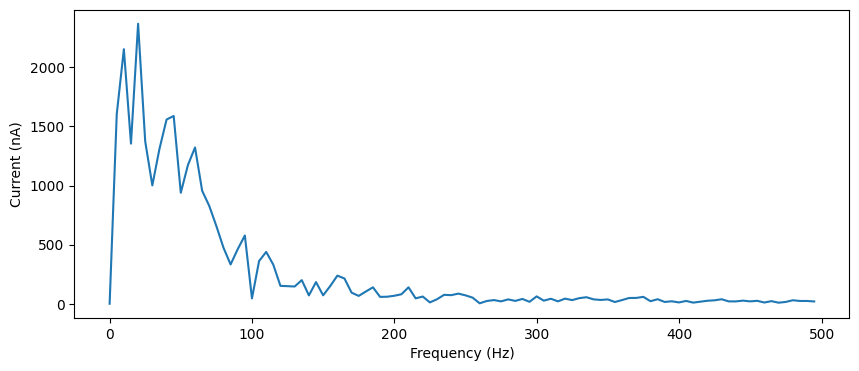

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.008, peak_freqs=[ 19.990005 -19.990005], peak_freqs_amp=[2368.7681453 2368.7681453]


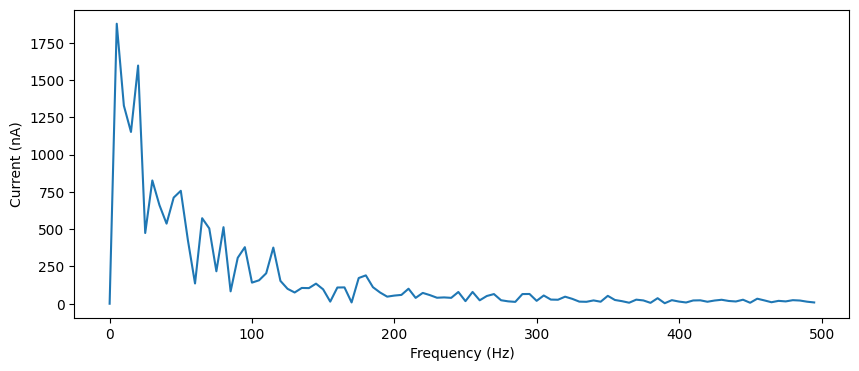

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1878.5240506 1878.5240506]


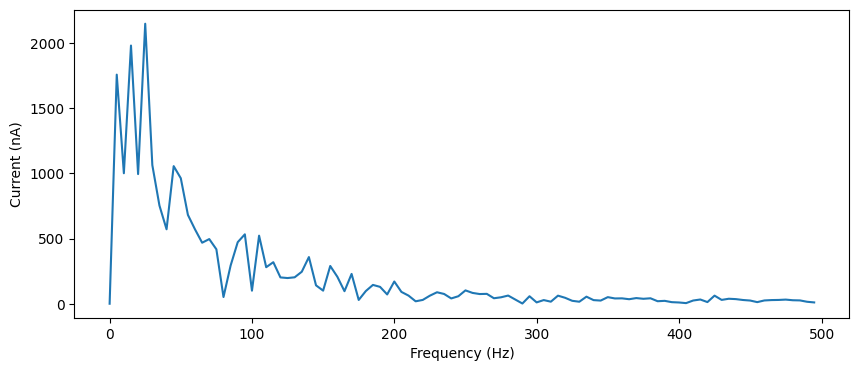

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.009000000000000001, peak_freqs=[ 24.98750625 -24.98750625], peak_freqs_amp=[2149.3855496 2149.3855496]


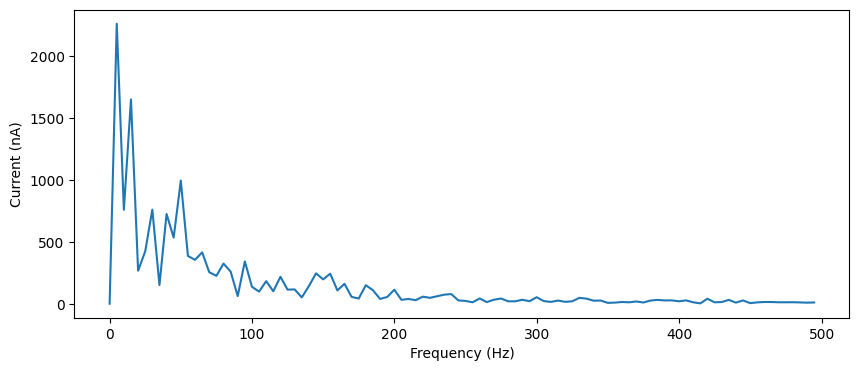

prob12=0.05, prob21=0.1, weight12=0.003, weight21=0.009500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2263.42061295 2263.42061295]


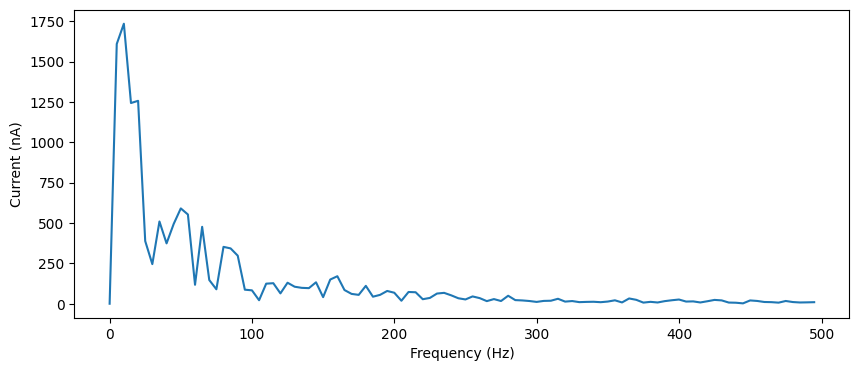

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.0005, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1734.057973 1734.057973]


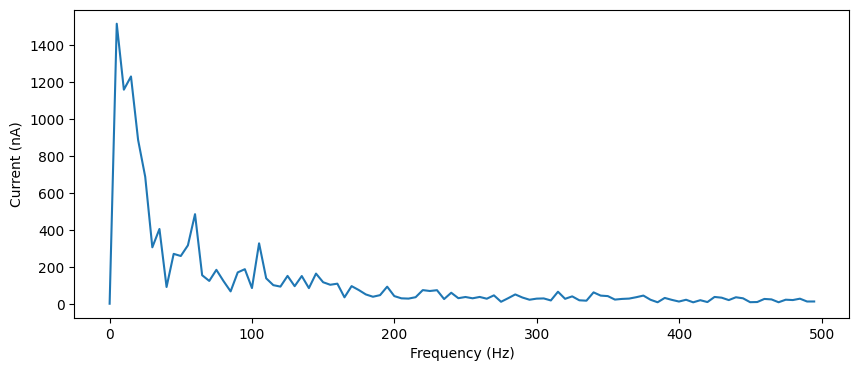

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1517.54747861 1517.54747861]


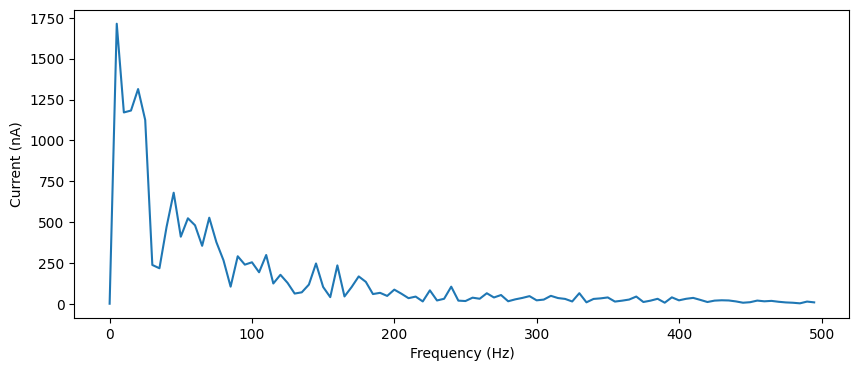

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.0015, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1714.04339987 1714.04339987]


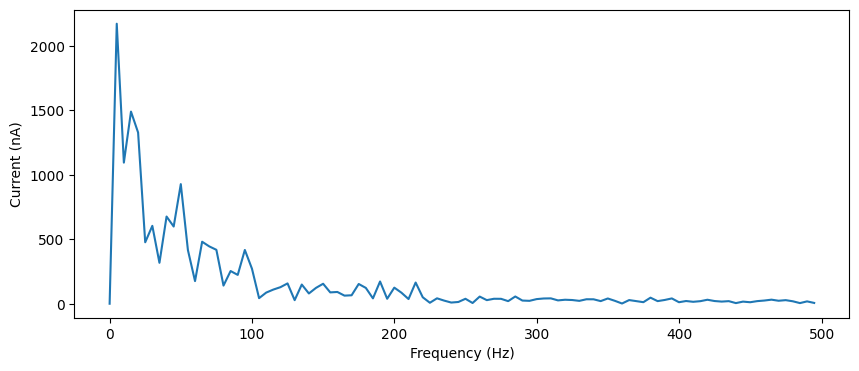

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.002, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2170.76177497 2170.76177497]


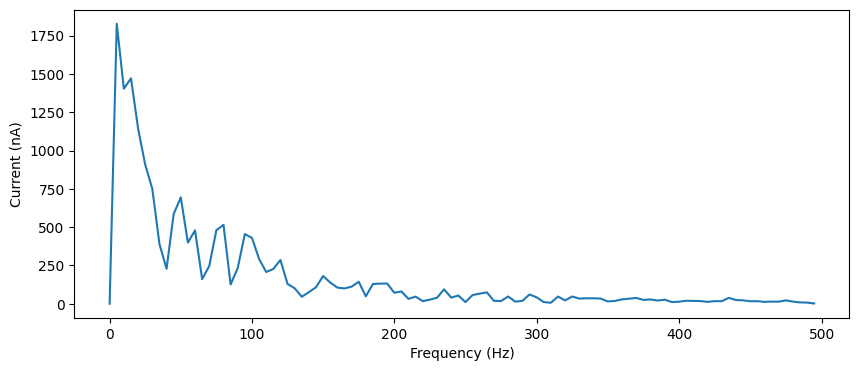

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.0025, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1828.26900196 1828.26900196]


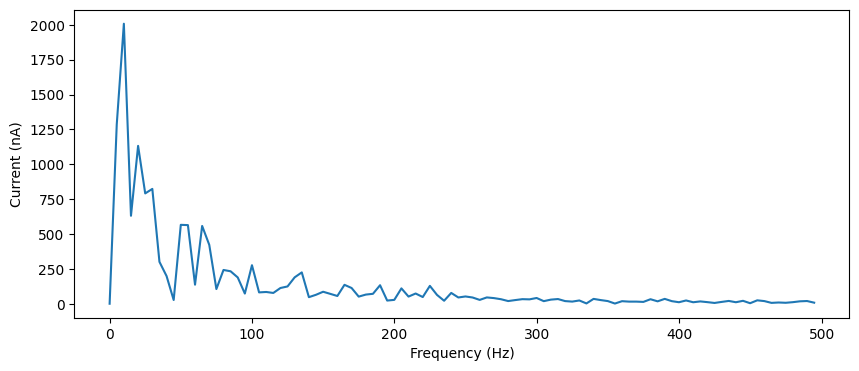

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.003, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2007.96476182 2007.96476182]


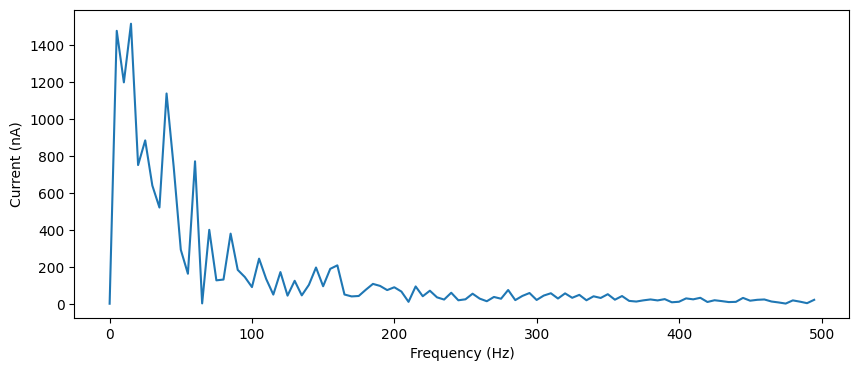

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.0035, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[1516.26274787 1516.26274787]


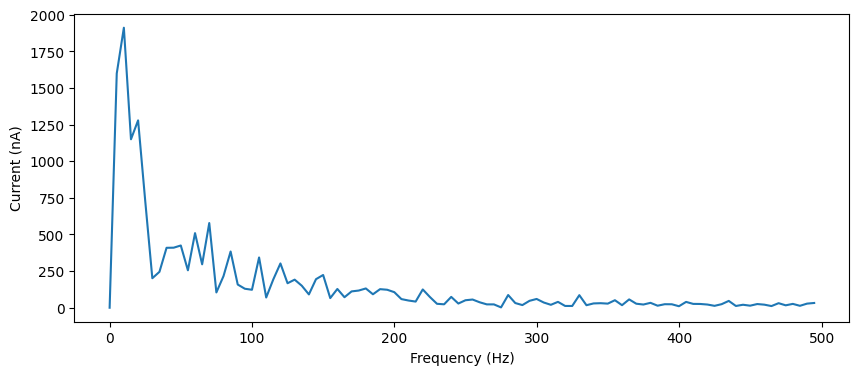

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.004, peak_freqs=[-9.9950025  9.9950025], peak_freqs_amp=[1911.6869067 1911.6869067]


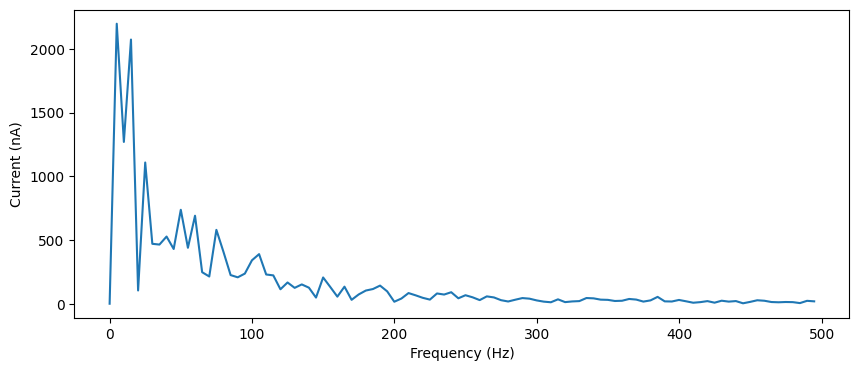

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2198.49080275 2198.49080275]


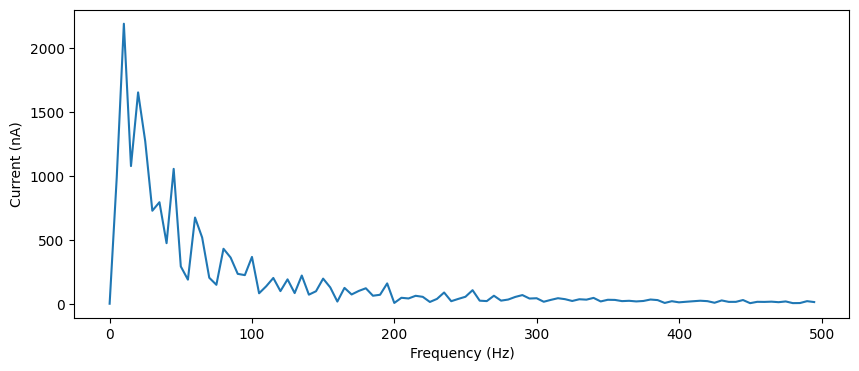

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.005000000000000001, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2192.91849023 2192.91849023]


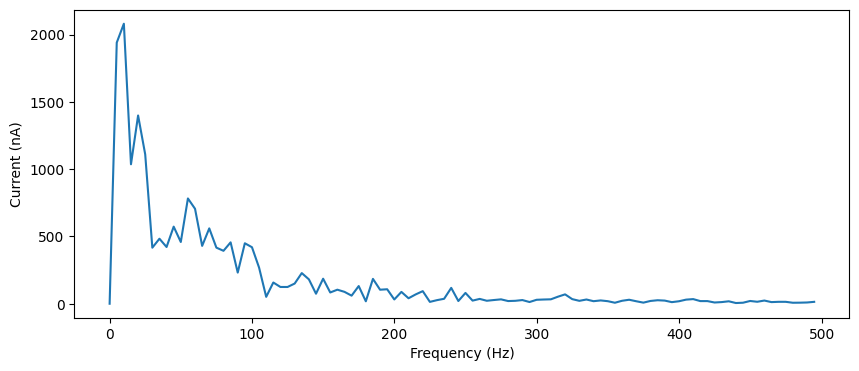

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.0055, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2080.1817723 2080.1817723]


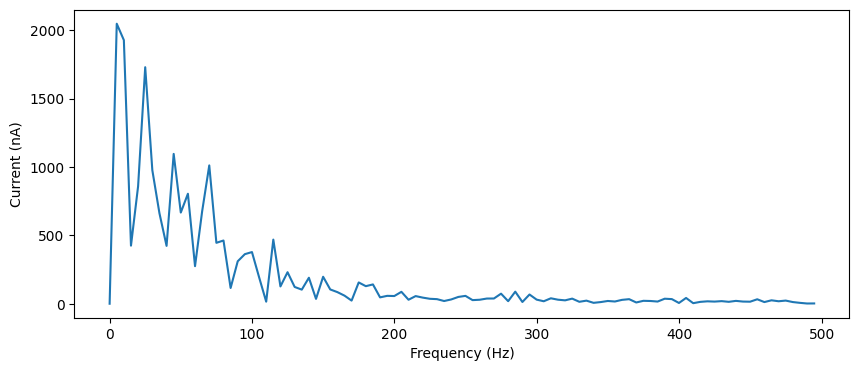

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.006, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2047.26480028 2047.26480028]


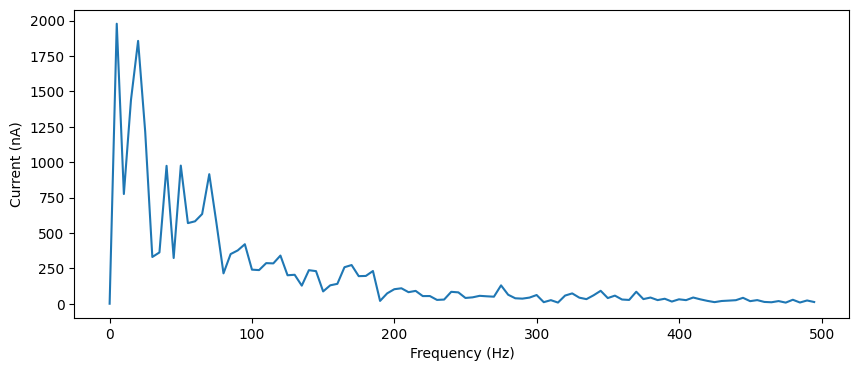

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.006500000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1977.53927584 1977.53927584]


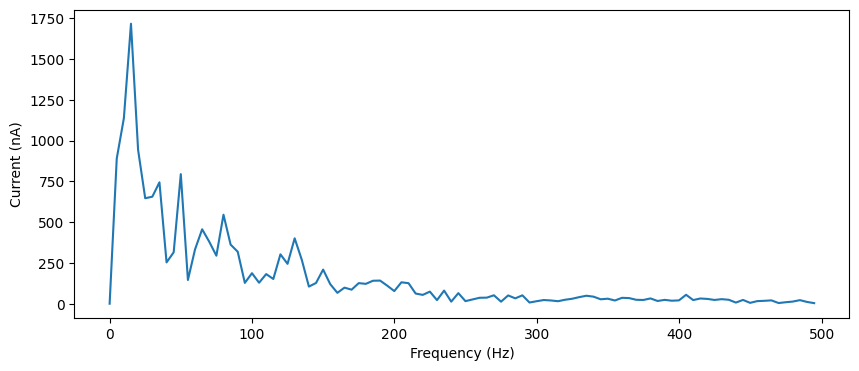

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.007000000000000001, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[1717.46238526 1717.46238526]


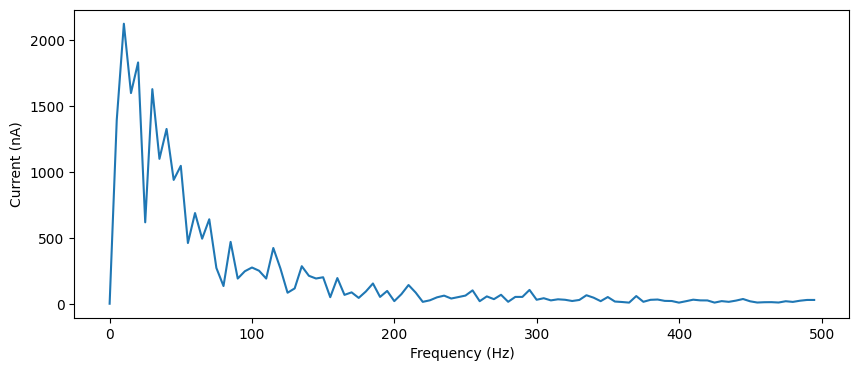

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.0075, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2121.97447819 2121.97447819]


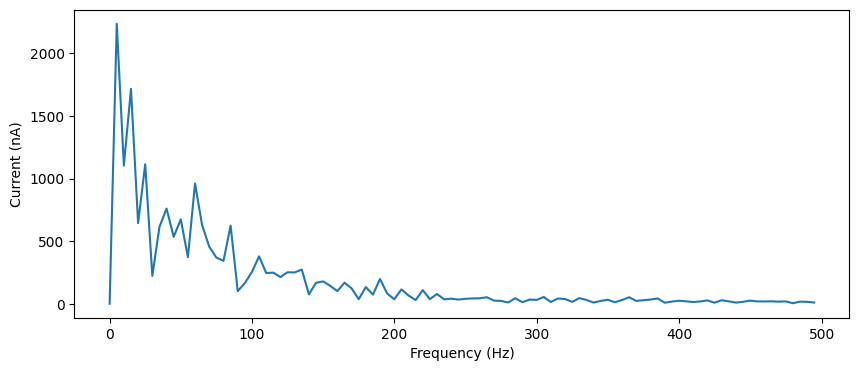

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.008, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2237.9016558 2237.9016558]


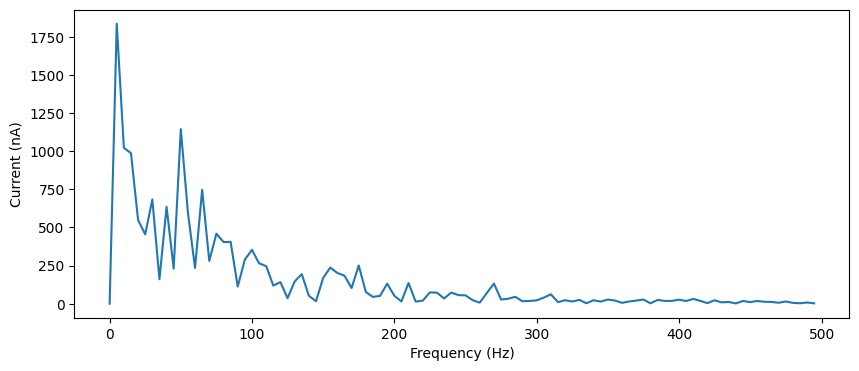

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.0085, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1836.07815694 1836.07815694]


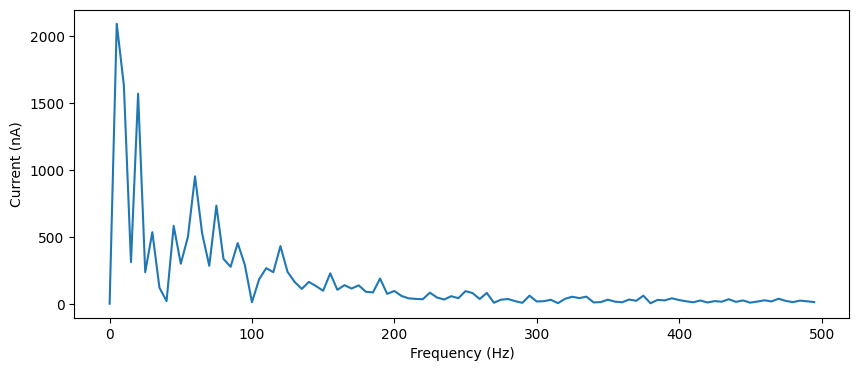

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.009000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2095.16023301 2095.16023301]


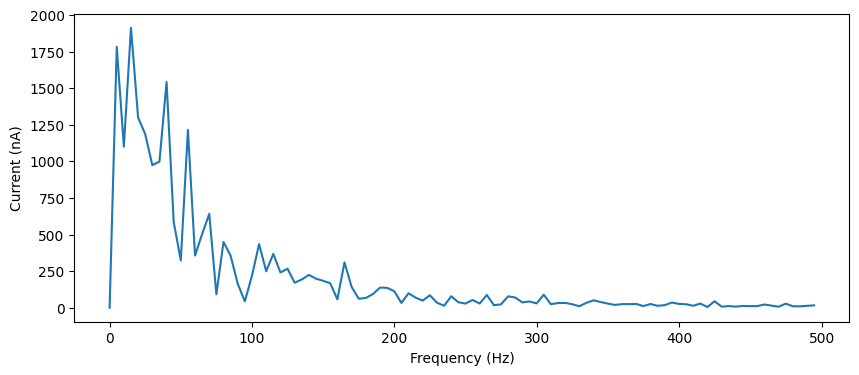

prob12=0.05, prob21=0.1, weight12=0.0035, weight21=0.009500000000000001, peak_freqs=[-14.99250375  14.99250375], peak_freqs_amp=[1912.79035643 1912.79035643]


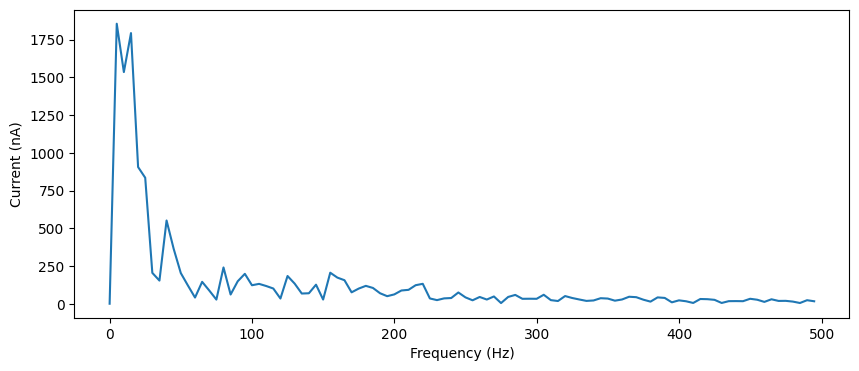

prob12=0.05, prob21=0.1, weight12=0.004, weight21=0.0005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1854.89657267 1854.89657267]


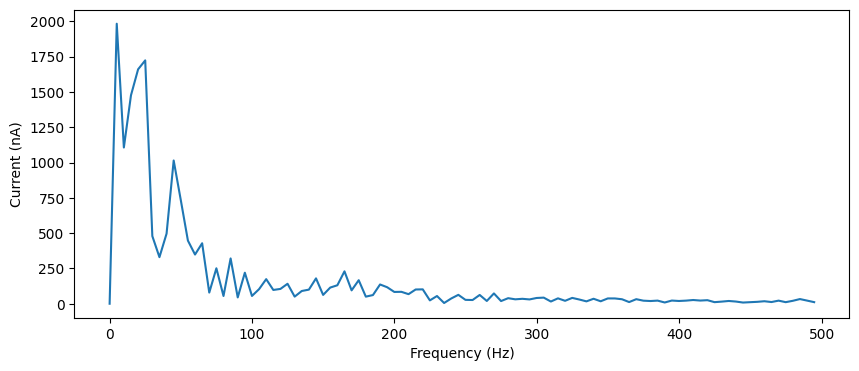

prob12=0.05, prob21=0.1, weight12=0.004, weight21=0.001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1983.33345449 1983.33345449]


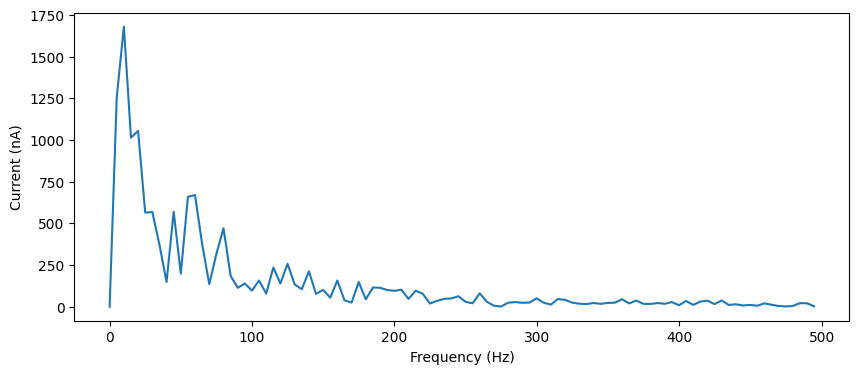

prob12=0.05, prob21=0.1, weight12=0.004, weight21=0.0015, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[1679.52674912 1679.52674912]


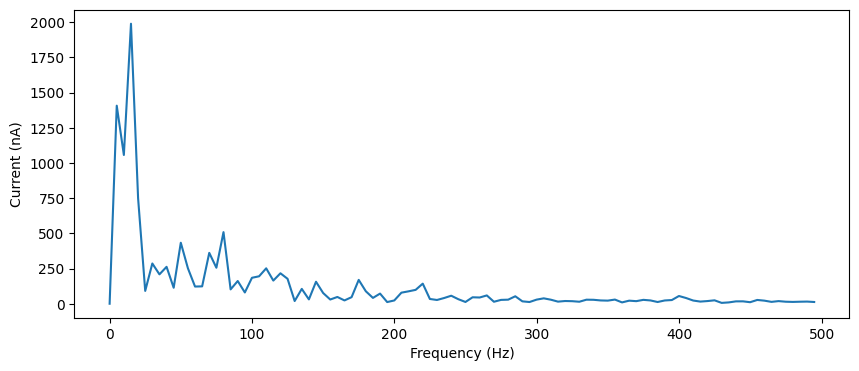

prob12=0.05, prob21=0.1, weight12=0.004, weight21=0.002, peak_freqs=[ 14.99250375 -14.99250375], peak_freqs_amp=[1988.78926835 1988.78926835]


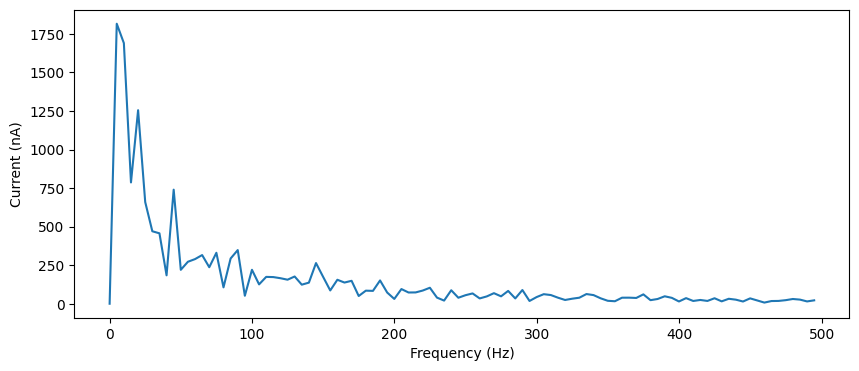

prob12=0.05, prob21=0.1, weight12=0.004, weight21=0.0025, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1815.80229999 1815.80229999]


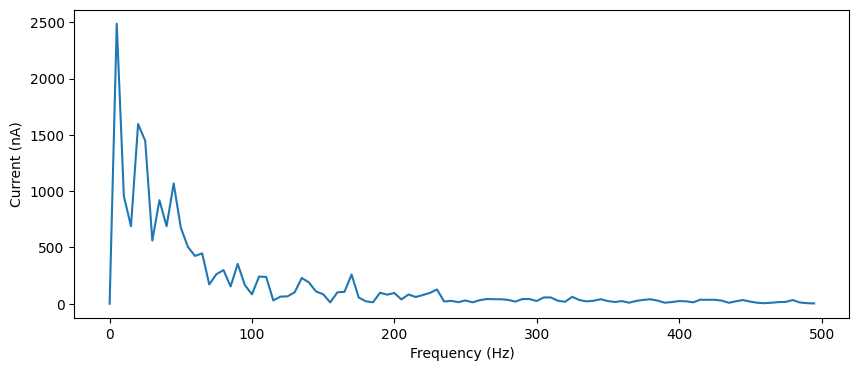

prob12=0.05, prob21=0.1, weight12=0.004, weight21=0.003, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2488.23832347 2488.23832347]


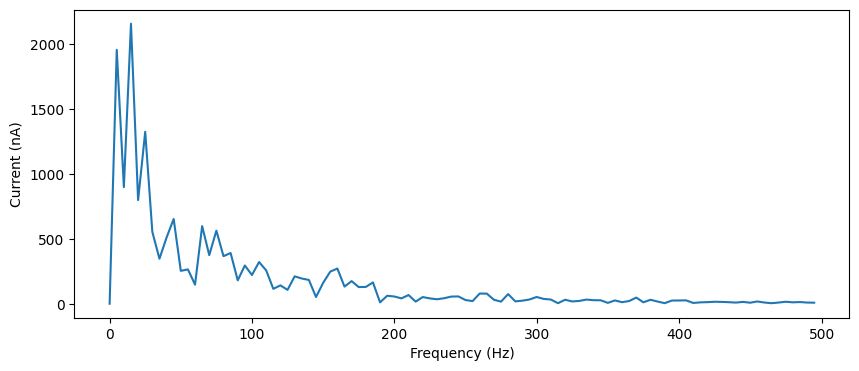

prob12=0.05, prob21=0.1, weight12=0.004, weight21=0.0035, peak_freqs=[ 14.99250375 -14.99250375], peak_freqs_amp=[2158.42647173 2158.42647173]


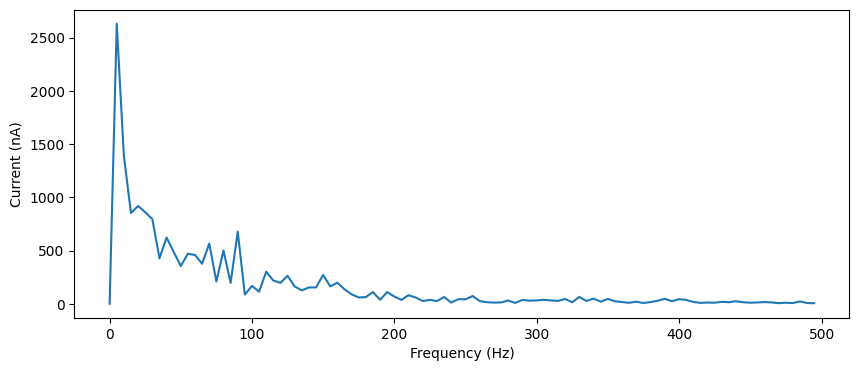

prob12=0.05, prob21=0.1, weight12=0.004, weight21=0.004, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2630.96395379 2630.96395379]


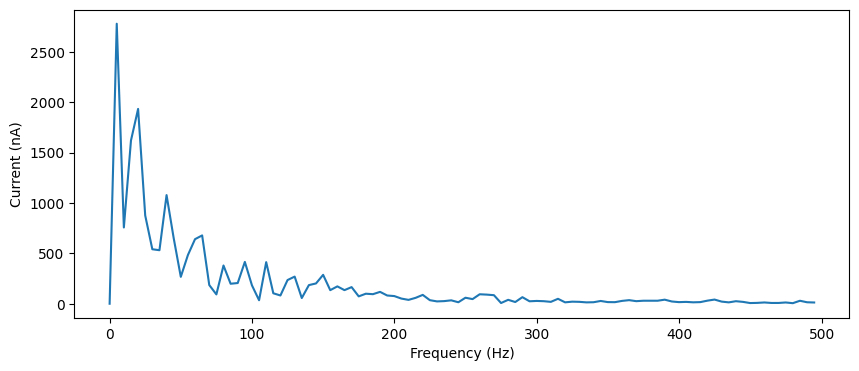

prob12=0.05, prob21=0.1, weight12=0.004, weight21=0.0045000000000000005, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[2778.82745373 2778.82745373]


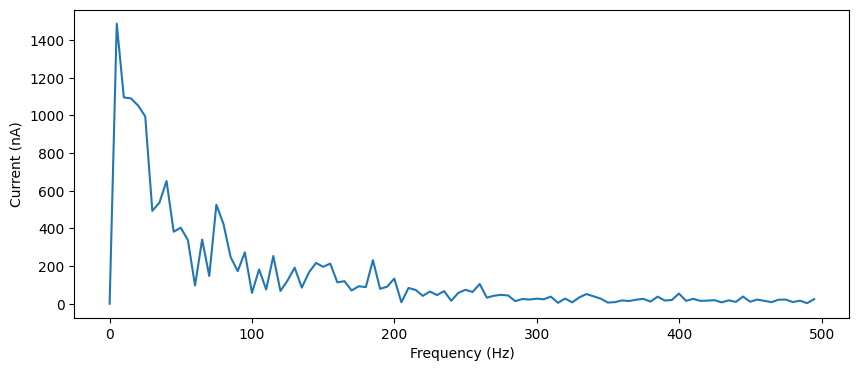

prob12=0.05, prob21=0.1, weight12=0.004, weight21=0.005000000000000001, peak_freqs=[-4.99750125  4.99750125], peak_freqs_amp=[1487.0735747 1487.0735747]


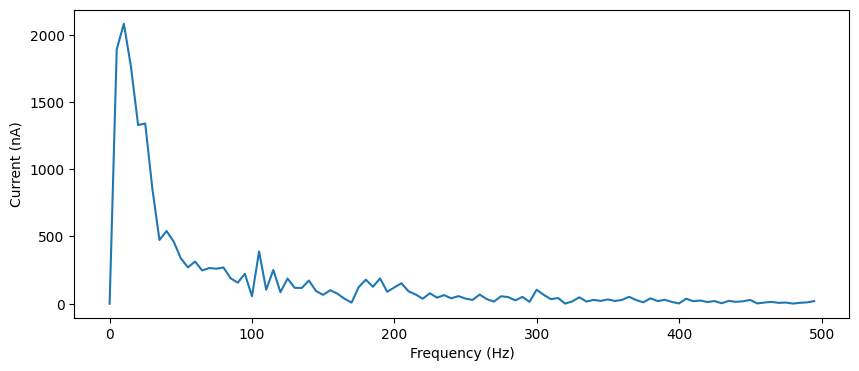

prob12=0.05, prob21=0.1, weight12=0.004, weight21=0.0055, peak_freqs=[ 9.9950025 -9.9950025], peak_freqs_amp=[2082.30193467 2082.30193467]


: 

In [102]:
# generate from 0.01 to 0.2 with 0.01 step
prob12 = np.arange(0.05, 0.2, 0.05)
prob21 = np.arange(0.05, 0.2, 0.05)
print(len(prob12), len(prob21))

# generate from 0.002 to 0.008 with 0.002 step
weight12 = np.arange(0.0005, 0.01, 0.0005)
weight21 = np.arange(0.0005, 0.01, 0.0005)
print(len(weight12), len(weight21))

TIME_MS = 50

res = {}
for p12 in prob12:
    for p21 in prob21:
        for w12 in weight12:
            for w21 in weight21:
                layer_1, layer_2, fake_axons = construct_network(
                    prob1=0.01,
                    prob2=0.2,
                    prob12=p12,
                    weight12=w12,
                    prob21=p21,
                    weight21=w21,
                )
                peak_freqs, peak_freqs_amp = plot_fft_and_get_peaks(
                    layer_1, layer_2, time_ms=TIME_MS, plot=True
                )
                res[(p12, p21, w12, w21)] = (peak_freqs, peak_freqs_amp)
                print(
                    f"prob12={p12}, prob21={p21}, weight12={w12}, weight21={w21}, peak_freqs={peak_freqs}, peak_freqs_amp={peak_freqs_amp}"
                )

In [ ]:
# find the best parameters
for k, v in res.items():
    print(k, v)

200
-


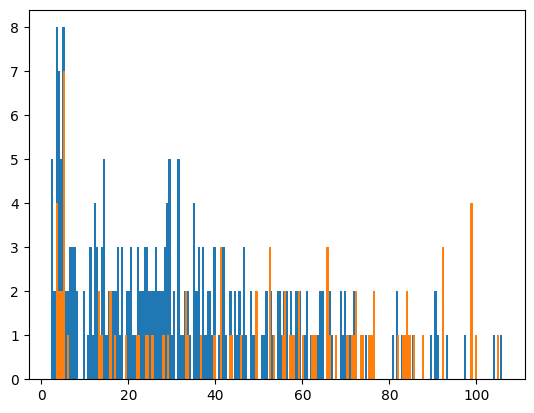

In [66]:
import math

tstop = math.ceil(max(list(time)))
print(tstop)
plt.hist(spike_times_vec_E, bins=tstop)
plt.hist(spike_times_vec_I, bins=tstop)
print("-")

In [1]:
# generate from 0.01 to 0.2 with 0.01 step
prob12 = np.arange(0.05, 0.2, 0.05)
prob21 = np.arange(0.05, 0.2, 0.05)
print(len(prob12), len(prob21))

# generate from 0.002 to 0.008 with 0.002 step
weight12 = np.arange(0.0005, 0.01, 0.0005)
weight21 = np.arange(0.0005, 0.01, 0.0005)
print(len(weight12), len(weight21))

TIME_MS = 50

res = {}
for p12 in prob12:
    for p21 in prob21:
        for w12 in weight12:
            for w21 in weight21:
                layer_1, layer_2, fake_axons = construct_network(
                    prob1=0.01,
                    prob2=0.2,
                    prob12=p12,
                    weight12=w12,
                    prob21=p21,
                    weight21=w21,
                )
                peak_freqs, peak_freqs_amp = plot_fft_and_get_peaks(
                    layer_1, layer_2, time_ms=TIME_MS, plot=True
                )
                res[(p12, p21, w12, w21)] = (peak_freqs, peak_freqs_amp)
                print(
                    f"prob12={p12}, prob21={p21}, weight12={w12}, weight21={w21}, peak_freqs={peak_freqs}, peak_freqs_amp={peak_freqs_amp}"
                )

NameError: name 'np' is not defined